In [96]:
# pip install folium
!pip install yellowbrick

Defaulting to user installation because normal site-packages is not writeable
     -------------------------------------- 282.6/282.6 kB 3.4 MB/s eta 0:00:00


# Imports librairies et jeu de données

In [88]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.patches import Circle
import folium
import seaborn as sns
import numpy as np
import pickle
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import warnings
warnings.filterwarnings('ignore')

from sklearn.preprocessing import OneHotEncoder, StandardScaler, MinMaxScaler
from sklearn.compose import ColumnTransformer, make_column_transformer
from sklearn.pipeline import Pipeline, make_pipeline
from yellowbrick.cluster import KElbowVisualizer #, SilhouetteVisualizer, InterclusterDistance
from sklearn.preprocessing import normalize
import scipy.cluster.hierarchy as shc

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import davies_bouldin_score
from sklearn.metrics import silhouette_score

pd.set_option("display.max_rows", 101)
pd.options.display.max_columns = 999

In [89]:
data = pd.read_csv('data/data_cleaned_rfm.csv')

In [90]:
data.shape

(74025, 6)

In [91]:
data.dropna(inplace=True)

In [92]:
data.shape

(74025, 6)

In [93]:
data.set_index('customer_unique_id', inplace=True)

In [94]:
data.head()

,last_order,frequency,monetary_value,recency,mean_monetary_value
customer_unique_id,,,,,
be40dd02e486b93b8b4128f2715cfdfe,2018-04-12 09:47:35,1,100.46,141,100.46
71bb258c3488c3ea32219c64c000ff3d,2018-08-03 23:00:24,1,276.20,28,276.20
863c9a8df992728d25a783b95471b674,2018-04-11 16:43:39,1,143.59,142,143.59
410f9b983169496799178835774f1f20,2017-10-29 11:59:16,1,41.09,306,41.09
28a18a20106f88e886bcebef8c04eff6,2017-11-13 02:52:52,1,39.09,291,39.09


In [95]:
data['last_order'] = data['last_order'].astype(
    'datetime64')

In [96]:
data.select_dtypes(['object']).nunique()

Series([], dtype: float64)

In [97]:
data.dtypes

last_order             datetime64[ns]
frequency                       int64
monetary_value                float64
recency                         int64
mean_monetary_value           float64
dtype: object

In [98]:
data.columns

Index(['last_order', 'frequency', 'monetary_value', 'recency',
       'mean_monetary_value'],
      dtype='object')

In [99]:
# data.drop(['customer_zip_code_prefix','Cat_la_plus_achetee'], 
#           axis=1, 
#           inplace=True)

In [100]:
# data.drop(['customer_city', 'customer_state'], 
#           axis=1, 
#           inplace=True)

In [101]:
data.select_dtypes(['object']).nunique()

Series([], dtype: float64)

# Echantillon réduit

In [102]:
# from sklearn.cluster import KMeans
# from scipy.cluster.hierarchy import linkage, dendrogram

# # Réduction du DataFrame avec K-means
# k = 500  # Nombre de centroïdes souhaité
# kmeans = KMeans(n_clusters=k, random_state=42)
# kmeans.fit(data)

# # Obtention des centroïdes
# centroids = kmeans.cluster_centers_

# # Attribution des clusters aux données d'origine
# data['cluster'] = kmeans.labels_

# # Application de la classification ascendante hiérarchique (CAH) sur les centroïdes
# linked = linkage(centroids, method='ward')

# # Affichage du dendrogramme
# plt.figure(figsize=(12, 6))
# dendrogram(linked, orientation='top', distance_sort='descending', show_leaf_counts=True)
# plt.title('Dendrogramme de la CAH sur les centroïdes')
# plt.xlabel('Centroïdes')
# plt.ylabel('Distance')
# plt.show()


## Préparation

In [123]:
#X=data.copy()
data_reduce = data.sample(10000, random_state=1).copy()
X = data_reduce.copy()
categorical_columns = X.select_dtypes(['category','object']).columns
numerical_columns = X.select_dtypes(['int32','int64','float64']).columns

ohe = OneHotEncoder(sparse=False)
ss = StandardScaler()
X[numerical_columns] = ss.fit_transform(X[numerical_columns])
ohe.fit(X[categorical_columns])

OneHotEncoder(sparse=False)

In [124]:
X = pd.merge(X[numerical_columns], 
          pd.DataFrame(columns = ohe.get_feature_names().tolist(),
              data = ohe.fit_transform(X[categorical_columns])).set_index(X.index),
        left_index = True, right_index = True)

In [125]:
X.head()

,frequency,monetary_value,recency,mean_monetary_value
customer_unique_id,,,,
d83483c59166abd80e647c7b3b836267,-0.143668,0.046000,-1.509119,0.068019
faea8d3ca7727a278bf3045a9486eca7,-0.143668,-0.583505,1.058428,-0.583321
1c39a48708a75f7cebb03b348be1777d,-0.143668,-0.253064,0.145745,-0.241419
e1d8ea96d64cb683a2a4abc283dd82de,-0.143668,-0.277555,-0.476082,-0.266759
b7df9e1300398dcbef32dd58f5778e4e,-0.143668,-0.169611,0.948104,-0.155071


## PCA Transformation 

In [126]:
pca = PCA(random_state=1)

In [127]:
pca.fit(X)

PCA(random_state=1)

In [128]:
X.shape

(10000, 4)

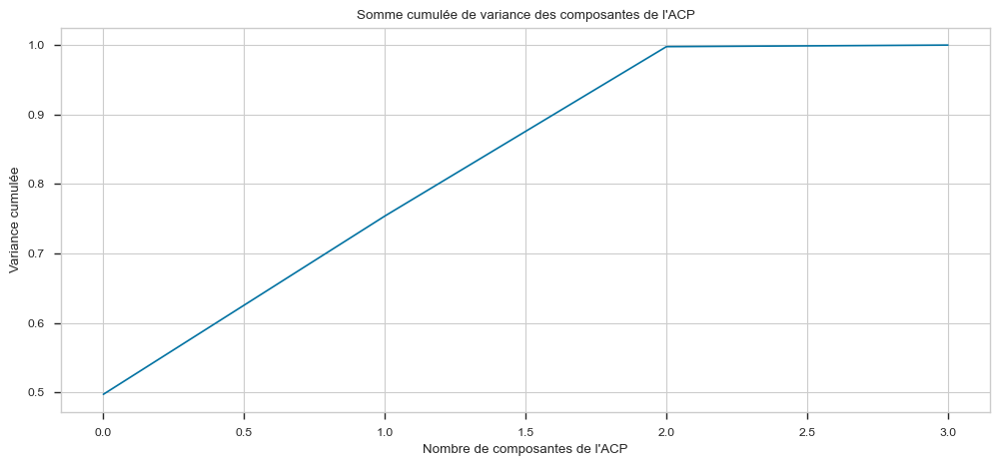

In [129]:
plt.figure(figsize=(12,5))
plt.title('Somme cumulée de variance des composantes de l\'ACP')
plt.xlabel('Nombre de composantes de l\'ACP')
plt.ylabel('Variance cumulée')
plt.plot(list(range(X.shape[1])),
         np.cumsum(pca.explained_variance_ratio_))


In [131]:
np.cumsum(pca.explained_variance_ratio_)[2]

0.9977547390361696

In [132]:
# # data_reduce_bis = data.sample(10000, random_state=1).copy()
# # X_bis = data_reduce_bis.copy()
# # # categorical_columns = X_bis.select_dtypes(['category','object']).columns
# # numerical_columns = X_bis.select_dtypes(['int32','float64']).columns
# # X_bis = X_bis.drop(categorical_columns, axis=1)
# # # ohe = OneHotEncoder(sparse=False)
# # # ss = StandardScaler()
# # # X_bis[numerical_columns] = ss.fit_transform(X_bis[numerical_columns])
# # # PCA Pipeline

# # categorical_features = list(data.select_dtypes(exclude=['int32','int64', 'float64', 'uint8']).columns)
# # categorical_features
# # X_bis = X.drop(categorical_features, axis=1)
# # X_bis.head(6)
# X_bis = X

# pca = Pipeline([("preprocessor", MinMaxScaler()),
#                 ("pca", PCA(svd_solver='full'))])
# pca.fit(X_bis)
# X_projected = pca.transform(X_bis)

In [133]:
# # PCA Pipeline
# pca = Pipeline([("preprocessor", MinMaxScaler()),
#                 ("pca", PCA(svd_solver='full'))])
# pca.fit(X)
# X_projected = pca.transform(X)

In [134]:
# # Explained variance
# varexpl = pca.named_steps['pca'].explained_variance_ratio_ * 100

# # Plot of cumulated variance
# plt.figure(figsize=(12, 8))
# plt.bar(np.arange(len(varexpl)) + 1, varexpl)

# cumSumVar = varexpl.cumsum()
# plt.plot(np.arange(len(varexpl)) + 1, cumSumVar, c="red", marker='o')
# plt.axhline(y=95, linestyle="--", color="green", linewidth=1)

# limit = 95
# valid_idx = np.where(cumSumVar >= limit)[0]
# min_plans = valid_idx[cumSumVar[valid_idx].argmin()] + 1
# plt.axvline(x=min_plans, linestyle="--", color="green", linewidth=1)

# plt.xlabel("rang de l'axe d'inertie")
# plt.xticks(np.arange(1, len(varexpl) + 1, 5), rotation=45)  # Show labels every 5 positions and rotate by 45 degrees
# plt.ylabel("pourcentage d'inertie")
# plt.title("{}% de la variance totale est expliquée"\
#           " par les {} premiers axes".format(limit, min_plans))
# plt.show(block=False)


avec 19 features on a 93 % de la variance totale

In [135]:
colonnes_pca = X.columns

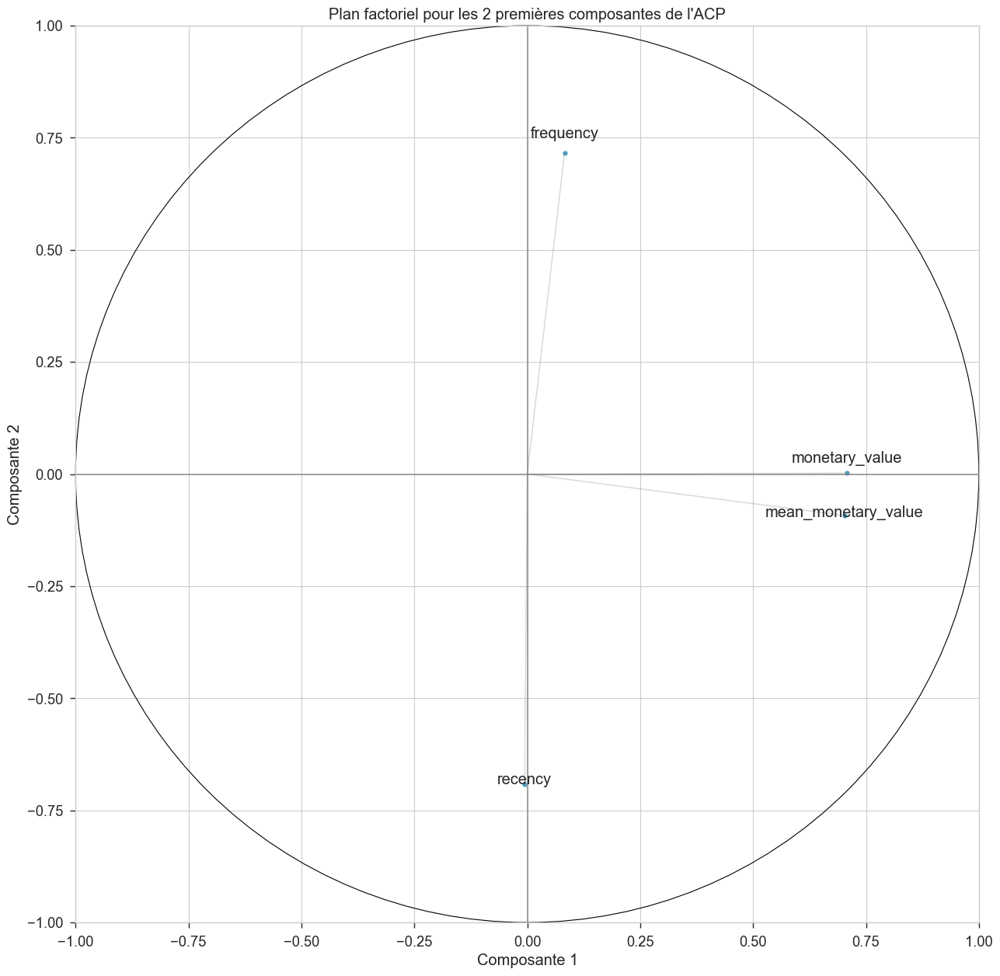

In [136]:
from matplotlib.patches import Circle
sns.set_context("paper", font_scale=1.5) 
plt.figure(figsize=(15,15))
chaine = "Plan factoriel pour les 2 premières composantes de l'ACP"
plt.title(chaine)
plt.xlabel('Composante 1')
plt.ylabel('Composante 2')
ax = plt.gca()
ax.add_patch(Circle([0,0], radius=1, color='black', fill=False, linestyle='-', 
                    clip_on=False))
ax.set_xlim(-1,1)
ax.set_ylim(-1,1)
x_pca = pca.components_[0,:]
y_pca = pca.components_[1,:]

sns.scatterplot(x = x_pca,
                y = y_pca,
               alpha = 0.7)
plt.plot([-1,1],[0,0], color='grey', alpha=0.8)
plt.plot([0,0],[-1,1], color='grey', alpha=0.8)

i = 0
for x,y,colonne in zip(x_pca,y_pca, colonnes_pca):

    plt.annotate(colonne, 
                 (x,y), 
                 textcoords="offset points", 
                 xytext=(0,5+np.random.randint(-10,10)),
                 ha='center') 
    ax.arrow(0, 0, x, y, head_width=0, head_length=0, fc='grey', ec='grey',
             alpha=0.2)


sns.set_context("paper", font_scale=1) 

In [137]:
x_show = pca.transform(X.select_dtypes(['float64','int32']))[:,0]

y_show = pca.transform(X.select_dtypes(['float64','int32']))[:,1]

z_show = pca.transform(X.select_dtypes(['float64','int32']))[:,2]

In [138]:
X_pca = pca.transform(X)[:,:8000]

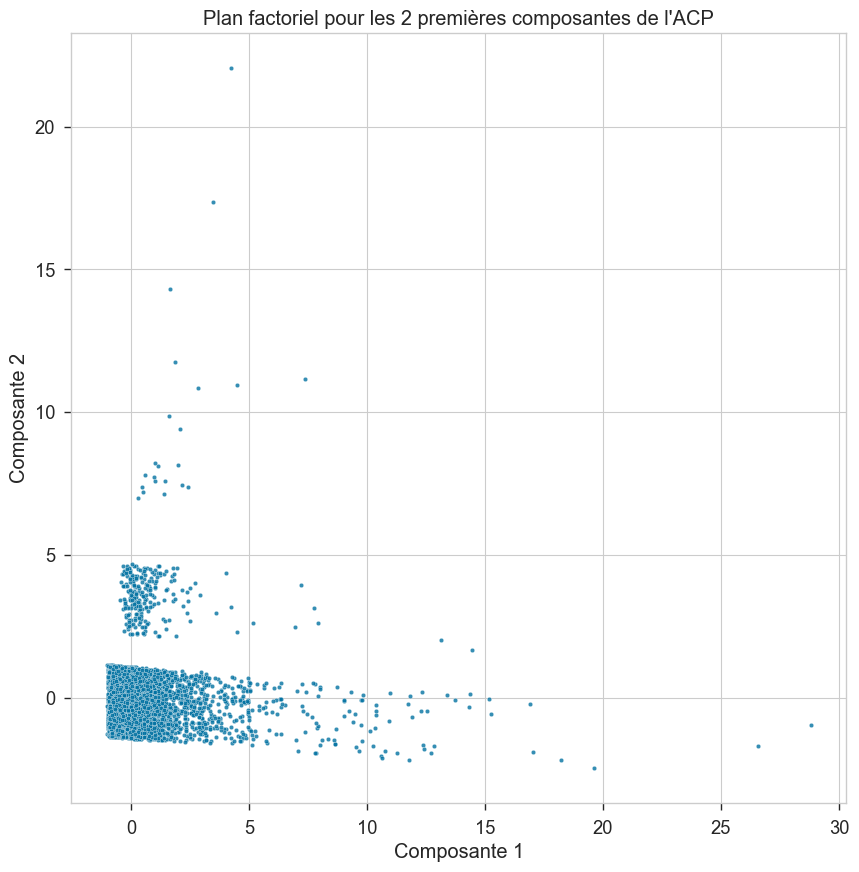

In [139]:
sns.set_context("paper", font_scale=1.5) 
plt.figure(figsize=(10,10))
chaine = "Plan factoriel pour les 2 premières composantes de l'ACP"
plt.title(chaine)
plt.xlabel('Composante 1')
plt.ylabel('Composante 2')
ax = plt.gca()

sns.scatterplot(x = x_show,
                y = y_show,
                #hue = hue_show,
                alpha=0.8, s=10)

sns.set_context("paper", font_scale=1) 


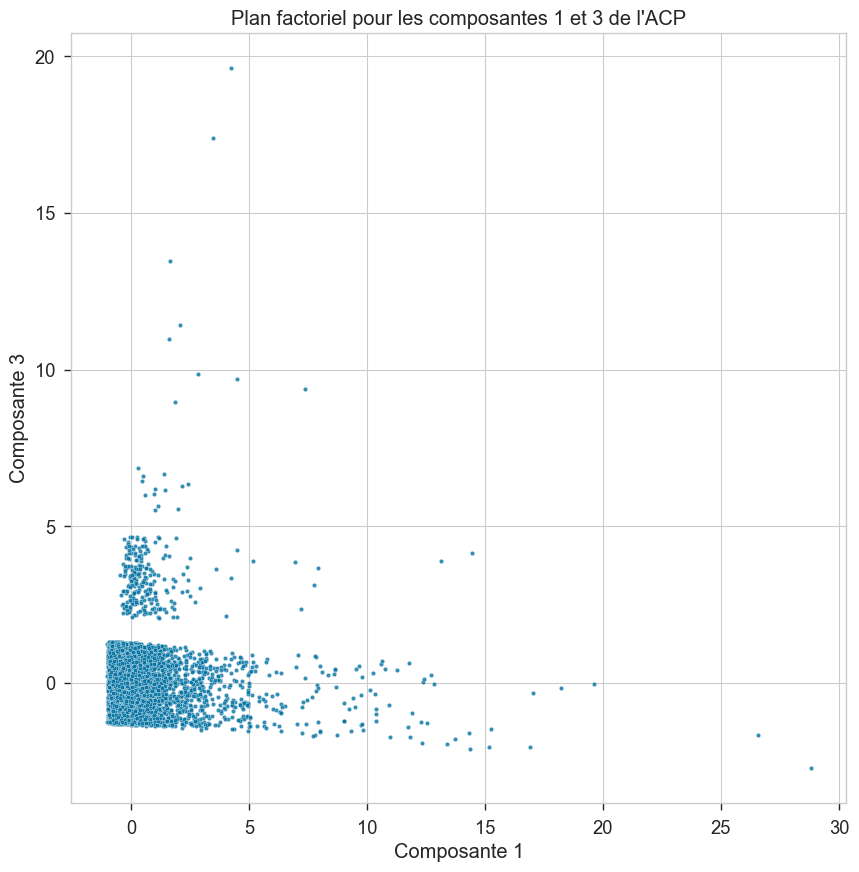

In [140]:
sns.set_context("paper", font_scale=1.5) 
plt.figure(figsize=(10,10))
chaine = "Plan factoriel pour les composantes 1 et 3 de l'ACP"
plt.title(chaine)
plt.xlabel('Composante 1')
plt.ylabel('Composante 3')
ax = plt.gca()

sns.scatterplot(x = x_show,
                y = z_show,
                #hue = hue_show,
                alpha=0.8, s=10)
sns.set_context("paper", font_scale=1) 


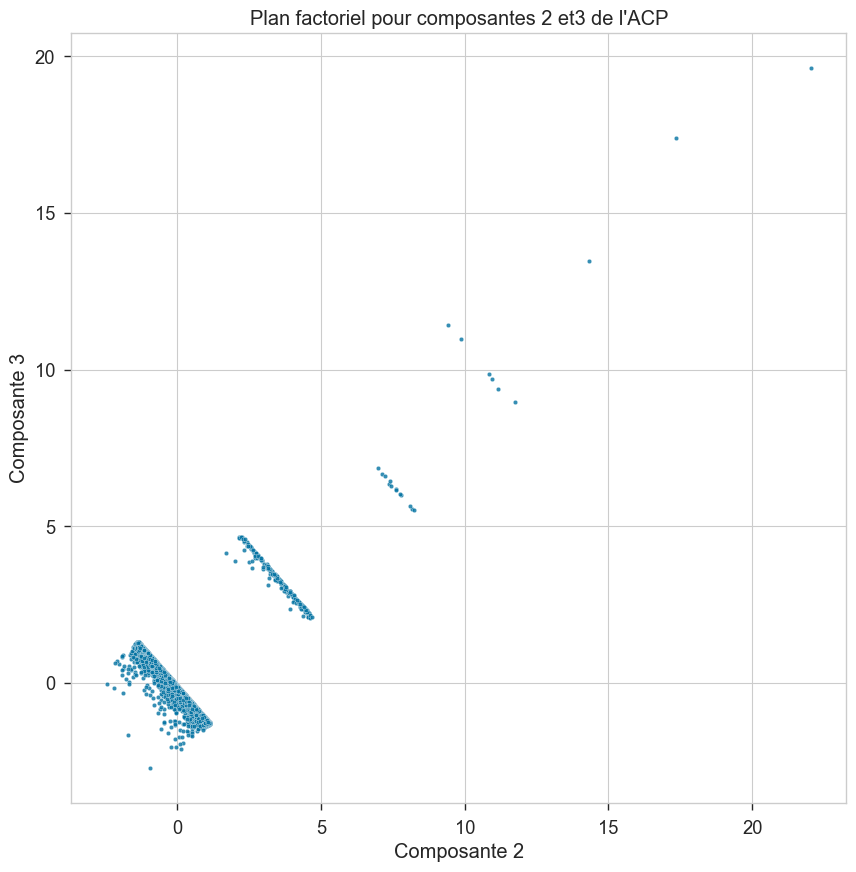

In [141]:
from matplotlib.patches import Circle
sns.set_context("paper", font_scale=1.5) 
plt.figure(figsize=(10,10))
chaine = "Plan factoriel pour composantes 2 et3 de l'ACP"
plt.title(chaine)
plt.xlabel('Composante 2')
plt.ylabel('Composante 3')
ax = plt.gca()

sns.scatterplot(x = y_show,
                y = z_show,
                #hue = hue_show,
                alpha=0.8, s=10)

sns.set_context("paper", font_scale=1) 


## T-SNE

utilisons l'algorithme T-SNE pour avoir une idée en première approche du nombre de groupes homogènes

In [142]:
tsne = TSNE(n_components=2)
T = tsne.fit_transform(X_pca.copy())

<Axes: title={'center': 'Représentation du jeu de données via T-SNE'}>

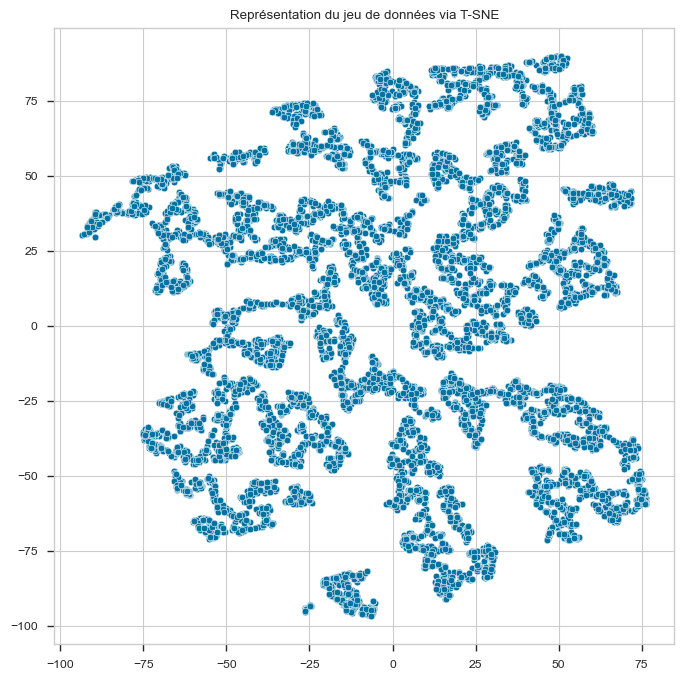

In [143]:
plt.figure(figsize=(8,8))
plt.title('Représentation du jeu de données via T-SNE')
sns.scatterplot(T[:,0], T[:,1])

## Kmeans

# Clustering avec l'algorithme du K-Means

## Explication de l'algorithme

K-Means C’est l’un des algorithmes de clustering les plus répandus. Il permet d’analyser un jeu de données caractérisées par un ensemble de descripteurs, afin de regrouper les données “similaires” en groupes *(ou clusters).

Après avoir initialisé des centroïdes en prenant des données au hasard dans le jeu de données, K-means alterne plusieurs fois ces deux étapes pour optimiser les centroïdes et leurs groupes :

1 - Regrouper chaque objet autour du centroïde le plus proche.
2 - Replacer chaque centroïde selon la moyenne des descripteurs de son groupe.

L’algorithme a convergé après un certain nombre d'itérations et trouve un découpage stable du jeu de données. Cependant, le nombre de Clusters est à définir par l'utilisateur.

## Méthode du coude

KElbowVisualizer de Yellowbrick implémente la méthode du «coude» pour sélectionner le nombre optimal de clusters en ajustant le modèle K-Means avec une plage de valeurs pour K. Si le graphique en courbes ressemble à un bras, alors le «coude» (le point d'inflexion sur la courbe) est une bonne indication du nombre de K optimal.

## Preprocessing

Nous allons supprimer customer_zip_code_prefix et customer_city, customer_state pour ne conserver que la variable haversine_distance pour indiquer une localisation "large" des clients, ce qui évitera de focaliser la segmentation sur la localisation du client.

Nous allons également supprimer mean_price_order et mean_nb_items puisque nous avons vu dans le Notebook de nettoyage et exploration Olist que ces variables sont fortement corrélées aux totaux pour le moment.

In [144]:
numerical_features = list(data.select_dtypes(include=['int64','float64', 'uint8']).columns)
numerical_features

['frequency', 'monetary_value', 'recency', 'mean_monetary_value']

On prepare ensuite le preprocessor :

In [145]:
scaler = MinMaxScaler()

preprocessor = ColumnTransformer([
    ('scaler', scaler, numerical_features)])

Méthode du coude : détermination du meilleur K Un pipeline SKLearn est créé pour y inclure le preprocessing et la visualisation de la méthode du coude de notre KMeans.

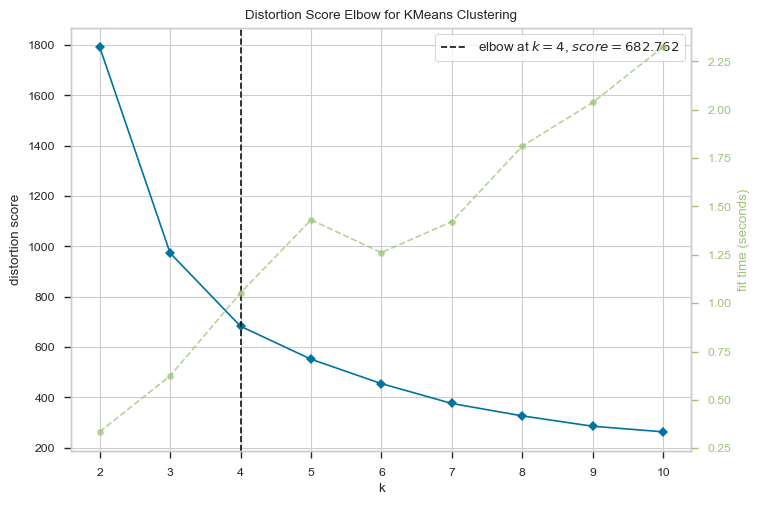

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [146]:
# X = data.copy()
# # Elbow method
# kmeans_visualizer = Pipeline([
#     ("preprocessor", preprocessor),
#     ("kelbowvisualizer", KElbowVisualizer(KMeans(),K=(4,20)))])
# kmeans_visualizer.fit(X)
# kmeans_visualizer.named_steps['kelbowvisualizer'].show()
# # Copie des données pour éviter de modifier les données originales

X = data.copy()

# Étape 1: Prétraitement des données
# Ici, nous devons prétraiter les données avant de les utiliser pour le clustering.
# Cela peut inclure des étapes telles que la normalisation des données, l'encodage des variables catégorielles, etc.
# Nous utilisons la pipeline 'preprocessor' pour effectuer ces étapes.

# Étape 2: Méthode du coude (Elbow method)
# Ici, nous utilisons la méthode du coude pour déterminer le nombre optimal de clusters.
# Nous utilisons la bibliothèque Yellowbrick pour visualiser le coude.
# Nous créons une pipeline 'kmeans_visualizer' qui effectue le prétraitement des données
# et applique l'algorithme KMeans avec différents nombres de clusters (de 4 à 20) pour la visualisation.
# Nous utilisons ensuite la méthode 'fit' pour ajuster les données à la pipeline et la méthode 'show' pour afficher le résultat.
# La méthode 'show' affiche la courbe du coude qui nous permet de déterminer le nombre optimal de clusters.
# Notez que nous utilisons la visualizer 'KElbowVisualizer' avec l'algorithme KMeans.

# Prétraitement des données avec la pipeline 'preprocessor'
kmeans_visualizer = Pipeline([
    ("preprocessor", preprocessor),                 # Étape de prétraitement
    ("kelbowvisualizer", KElbowVisualizer(KMeans(), K=(4, 22)))  # Visualizer pour le coude avec KMeans
])

# Ajuster les données à la pipeline et afficher le résultat
kmeans_visualizer.fit(X)
kmeans_visualizer.named_steps['kelbowvisualizer'].show()


Grâce à la méthode du coude basée sur le score de distortion (somme moyenne des carrés des distances aux centres), une segementation en K=4 clusters serait la meilleure option

### K-means avec n_clusters= 5

K-means est un algorithme utilisé pour regrouper des exemples similaires dans des clusters, et la comparaison de la somme des inerties en fonction du nombre de clusters aide à déterminer le nombre optimal de clusters pour un ensemble de données donné.

In [147]:
kmeans = KMeans(n_clusters=4, 
                verbose=1, 
                random_state=0).fit(X_pca)

Initialization complete
Iteration 0, inertia 21655.55136670356
Iteration 1, inertia 18901.160128851625
Iteration 2, inertia 18152.79522665218
Iteration 3, inertia 17616.753710151574
Iteration 4, inertia 17361.038549715653
Iteration 5, inertia 17189.89447301244
Iteration 6, inertia 17040.697091670347
Iteration 7, inertia 16935.594655343833
Iteration 8, inertia 16760.720524920223
Iteration 9, inertia 15949.380935323674
Iteration 10, inertia 14003.61403823893
Iteration 11, inertia 13968.732491500079
Iteration 12, inertia 13960.489312562904
Iteration 13, inertia 13957.59677512761
Iteration 14, inertia 13957.360860842344
Converged at iteration 14: center shift 5.169615369602106e-06 within tolerance 0.00010000000000000003.
Initialization complete
Iteration 0, inertia 16591.717399138935
Iteration 1, inertia 14032.301780637968
Iteration 2, inertia 13973.120536469814
Iteration 3, inertia 13964.502624948494
Iteration 4, inertia 13961.920991526391
Iteration 5, inertia 13960.40658449231
Iteration 

In [148]:
kmeans.labels_

array([1, 0, 0, ..., 0, 1, 1])

In [149]:
kmeans.inertia_

13957.241106209962

In [150]:
kmeans.cluster_centers_

array([[-2.15298207e-01, -6.83455043e-01,  5.29471745e-01,
         6.65676753e-04],
       [-1.61488527e-01,  4.99660769e-01, -7.10487879e-01,
         2.85631383e-03],
       [ 6.65079230e+00, -4.75238035e-01, -3.36291049e-01,
        -1.49066366e-02],
       [ 7.18576748e-01,  4.12101784e+00,  3.72813730e+00,
        -5.31772581e-02]])

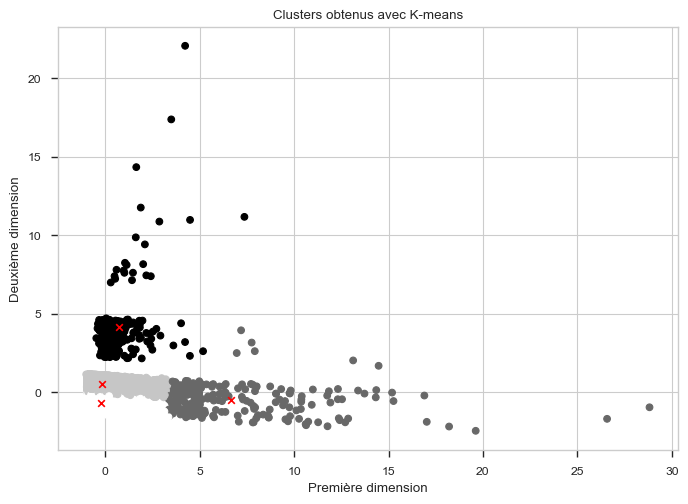

Indice de silhouette moyen : 0.4486268190234222


In [151]:
import matplotlib.pyplot as plt
from sklearn.metrics import silhouette_score

# Visualisation des clusters
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=kmeans.labels_)
plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], color='red', marker='x')
plt.xlabel('Première dimension')
plt.ylabel('Deuxième dimension')
plt.title('Clusters obtenus avec K-means')
plt.show()

# Évaluation du clustering avec l'indice de silhouette
silhouette_avg = silhouette_score(X_pca, kmeans.labels_)
print("Indice de silhouette moyen :", silhouette_avg)


Dans ce code, nous utilisons la fonction scatter de matplotlib pour créer un diagramme en nuage de points. Chaque échantillon est représenté par un point et est coloré en fonction de l'étiquette du cluster assignée par K-means. Les centres des clusters sont représentés par des croix rouges.

Ensuite, nous utilisons la fonction silhouette_score de sklearn.metrics pour calculer l'indice de silhouette moyen, qui mesure la cohésion intra-cluster et la séparation inter-cluster. Une valeur proche de 1 indique un clustering de haute qualité, tandis qu'une valeur proche de -1 indique un clustering de mauvaise qualité.

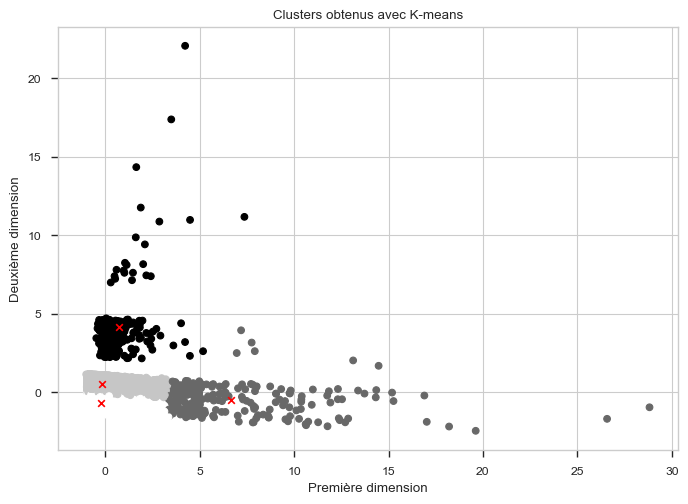

Indice de silhouette moyen : 0.4486268190234222


In [152]:
import matplotlib.pyplot as plt
from sklearn.metrics import silhouette_score

# Visualisation des clusters
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=kmeans.labels_)  # Nuage de points avec les deux premières dimensions de X_pca, coloré en fonction des étiquettes des clusters
plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], color='red', marker='x')  # Tracé des centres des clusters en rouge avec le marqueur 'x'
plt.xlabel('Première dimension')  # Étiquette de l'axe x
plt.ylabel('Deuxième dimension')  # Étiquette de l'axe y
plt.title('Clusters obtenus avec K-means')  # Titre du graphique
plt.show()  # Affichage de la visualisation des clusters

# Évaluation du clustering avec l'indice de silhouette
silhouette_avg = silhouette_score(X_pca, kmeans.labels_)  # Calcul de l'indice de silhouette moyen en utilisant X_pca et les étiquettes des clusters
print("Indice de silhouette moyen :", silhouette_avg)  # Affichage de l'indice de silhouette moyen


Ce code utilise les résultats du clustering obtenu avec K-means pour visualiser les clusters sur un graphique et évalue la qualité du clustering à l'aide de l'indice de silhouette moyen. Les commentaires décrivent chaque ligne et son objectif dans le code.

### Recherche d'un optimum du nombre de clusters

NB : intertia = Sum of squared distances of samples to their closest cluster center.

NB : intertia = Somme des distances au carré des échantillons à leur centre de grappe le plus proche.

#### 1 sample

In [153]:
inertia = {}  # Dictionnaire pour stocker les valeurs d'inertie
dict_kmeans = {}  # Dictionnaire pour stocker les objets KMeans

# Boucle pour tester différents nombres de clusters
for k in range(1, 25):
    print(k)  # Affiche le nombre de clusters en cours de traitement

    # Création de l'objet KMeans avec le nombre de clusters actuel
    kmeans = KMeans(n_clusters=k, verbose=1, random_state=0).fit(X_pca)

    # Stockage de l'inertie associée au nombre de clusters actuel dans le dictionnaire inertia
    inertia[k] = kmeans.inertia_

    # Stockage de l'objet KMeans associé au nombre de clusters actuel dans le dictionnaire dict_kmeans
    dict_kmeans[k] = kmeans


1
Initialization complete
Iteration 0, inertia 53754.52559303604.
Iteration 1, inertia 39999.99999999999.
Converged at iteration 1: strict convergence.
Initialization complete
Iteration 0, inertia 58471.73006829072.
Iteration 1, inertia 39999.99999999999.
Converged at iteration 1: strict convergence.
Initialization complete
Iteration 0, inertia 51476.13715394153.
Iteration 1, inertia 39999.99999999999.
Converged at iteration 1: strict convergence.
Initialization complete
Iteration 0, inertia 51462.46695742422.
Iteration 1, inertia 39999.99999999999.
Converged at iteration 1: strict convergence.
Initialization complete
Iteration 0, inertia 830894.7166289634.
Iteration 1, inertia 39999.99999999999.
Converged at iteration 1: strict convergence.
Initialization complete
Iteration 0, inertia 63533.22506633225.
Iteration 1, inertia 39999.99999999999.
Converged at iteration 1: strict convergence.
Initialization complete
Iteration 0, inertia 46344.73475481027.
Iteration 1, inertia 39999.9999999

Iteration 4, inertia 23143.300130931733
Iteration 5, inertia 23118.716822630304
Iteration 6, inertia 23109.339489771697
Iteration 7, inertia 23105.49715546352
Iteration 8, inertia 23103.717170538264
Iteration 9, inertia 23102.981266509494
Converged at iteration 9: center shift 9.915922757766924e-06 within tolerance 0.00010000000000000003.
Initialization complete
Iteration 0, inertia 20360.88558110214
Iteration 1, inertia 18331.514626617594
Iteration 2, inertia 18003.6402511266
Iteration 3, inertia 17890.259912530637
Iteration 4, inertia 17852.20414968564
Iteration 5, inertia 17822.49060123439
Iteration 6, inertia 17766.82391447218
Iteration 7, inertia 17653.816696061644
Iteration 8, inertia 17317.802279102325
Iteration 9, inertia 17074.407518517815
Iteration 10, inertia 16993.799294384207
Iteration 11, inertia 16962.66896781953
Iteration 12, inertia 16947.86130803888
Iteration 13, inertia 16930.703136467964
Iteration 14, inertia 16917.375952283743
Iteration 15, inertia 16904.2553472024

Iteration 0, inertia 10668.183088479218
Iteration 1, inertia 9449.582425750566
Iteration 2, inertia 9263.203583920962
Iteration 3, inertia 9147.223943540874
Iteration 4, inertia 9069.361228499865
Iteration 5, inertia 9022.809849671265
Iteration 6, inertia 9006.795203492202
Iteration 7, inertia 8998.597512615437
Iteration 8, inertia 8995.39660344745
Iteration 9, inertia 8994.27846806533
Iteration 10, inertia 8993.192473897236
Iteration 11, inertia 8992.458064697077
Iteration 12, inertia 8992.113652383556
Iteration 13, inertia 8991.907466002209
Converged at iteration 13: center shift 3.8077748350607827e-06 within tolerance 0.00010000000000000003.
Initialization complete
Iteration 0, inertia 10954.977120137659
Iteration 1, inertia 9259.644491431325
Iteration 2, inertia 9042.371512206897
Iteration 3, inertia 9000.777020680045
Iteration 4, inertia 8996.320046901848
Iteration 5, inertia 8994.56060377132
Iteration 6, inertia 8993.335095968188
Iteration 7, inertia 8992.482514725636
Converged a

Initialization complete
Iteration 0, inertia 11665.696557402925
Iteration 1, inertia 9318.9311946001
Iteration 2, inertia 9106.52900039364
Iteration 3, inertia 8577.902429651287
Iteration 4, inertia 7986.005853228261
Iteration 5, inertia 7812.276886287238
Iteration 6, inertia 7777.856406855538
Iteration 7, inertia 7770.495405365147
Iteration 8, inertia 7764.544362417456
Iteration 9, inertia 7759.943264046845
Iteration 10, inertia 7756.667004294326
Iteration 11, inertia 7751.046994721642
Iteration 12, inertia 7744.969133443337
Iteration 13, inertia 7740.215311307493
Iteration 14, inertia 7736.638315518155
Iteration 15, inertia 7732.177944930473
Iteration 16, inertia 7728.106176896055
Iteration 17, inertia 7723.424191592474
Iteration 18, inertia 7718.063815641578
Iteration 19, inertia 7713.813320274974
Iteration 20, inertia 7707.793291372333
Iteration 21, inertia 7702.769511473976
Iteration 22, inertia 7698.132531717359
Iteration 23, inertia 7695.36942760397
Iteration 24, inertia 7693.70

Iteration 0, inertia 9147.728313259398
Iteration 1, inertia 7603.883373555373
Iteration 2, inertia 7412.249003742188
Iteration 3, inertia 7349.430171443559
Iteration 4, inertia 7328.797827578549
Iteration 5, inertia 7320.412462235087
Iteration 6, inertia 7316.0545816856
Iteration 7, inertia 7312.919440027506
Iteration 8, inertia 7310.923088760805
Iteration 9, inertia 7308.955333576658
Iteration 10, inertia 7308.085673250905
Iteration 11, inertia 7306.991224519646
Iteration 12, inertia 7305.568054152265
Iteration 13, inertia 7304.637134112257
Iteration 14, inertia 7303.184360260485
Iteration 15, inertia 7301.549444785292
Iteration 16, inertia 7300.521004548457
Iteration 17, inertia 7299.591147748821
Iteration 18, inertia 7297.119539400572
Iteration 19, inertia 7290.506230719482
Iteration 20, inertia 7286.612653663813
Iteration 21, inertia 7282.813188004215
Iteration 22, inertia 7277.824821021241
Iteration 23, inertia 7273.089639968674
Iteration 24, inertia 7269.490506617745
Iteration 25

Initialization complete
Iteration 0, inertia 6989.328094621506
Iteration 1, inertia 5666.810846251505
Iteration 2, inertia 5438.62443429191
Iteration 3, inertia 5335.983900591572
Iteration 4, inertia 5240.2892097278855
Iteration 5, inertia 5154.214887762165
Iteration 6, inertia 5104.337792712534
Iteration 7, inertia 5077.434465026771
Iteration 8, inertia 5061.556053401324
Iteration 9, inertia 5054.507200862426
Iteration 10, inertia 5046.270003906207
Iteration 11, inertia 5043.201644104998
Iteration 12, inertia 5041.718474436432
Iteration 13, inertia 5040.640401467604
Iteration 14, inertia 5040.269752374423
Iteration 15, inertia 5040.025039905735
Converged at iteration 15: center shift 8.209333181573346e-05 within tolerance 0.00010000000000000003.
Initialization complete
Iteration 0, inertia 7333.684172133182
Iteration 1, inertia 6173.295227165847
Iteration 2, inertia 5971.124816414859
Iteration 3, inertia 5689.619079131042
Iteration 4, inertia 5493.218855327801
Iteration 5, inertia 537

Iteration 9, inertia 4616.708102117639
Iteration 10, inertia 4614.908205609781
Iteration 11, inertia 4613.837521142433
Iteration 12, inertia 4612.853504590709
Iteration 13, inertia 4612.330355750354
Iteration 14, inertia 4611.687053251373
Iteration 15, inertia 4611.225121548711
Iteration 16, inertia 4610.9036010124755
Converged at iteration 16: center shift 9.878709742351855e-05 within tolerance 0.00010000000000000003.
Initialization complete
Iteration 0, inertia 6167.53166588284
Iteration 1, inertia 4969.3090957733375
Iteration 2, inertia 4875.43425790219
Iteration 3, inertia 4840.635222922433
Iteration 4, inertia 4815.960627649302
Iteration 5, inertia 4800.592447430164
Iteration 6, inertia 4785.008019596891
Iteration 7, inertia 4774.23866583507
Iteration 8, inertia 4768.837772607269
Iteration 9, inertia 4761.8834031810775
Iteration 10, inertia 4759.130975400612
Iteration 11, inertia 4758.241239557267
Iteration 12, inertia 4757.098847875642
Iteration 13, inertia 4754.580349471275
Iter

Iteration 4, inertia 4297.8200935614495
Iteration 5, inertia 4260.698231817584
Iteration 6, inertia 4244.71182020714
Iteration 7, inertia 4238.975077003768
Iteration 8, inertia 4236.555299632586
Iteration 9, inertia 4235.549857811786
Iteration 10, inertia 4234.895037808741
Iteration 11, inertia 4234.151920689342
Iteration 12, inertia 4233.538804773263
Iteration 13, inertia 4233.028536487016
Iteration 14, inertia 4232.820236862452
Converged at iteration 14: center shift 9.937121752911069e-05 within tolerance 0.00010000000000000003.
Initialization complete
Iteration 0, inertia 5988.517419921434
Iteration 1, inertia 4553.7215492908135
Iteration 2, inertia 4502.131680287519
Iteration 3, inertia 4494.607786677119
Iteration 4, inertia 4491.45226974421
Iteration 5, inertia 4489.494333455157
Iteration 6, inertia 4487.3215884711535
Iteration 7, inertia 4485.428247762745
Iteration 8, inertia 4484.512058620149
Iteration 9, inertia 4483.996132870322
Iteration 10, inertia 4483.71970894825
Iteration

Initialization complete
Iteration 0, inertia 6075.562704511606
Iteration 1, inertia 5105.206858093532
Iteration 2, inertia 4910.897870233901
Iteration 3, inertia 4846.03732354402
Iteration 4, inertia 4814.682006368104
Iteration 5, inertia 4794.709094223687
Iteration 6, inertia 4782.4189841672805
Iteration 7, inertia 4773.9162942340845
Iteration 8, inertia 4767.959984397344
Iteration 9, inertia 4764.316239966738
Iteration 10, inertia 4761.972295600844
Iteration 11, inertia 4760.734389160739
Iteration 12, inertia 4759.954342099735
Iteration 13, inertia 4759.345074332656
Iteration 14, inertia 4758.991130580136
Converged at iteration 14: center shift 3.571643216084226e-05 within tolerance 0.00010000000000000003.
13
Initialization complete
Iteration 0, inertia 5442.040073394137
Iteration 1, inertia 4338.592628214577
Iteration 2, inertia 4099.23425496184
Iteration 3, inertia 4024.2468471303537
Iteration 4, inertia 4004.2639296696243
Iteration 5, inertia 3997.372841904573
Iteration 6, inertia

Iteration 7, inertia 4115.422765939283
Iteration 8, inertia 4050.00089576251
Iteration 9, inertia 3983.2247477738765
Iteration 10, inertia 3966.2805193397535
Iteration 11, inertia 3956.519002929843
Iteration 12, inertia 3951.111718335865
Iteration 13, inertia 3948.9304858526098
Iteration 14, inertia 3948.103602480268
Iteration 15, inertia 3947.5190443959937
Iteration 16, inertia 3947.157063183347
Iteration 17, inertia 3946.9524339228155
Converged at iteration 17: center shift 8.739984488853679e-05 within tolerance 0.00010000000000000003.
Initialization complete
Iteration 0, inertia 5341.502959294745
Iteration 1, inertia 4462.393742855716
Iteration 2, inertia 4378.276113994293
Iteration 3, inertia 4323.458593976251
Iteration 4, inertia 4258.608467245971
Iteration 5, inertia 4193.727141561845
Iteration 6, inertia 4130.854103772885
Iteration 7, inertia 4088.586093951526
Iteration 8, inertia 4053.6384464027833
Iteration 9, inertia 4027.4246817316825
Iteration 10, inertia 4007.541022987676


Iteration 5, inertia 3868.1886334953474
Iteration 6, inertia 3836.5916399817734
Iteration 7, inertia 3814.5566043091976
Iteration 8, inertia 3795.5792298181996
Iteration 9, inertia 3781.5759082231407
Iteration 10, inertia 3773.545555296519
Iteration 11, inertia 3770.0296176549523
Iteration 12, inertia 3767.128080446057
Iteration 13, inertia 3764.189619982996
Iteration 14, inertia 3759.7821212264585
Iteration 15, inertia 3753.0171642562773
Iteration 16, inertia 3744.7440216450345
Iteration 17, inertia 3737.5039161674376
Iteration 18, inertia 3730.8551307888624
Iteration 19, inertia 3725.9698702394408
Iteration 20, inertia 3722.1116120643255
Iteration 21, inertia 3718.914644623139
Iteration 22, inertia 3716.770918153442
Iteration 23, inertia 3715.691698249894
Iteration 24, inertia 3715.1446679657724
Iteration 25, inertia 3714.839974320355
Converged at iteration 25: center shift 7.549416108226808e-05 within tolerance 0.00010000000000000003.
Initialization complete
Iteration 0, inertia 472

Initialization complete
Iteration 0, inertia 4174.5469625550495
Iteration 1, inertia 3573.866889448779
Iteration 2, inertia 3524.6583985316706
Iteration 3, inertia 3495.700447503292
Iteration 4, inertia 3480.485626818412
Iteration 5, inertia 3473.011256947343
Iteration 6, inertia 3469.811048917762
Iteration 7, inertia 3467.7465217846952
Iteration 8, inertia 3466.324024428855
Iteration 9, inertia 3465.266422043769
Iteration 10, inertia 3464.2976260299115
Iteration 11, inertia 3463.6043639561526
Iteration 12, inertia 3463.0510392032775
Iteration 13, inertia 3462.5403047836353
Iteration 14, inertia 3462.0975085682226
Iteration 15, inertia 3461.603556820789
Iteration 16, inertia 3460.842672068517
Iteration 17, inertia 3460.3556024838886
Iteration 18, inertia 3459.865460107006
Iteration 19, inertia 3459.52117101738
Iteration 20, inertia 3459.263830418526
Converged at iteration 20: center shift 7.354726704242473e-05 within tolerance 0.00010000000000000003.
Initialization complete
Iteration 0

Initialization complete
Iteration 0, inertia 4207.14781675286
Iteration 1, inertia 3522.0120007586875
Iteration 2, inertia 3397.190929345413
Iteration 3, inertia 3358.7220108869933
Iteration 4, inertia 3330.4428758318104
Iteration 5, inertia 3300.022043293252
Iteration 6, inertia 3267.6147181863594
Iteration 7, inertia 3228.7445180405334
Iteration 8, inertia 3207.1130296412325
Iteration 9, inertia 3190.2431222775685
Iteration 10, inertia 3176.4390217586397
Iteration 11, inertia 3171.566953462927
Iteration 12, inertia 3168.789408009943
Iteration 13, inertia 3163.5450359858046
Iteration 14, inertia 3158.4903848481144
Iteration 15, inertia 3156.252390240294
Iteration 16, inertia 3154.5958421611754
Iteration 17, inertia 3153.7339866010043
Iteration 18, inertia 3153.076700280084
Iteration 19, inertia 3152.39880681426
Iteration 20, inertia 3151.6879783892173
Iteration 21, inertia 3151.1868479432214
Iteration 22, inertia 3150.654997855269
Iteration 23, inertia 3149.824071373735
Iteration 24, 

Initialization complete
Iteration 0, inertia 4181.623665959769
Iteration 1, inertia 3557.881679803232
Iteration 2, inertia 3436.319562377522
Iteration 3, inertia 3340.5063514982585
Iteration 4, inertia 3286.5227837617413
Iteration 5, inertia 3259.405051887858
Iteration 6, inertia 3241.7845736165073
Iteration 7, inertia 3224.634765672394
Iteration 8, inertia 3209.3006544807704
Iteration 9, inertia 3196.6792704970176
Iteration 10, inertia 3187.1553591427246
Iteration 11, inertia 3178.4214036270014
Iteration 12, inertia 3170.55813717282
Iteration 13, inertia 3163.5006216939564
Iteration 14, inertia 3158.039050702376
Iteration 15, inertia 3154.038863332956
Iteration 16, inertia 3150.8405126912016
Iteration 17, inertia 3147.4898413761266
Iteration 18, inertia 3143.3987249276292
Iteration 19, inertia 3139.201706796725
Iteration 20, inertia 3135.643746988863
Iteration 21, inertia 3131.3740896780782
Iteration 22, inertia 3126.862287825666
Iteration 23, inertia 3122.090454015768
Iteration 24, i

Iteration 13, inertia 2904.0306279394617
Iteration 14, inertia 2901.113939552445
Iteration 15, inertia 2899.3382277832106
Iteration 16, inertia 2898.2876443310106
Iteration 17, inertia 2897.8140437909865
Iteration 18, inertia 2897.485822250976
Iteration 19, inertia 2897.3045169920124
Converged at iteration 19: center shift 9.252798748969677e-05 within tolerance 0.00010000000000000003.
Initialization complete
Iteration 0, inertia 3483.837753211506
Iteration 1, inertia 3009.2552297459097
Iteration 2, inertia 2954.271419582614
Iteration 3, inertia 2914.799984222196
Iteration 4, inertia 2882.7038489330553
Iteration 5, inertia 2862.6475757448698
Iteration 6, inertia 2851.18137892914
Iteration 7, inertia 2842.23192800546
Iteration 8, inertia 2836.4020828646485
Iteration 9, inertia 2833.9042146018382
Iteration 10, inertia 2832.517760366633
Iteration 11, inertia 2831.299708803096
Iteration 12, inertia 2830.1729466043603
Iteration 13, inertia 2829.28809620213
Iteration 14, inertia 2828.29559075

Iteration 15, inertia 2589.353842920867
Iteration 16, inertia 2589.0933643917647
Iteration 17, inertia 2588.9703147087366
Converged at iteration 17: center shift 4.385764592401659e-05 within tolerance 0.00010000000000000003.
Initialization complete
Iteration 0, inertia 3476.670935060216
Iteration 1, inertia 2995.0757100059045
Iteration 2, inertia 2874.839940930081
Iteration 3, inertia 2845.6284657887218
Iteration 4, inertia 2828.7278772626228
Iteration 5, inertia 2812.193499402535
Iteration 6, inertia 2794.8490488726193
Iteration 7, inertia 2781.030335826479
Iteration 8, inertia 2770.021520159207
Iteration 9, inertia 2758.580516060489
Iteration 10, inertia 2742.1800281270407
Iteration 11, inertia 2725.030126844471
Iteration 12, inertia 2709.5725255992893
Iteration 13, inertia 2700.2710471544574
Iteration 14, inertia 2693.790957021535
Iteration 15, inertia 2689.2266635041947
Iteration 16, inertia 2685.4339871091875
Iteration 17, inertia 2681.4517354557815
Iteration 18, inertia 2678.5594

Iteration 20, inertia 2611.840311150345
Iteration 21, inertia 2611.469657977005
Iteration 22, inertia 2610.805225779378
Iteration 23, inertia 2609.881645681524
Iteration 24, inertia 2609.0558871128474
Iteration 25, inertia 2608.2302914311044
Iteration 26, inertia 2607.6093989555816
Iteration 27, inertia 2607.1101792719483
Iteration 28, inertia 2606.4190886345596
Iteration 29, inertia 2605.7743172310866
Iteration 30, inertia 2605.015818308814
Iteration 31, inertia 2604.2960686513356
Iteration 32, inertia 2603.5861429693014
Iteration 33, inertia 2602.926412911489
Iteration 34, inertia 2602.295969446313
Iteration 35, inertia 2602.0243602826617
Iteration 36, inertia 2601.7980663752855
Converged at iteration 36: center shift 5.291648505296848e-05 within tolerance 0.00010000000000000003.
Initialization complete
Iteration 0, inertia 3555.521817611868
Iteration 1, inertia 2788.8457622443925
Iteration 2, inertia 2735.115066612537
Iteration 3, inertia 2715.035918408088
Iteration 4, inertia 2704.

Iteration 10, inertia 2394.53844892136
Iteration 11, inertia 2392.4292006465894
Iteration 12, inertia 2388.145012622891
Iteration 13, inertia 2379.2742641327613
Iteration 14, inertia 2363.3152526335075
Iteration 15, inertia 2350.0315104103265
Iteration 16, inertia 2340.2069583546954
Iteration 17, inertia 2334.5401946450074
Iteration 18, inertia 2330.3426946186064
Iteration 19, inertia 2327.270238920106
Iteration 20, inertia 2325.0234237410286
Iteration 21, inertia 2323.3749025929924
Iteration 22, inertia 2322.250608374057
Iteration 23, inertia 2320.9253577057734
Iteration 24, inertia 2319.6248480147974
Iteration 25, inertia 2318.6588423811027
Iteration 26, inertia 2318.178613133711
Iteration 27, inertia 2317.853377429131
Iteration 28, inertia 2317.447563674042
Iteration 29, inertia 2317.315788322191
Converged at iteration 29: center shift 3.934388144020355e-05 within tolerance 0.00010000000000000003.
Initialization complete
Iteration 0, inertia 3050.878537270276
Iteration 1, inertia 24

Iteration 19, inertia 2373.2107550575074
Iteration 20, inertia 2369.257048533648
Iteration 21, inertia 2366.665964695954
Iteration 22, inertia 2364.7349801641535
Iteration 23, inertia 2363.497513515579
Iteration 24, inertia 2362.986393635381
Converged at iteration 24: center shift 7.72094185750371e-05 within tolerance 0.00010000000000000003.
Initialization complete
Iteration 0, inertia 3037.521881692647
Iteration 1, inertia 2563.4016833160263
Iteration 2, inertia 2473.924357051619
Iteration 3, inertia 2440.9526963812827
Iteration 4, inertia 2421.683385761547
Iteration 5, inertia 2407.364681779304
Iteration 6, inertia 2398.9821766753066
Iteration 7, inertia 2395.191871476758
Iteration 8, inertia 2392.863465363425
Iteration 9, inertia 2390.8386192011885
Iteration 10, inertia 2387.894126961279
Iteration 11, inertia 2384.8742680957803
Iteration 12, inertia 2383.8583585759334
Iteration 13, inertia 2382.8329198177116
Iteration 14, inertia 2381.949690146391
Iteration 15, inertia 2381.30750708

Iteration 21, inertia 2308.9447746563014
Iteration 22, inertia 2308.190554294489
Iteration 23, inertia 2307.727212301871
Iteration 24, inertia 2306.5544191091853
Iteration 25, inertia 2301.9184209121586
Iteration 26, inertia 2297.7378046784265
Iteration 27, inertia 2294.761713444519
Iteration 28, inertia 2292.901165889729
Iteration 29, inertia 2292.4741807109135
Iteration 30, inertia 2291.9106154349356
Iteration 31, inertia 2291.2407098332974
Iteration 32, inertia 2290.739272513795
Iteration 33, inertia 2290.123567054754
Iteration 34, inertia 2289.388815520863
Iteration 35, inertia 2288.962502669927
Iteration 36, inertia 2288.781561390462
Iteration 37, inertia 2288.7011146378054
Converged at iteration 37: center shift 6.96719799992886e-05 within tolerance 0.00010000000000000003.
Initialization complete
Iteration 0, inertia 3014.146823914643
Iteration 1, inertia 2653.6586134196705
Iteration 2, inertia 2558.196614512862
Iteration 3, inertia 2486.6769204616594
Iteration 4, inertia 2424.81

Iteration 6, inertia 2172.6629579364408
Iteration 7, inertia 2169.0058334086257
Iteration 8, inertia 2166.2851988283896
Iteration 9, inertia 2164.326507376282
Iteration 10, inertia 2162.8003515882256
Iteration 11, inertia 2161.2676571574602
Iteration 12, inertia 2159.606861201284
Iteration 13, inertia 2157.4205419756067
Iteration 14, inertia 2154.3151370141354
Iteration 15, inertia 2151.1134756942615
Iteration 16, inertia 2147.954957851275
Iteration 17, inertia 2144.6740894214277
Iteration 18, inertia 2141.293785838664
Iteration 19, inertia 2138.2623395510227
Iteration 20, inertia 2136.037722782388
Iteration 21, inertia 2134.7111409534054
Iteration 22, inertia 2134.1689671198037
Iteration 23, inertia 2134.0156723542445
Iteration 24, inertia 2133.891801896746
Converged at iteration 24: center shift 3.0434299913947074e-05 within tolerance 0.00010000000000000003.
Initialization complete
Iteration 0, inertia 2997.6446865540397
Iteration 1, inertia 2420.0930588851998
Iteration 2, inertia 23

Initialization complete
Iteration 0, inertia 2721.9214315531403
Iteration 1, inertia 2320.000460852269
Iteration 2, inertia 2238.8063074290817
Iteration 3, inertia 2204.6383161658327
Iteration 4, inertia 2185.741238205335
Iteration 5, inertia 2169.6368991537306
Iteration 6, inertia 2152.5471266917693
Iteration 7, inertia 2133.6731975071334
Iteration 8, inertia 2118.8493398643254
Iteration 9, inertia 2104.3870171600433
Iteration 10, inertia 2088.7816777577455
Iteration 11, inertia 2076.0405587113582
Iteration 12, inertia 2064.899918663222
Iteration 13, inertia 2057.5040189992437
Iteration 14, inertia 2052.8443267619314
Iteration 15, inertia 2049.558911197922
Iteration 16, inertia 2047.1435578932842
Iteration 17, inertia 2044.352169995732
Iteration 18, inertia 2041.4970749506947
Iteration 19, inertia 2039.0950265440229
Iteration 20, inertia 2036.6138266926246
Iteration 21, inertia 2034.603673665716
Iteration 22, inertia 2033.1239744692095
Iteration 23, inertia 2031.7334075339884
Iteratio

Iteration 23, inertia 2037.5190363845613
Iteration 24, inertia 2037.057247795617
Iteration 25, inertia 2036.7356835743094
Iteration 26, inertia 2036.5139100344736
Iteration 27, inertia 2036.3404347917663
Iteration 28, inertia 2036.1667024234912
Iteration 29, inertia 2035.88242264343
Iteration 30, inertia 2035.5524171299805
Iteration 31, inertia 2035.2287395510882
Iteration 32, inertia 2034.5436125598271
Iteration 33, inertia 2033.9844696790924
Iteration 34, inertia 2033.5867262484894
Iteration 35, inertia 2033.2822228118048
Iteration 36, inertia 2032.9233407025445
Iteration 37, inertia 2032.6312097519349
Iteration 38, inertia 2032.4751691026352
Iteration 39, inertia 2032.2240001620105
Iteration 40, inertia 2032.0832677694234
Iteration 41, inertia 2031.9927725004595
Iteration 42, inertia 2031.9573071573982
Converged at iteration 42: center shift 3.911156291529751e-05 within tolerance 0.00010000000000000003.
Initialization complete
Iteration 0, inertia 2725.5292900968784
Iteration 1, ine

Ce code effectue une boucle pour tester différents nombres de clusters (de 1 à 24). À chaque itération, il crée un objet KMeans avec le nombre de clusters actuel et ajuste le modèle sur les données X_pca. Ensuite, il stocke l'inertie associée à ce nombre de clusters dans le dictionnaire inertia. L'inertie est accessible via la méthode kmeans.inertia_. Enfin, l'objet KMeans est stocké dans le dictionnaire dict_kmeans pour une utilisation ultérieure si nécessaire.

Ainsi, l'inertie associée à un nombre de clusters permet de quantifier la cohésion des points dans chaque cluster et d'évaluer la qualité du clustering en termes de compacité et de séparation des clusters.

<Axes: title={'center': 'Kmeans: Comparaison de la somme des inerties en fonction du nombre de clusters'}>

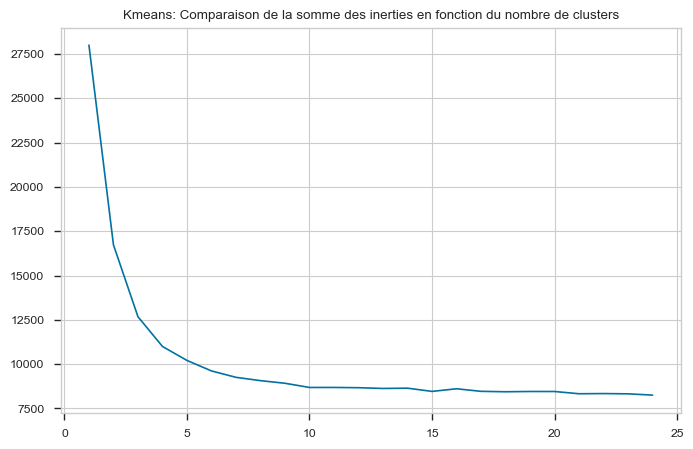

In [54]:
plt.figure(figsize=(8,5))
plt.title('Kmeans: Comparaison de la somme des inerties en fonction du nombre de clusters')
sns.lineplot(list(inertia.keys()),
             list(inertia.values())
            )

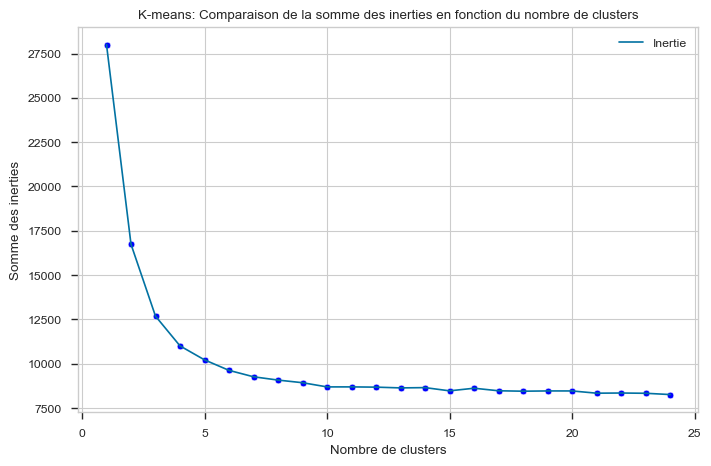

In [55]:
plt.figure(figsize=(8, 5))  # Crée une nouvelle figure avec une taille de 8 pouces de largeur et 5 pouces de hauteur
plt.title('K-means: Comparaison de la somme des inerties en fonction du nombre de clusters')  # Définit le titre du graphique
sns.lineplot(list(inertia.keys()), list(inertia.values()))  # Trace une courbe de ligne avec les clés et les valeurs de l'inertie

# Les lignes suivantes sont facultatives et dépendent de vos besoins de visualisation :

# Ajouter des marqueurs sur les points de la courbe
sns.scatterplot(list(inertia.keys()), list(inertia.values()), color='blue', marker='o')

# Ajouter une ligne droite de référence
# plt.axhline(y=reference_value, color='red', linestyle='--')

# Configurer les étiquettes des axes, les légendes, etc.
plt.xlabel('Nombre de clusters')
plt.ylabel('Somme des inerties')
plt.legend(['Inertie'])
# ...

plt.show()  # Affiche le graphique


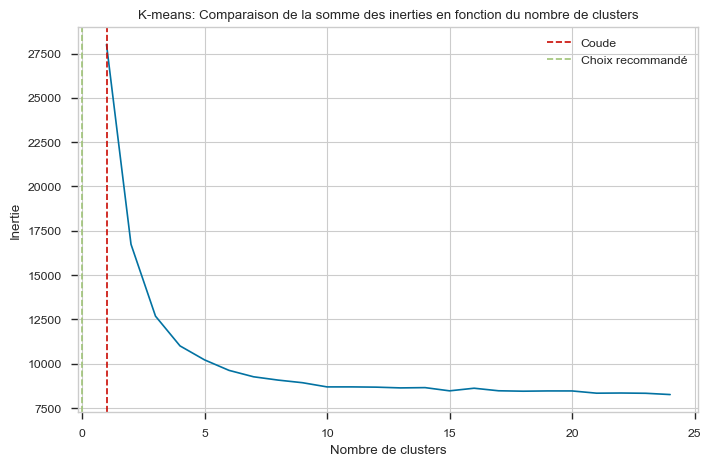

In [56]:
plt.figure(figsize=(8, 5))
plt.title('K-means: Comparaison de la somme des inerties en fonction du nombre de clusters')
sns.lineplot(list(inertia.keys()), list(inertia.values()))

# Trouver le coude de la courbe
diff_inertia = np.diff(list(inertia.values()))
second_diff = np.diff(diff_inertia)
elbow_index = np.argmax(second_diff) + 1  # Ajouter 1 pour compenser la différence

# Tracer des lignes pour indiquer le bon endroit
plt.axvline(x=elbow_index, color='r', linestyle='--', label='Coude')
plt.axvline(x=elbow_index-1, color='g', linestyle='--', label='Choix recommandé')

plt.xlabel('Nombre de clusters')
plt.ylabel('Inertie')
plt.legend()
plt.show()


#### n samples

In [57]:
# inertia = {}
# dict_kmeans = {}

# nb_boucles=3
# max_clusters = 25

# for k in range(1,nb_boucles+1):
#     print('Boucle ',k)
#     for i in range(1,max_clusters+1):
#         kmeans = KMeans(n_clusters=i,
#                        verbose=1).fit(X_pca)
#         inertia[(k,i)] = kmeans.inertia_
#         dict_kmeans[k,i] = kmeans
        
inertia = {}  # Dictionnaire pour stocker les valeurs d'inertie
dict_kmeans = {}  # Dictionnaire pour stocker les objets KMeans

nb_boucles = 3  # Nombre de boucles à effectuer
max_clusters = 25  # Nombre maximal de clusters à tester

# Boucle externe pour les différentes boucles
for k in range(1, nb_boucles + 1):
    print('Boucle', k)  # Affiche le numéro de boucle en cours

    # Boucle interne pour tester différents nombres de clusters
    for i in range(1, max_clusters + 1):
        # Création de l'objet KMeans avec le nombre de clusters actuel
        kmeans = KMeans(n_clusters=i, verbose=1).fit(X_pca)

        # Stockage de l'inertie associée à la paire (k, i) dans le dictionnaire inertia
        inertia[(k, i)] = kmeans.inertia_

        # Stockage de l'objet KMeans associé à la paire (k, i) dans le dictionnaire dict_kmeans
        dict_kmeans[(k, i)] = kmeans

Boucle 1
Initialization complete
Iteration 0, inertia 39768.96179049359.
Iteration 1, inertia 28004.998939075518.
Converged at iteration 1: strict convergence.
Initialization complete
Iteration 0, inertia 37467.160845571045.
Iteration 1, inertia 28004.998939075518.
Converged at iteration 1: strict convergence.
Initialization complete
Iteration 0, inertia 39656.83627188623.
Iteration 1, inertia 28004.998939075518.
Converged at iteration 1: strict convergence.
Initialization complete
Iteration 0, inertia 42394.6274233066.
Iteration 1, inertia 28004.998939075518.
Converged at iteration 1: strict convergence.
Initialization complete
Iteration 0, inertia 40936.03321416653.
Iteration 1, inertia 28004.998939075518.
Converged at iteration 1: strict convergence.
Initialization complete
Iteration 0, inertia 46517.4577262205.
Iteration 1, inertia 28004.998939075518.
Converged at iteration 1: strict convergence.
Initialization complete
Iteration 0, inertia 37140.106069928355.
Iteration 1, inertia 

Iteration 0, inertia 19720.679028525778
Iteration 1, inertia 12967.053028619133
Iteration 2, inertia 12803.385737671028
Iteration 3, inertia 12709.438028827964
Iteration 4, inertia 12692.507565777634
Iteration 5, inertia 12679.771034102892
Iteration 6, inertia 12676.652664843306
Iteration 7, inertia 12675.471971763165
Iteration 8, inertia 12675.088612780855
Iteration 9, inertia 12674.774397088218
Iteration 10, inertia 12674.767912006948
Iteration 11, inertia 12674.765340190299
Converged at iteration 11: strict convergence.
Initialization complete
Iteration 0, inertia 23513.137080130655
Iteration 1, inertia 13290.8826686467
Iteration 2, inertia 12923.520895397276
Iteration 3, inertia 12783.884179781255
Iteration 4, inertia 12734.126769451088
Iteration 5, inertia 12709.456748753748
Iteration 6, inertia 12691.809577360806
Iteration 7, inertia 12683.215894913114
Iteration 8, inertia 12678.758358849971
Iteration 9, inertia 12676.319303513463
Iteration 10, inertia 12675.3876493805
Iteration 

Iteration 5, inertia 11145.157999001649
Iteration 6, inertia 11071.622785036134
Iteration 7, inertia 11034.666012733169
Iteration 8, inertia 11019.216706179817
Iteration 9, inertia 11013.056990825544
Iteration 10, inertia 11009.086608403746
Iteration 11, inertia 11005.984597510374
Iteration 12, inertia 11001.837245877143
Iteration 13, inertia 10999.624887485701
Iteration 14, inertia 10998.347002366003
Iteration 15, inertia 10997.129299908916
Iteration 16, inertia 10996.516745406198
Iteration 17, inertia 10996.373297028054
Iteration 18, inertia 10996.29631971115
Iteration 19, inertia 10996.270292615467
Iteration 20, inertia 10996.259500012373
Iteration 21, inertia 10996.253406048956
Iteration 22, inertia 10996.252428536096
Iteration 23, inertia 10996.251771834433
Converged at iteration 23: strict convergence.
Initialization complete
Iteration 0, inertia 18645.35226190754
Iteration 1, inertia 12976.54336660028
Iteration 2, inertia 12843.712846122433
Iteration 3, inertia 12771.57243981262

Iteration 9, inertia 10996.43133539007
Iteration 10, inertia 10996.32319978415
Iteration 11, inertia 10996.287537212136
Iteration 12, inertia 10996.264000903058
Iteration 13, inertia 10996.25451195735
Iteration 14, inertia 10996.252428536096
Iteration 15, inertia 10996.251771834433
Converged at iteration 15: strict convergence.
Initialization complete
Iteration 0, inertia 19524.33886408198
Iteration 1, inertia 10326.812463773282
Iteration 2, inertia 10308.81013193654
Iteration 3, inertia 10298.455412356056
Iteration 4, inertia 10290.772031116197
Iteration 5, inertia 10286.758456729689
Iteration 6, inertia 10285.140556613178
Iteration 7, inertia 10283.23421359343
Iteration 8, inertia 10281.418934196548
Iteration 9, inertia 10276.6043159605
Iteration 10, inertia 10266.588060591388
Iteration 11, inertia 10251.833788594522
Iteration 12, inertia 10237.771176785862
Iteration 13, inertia 10229.213925909558
Iteration 14, inertia 10219.715345775445
Iteration 15, inertia 10217.429000415552
Itera

Iteration 5, inertia 11159.035133266567
Iteration 6, inertia 11086.913551899865
Iteration 7, inertia 11044.949900969918
Iteration 8, inertia 11023.22849165453
Iteration 9, inertia 11014.56748340671
Iteration 10, inertia 11009.498322743533
Iteration 11, inertia 11006.008763482176
Iteration 12, inertia 11002.024383307784
Iteration 13, inertia 10999.151720724867
Iteration 14, inertia 10997.897859533836
Iteration 15, inertia 10996.676397306099
Iteration 16, inertia 10995.824502161484
Iteration 17, inertia 10995.496052397742
Iteration 18, inertia 10995.371978236884
Iteration 19, inertia 10995.30750798263
Iteration 20, inertia 10995.283085962472
Iteration 21, inertia 10995.274746135314
Iteration 22, inertia 10995.270502116959
Iteration 23, inertia 10995.269538850065
Iteration 24, inertia 10995.268882125562
Converged at iteration 24: strict convergence.
Initialization complete
Iteration 0, inertia 18524.86878801677
Iteration 1, inertia 12647.214923495254
Iteration 2, inertia 11777.56671946266

Iteration 17, inertia 10209.403995465102
Iteration 18, inertia 10209.275981865128
Iteration 19, inertia 10209.00532604221
Iteration 20, inertia 10208.66667736483
Iteration 21, inertia 10208.471984347092
Iteration 22, inertia 10208.360580605013
Iteration 23, inertia 10208.14986990857
Iteration 24, inertia 10208.037695279296
Iteration 25, inertia 10207.956090323387
Iteration 26, inertia 10207.872690911941
Iteration 27, inertia 10207.775722764052
Iteration 28, inertia 10207.69010834487
Iteration 29, inertia 10207.655983706667
Iteration 30, inertia 10207.641699362443
Iteration 31, inertia 10207.636465535572
Iteration 32, inertia 10207.630330749827
Iteration 33, inertia 10207.623021078829
Iteration 34, inertia 10207.612006512767
Iteration 35, inertia 10207.604665368595
Iteration 36, inertia 10207.602138675698
Iteration 37, inertia 10207.60166053641
Converged at iteration 37: strict convergence.
Initialization complete
Iteration 0, inertia 22644.564804566766
Iteration 1, inertia 13419.724733

Iteration 48, inertia 10206.665841316717
Converged at iteration 48: strict convergence.
Initialization complete
Iteration 0, inertia 16665.328322843816
Iteration 1, inertia 9709.100015724916
Iteration 2, inertia 9666.956859388965
Iteration 3, inertia 9659.306410351051
Iteration 4, inertia 9654.057545884629
Iteration 5, inertia 9647.777442233517
Iteration 6, inertia 9641.890384863964
Iteration 7, inertia 9636.066212030042
Iteration 8, inertia 9629.300302772985
Iteration 9, inertia 9626.302030991548
Iteration 10, inertia 9625.422521217444
Iteration 11, inertia 9624.153688432132
Iteration 12, inertia 9622.898072269292
Iteration 13, inertia 9620.677651558422
Iteration 14, inertia 9618.637399667616
Iteration 15, inertia 9617.528565574126
Iteration 16, inertia 9616.613707186674
Iteration 17, inertia 9616.189910911178
Iteration 18, inertia 9615.849499106727
Iteration 19, inertia 9615.305063366222
Iteration 20, inertia 9614.671900337957
Iteration 21, inertia 9614.123592720745
Iteration 22, ine

Iteration 5, inertia 10277.216033007287
Iteration 6, inertia 10267.150976911707
Iteration 7, inertia 10247.245110431351
Iteration 8, inertia 10232.231924438824
Iteration 9, inertia 10222.285263416552
Iteration 10, inertia 10216.94775942427
Iteration 11, inertia 10215.263489029814
Iteration 12, inertia 10214.370884633645
Iteration 13, inertia 10214.031308281454
Iteration 14, inertia 10214.00834732277
Iteration 15, inertia 10213.945327859481
Iteration 16, inertia 10213.838044131882
Iteration 17, inertia 10213.702191411938
Iteration 18, inertia 10213.525147087037
Iteration 19, inertia 10213.2668976993
Iteration 20, inertia 10213.054905596942
Iteration 21, inertia 10212.537448970157
Iteration 22, inertia 10211.985697933855
Iteration 23, inertia 10211.769269835258
Iteration 24, inertia 10211.44725868314
Iteration 25, inertia 10209.187100117673
Iteration 26, inertia 10207.758972994823
Iteration 27, inertia 10207.64818695457
Iteration 28, inertia 10207.541637087228
Iteration 29, inertia 10207

Iteration 41, inertia 10206.720106166233
Iteration 42, inertia 10206.485906597354
Iteration 43, inertia 10206.388908301598
Iteration 44, inertia 10206.280519397078
Iteration 45, inertia 10206.197078776975
Iteration 46, inertia 10206.097490237371
Iteration 47, inertia 10206.048293617921
Iteration 48, inertia 10206.015163197846
Iteration 49, inertia 10206.007165292414
Iteration 50, inertia 10206.001033904095
Iteration 51, inertia 10205.996356023992
Iteration 52, inertia 10205.988077607311
Iteration 53, inertia 10205.978825482605
Iteration 54, inertia 10205.974334130671
Iteration 55, inertia 10205.971811701484
Iteration 56, inertia 10205.97133347077
Converged at iteration 56: strict convergence.
Initialization complete
Iteration 0, inertia 17340.958207557902
Iteration 1, inertia 9742.624893960194
Iteration 2, inertia 9616.091611712447
Iteration 3, inertia 9547.30290929088
Iteration 4, inertia 9512.28134323408
Iteration 5, inertia 9488.852261873551
Iteration 6, inertia 9473.671029434612
It

Iteration 46, inertia 9555.025469498258
Iteration 47, inertia 9554.871340110634
Iteration 48, inertia 9554.585286230584
Iteration 49, inertia 9554.286627668738
Iteration 50, inertia 9554.038019503132
Iteration 51, inertia 9553.872208473664
Iteration 52, inertia 9553.758298661776
Iteration 53, inertia 9553.614420761134
Iteration 54, inertia 9553.51410148353
Iteration 55, inertia 9553.492090516873
Iteration 56, inertia 9553.473564042011
Iteration 57, inertia 9553.464613956021
Iteration 58, inertia 9553.458954099588
Iteration 59, inertia 9553.455746112755
Iteration 60, inertia 9553.45525858854
Converged at iteration 60: strict convergence.
Initialization complete
Iteration 0, inertia 16602.60346953859
Iteration 1, inertia 9891.877235810294
Iteration 2, inertia 9746.459420302146
Iteration 3, inertia 9649.907631041751
Iteration 4, inertia 9608.195072093298
Iteration 5, inertia 9582.402526689202
Iteration 6, inertia 9573.5339745069
Iteration 7, inertia 9564.044549621165
Iteration 8, inertia 

Iteration 45, inertia 10205.493787986139
Iteration 46, inertia 10205.283956314202
Iteration 47, inertia 10205.1720860253
Iteration 48, inertia 10205.090878860592
Iteration 49, inertia 10205.010896056854
Iteration 50, inertia 10204.921296198525
Iteration 51, inertia 10204.826967060966
Iteration 52, inertia 10204.793273953921
Iteration 53, inertia 10204.779184995958
Iteration 54, inertia 10204.774157063674
Iteration 55, inertia 10204.769293432699
Iteration 56, inertia 10204.764748849055
Iteration 57, inertia 10204.756651582004
Iteration 58, inertia 10204.747581312466
Iteration 59, inertia 10204.743220400034
Iteration 60, inertia 10204.741401130157
Iteration 61, inertia 10204.740269110982
Converged at iteration 61: strict convergence.
Initialization complete
Iteration 0, inertia 13664.263880206187
Iteration 1, inertia 10005.14342873338
Iteration 2, inertia 9756.394987808306
Iteration 3, inertia 9579.021456782444
Iteration 4, inertia 9439.557253963725
Iteration 5, inertia 9349.068474670265

Iteration 33, inertia 9073.173168951591
Iteration 34, inertia 9071.992315664884
Iteration 35, inertia 9070.433848081408
Iteration 36, inertia 9069.148063859531
Iteration 37, inertia 9068.683026767743
Iteration 38, inertia 9068.458480899066
Iteration 39, inertia 9068.31877659755
Iteration 40, inertia 9068.122276786049
Iteration 41, inertia 9067.835860114728
Iteration 42, inertia 9067.68524194525
Iteration 43, inertia 9067.562984707263
Iteration 44, inertia 9067.44374221018
Iteration 45, inertia 9067.355192176443
Iteration 46, inertia 9067.272291510704
Iteration 47, inertia 9067.21962740345
Iteration 48, inertia 9067.166748396647
Iteration 49, inertia 9067.134181495645
Iteration 50, inertia 9067.063510549468
Iteration 51, inertia 9066.958005544966
Iteration 52, inertia 9066.857303563575
Iteration 53, inertia 9066.841202218471
Iteration 54, inertia 9066.83153814636
Iteration 55, inertia 9066.826198562407
Iteration 56, inertia 9066.823200413677
Iteration 57, inertia 9066.821094247709
Itera

Iteration 28, inertia 9391.610090105856
Iteration 29, inertia 9391.257113889757
Iteration 30, inertia 9390.911195212793
Iteration 31, inertia 9390.55713023262
Iteration 32, inertia 9390.267577363216
Iteration 33, inertia 9390.08375195621
Iteration 34, inertia 9389.948156033175
Iteration 35, inertia 9389.762907385222
Iteration 36, inertia 9389.45368381646
Iteration 37, inertia 9388.96322458731
Iteration 38, inertia 9387.836566380049
Iteration 39, inertia 9386.338277904038
Iteration 40, inertia 9385.497860830543
Iteration 41, inertia 9384.273968911752
Iteration 42, inertia 9381.952348256482
Iteration 43, inertia 9379.293390722596
Iteration 44, inertia 9374.54434188629
Iteration 45, inertia 9369.435602575424
Iteration 46, inertia 9355.75805762525
Iteration 47, inertia 9338.800003552908
Iteration 48, inertia 9331.479577093905
Iteration 49, inertia 9316.511870834405
Iteration 50, inertia 9297.432710578698
Iteration 51, inertia 9279.367030132844
Iteration 52, inertia 9273.011417666707
Iterat

Iteration 37, inertia 9065.912031450474
Iteration 38, inertia 9065.908678099673
Iteration 39, inertia 9065.904246664908
Iteration 40, inertia 9065.896161117358
Iteration 41, inertia 9065.889034911062
Iteration 42, inertia 9065.88045637969
Iteration 43, inertia 9065.878034206235
Iteration 44, inertia 9065.87698604384
Converged at iteration 44: strict convergence.
Initialization complete
Iteration 0, inertia 17375.44959387945
Iteration 1, inertia 9390.16395125079
Iteration 2, inertia 9337.47854265297
Iteration 3, inertia 9317.512023186084
Iteration 4, inertia 9304.563226003955
Iteration 5, inertia 9290.737656641239
Iteration 6, inertia 9277.11975896923
Iteration 7, inertia 9264.796487902528
Iteration 8, inertia 9253.337918599656
Iteration 9, inertia 9245.451455128847
Iteration 10, inertia 9239.074252055445
Iteration 11, inertia 9229.241061020863
Iteration 12, inertia 9212.83582561284
Iteration 13, inertia 9193.302881377262
Iteration 14, inertia 9167.155032342358
Iteration 15, inertia 914

Iteration 23, inertia 8780.214864475118
Iteration 24, inertia 8780.153139056998
Iteration 25, inertia 8780.10348613374
Iteration 26, inertia 8780.064520198846
Iteration 27, inertia 8779.978732630374
Iteration 28, inertia 8779.961072164468
Iteration 29, inertia 8779.957619050934
Iteration 30, inertia 8779.957128074693
Converged at iteration 30: strict convergence.
Initialization complete
Iteration 0, inertia 17777.5282489092
Iteration 1, inertia 9285.617507171693
Iteration 2, inertia 9189.776072926648
Iteration 3, inertia 9132.669663282428
Iteration 4, inertia 9108.483926059813
Iteration 5, inertia 9088.680288637672
Iteration 6, inertia 9074.922736570408
Iteration 7, inertia 9066.659915576118
Iteration 8, inertia 9061.196278010004
Iteration 9, inertia 9057.853811988138
Iteration 10, inertia 9056.269859432754
Iteration 11, inertia 9055.279901857291
Iteration 12, inertia 9054.661343480384
Iteration 13, inertia 9054.175242082436
Iteration 14, inertia 9053.689173685565
Iteration 15, inertia

Iteration 24, inertia 8997.653466931975
Iteration 25, inertia 8997.645670236641
Iteration 26, inertia 8997.633076563105
Iteration 27, inertia 8997.626020539863
Iteration 28, inertia 8997.609832358336
Iteration 29, inertia 8997.592588112937
Iteration 30, inertia 8997.576222834756
Iteration 31, inertia 8997.560784516987
Iteration 32, inertia 8997.547022932407
Iteration 33, inertia 8997.530656123092
Iteration 34, inertia 8997.513066846706
Iteration 35, inertia 8997.503529686663
Iteration 36, inertia 8997.494221643403
Iteration 37, inertia 8997.48202769067
Iteration 38, inertia 8997.453936562566
Iteration 39, inertia 8997.410495180036
Iteration 40, inertia 8997.380247980538
Iteration 41, inertia 8997.356378828854
Iteration 42, inertia 8997.332861548737
Iteration 43, inertia 8997.32226076356
Iteration 44, inertia 8997.316603752108
Iteration 45, inertia 8997.315456594686
Iteration 46, inertia 8997.312109295175
Iteration 47, inertia 8997.31090721237
Converged at iteration 47: strict convergen

Iteration 16, inertia 8686.232871942859
Iteration 17, inertia 8686.099600828391
Iteration 18, inertia 8685.985951044451
Iteration 19, inertia 8685.876193350527
Iteration 20, inertia 8685.72627438681
Iteration 21, inertia 8685.58677371229
Iteration 22, inertia 8685.461918962277
Iteration 23, inertia 8685.317628984665
Iteration 24, inertia 8685.169943919458
Iteration 25, inertia 8685.088633656946
Iteration 26, inertia 8685.0018487305
Iteration 27, inertia 8684.922334944074
Iteration 28, inertia 8684.851479988729
Iteration 29, inertia 8684.805393544766
Iteration 30, inertia 8684.757192720832
Iteration 31, inertia 8684.702498968296
Iteration 32, inertia 8684.627460591888
Iteration 33, inertia 8684.580223597088
Iteration 34, inertia 8684.534840954904
Iteration 35, inertia 8684.454258391206
Iteration 36, inertia 8684.383633955224
Iteration 37, inertia 8684.328944796125
Iteration 38, inertia 8684.278522373781
Iteration 39, inertia 8684.240576171946
Iteration 40, inertia 8684.180399921142
Iter

Iteration 21, inertia 9451.95076700787
Iteration 22, inertia 9451.795878320936
Iteration 23, inertia 9451.726567744205
Iteration 24, inertia 9451.677656350255
Iteration 25, inertia 9451.618563033247
Iteration 26, inertia 9451.554382116858
Iteration 27, inertia 9451.51722760424
Iteration 28, inertia 9451.477994376386
Iteration 29, inertia 9451.433500375533
Iteration 30, inertia 9451.384380130736
Iteration 31, inertia 9451.338967063866
Iteration 32, inertia 9451.29374136715
Iteration 33, inertia 9451.253359274924
Iteration 34, inertia 9451.204683578702
Iteration 35, inertia 9451.147166135794
Iteration 36, inertia 9451.0585208184
Iteration 37, inertia 9450.927910427916
Iteration 38, inertia 9450.721592661974
Iteration 39, inertia 9450.36538493231
Iteration 40, inertia 9450.012489809404
Iteration 41, inertia 9449.541064507734
Iteration 42, inertia 9449.150506101327
Iteration 43, inertia 9448.962749075385
Iteration 44, inertia 9448.711529964034
Iteration 45, inertia 9448.337488255253
Iterat

Iteration 22, inertia 8929.97391328429
Iteration 23, inertia 8929.928202742718
Iteration 24, inertia 8929.893745279833
Iteration 25, inertia 8929.876592110519
Iteration 26, inertia 8929.86183925634
Iteration 27, inertia 8929.857531302823
Iteration 28, inertia 8929.847900405784
Iteration 29, inertia 8929.83608033212
Iteration 30, inertia 8929.827878115
Iteration 31, inertia 8929.819230503837
Iteration 32, inertia 8929.801896792322
Iteration 33, inertia 8929.792701127692
Iteration 34, inertia 8929.786115750012
Iteration 35, inertia 8929.771965645783
Iteration 36, inertia 8929.760218973874
Iteration 37, inertia 8929.747619380363
Iteration 38, inertia 8929.737470402793
Iteration 39, inertia 8929.719482537783
Iteration 40, inertia 8929.704248510125
Iteration 41, inertia 8929.695915077034
Iteration 42, inertia 8929.690474678728
Iteration 43, inertia 8929.68761884129
Iteration 44, inertia 8929.684874648248
Iteration 45, inertia 8929.680283271053
Iteration 46, inertia 8929.671712188994
Iterati

Iteration 1, inertia 8852.019677557582
Iteration 2, inertia 8726.638883069625
Iteration 3, inertia 8673.581965639474
Iteration 4, inertia 8651.150890210889
Iteration 5, inertia 8640.163966815358
Iteration 6, inertia 8627.760283166419
Iteration 7, inertia 8616.688243439501
Iteration 8, inertia 8605.77163002022
Iteration 9, inertia 8598.186989660142
Iteration 10, inertia 8591.558287776332
Iteration 11, inertia 8588.782993367457
Iteration 12, inertia 8586.79481815844
Iteration 13, inertia 8585.013495922447
Iteration 14, inertia 8584.045032664171
Iteration 15, inertia 8583.339966283796
Iteration 16, inertia 8582.970934502742
Iteration 17, inertia 8582.750519630285
Iteration 18, inertia 8582.587766520912
Iteration 19, inertia 8582.490905149818
Iteration 20, inertia 8582.411212413
Iteration 21, inertia 8582.379427087018
Iteration 22, inertia 8582.335614188065
Iteration 23, inertia 8582.2928577217
Iteration 24, inertia 8582.2651572148
Iteration 25, inertia 8582.249296526008
Iteration 26, iner

Iteration 45, inertia 9026.495833184292
Iteration 46, inertia 9026.458846448728
Iteration 47, inertia 9026.427069895992
Iteration 48, inertia 9026.395340182818
Iteration 49, inertia 9026.383255944991
Iteration 50, inertia 9026.36551547495
Iteration 51, inertia 9026.330459226807
Iteration 52, inertia 9026.302484816164
Iteration 53, inertia 9026.276037710215
Iteration 54, inertia 9026.25166185889
Iteration 55, inertia 9026.221111233257
Iteration 56, inertia 9026.166244483706
Iteration 57, inertia 9026.12228419783
Iteration 58, inertia 9026.103884163642
Iteration 59, inertia 9026.08533806364
Iteration 60, inertia 9026.049140517762
Iteration 61, inertia 9026.014584885324
Iteration 62, inertia 9025.995651182244
Iteration 63, inertia 9025.978643238617
Iteration 64, inertia 9025.974661501348
Iteration 65, inertia 9025.97274144329
Iteration 66, inertia 9025.96885910044
Iteration 67, inertia 9025.968288383003
Iteration 68, inertia 9025.967741735982
Iteration 69, inertia 9025.966852376498
Iterat

Iteration 4, inertia 8597.221772159057
Iteration 5, inertia 8594.740616953553
Iteration 6, inertia 8594.080039541343
Iteration 7, inertia 8593.791206511783
Iteration 8, inertia 8593.647654580054
Iteration 9, inertia 8593.532074597715
Iteration 10, inertia 8593.49225968101
Iteration 11, inertia 8593.480065985834
Iteration 12, inertia 8593.478885487177
Converged at iteration 12: strict convergence.
Initialization complete
Iteration 0, inertia 14404.86918311518
Iteration 1, inertia 8847.563557205665
Iteration 2, inertia 8725.70145437469
Iteration 3, inertia 8704.292696713133
Iteration 4, inertia 8693.816141151265
Iteration 5, inertia 8686.913669976613
Iteration 6, inertia 8683.22710474434
Iteration 7, inertia 8680.955032168893
Iteration 8, inertia 8679.612974662272
Iteration 9, inertia 8678.781234375834
Iteration 10, inertia 8678.242740672778
Iteration 11, inertia 8677.905473511593
Iteration 12, inertia 8677.73713215059
Iteration 13, inertia 8677.643657493121
Iteration 14, inertia 8677.57

Iteration 16, inertia 8764.39400640242
Iteration 17, inertia 8764.273487593084
Iteration 18, inertia 8764.255121716951
Iteration 19, inertia 8764.24478376405
Iteration 20, inertia 8764.235328532155
Iteration 21, inertia 8764.19834206276
Iteration 22, inertia 8764.161001904327
Iteration 23, inertia 8764.13779483724
Iteration 24, inertia 8764.112324574795
Iteration 25, inertia 8764.085424589492
Iteration 26, inertia 8764.072336338737
Iteration 27, inertia 8764.067058764835
Iteration 28, inertia 8764.064303339757
Iteration 29, inertia 8764.062712727424
Converged at iteration 29: strict convergence.
Initialization complete
Iteration 0, inertia 14247.435833676827
Iteration 1, inertia 8758.48302386248
Iteration 2, inertia 8713.771773193992
Iteration 3, inertia 8691.301748975715
Iteration 4, inertia 8671.771199609528
Iteration 5, inertia 8659.854802390031
Iteration 6, inertia 8651.681902864828
Iteration 7, inertia 8645.903563109221
Iteration 8, inertia 8641.224105946
Iteration 9, inertia 8637

Iteration 20, inertia 8858.542012063144
Iteration 21, inertia 8858.156414651912
Iteration 22, inertia 8858.054678635197
Iteration 23, inertia 8858.031924451543
Iteration 24, inertia 8858.02255908459
Converged at iteration 24: strict convergence.
Initialization complete
Iteration 0, inertia 15023.94234938775
Iteration 1, inertia 8766.80383842842
Iteration 2, inertia 8638.407102779569
Iteration 3, inertia 8610.555267167265
Iteration 4, inertia 8603.00015508125
Iteration 5, inertia 8600.05135544994
Iteration 6, inertia 8598.386077134808
Iteration 7, inertia 8596.30397959858
Iteration 8, inertia 8593.969997087794
Iteration 9, inertia 8592.156025870681
Iteration 10, inertia 8590.925806457108
Iteration 11, inertia 8589.926661680178
Iteration 12, inertia 8589.346714770812
Iteration 13, inertia 8588.847226407353
Iteration 14, inertia 8588.19268276485
Iteration 15, inertia 8587.199940288683
Iteration 16, inertia 8586.052613626767
Iteration 17, inertia 8585.18001209412
Iteration 18, inertia 8584

Iteration 49, inertia 8675.251912611277
Iteration 50, inertia 8675.224343349486
Iteration 51, inertia 8675.18343159481
Iteration 52, inertia 8675.111486503067
Iteration 53, inertia 8675.057749734933
Iteration 54, inertia 8675.010531763905
Iteration 55, inertia 8674.96847666514
Iteration 56, inertia 8674.928783480698
Iteration 57, inertia 8674.90198527848
Iteration 58, inertia 8674.86579724174
Iteration 59, inertia 8674.84601358769
Iteration 60, inertia 8674.835002883823
Iteration 61, inertia 8674.826343945188
Iteration 62, inertia 8674.816552453645
Iteration 63, inertia 8674.806684284235
Iteration 64, inertia 8674.782736751202
Iteration 65, inertia 8674.771137200061
Iteration 66, inertia 8674.760844647362
Iteration 67, inertia 8674.748815681285
Iteration 68, inertia 8674.742255900572
Iteration 69, inertia 8674.73778081829
Iteration 70, inertia 8674.718769536748
Iteration 71, inertia 8674.695908859638
Iteration 72, inertia 8674.688660687132
Iteration 73, inertia 8674.688323515493
Iterat

Iteration 57, inertia 8679.701291588348
Iteration 58, inertia 8679.684322973704
Iteration 59, inertia 8679.661779640173
Iteration 60, inertia 8679.644859550277
Iteration 61, inertia 8679.620338882183
Iteration 62, inertia 8679.603463297864
Iteration 63, inertia 8679.595534460796
Iteration 64, inertia 8679.589357055836
Iteration 65, inertia 8679.58505124671
Iteration 66, inertia 8679.582153474705
Converged at iteration 66: strict convergence.
Initialization complete
Iteration 0, inertia 14575.961409110432
Iteration 1, inertia 9430.673233887113
Iteration 2, inertia 9397.250470416926
Iteration 3, inertia 9373.882722642178
Iteration 4, inertia 9360.741101950065
Iteration 5, inertia 9340.973987693864
Iteration 6, inertia 9314.678707356965
Iteration 7, inertia 9258.853984930378
Iteration 8, inertia 9193.796146058636
Iteration 9, inertia 9129.451441101646
Iteration 10, inertia 9081.512954404092
Iteration 11, inertia 9054.062900550398
Iteration 12, inertia 9037.301195494592
Iteration 13, inert

Iteration 69, inertia 8610.553816694963
Iteration 70, inertia 8610.503788408838
Iteration 71, inertia 8610.460005707513
Iteration 72, inertia 8610.426488148798
Iteration 73, inertia 8610.390145557154
Iteration 74, inertia 8610.376169819996
Iteration 75, inertia 8610.3736202924
Converged at iteration 75: strict convergence.
Initialization complete
Iteration 0, inertia 15498.607919856448
Iteration 1, inertia 8813.830262778436
Iteration 2, inertia 8777.202860981079
Iteration 3, inertia 8763.049892187773
Iteration 4, inertia 8755.788970632106
Iteration 5, inertia 8749.013522106487
Iteration 6, inertia 8740.55248773152
Iteration 7, inertia 8720.12159271013
Iteration 8, inertia 8689.307224715492
Iteration 9, inertia 8674.922917786176
Iteration 10, inertia 8665.267485290726
Iteration 11, inertia 8657.830979118953
Iteration 12, inertia 8655.098035086019
Iteration 13, inertia 8653.668201207678
Iteration 14, inertia 8652.026498311698
Iteration 15, inertia 8650.638310044917
Iteration 16, inertia 

Iteration 11, inertia 8545.68546379354
Iteration 12, inertia 8544.437838848473
Iteration 13, inertia 8543.436984877828
Iteration 14, inertia 8542.806285515266
Iteration 15, inertia 8541.715867586501
Iteration 16, inertia 8540.906490093288
Iteration 17, inertia 8540.49161866348
Iteration 18, inertia 8540.267865439499
Iteration 19, inertia 8540.097869022808
Iteration 20, inertia 8539.901776464432
Iteration 21, inertia 8539.777025461084
Iteration 22, inertia 8539.627887839652
Iteration 23, inertia 8539.499802281374
Iteration 24, inertia 8539.340742433109
Iteration 25, inertia 8539.174752810855
Iteration 26, inertia 8539.000717721196
Iteration 27, inertia 8538.75347087347
Iteration 28, inertia 8538.492078412497
Iteration 29, inertia 8538.220846601858
Iteration 30, inertia 8538.045065759723
Iteration 31, inertia 8537.851758380997
Iteration 32, inertia 8537.598082382725
Iteration 33, inertia 8537.314976344618
Iteration 34, inertia 8537.021972997667
Iteration 35, inertia 8536.823720088758
Ite

Iteration 55, inertia 8576.138881656232
Iteration 56, inertia 8576.137983296396
Converged at iteration 56: strict convergence.
Initialization complete
Iteration 0, inertia 14077.900585616871
Iteration 1, inertia 8755.167586815105
Iteration 2, inertia 8665.33577326263
Iteration 3, inertia 8621.29165636607
Iteration 4, inertia 8586.332861946434
Iteration 5, inertia 8567.360186628412
Iteration 6, inertia 8556.299636403512
Iteration 7, inertia 8541.77592241468
Iteration 8, inertia 8531.494944490725
Iteration 9, inertia 8529.518507427727
Iteration 10, inertia 8527.78518773097
Iteration 11, inertia 8525.812814544599
Iteration 12, inertia 8523.849926981344
Iteration 13, inertia 8522.396451061808
Iteration 14, inertia 8521.345087625166
Iteration 15, inertia 8520.78443144409
Iteration 16, inertia 8520.34389465797
Iteration 17, inertia 8520.155790328512
Iteration 18, inertia 8520.079248286649
Iteration 19, inertia 8520.031109860685
Iteration 20, inertia 8519.973295191357
Iteration 21, inertia 85

Iteration 10, inertia 8991.253978246761
Iteration 11, inertia 8984.852714302458
Iteration 12, inertia 8976.669626154819
Iteration 13, inertia 8961.430598268202
Iteration 14, inertia 8942.518624301243
Iteration 15, inertia 8938.996644459325
Iteration 16, inertia 8934.328941375965
Iteration 17, inertia 8932.848682346388
Iteration 18, inertia 8931.749142884742
Iteration 19, inertia 8930.355682589032
Iteration 20, inertia 8929.96908027473
Iteration 21, inertia 8929.497098851187
Iteration 22, inertia 8929.316686670656
Iteration 23, inertia 8929.19077043328
Iteration 24, inertia 8929.02927356781
Iteration 25, inertia 8928.992169804655
Iteration 26, inertia 8928.973267975307
Iteration 27, inertia 8928.959373275266
Iteration 28, inertia 8928.939564963122
Iteration 29, inertia 8928.936523389893
Converged at iteration 29: strict convergence.
Initialization complete
Iteration 0, inertia 13788.856319847684
Iteration 1, inertia 8747.251498301925
Iteration 2, inertia 8636.306692683447
Iteration 3, i

Iteration 87, inertia 8518.618546585978
Iteration 88, inertia 8517.66265539191
Iteration 89, inertia 8516.666771369079
Iteration 90, inertia 8516.050807973159
Iteration 91, inertia 8515.505546906354
Iteration 92, inertia 8515.04128982929
Iteration 93, inertia 8514.710840250089
Iteration 94, inertia 8514.467455811184
Iteration 95, inertia 8514.226429496746
Iteration 96, inertia 8513.972534473292
Iteration 97, inertia 8513.625712004074
Iteration 98, inertia 8513.371200335978
Iteration 99, inertia 8513.284927258397
Iteration 100, inertia 8513.196908129617
Iteration 101, inertia 8513.130571947258
Iteration 102, inertia 8513.074998991611
Iteration 103, inertia 8513.03572123329
Iteration 104, inertia 8513.020330578089
Iteration 105, inertia 8513.005503714554
Iteration 106, inertia 8512.986849363455
Iteration 107, inertia 8512.977830121446
Iteration 108, inertia 8512.967798031106
Iteration 109, inertia 8512.955829139872
Iteration 110, inertia 8512.95204598512
Iteration 111, inertia 8512.94879

Initialization complete
Iteration 0, inertia 13731.28242446908
Iteration 1, inertia 8696.095596979392
Iteration 2, inertia 8608.349638215079
Iteration 3, inertia 8576.139719306508
Iteration 4, inertia 8558.873399335409
Iteration 5, inertia 8548.255510965562
Iteration 6, inertia 8540.603379042777
Iteration 7, inertia 8529.255584654908
Iteration 8, inertia 8523.5460409593
Iteration 9, inertia 8519.01862987164
Iteration 10, inertia 8513.148595885674
Iteration 11, inertia 8509.639247146655
Iteration 12, inertia 8507.516461432899
Iteration 13, inertia 8505.662112259008
Iteration 14, inertia 8504.045311844133
Iteration 15, inertia 8503.104270895303
Iteration 16, inertia 8502.568224747532
Iteration 17, inertia 8502.14011625469
Iteration 18, inertia 8501.912926594265
Iteration 19, inertia 8501.776699285721
Iteration 20, inertia 8501.60665929381
Iteration 21, inertia 8501.46170100856
Iteration 22, inertia 8501.39282516046
Iteration 23, inertia 8501.321547628833
Iteration 24, inertia 8501.277647

Iteration 32, inertia 8567.968448240621
Iteration 33, inertia 8567.94580106902
Iteration 34, inertia 8567.934464682554
Iteration 35, inertia 8567.922220701956
Iteration 36, inertia 8567.911667100236
Iteration 37, inertia 8567.903813674695
Iteration 38, inertia 8567.899585047015
Iteration 39, inertia 8567.897332593966
Iteration 40, inertia 8567.895267456879
Iteration 41, inertia 8567.893120824732
Converged at iteration 41: strict convergence.
Initialization complete
Iteration 0, inertia 13999.253822677278
Iteration 1, inertia 8641.734799388034
Iteration 2, inertia 8497.862222105816
Iteration 3, inertia 8484.48695701959
Iteration 4, inertia 8476.66273818029
Iteration 5, inertia 8472.604716126745
Iteration 6, inertia 8471.903493686663
Iteration 7, inertia 8471.290562843029
Iteration 8, inertia 8470.640563615292
Iteration 9, inertia 8469.965098225857
Iteration 10, inertia 8469.62855505762
Iteration 11, inertia 8469.468678723575
Iteration 12, inertia 8469.375460753909
Iteration 13, inertia 

Iteration 2, inertia 8738.996533247968
Iteration 3, inertia 8688.853382563388
Iteration 4, inertia 8660.24701083711
Iteration 5, inertia 8648.925992968288
Iteration 6, inertia 8646.833748976534
Iteration 7, inertia 8645.344026322542
Iteration 8, inertia 8644.305541781321
Iteration 9, inertia 8643.663326335158
Iteration 10, inertia 8643.282575663288
Iteration 11, inertia 8643.145361167268
Iteration 12, inertia 8643.01953935192
Iteration 13, inertia 8643.001204950471
Iteration 14, inertia 8642.993894849737
Iteration 15, inertia 8642.990816029482
Iteration 16, inertia 8642.982430194606
Converged at iteration 16: strict convergence.
Initialization complete
Iteration 0, inertia 15121.841234780133
Iteration 1, inertia 9010.767880370458
Iteration 2, inertia 8909.328476001552
Iteration 3, inertia 8860.915424670144
Iteration 4, inertia 8809.37564123111
Iteration 5, inertia 8758.7783372805
Iteration 6, inertia 8714.955539687095
Iteration 7, inertia 8689.840835002316
Iteration 8, inertia 8669.440

Iteration 53, inertia 8481.467166630158
Iteration 54, inertia 8481.361137567766
Iteration 55, inertia 8481.194604405619
Iteration 56, inertia 8481.000270435035
Iteration 57, inertia 8480.802617922203
Iteration 58, inertia 8480.59018865313
Iteration 59, inertia 8480.43811403284
Iteration 60, inertia 8480.38542495771
Iteration 61, inertia 8480.327220976416
Iteration 62, inertia 8480.300094412702
Iteration 63, inertia 8480.267240213905
Iteration 64, inertia 8480.240840269324
Iteration 65, inertia 8480.19301471809
Iteration 66, inertia 8480.182911260052
Iteration 67, inertia 8480.180681404312
Iteration 68, inertia 8480.179228661449
Iteration 69, inertia 8480.176471538072
Converged at iteration 69: strict convergence.
Initialization complete
Iteration 0, inertia 13513.233905563948
Iteration 1, inertia 8834.224934107744
Iteration 2, inertia 8744.2073942934
Iteration 3, inertia 8709.912434119855
Iteration 4, inertia 8687.000134825092
Iteration 5, inertia 8672.564318786246
Iteration 6, inertia

Iteration 13, inertia 8536.695344213444
Iteration 14, inertia 8536.197297884553
Iteration 15, inertia 8535.721492526576
Iteration 16, inertia 8535.415768497149
Iteration 17, inertia 8535.126960163294
Iteration 18, inertia 8534.922158284124
Iteration 19, inertia 8534.697682455175
Iteration 20, inertia 8534.5154512447
Iteration 21, inertia 8534.389856991802
Iteration 22, inertia 8534.297425282311
Iteration 23, inertia 8534.204412966115
Iteration 24, inertia 8534.08764211671
Iteration 25, inertia 8533.931651712366
Iteration 26, inertia 8533.742244270383
Iteration 27, inertia 8533.533550144377
Iteration 28, inertia 8533.14283170076
Iteration 29, inertia 8532.493093853273
Iteration 30, inertia 8531.594849725558
Iteration 31, inertia 8531.198078528536
Iteration 32, inertia 8530.617068602798
Iteration 33, inertia 8529.71682541552
Iteration 34, inertia 8529.027810274454
Iteration 35, inertia 8528.783345849246
Iteration 36, inertia 8528.522603367597
Iteration 37, inertia 8528.262893940748
Itera

Iteration 0, inertia 14738.625293055891
Iteration 1, inertia 9019.881356747079
Iteration 2, inertia 8887.671145194003
Iteration 3, inertia 8783.028893824947
Iteration 4, inertia 8739.169851508852
Iteration 5, inertia 8697.539520276097
Iteration 6, inertia 8673.206023934468
Iteration 7, inertia 8663.263274811128
Iteration 8, inertia 8656.7644872133
Iteration 9, inertia 8654.291391708477
Iteration 10, inertia 8652.438319981979
Iteration 11, inertia 8650.859025536998
Iteration 12, inertia 8650.175849372992
Iteration 13, inertia 8649.758782029086
Iteration 14, inertia 8649.486052394604
Iteration 15, inertia 8649.366314273986
Iteration 16, inertia 8649.232210905904
Iteration 17, inertia 8649.120689534873
Iteration 18, inertia 8648.986685591075
Iteration 19, inertia 8648.821839871056
Iteration 20, inertia 8648.582688569964
Iteration 21, inertia 8648.409650256443
Iteration 22, inertia 8648.22080557464
Iteration 23, inertia 8648.131633501289
Iteration 24, inertia 8647.983465419504
Iteration 25

Initialization complete
Iteration 0, inertia 13669.465736654485
Iteration 1, inertia 8621.87052238714
Iteration 2, inertia 8581.038798179834
Iteration 3, inertia 8570.73482817017
Iteration 4, inertia 8567.541029244003
Iteration 5, inertia 8566.031217666865
Iteration 6, inertia 8564.76977436769
Iteration 7, inertia 8564.087922367917
Iteration 8, inertia 8563.609163825005
Iteration 9, inertia 8563.340161427173
Iteration 10, inertia 8563.093387251487
Iteration 11, inertia 8562.830111987156
Iteration 12, inertia 8562.516960822732
Iteration 13, inertia 8562.234295937067
Iteration 14, inertia 8562.038436924351
Iteration 15, inertia 8561.902692602976
Iteration 16, inertia 8561.809298642835
Iteration 17, inertia 8561.747550469525
Iteration 18, inertia 8561.688883033215
Iteration 19, inertia 8561.616770123712
Iteration 20, inertia 8561.575313150483
Iteration 21, inertia 8561.545617092914
Iteration 22, inertia 8561.50962122441
Iteration 23, inertia 8561.483623198517
Iteration 24, inertia 8561.47

Iteration 42, inertia 8690.027395399165
Iteration 43, inertia 8689.980408676383
Iteration 44, inertia 8689.923554843557
Iteration 45, inertia 8689.888896903147
Iteration 46, inertia 8689.879787179787
Converged at iteration 46: strict convergence.
Initialization complete
Iteration 0, inertia 13647.800928609888
Iteration 1, inertia 8682.946448602863
Iteration 2, inertia 8620.833860997265
Iteration 3, inertia 8586.07161837559
Iteration 4, inertia 8560.571098836494
Iteration 5, inertia 8551.346205927668
Iteration 6, inertia 8546.117797622292
Iteration 7, inertia 8541.85643157231
Iteration 8, inertia 8538.18742781044
Iteration 9, inertia 8532.705044672239
Iteration 10, inertia 8527.342191614685
Iteration 11, inertia 8524.575392780276
Iteration 12, inertia 8522.841762744403
Iteration 13, inertia 8522.19111841817
Iteration 14, inertia 8521.604758550282
Iteration 15, inertia 8521.032200516507
Iteration 16, inertia 8520.82986507937
Iteration 17, inertia 8520.725489112065
Iteration 18, inertia 8

Iteration 85, inertia 8550.244776577978
Converged at iteration 85: strict convergence.
Initialization complete
Iteration 0, inertia 15292.648303985201
Iteration 1, inertia 8744.496081231508
Iteration 2, inertia 8667.968567934655
Iteration 3, inertia 8611.320960806308
Iteration 4, inertia 8567.767837094963
Iteration 5, inertia 8555.326817611578
Iteration 6, inertia 8550.998026698904
Iteration 7, inertia 8549.816044753808
Iteration 8, inertia 8549.084030507374
Iteration 9, inertia 8548.554952279042
Iteration 10, inertia 8548.27576624621
Iteration 11, inertia 8548.105162007814
Iteration 12, inertia 8547.97235165908
Iteration 13, inertia 8547.850202275567
Iteration 14, inertia 8547.610351086163
Iteration 15, inertia 8547.303408114667
Iteration 16, inertia 8546.939204139711
Iteration 17, inertia 8546.610468909921
Iteration 18, inertia 8546.364449960445
Iteration 19, inertia 8546.161316403006
Iteration 20, inertia 8545.980966738429
Iteration 21, inertia 8545.81650454509
Iteration 22, inertia

Iteration 8, inertia 8384.734981904947
Iteration 9, inertia 8384.527519599797
Iteration 10, inertia 8384.415801067022
Iteration 11, inertia 8384.343159557739
Iteration 12, inertia 8384.281839138173
Iteration 13, inertia 8384.198082533547
Iteration 14, inertia 8384.137582835901
Iteration 15, inertia 8384.084198196233
Iteration 16, inertia 8384.055428329215
Iteration 17, inertia 8384.025603004784
Iteration 18, inertia 8383.979150344396
Iteration 19, inertia 8383.92909546727
Iteration 20, inertia 8383.902318770311
Iteration 21, inertia 8383.855003104378
Iteration 22, inertia 8383.817921278287
Iteration 23, inertia 8383.797454649342
Iteration 24, inertia 8383.788885230299
Iteration 25, inertia 8383.781532335584
Iteration 26, inertia 8383.773576085401
Iteration 27, inertia 8383.76388380194
Iteration 28, inertia 8383.758825305462
Iteration 29, inertia 8383.752835743431
Iteration 30, inertia 8383.752249443802
Iteration 31, inertia 8383.750935591845
Iteration 32, inertia 8383.75022450045
Itera

Iteration 48, inertia 8501.9079718543
Iteration 49, inertia 8501.888911704593
Iteration 50, inertia 8501.862645712277
Iteration 51, inertia 8501.8328349735
Iteration 52, inertia 8501.813901979163
Iteration 53, inertia 8501.809457327301
Iteration 54, inertia 8501.804994933005
Iteration 55, inertia 8501.80193743849
Iteration 56, inertia 8501.79972772098
Iteration 57, inertia 8501.79529725573
Iteration 58, inertia 8501.790545949389
Iteration 59, inertia 8501.781731969953
Iteration 60, inertia 8501.77688277231
Iteration 61, inertia 8501.770211347179
Iteration 62, inertia 8501.75728850192
Iteration 63, inertia 8501.750286006787
Iteration 64, inertia 8501.749699560947
Iteration 65, inertia 8501.748827789692
Iteration 66, inertia 8501.747869796145
Iteration 67, inertia 8501.747019236445
Converged at iteration 67: strict convergence.
Initialization complete
Iteration 0, inertia 13344.576548560392
Iteration 1, inertia 8752.48547400069
Iteration 2, inertia 8702.53252715947
Iteration 3, inertia 8

Iteration 4, inertia 8505.65647819101
Iteration 5, inertia 8497.969200949723
Iteration 6, inertia 8479.269392259737
Iteration 7, inertia 8475.792816720847
Iteration 8, inertia 8473.691916154477
Iteration 9, inertia 8472.257238949613
Iteration 10, inertia 8471.46300341359
Iteration 11, inertia 8470.527176911515
Iteration 12, inertia 8469.292096204545
Iteration 13, inertia 8467.397272885406
Iteration 14, inertia 8466.116457260921
Iteration 15, inertia 8464.811680957471
Iteration 16, inertia 8463.869402264716
Iteration 17, inertia 8462.89279483393
Iteration 18, inertia 8461.947610837873
Iteration 19, inertia 8461.445431612454
Iteration 20, inertia 8460.910031753825
Iteration 21, inertia 8460.475120797142
Iteration 22, inertia 8460.176067936945
Iteration 23, inertia 8459.831965378675
Iteration 24, inertia 8459.590364037562
Iteration 25, inertia 8459.468583326547
Iteration 26, inertia 8459.400743683807
Iteration 27, inertia 8459.335143109183
Iteration 28, inertia 8459.30593700449
Iteration 

Iteration 29, inertia 8441.300221723603
Converged at iteration 29: strict convergence.
Initialization complete
Iteration 0, inertia 13631.907328279576
Iteration 1, inertia 8564.275722169785
Iteration 2, inertia 8533.081905015766
Iteration 3, inertia 8523.378853586488
Iteration 4, inertia 8517.291434020497
Iteration 5, inertia 8510.892420339296
Iteration 6, inertia 8509.309464341295
Iteration 7, inertia 8508.063251721589
Iteration 8, inertia 8507.457037775104
Iteration 9, inertia 8507.284254395352
Iteration 10, inertia 8507.190967341907
Iteration 11, inertia 8507.146770723379
Iteration 12, inertia 8507.116658990093
Iteration 13, inertia 8507.078066718368
Iteration 14, inertia 8507.044900940582
Iteration 15, inertia 8507.021387570958
Iteration 16, inertia 8507.008797712433
Iteration 17, inertia 8507.0027149818
Iteration 18, inertia 8506.99346780492
Iteration 19, inertia 8506.984227950703
Iteration 20, inertia 8506.980112477813
Iteration 21, inertia 8506.978624242634
Iteration 22, inertia

Iteration 37, inertia 8312.844667895022
Iteration 38, inertia 8312.832056989679
Iteration 39, inertia 8312.820280440708
Iteration 40, inertia 8312.812898689393
Iteration 41, inertia 8312.805468155088
Iteration 42, inertia 8312.798207434706
Iteration 43, inertia 8312.784716532547
Iteration 44, inertia 8312.763645136098
Iteration 45, inertia 8312.72329319071
Iteration 46, inertia 8312.699200790234
Iteration 47, inertia 8312.684288841816
Iteration 48, inertia 8312.6762188093
Iteration 49, inertia 8312.672922497844
Iteration 50, inertia 8312.670823573037
Iteration 51, inertia 8312.666749115626
Iteration 52, inertia 8312.66379665294
Iteration 53, inertia 8312.660003362049
Iteration 54, inertia 8312.656322177289
Iteration 55, inertia 8312.652211042707
Iteration 56, inertia 8312.651238722314
Iteration 57, inertia 8312.649407347284
Iteration 58, inertia 8312.648796951235
Converged at iteration 58: strict convergence.
Initialization complete
Iteration 0, inertia 14272.589011778175
Iteration 1, 

Iteration 34, inertia 8360.52897072574
Iteration 35, inertia 8360.239609993496
Iteration 36, inertia 8359.915251304234
Iteration 37, inertia 8359.615650338863
Iteration 38, inertia 8359.411273020514
Iteration 39, inertia 8359.300911651771
Iteration 40, inertia 8359.228354648787
Iteration 41, inertia 8359.127044695311
Iteration 42, inertia 8359.036670822816
Iteration 43, inertia 8358.985026021654
Iteration 44, inertia 8358.959112415756
Iteration 45, inertia 8358.939804556227
Iteration 46, inertia 8358.917519846787
Iteration 47, inertia 8358.90415389265
Iteration 48, inertia 8358.89390430247
Iteration 49, inertia 8358.886515811668
Iteration 50, inertia 8358.878160840926
Iteration 51, inertia 8358.870381510036
Iteration 52, inertia 8358.865404127479
Iteration 53, inertia 8358.86186228748
Iteration 54, inertia 8358.855018118502
Iteration 55, inertia 8358.848160201338
Iteration 56, inertia 8358.843860075114
Converged at iteration 56: strict convergence.
Initialization complete
Iteration 0, 

Initialization complete
Iteration 0, inertia 13129.106439787904
Iteration 1, inertia 8465.101909203835
Iteration 2, inertia 8435.295335268504
Iteration 3, inertia 8418.972772203464
Iteration 4, inertia 8408.192297543399
Iteration 5, inertia 8387.62879287104
Iteration 6, inertia 8365.547415015717
Iteration 7, inertia 8353.85004465827
Iteration 8, inertia 8348.576011352163
Iteration 9, inertia 8344.638927448426
Iteration 10, inertia 8340.26883617056
Iteration 11, inertia 8335.191680262331
Iteration 12, inertia 8334.54499783978
Iteration 13, inertia 8333.559914015352
Iteration 14, inertia 8332.999239820314
Iteration 15, inertia 8332.476789371543
Iteration 16, inertia 8332.237198013416
Iteration 17, inertia 8332.077097727146
Iteration 18, inertia 8331.955893302695
Iteration 19, inertia 8331.89791666836
Iteration 20, inertia 8331.83611233698
Iteration 21, inertia 8331.80591766985
Iteration 22, inertia 8331.791603427388
Iteration 23, inertia 8331.781234280566
Iteration 24, inertia 8331.77172

Iteration 8, inertia 8577.536631808689
Iteration 9, inertia 8569.37286606713
Iteration 10, inertia 8562.098844727168
Iteration 11, inertia 8555.087906370965
Iteration 12, inertia 8547.51953858034
Iteration 13, inertia 8537.433985221205
Iteration 14, inertia 8529.755584941937
Iteration 15, inertia 8518.56073556684
Iteration 16, inertia 8511.452647549368
Iteration 17, inertia 8505.202406806993
Iteration 18, inertia 8487.254164424532
Iteration 19, inertia 8472.192309120146
Iteration 20, inertia 8456.2654509546
Iteration 21, inertia 8445.196614345587
Iteration 22, inertia 8439.837153025679
Iteration 23, inertia 8438.015127246706
Iteration 24, inertia 8436.10587465031
Iteration 25, inertia 8434.728050101035
Iteration 26, inertia 8433.579723518358
Iteration 27, inertia 8432.026120675526
Iteration 28, inertia 8430.722563497127
Iteration 29, inertia 8429.605964835126
Iteration 30, inertia 8428.772372182955
Iteration 31, inertia 8428.206371960197
Iteration 32, inertia 8427.323194772322
Iteratio

Iteration 54, inertia 8368.419565440963
Iteration 55, inertia 8368.397385168355
Iteration 56, inertia 8368.381064330379
Iteration 57, inertia 8368.370307855243
Iteration 58, inertia 8368.362310560115
Iteration 59, inertia 8368.358206587814
Iteration 60, inertia 8368.353511724908
Iteration 61, inertia 8368.3482757313
Iteration 62, inertia 8368.343389022268
Iteration 63, inertia 8368.335694087766
Iteration 64, inertia 8368.329630256703
Iteration 65, inertia 8368.325154096758
Iteration 66, inertia 8368.324192809117
Converged at iteration 66: strict convergence.
Initialization complete
Iteration 0, inertia 14402.681247723882
Iteration 1, inertia 8548.754652549129
Iteration 2, inertia 8507.339406932026
Iteration 3, inertia 8484.270487279442
Iteration 4, inertia 8468.52543172219
Iteration 5, inertia 8455.303323185872
Iteration 6, inertia 8443.337806621672
Iteration 7, inertia 8435.479423472587
Iteration 8, inertia 8429.49189276463
Iteration 9, inertia 8423.96142954648
Iteration 10, inertia 8

Iteration 11, inertia 8363.662575455202
Iteration 12, inertia 8363.329018666542
Iteration 13, inertia 8362.848572807514
Iteration 14, inertia 8362.434891025374
Iteration 15, inertia 8362.198962198485
Iteration 16, inertia 8361.923957578187
Iteration 17, inertia 8361.59572703997
Iteration 18, inertia 8361.370680483687
Iteration 19, inertia 8361.15570028648
Iteration 20, inertia 8360.89127800703
Iteration 21, inertia 8360.673642682814
Iteration 22, inertia 8360.464449683557
Iteration 23, inertia 8360.300260345346
Iteration 24, inertia 8360.15359556504
Iteration 25, inertia 8360.06648196032
Iteration 26, inertia 8359.910145274474
Iteration 27, inertia 8359.791678389229
Iteration 28, inertia 8359.702269590962
Iteration 29, inertia 8359.592475988944
Iteration 30, inertia 8359.493398926748
Iteration 31, inertia 8359.41915961063
Iteration 32, inertia 8359.334888775387
Iteration 33, inertia 8359.242858838055
Iteration 34, inertia 8359.162446268381
Iteration 35, inertia 8359.096903166193
Iterat

Iteration 17, inertia 8494.72761994088
Iteration 18, inertia 8494.635657756846
Iteration 19, inertia 8494.595649026995
Iteration 20, inertia 8494.541372338848
Iteration 21, inertia 8494.502866279918
Iteration 22, inertia 8494.489641201339
Iteration 23, inertia 8494.458619880006
Iteration 24, inertia 8494.424293875949
Iteration 25, inertia 8494.40193549884
Iteration 26, inertia 8494.385041383026
Iteration 27, inertia 8494.357536804464
Iteration 28, inertia 8494.329069671303
Iteration 29, inertia 8494.304893860999
Iteration 30, inertia 8494.275889525084
Iteration 31, inertia 8494.223248799122
Iteration 32, inertia 8494.188966225161
Iteration 33, inertia 8494.170457372296
Iteration 34, inertia 8494.164056298516
Iteration 35, inertia 8494.159464200424
Iteration 36, inertia 8494.15122684896
Iteration 37, inertia 8494.146971458265
Iteration 38, inertia 8494.130548259895
Iteration 39, inertia 8494.11808060839
Iteration 40, inertia 8494.09179585968
Iteration 41, inertia 8494.080627056075
Itera

Iteration 56, inertia 8365.072463081278
Converged at iteration 56: strict convergence.
Initialization complete
Iteration 0, inertia 14904.877731759214
Iteration 1, inertia 8516.40581665417
Iteration 2, inertia 8417.66625869642
Iteration 3, inertia 8381.954342821562
Iteration 4, inertia 8348.179038490458
Iteration 5, inertia 8337.268330047233
Iteration 6, inertia 8327.109275071176
Iteration 7, inertia 8321.440819749865
Iteration 8, inertia 8318.052889123896
Iteration 9, inertia 8314.705395445544
Iteration 10, inertia 8311.519100983489
Iteration 11, inertia 8310.200145672676
Iteration 12, inertia 8309.214306424656
Iteration 13, inertia 8308.567418962535
Iteration 14, inertia 8308.176765472008
Iteration 15, inertia 8307.917471305838
Iteration 16, inertia 8307.647696259162
Iteration 17, inertia 8307.259158744424
Iteration 18, inertia 8306.951783797078
Iteration 19, inertia 8306.614598260112
Iteration 20, inertia 8306.29657554572
Iteration 21, inertia 8305.99880486854
Iteration 22, inertia 

Iteration 82, inertia 8317.128087171239
Iteration 83, inertia 8316.998106744128
Iteration 84, inertia 8316.897587602129
Iteration 85, inertia 8316.84718107186
Iteration 86, inertia 8316.783344763924
Iteration 87, inertia 8316.728940560213
Iteration 88, inertia 8316.681670956863
Iteration 89, inertia 8316.646500842702
Iteration 90, inertia 8316.614826300793
Iteration 91, inertia 8316.58036001581
Iteration 92, inertia 8316.556566073337
Iteration 93, inertia 8316.548333008766
Iteration 94, inertia 8316.544983666572
Iteration 95, inertia 8316.541779905516
Iteration 96, inertia 8316.53130470225
Iteration 97, inertia 8316.512786884039
Iteration 98, inertia 8316.496702886428
Iteration 99, inertia 8316.484741854441
Iteration 100, inertia 8316.47374055187
Iteration 101, inertia 8316.464943388679
Converged at iteration 101: strict convergence.
Boucle 2
Initialization complete
Iteration 0, inertia 38692.83157683023.
Iteration 1, inertia 28004.998939075518.
Converged at iteration 1: strict converg

Iteration 15, inertia 16731.191571446445
Converged at iteration 15: strict convergence.
Initialization complete
Iteration 0, inertia 28471.821504993488
Iteration 1, inertia 16122.138002794816
Iteration 2, inertia 14814.26770729663
Iteration 3, inertia 14278.021825865484
Iteration 4, inertia 13899.610569104712
Iteration 5, inertia 13550.480833815522
Iteration 6, inertia 13315.760459895979
Iteration 7, inertia 13173.415681016939
Iteration 8, inertia 13081.797438616306
Iteration 9, inertia 13006.341265426066
Iteration 10, inertia 12965.23101465101
Iteration 11, inertia 12916.470999557814
Iteration 12, inertia 12851.03028511575
Iteration 13, inertia 12745.579025635485
Iteration 14, inertia 12713.839581411368
Iteration 15, inertia 12696.89426584301
Iteration 16, inertia 12684.48663395831
Iteration 17, inertia 12679.713789094916
Iteration 18, inertia 12676.725687607312
Iteration 19, inertia 12675.471971763165
Iteration 20, inertia 12675.088612780855
Iteration 21, inertia 12674.774397088218
I

Initialization complete
Iteration 0, inertia 20306.85187666391
Iteration 1, inertia 11412.725987811911
Iteration 2, inertia 11249.458728528847
Iteration 3, inertia 11148.025937024682
Iteration 4, inertia 11061.698227085517
Iteration 5, inertia 11029.739308636026
Iteration 6, inertia 11017.396687842289
Iteration 7, inertia 11011.908410003365
Iteration 8, inertia 11008.231510757098
Iteration 9, inertia 11003.63592952064
Iteration 10, inertia 11000.588942578452
Iteration 11, inertia 10999.062856523493
Iteration 12, inertia 10997.84402210599
Iteration 13, inertia 10996.894984683346
Iteration 14, inertia 10996.486683036084
Iteration 15, inertia 10996.355069789639
Iteration 16, inertia 10996.290527667354
Iteration 17, inertia 10996.266047202625
Iteration 18, inertia 10996.257663994256
Iteration 19, inertia 10996.253406048956
Iteration 20, inertia 10996.252428536096
Iteration 21, inertia 10996.251771834433
Converged at iteration 21: strict convergence.
Initialization complete
Iteration 0, ine

Iteration 5, inertia 12941.90463040451
Iteration 6, inertia 12511.944155416768
Iteration 7, inertia 12201.86306083022
Iteration 8, inertia 11985.629765550631
Iteration 9, inertia 11762.568355129253
Iteration 10, inertia 11504.282203277975
Iteration 11, inertia 11354.719715340963
Iteration 12, inertia 11254.987644557148
Iteration 13, inertia 11155.386227805062
Iteration 14, inertia 11078.045880022353
Iteration 15, inertia 11037.38918501652
Iteration 16, inertia 11020.71166355595
Iteration 17, inertia 11014.102154445725
Iteration 18, inertia 11009.723301988352
Iteration 19, inertia 11006.373357302946
Iteration 20, inertia 11002.478589083048
Iteration 21, inertia 10999.999542482126
Iteration 22, inertia 10998.768606615184
Iteration 23, inertia 10997.54143781204
Iteration 24, inertia 10996.796639719147
Iteration 25, inertia 10996.472377617114
Iteration 26, inertia 10996.355069789639
Iteration 27, inertia 10996.290527667354
Iteration 28, inertia 10996.266047202625
Iteration 29, inertia 1099

Iteration 24, inertia 10207.630330749827
Iteration 25, inertia 10207.623021078829
Iteration 26, inertia 10207.612006512767
Iteration 27, inertia 10207.604665368595
Iteration 28, inertia 10207.602138675698
Iteration 29, inertia 10207.60166053641
Converged at iteration 29: strict convergence.
Initialization complete
Iteration 0, inertia 18743.73087031681
Iteration 1, inertia 10305.412560211338
Iteration 2, inertia 10287.01006118341
Iteration 3, inertia 10276.71745340249
Iteration 4, inertia 10269.11269267187
Iteration 5, inertia 10262.129381577073
Iteration 6, inertia 10252.888656400457
Iteration 7, inertia 10240.63059881437
Iteration 8, inertia 10231.409404748752
Iteration 9, inertia 10221.712944372364
Iteration 10, inertia 10217.799999576435
Iteration 11, inertia 10216.872869274917
Iteration 12, inertia 10215.941701521011
Iteration 13, inertia 10215.780956133798
Iteration 14, inertia 10215.76217891873
Iteration 15, inertia 10215.699263562115
Iteration 16, inertia 10215.592129145962
Ite

Iteration 9, inertia 10995.4493100262
Iteration 10, inertia 10995.423321092436
Iteration 11, inertia 10995.412558287677
Iteration 12, inertia 10995.40647251353
Iteration 13, inertia 10995.4055027609
Iteration 14, inertia 10995.404846037285
Converged at iteration 14: strict convergence.
Initialization complete
Iteration 0, inertia 18470.282353443796
Iteration 1, inertia 10369.491311750658
Iteration 2, inertia 10320.890740081975
Iteration 3, inertia 10292.325788710852
Iteration 4, inertia 10284.439599154637
Iteration 5, inertia 10281.587938630248
Iteration 6, inertia 10279.572592984929
Iteration 7, inertia 10274.355395399496
Iteration 8, inertia 10260.108222606279
Iteration 9, inertia 10243.145956670864
Iteration 10, inertia 10233.244446346127
Iteration 11, inertia 10223.60083564814
Iteration 12, inertia 10217.919574004321
Iteration 13, inertia 10216.145752784065
Iteration 14, inertia 10215.220376822917
Iteration 15, inertia 10214.87244488628
Iteration 16, inertia 10214.846993511994
Iter

Iteration 7, inertia 9629.33579636281
Iteration 8, inertia 9627.564484192006
Iteration 9, inertia 9625.951181966548
Iteration 10, inertia 9623.536985102803
Iteration 11, inertia 9620.794797009343
Iteration 12, inertia 9619.269871398647
Iteration 13, inertia 9618.34503794349
Iteration 14, inertia 9617.625628726115
Iteration 15, inertia 9616.823426356947
Iteration 16, inertia 9616.05490269493
Iteration 17, inertia 9615.505400701288
Iteration 18, inertia 9615.245892913399
Iteration 19, inertia 9615.146134601675
Iteration 20, inertia 9615.111335673942
Iteration 21, inertia 9615.103134820187
Iteration 22, inertia 9615.093736385366
Iteration 23, inertia 9615.083754344583
Iteration 24, inertia 9615.069598062313
Iteration 25, inertia 9615.055626173467
Iteration 26, inertia 9615.035478149892
Iteration 27, inertia 9615.015506986538
Iteration 28, inertia 9615.003875540435
Iteration 29, inertia 9614.992681120902
Iteration 30, inertia 9614.974491687573
Iteration 31, inertia 9614.941084214113
Iterat

Iteration 21, inertia 9391.345565419442
Iteration 22, inertia 9390.671184820036
Iteration 23, inertia 9389.63797404608
Iteration 24, inertia 9387.934144559134
Iteration 25, inertia 9385.921112615786
Iteration 26, inertia 9383.578914541984
Iteration 27, inertia 9379.696094210189
Iteration 28, inertia 9375.423919645167
Iteration 29, inertia 9367.131192660017
Iteration 30, inertia 9352.327480346705
Iteration 31, inertia 9340.573542312693
Iteration 32, inertia 9333.96878352285
Iteration 33, inertia 9318.92392046406
Iteration 34, inertia 9299.647726563835
Iteration 35, inertia 9281.474762270402
Iteration 36, inertia 9275.076120354232
Iteration 37, inertia 9271.85878501705
Iteration 38, inertia 9267.293338510482
Iteration 39, inertia 9264.604232980204
Iteration 40, inertia 9262.503092252702
Iteration 41, inertia 9261.117475346844
Iteration 42, inertia 9259.703154132718
Iteration 43, inertia 9258.33351073335
Iteration 44, inertia 9257.580013760875
Iteration 45, inertia 9257.108056158375
Itera

Iteration 4, inertia 9955.286459258601
Iteration 5, inertia 9932.974027303648
Iteration 6, inertia 9908.4907661085
Iteration 7, inertia 9871.915011172841
Iteration 8, inertia 9807.645416910227
Iteration 9, inertia 9748.789850076588
Iteration 10, inertia 9716.102651590329
Iteration 11, inertia 9682.357397556758
Iteration 12, inertia 9649.337247505699
Iteration 13, inertia 9623.416315610888
Iteration 14, inertia 9603.80145209547
Iteration 15, inertia 9591.356626777995
Iteration 16, inertia 9580.507660363695
Iteration 17, inertia 9575.693492006583
Iteration 18, inertia 9571.672256515216
Iteration 19, inertia 9566.98392006725
Iteration 20, inertia 9562.720622095385
Iteration 21, inertia 9560.655199661709
Iteration 22, inertia 9559.02630923023
Iteration 23, inertia 9558.621279877438
Iteration 24, inertia 9558.255546760322
Iteration 25, inertia 9557.904918509776
Iteration 26, inertia 9557.633725159396
Iteration 27, inertia 9557.431874755875
Iteration 28, inertia 9557.280696905305
Iteration 2

Iteration 42, inertia 9032.009144841553
Iteration 43, inertia 9031.431509761396
Iteration 44, inertia 9030.485174792439
Iteration 45, inertia 9029.629686627892
Iteration 46, inertia 9028.650802876495
Iteration 47, inertia 9027.318587499438
Iteration 48, inertia 9026.12217455873
Iteration 49, inertia 9023.548814737249
Iteration 50, inertia 9021.320895127259
Iteration 51, inertia 9019.110135350795
Iteration 52, inertia 9015.02969488253
Iteration 53, inertia 9006.262789622768
Iteration 54, inertia 8995.021186458733
Iteration 55, inertia 8986.943917575129
Iteration 56, inertia 8981.870311361621
Iteration 57, inertia 8978.56264284152
Iteration 58, inertia 8975.728461243412
Iteration 59, inertia 8972.893878058947
Iteration 60, inertia 8970.768860290533
Iteration 61, inertia 8969.166785249061
Iteration 62, inertia 8968.001894931669
Iteration 63, inertia 8967.073879451666
Iteration 64, inertia 8966.454064333582
Iteration 65, inertia 8965.896049520463
Iteration 66, inertia 8965.38464157581
Iter

Iteration 23, inertia 9556.59183344182
Iteration 24, inertia 9556.440577476742
Iteration 25, inertia 9556.331176819745
Iteration 26, inertia 9556.240564409942
Iteration 27, inertia 9556.151933944231
Iteration 28, inertia 9556.05984572742
Iteration 29, inertia 9555.941185736923
Iteration 30, inertia 9555.778498690217
Iteration 31, inertia 9555.62762557009
Iteration 32, inertia 9555.432210067995
Iteration 33, inertia 9555.162491352654
Iteration 34, inertia 9554.899239744715
Iteration 35, inertia 9554.689526352426
Iteration 36, inertia 9554.559611709332
Iteration 37, inertia 9554.477922180009
Iteration 38, inertia 9554.408879039076
Iteration 39, inertia 9554.299163105024
Iteration 40, inertia 9554.183959664546
Iteration 41, inertia 9554.029783694412
Iteration 42, inertia 9553.743610946178
Iteration 43, inertia 9553.444895867084
Iteration 44, inertia 9553.196254198634
Iteration 45, inertia 9553.030411281785
Iteration 46, inertia 9552.916473955305
Iteration 47, inertia 9552.772578996603
Ite

Iteration 35, inertia 8969.035141072844
Iteration 36, inertia 8968.950181507174
Iteration 37, inertia 8968.871462915702
Iteration 38, inertia 8968.815241221928
Iteration 39, inertia 8968.781282863067
Iteration 40, inertia 8968.754064104118
Iteration 41, inertia 8968.739124129548
Iteration 42, inertia 8968.728863399177
Iteration 43, inertia 8968.719536645161
Iteration 44, inertia 8968.708932969786
Iteration 45, inertia 8968.705487984542
Iteration 46, inertia 8968.704788520308
Iteration 47, inertia 8968.702813178135
Iteration 48, inertia 8968.701590453797
Iteration 49, inertia 8968.698350053779
Iteration 50, inertia 8968.68953854708
Iteration 51, inertia 8968.683340856778
Iteration 52, inertia 8968.67239882332
Iteration 53, inertia 8968.659958817365
Iteration 54, inertia 8968.645006527477
Iteration 55, inertia 8968.630007338725
Iteration 56, inertia 8968.6169256159
Iteration 57, inertia 8968.610332191598
Iteration 58, inertia 8968.596490035561
Iteration 59, inertia 8968.584754403291
Iter

Iteration 43, inertia 9251.537536112652
Iteration 44, inertia 9251.533612577905
Iteration 45, inertia 9251.531722584012
Iteration 46, inertia 9251.530099070515
Iteration 47, inertia 9251.52961309986
Converged at iteration 47: strict convergence.
Initialization complete
Iteration 0, inertia 18016.131014381343
Iteration 1, inertia 10896.390208026438
Iteration 2, inertia 10566.673758961813
Iteration 3, inertia 10356.197773624524
Iteration 4, inertia 10185.940738609364
Iteration 5, inertia 10060.355543743319
Iteration 6, inertia 9954.458917755925
Iteration 7, inertia 9876.045011000428
Iteration 8, inertia 9808.958175114554
Iteration 9, inertia 9760.202450409792
Iteration 10, inertia 9724.80782160476
Iteration 11, inertia 9698.170736242144
Iteration 12, inertia 9678.4338327287
Iteration 13, inertia 9666.038569311128
Iteration 14, inertia 9658.895987032756
Iteration 15, inertia 9653.317019614338
Iteration 16, inertia 9646.955974423654
Iteration 17, inertia 9641.061572339153
Iteration 18, ine

Iteration 23, inertia 9050.84730511345
Iteration 24, inertia 9050.574638678861
Iteration 25, inertia 9050.219946477268
Iteration 26, inertia 9049.65283132749
Iteration 27, inertia 9048.848675123922
Iteration 28, inertia 9048.024746721301
Iteration 29, inertia 9047.252407721557
Iteration 30, inertia 9046.84761452488
Iteration 31, inertia 9046.36514364417
Iteration 32, inertia 9045.884620039153
Iteration 33, inertia 9044.97514004221
Iteration 34, inertia 9043.751573381367
Iteration 35, inertia 9042.988905126733
Iteration 36, inertia 9042.633419406393
Iteration 37, inertia 9042.027843516686
Iteration 38, inertia 9041.173066239866
Iteration 39, inertia 9040.557110020884
Iteration 40, inertia 9040.182614585512
Iteration 41, inertia 9039.98897142028
Iteration 42, inertia 9039.79388767239
Iteration 43, inertia 9039.564381180626
Iteration 44, inertia 9039.223673024866
Iteration 45, inertia 9038.910078018778
Iteration 46, inertia 9038.787788798603
Iteration 47, inertia 9038.671767472575
Iterati

Iteration 7, inertia 9036.754599652233
Iteration 8, inertia 9034.334451660165
Iteration 9, inertia 9032.634594163645
Iteration 10, inertia 9031.824151192799
Iteration 11, inertia 9031.282466944409
Iteration 12, inertia 9030.919622872516
Iteration 13, inertia 9030.805222424891
Iteration 14, inertia 9030.733391859154
Iteration 15, inertia 9030.717619916415
Iteration 16, inertia 9030.703662763111
Iteration 17, inertia 9030.698721825043
Iteration 18, inertia 9030.694020353592
Iteration 19, inertia 9030.676774776035
Iteration 20, inertia 9030.659491445302
Iteration 21, inertia 9030.652356196297
Iteration 22, inertia 9030.64773608989
Iteration 23, inertia 9030.641424507647
Iteration 24, inertia 9030.630614034848
Iteration 25, inertia 9030.618280803645
Iteration 26, inertia 9030.598220611193
Iteration 27, inertia 9030.579279477273
Iteration 28, inertia 9030.521741852144
Iteration 29, inertia 9030.449154139207
Iteration 30, inertia 9030.404861820469
Iteration 31, inertia 9030.363897198566
Iter

Iteration 43, inertia 8848.268815834062
Iteration 44, inertia 8846.291312331095
Iteration 45, inertia 8844.665954280967
Iteration 46, inertia 8842.882797498254
Iteration 47, inertia 8840.306584830756
Iteration 48, inertia 8837.631238159296
Iteration 49, inertia 8835.055544813235
Iteration 50, inertia 8833.256404236938
Iteration 51, inertia 8831.626315478276
Iteration 52, inertia 8830.519607357459
Iteration 53, inertia 8826.03373650479
Iteration 54, inertia 8808.374071292494
Iteration 55, inertia 8783.410754348133
Iteration 56, inertia 8767.044695546143
Iteration 57, inertia 8758.14900268956
Iteration 58, inertia 8749.330144458792
Iteration 59, inertia 8744.328897782647
Iteration 60, inertia 8742.113587383912
Iteration 61, inertia 8740.20515092832
Iteration 62, inertia 8738.344144264967
Iteration 63, inertia 8737.426712531787
Iteration 64, inertia 8737.002684082701
Iteration 65, inertia 8736.73028368054
Iteration 66, inertia 8736.508416468165
Iteration 67, inertia 8736.383823120648
Iter

Initialization complete
Iteration 0, inertia 14568.209368310652
Iteration 1, inertia 9229.973144182666
Iteration 2, inertia 9111.069021451547
Iteration 3, inertia 9078.909308701597
Iteration 4, inertia 9041.79030170903
Iteration 5, inertia 9016.333880218684
Iteration 6, inertia 9012.928550435221
Iteration 7, inertia 9012.25709021566
Iteration 8, inertia 9011.613777814759
Iteration 9, inertia 9011.01443925473
Iteration 10, inertia 9010.674372010159
Iteration 11, inertia 9010.666572172551
Iteration 12, inertia 9010.663161734738
Iteration 13, inertia 9010.660015168214
Iteration 14, inertia 9010.657978082058
Iteration 15, inertia 9010.655824516853
Iteration 16, inertia 9010.654927424708
Converged at iteration 16: strict convergence.
Initialization complete
Iteration 0, inertia 14782.479686079165
Iteration 1, inertia 9437.35853106687
Iteration 2, inertia 9170.25423542057
Iteration 3, inertia 9110.252472120033
Iteration 4, inertia 9090.887104785283
Iteration 5, inertia 9072.716123247315
Iter

Iteration 4, inertia 8787.011724110791
Iteration 5, inertia 8762.329044182616
Iteration 6, inertia 8746.428976872403
Iteration 7, inertia 8736.973818200968
Iteration 8, inertia 8729.110754069405
Iteration 9, inertia 8724.010733645653
Iteration 10, inertia 8720.504373626454
Iteration 11, inertia 8717.044802349532
Iteration 12, inertia 8713.560408824744
Iteration 13, inertia 8710.231863292955
Iteration 14, inertia 8707.233988279937
Iteration 15, inertia 8704.309355353515
Iteration 16, inertia 8701.316036595332
Iteration 17, inertia 8698.533021832196
Iteration 18, inertia 8696.186880871473
Iteration 19, inertia 8693.550507736869
Iteration 20, inertia 8691.242194190956
Iteration 21, inertia 8689.284257838814
Iteration 22, inertia 8687.767037213827
Iteration 23, inertia 8686.633645859078
Iteration 24, inertia 8685.75432303114
Iteration 25, inertia 8684.9703345247
Iteration 26, inertia 8684.321954441053
Iteration 27, inertia 8683.740447296675
Iteration 28, inertia 8683.383749628143
Iteration

Iteration 10, inertia 9181.28076387872
Iteration 11, inertia 9160.418555811402
Iteration 12, inertia 9130.603417602855
Iteration 13, inertia 9103.743273989065
Iteration 14, inertia 9085.154979712028
Iteration 15, inertia 9072.631769769796
Iteration 16, inertia 9064.142837883152
Iteration 17, inertia 9057.874722311408
Iteration 18, inertia 9053.820174951812
Iteration 19, inertia 9050.355140414207
Iteration 20, inertia 9048.939893275148
Iteration 21, inertia 9048.248099122513
Iteration 22, inertia 9047.73859733636
Iteration 23, inertia 9047.393146338687
Iteration 24, inertia 9046.951500431027
Iteration 25, inertia 9046.66563713911
Iteration 26, inertia 9046.185243911359
Iteration 27, inertia 9045.08609649287
Iteration 28, inertia 9043.373728954717
Iteration 29, inertia 9038.48994070225
Iteration 30, inertia 9031.979088345808
Iteration 31, inertia 9028.975407900201
Iteration 32, inertia 9028.513779842657
Iteration 33, inertia 9028.236544692054
Iteration 34, inertia 9028.069169927905
Itera

Iteration 20, inertia 8613.418751515768
Iteration 21, inertia 8613.397022176061
Iteration 22, inertia 8613.38349500042
Iteration 23, inertia 8613.378900663267
Iteration 24, inertia 8613.376325574485
Converged at iteration 24: strict convergence.
Initialization complete
Iteration 0, inertia 13536.5261451548
Iteration 1, inertia 9226.479449500352
Iteration 2, inertia 9064.64253181795
Iteration 3, inertia 9013.020624642471
Iteration 4, inertia 8990.802748873237
Iteration 5, inertia 8976.65518023097
Iteration 6, inertia 8967.49645333256
Iteration 7, inertia 8958.263425875615
Iteration 8, inertia 8947.697145115595
Iteration 9, inertia 8930.940799516047
Iteration 10, inertia 8921.933662514224
Iteration 11, inertia 8919.13283057079
Iteration 12, inertia 8916.805861616938
Iteration 13, inertia 8914.972686504609
Iteration 14, inertia 8912.428624233988
Iteration 15, inertia 8910.38554479593
Iteration 16, inertia 8908.351435830937
Iteration 17, inertia 8906.756173035319
Iteration 18, inertia 8905

Iteration 43, inertia 8683.856814829423
Iteration 44, inertia 8683.805793059231
Iteration 45, inertia 8683.73060504265
Iteration 46, inertia 8683.680372066588
Iteration 47, inertia 8683.64389621351
Iteration 48, inertia 8683.579642476334
Iteration 49, inertia 8683.494952255693
Iteration 50, inertia 8683.439613068318
Iteration 51, inertia 8683.386099863024
Iteration 52, inertia 8683.3450424836
Iteration 53, inertia 8683.300312906724
Iteration 54, inertia 8683.246728647215
Iteration 55, inertia 8683.212613735248
Iteration 56, inertia 8683.174470137617
Iteration 57, inertia 8683.139926004706
Iteration 58, inertia 8683.117001689945
Iteration 59, inertia 8683.09311334989
Iteration 60, inertia 8683.07825558821
Iteration 61, inertia 8683.06658960926
Iteration 62, inertia 8683.055900761707
Iteration 63, inertia 8683.04273121511
Iteration 64, inertia 8683.022200349933
Iteration 65, inertia 8683.010677833332
Iteration 66, inertia 8682.98806831729
Iteration 67, inertia 8682.951774464858
Iteration

Iteration 4, inertia 8691.668909449052
Iteration 5, inertia 8685.52186574134
Iteration 6, inertia 8681.215294107848
Iteration 7, inertia 8676.815572312502
Iteration 8, inertia 8673.232565448707
Iteration 9, inertia 8670.335326995944
Iteration 10, inertia 8667.243720365786
Iteration 11, inertia 8664.362477882032
Iteration 12, inertia 8662.36731368084
Iteration 13, inertia 8660.18575487234
Iteration 14, inertia 8657.808896149909
Iteration 15, inertia 8655.873909848426
Iteration 16, inertia 8653.974797898116
Iteration 17, inertia 8652.6159525827
Iteration 18, inertia 8651.845940838664
Iteration 19, inertia 8651.107502171279
Iteration 20, inertia 8650.397492678057
Iteration 21, inertia 8649.833869763906
Iteration 22, inertia 8649.395615716605
Iteration 23, inertia 8648.998423334038
Iteration 24, inertia 8648.772095053759
Iteration 25, inertia 8648.557244740141
Iteration 26, inertia 8648.41032433778
Iteration 27, inertia 8648.274816142668
Iteration 28, inertia 8648.239997497114
Iteration 29

Iteration 131, inertia 9062.262287341062
Iteration 132, inertia 9062.249835932795
Iteration 133, inertia 9062.235870355125
Iteration 134, inertia 9062.223875918537
Iteration 135, inertia 9062.217059904802
Iteration 136, inertia 9062.21113198659
Iteration 137, inertia 9062.210096872519
Iteration 138, inertia 9062.209608384073
Converged at iteration 138: strict convergence.
Initialization complete
Iteration 0, inertia 15171.95868835899
Iteration 1, inertia 8984.817818196809
Iteration 2, inertia 8835.500929560798
Iteration 3, inertia 8789.80892620838
Iteration 4, inertia 8755.592570175288
Iteration 5, inertia 8731.660072455208
Iteration 6, inertia 8711.301038849339
Iteration 7, inertia 8701.723580819953
Iteration 8, inertia 8696.37457535762
Iteration 9, inertia 8692.63501130403
Iteration 10, inertia 8689.072119916716
Iteration 11, inertia 8685.908675176848
Iteration 12, inertia 8682.569892534948
Iteration 13, inertia 8679.406250087779
Iteration 14, inertia 8676.144859590355
Iteration 15, 

Iteration 16, inertia 8695.31479686117
Iteration 17, inertia 8685.41329313889
Iteration 18, inertia 8682.50291495725
Iteration 19, inertia 8681.376994905262
Iteration 20, inertia 8681.126613735067
Iteration 21, inertia 8681.067701766631
Iteration 22, inertia 8681.024967699484
Iteration 23, inertia 8680.99586653065
Iteration 24, inertia 8680.972135901042
Iteration 25, inertia 8680.961822216566
Iteration 26, inertia 8680.95559876525
Iteration 27, inertia 8680.947387629865
Iteration 28, inertia 8680.937306047666
Iteration 29, inertia 8680.933008368924
Iteration 30, inertia 8680.9324683713
Converged at iteration 30: strict convergence.
Initialization complete
Iteration 0, inertia 15546.501553833654
Iteration 1, inertia 8654.377377528652
Iteration 2, inertia 8527.211852246035
Iteration 3, inertia 8501.529966003402
Iteration 4, inertia 8496.646607326467
Iteration 5, inertia 8494.8152928233
Iteration 6, inertia 8493.479556456889
Iteration 7, inertia 8488.970192022505
Iteration 8, inertia 8487

Iteration 18, inertia 8600.84980592263
Iteration 19, inertia 8600.363837942978
Iteration 20, inertia 8600.017482793266
Iteration 21, inertia 8599.870395737329
Iteration 22, inertia 8599.743916899912
Iteration 23, inertia 8599.570422992521
Iteration 24, inertia 8599.434992858622
Iteration 25, inertia 8599.355979575706
Iteration 26, inertia 8599.252076868901
Iteration 27, inertia 8599.15903059945
Iteration 28, inertia 8599.096568178094
Iteration 29, inertia 8598.948870966884
Iteration 30, inertia 8598.825196616079
Iteration 31, inertia 8598.672766487649
Iteration 32, inertia 8598.472438821485
Iteration 33, inertia 8598.315347335702
Iteration 34, inertia 8598.236480339247
Iteration 35, inertia 8598.191015650656
Iteration 36, inertia 8598.134845884844
Iteration 37, inertia 8598.073888578225
Iteration 38, inertia 8597.920330149991
Iteration 39, inertia 8597.81073652463
Iteration 40, inertia 8597.653829008059
Iteration 41, inertia 8597.544946251093
Iteration 42, inertia 8597.485614226622
Ite

Iteration 1, inertia 8989.241593448452
Iteration 2, inertia 8872.605879432285
Iteration 3, inertia 8822.005280839341
Iteration 4, inertia 8792.877872265872
Iteration 5, inertia 8776.666270239248
Iteration 6, inertia 8766.698240925205
Iteration 7, inertia 8760.669542929707
Iteration 8, inertia 8756.960844468587
Iteration 9, inertia 8753.755298172868
Iteration 10, inertia 8750.980429274128
Iteration 11, inertia 8747.197238453584
Iteration 12, inertia 8741.591673209567
Iteration 13, inertia 8735.951561897611
Iteration 14, inertia 8732.098879265503
Iteration 15, inertia 8728.256680537506
Iteration 16, inertia 8725.120490694195
Iteration 17, inertia 8722.074832637507
Iteration 18, inertia 8717.600314233096
Iteration 19, inertia 8711.735663321135
Iteration 20, inertia 8705.873482916619
Iteration 21, inertia 8700.54397639491
Iteration 22, inertia 8695.642750152772
Iteration 23, inertia 8690.841139798496
Iteration 24, inertia 8686.291907483945
Iteration 25, inertia 8683.184631453514
Iteration 

Iteration 28, inertia 8960.80053110346
Iteration 29, inertia 8960.576642239168
Iteration 30, inertia 8960.40622514474
Iteration 31, inertia 8960.271194924597
Iteration 32, inertia 8960.166725000463
Iteration 33, inertia 8960.10525767438
Iteration 34, inertia 8960.0531474888
Iteration 35, inertia 8959.978948225737
Iteration 36, inertia 8959.92807718734
Iteration 37, inertia 8959.86836493508
Iteration 38, inertia 8959.809151529953
Iteration 39, inertia 8959.776561213357
Iteration 40, inertia 8959.76613909647
Iteration 41, inertia 8959.765686411863
Iteration 42, inertia 8959.765031285495
Iteration 43, inertia 8959.764151121108
Converged at iteration 43: strict convergence.
Initialization complete
Iteration 0, inertia 15844.315406121654
Iteration 1, inertia 9116.337227029642
Iteration 2, inertia 9066.971360344045
Iteration 3, inertia 9050.55571000331
Iteration 4, inertia 9036.215986979561
Iteration 5, inertia 9013.135374269514
Iteration 6, inertia 8990.239165787309
Iteration 7, inertia 897

Iteration 19, inertia 8819.2023059959
Iteration 20, inertia 8819.199570955805
Iteration 21, inertia 8819.197383154906
Iteration 22, inertia 8819.195300208732
Converged at iteration 22: strict convergence.
Initialization complete
Iteration 0, inertia 14289.111943116332
Iteration 1, inertia 8835.712534479684
Iteration 2, inertia 8678.10398559969
Iteration 3, inertia 8625.636069196842
Iteration 4, inertia 8596.734622510161
Iteration 5, inertia 8583.618399755866
Iteration 6, inertia 8581.721982471285
Iteration 7, inertia 8581.008572488443
Iteration 8, inertia 8579.805154920788
Iteration 9, inertia 8576.377111000998
Iteration 10, inertia 8573.711450088282
Iteration 11, inertia 8573.49245732709
Iteration 12, inertia 8573.390006487429
Iteration 13, inertia 8573.31280056766
Iteration 14, inertia 8573.261126851106
Iteration 15, inertia 8573.203895035753
Iteration 16, inertia 8573.16315603374
Iteration 17, inertia 8573.123396137558
Iteration 18, inertia 8573.098010710739
Iteration 19, inertia 85

Iteration 57, inertia 8652.906748618814
Iteration 58, inertia 8652.900485802866
Iteration 59, inertia 8652.895526606524
Iteration 60, inertia 8652.891299796522
Iteration 61, inertia 8652.884905030714
Iteration 62, inertia 8652.868141573588
Iteration 63, inertia 8652.844209792276
Iteration 64, inertia 8652.798494076353
Iteration 65, inertia 8652.775753232832
Iteration 66, inertia 8652.76620391989
Iteration 67, inertia 8652.757773535353
Iteration 68, inertia 8652.75472369866
Iteration 69, inertia 8652.749227861928
Iteration 70, inertia 8652.74623891588
Iteration 71, inertia 8652.742745982407
Iteration 72, inertia 8652.740272310124
Iteration 73, inertia 8652.736626257838
Iteration 74, inertia 8652.733751299453
Iteration 75, inertia 8652.733140982782
Converged at iteration 75: strict convergence.
Initialization complete
Iteration 0, inertia 14982.169244888224
Iteration 1, inertia 8686.851074641932
Iteration 2, inertia 8644.94413540156
Iteration 3, inertia 8631.987692165118
Iteration 4, ine

Iteration 28, inertia 8621.65747655693
Iteration 29, inertia 8621.581723412795
Iteration 30, inertia 8621.529493817496
Iteration 31, inertia 8621.50767234625
Iteration 32, inertia 8621.49963571523
Iteration 33, inertia 8621.49317477465
Iteration 34, inertia 8621.48792108293
Iteration 35, inertia 8621.480838583444
Iteration 36, inertia 8621.475268593715
Iteration 37, inertia 8621.474207536983
Iteration 38, inertia 8621.472083469975
Iteration 39, inertia 8621.470944990642
Iteration 40, inertia 8621.468953799433
Iteration 41, inertia 8621.4677716346
Converged at iteration 41: strict convergence.
Initialization complete
Iteration 0, inertia 15860.62926598427
Iteration 1, inertia 8924.405817371133
Iteration 2, inertia 8842.507872273492
Iteration 3, inertia 8795.366749004688
Iteration 4, inertia 8781.57243044523
Iteration 5, inertia 8762.199076083441
Iteration 6, inertia 8756.78248657412
Iteration 7, inertia 8753.516201775285
Iteration 8, inertia 8748.940722467602
Iteration 9, inertia 8740.5

Iteration 10, inertia 8638.145016626706
Iteration 11, inertia 8632.056718762984
Iteration 12, inertia 8627.054041869555
Iteration 13, inertia 8624.238580292262
Iteration 14, inertia 8621.321702195975
Iteration 15, inertia 8618.745907932145
Iteration 16, inertia 8616.357692723244
Iteration 17, inertia 8614.34586624557
Iteration 18, inertia 8613.231469909582
Iteration 19, inertia 8611.994057919848
Iteration 20, inertia 8610.869294435157
Iteration 21, inertia 8609.995906490925
Iteration 22, inertia 8609.265004119654
Iteration 23, inertia 8608.735953394575
Iteration 24, inertia 8608.266665090592
Iteration 25, inertia 8607.783489629814
Iteration 26, inertia 8607.438038054195
Iteration 27, inertia 8607.089776027291
Iteration 28, inertia 8606.825492148375
Iteration 29, inertia 8606.573034585823
Iteration 30, inertia 8606.350952638279
Iteration 31, inertia 8606.231314990238
Iteration 32, inertia 8606.141882451251
Iteration 33, inertia 8606.048262545753
Iteration 34, inertia 8605.96006016483
It

Iteration 15, inertia 8495.630194282654
Iteration 16, inertia 8495.629587912881
Iteration 17, inertia 8495.629004657176
Converged at iteration 17: strict convergence.
Initialization complete
Iteration 0, inertia 12105.705229700856
Iteration 1, inertia 9069.550354667821
Iteration 2, inertia 8814.384256665036
Iteration 3, inertia 8695.524944623941
Iteration 4, inertia 8638.069992720051
Iteration 5, inertia 8606.306403955028
Iteration 6, inertia 8583.266326823681
Iteration 7, inertia 8565.117592806671
Iteration 8, inertia 8550.963050580514
Iteration 9, inertia 8538.670221502423
Iteration 10, inertia 8529.745091576904
Iteration 11, inertia 8523.435882479233
Iteration 12, inertia 8517.727471598046
Iteration 13, inertia 8512.137732611978
Iteration 14, inertia 8506.586453525302
Iteration 15, inertia 8501.907130336978
Iteration 16, inertia 8498.344644348557
Iteration 17, inertia 8495.137997078493
Iteration 18, inertia 8492.792223404855
Iteration 19, inertia 8491.17752474199
Iteration 20, inert

Iteration 10, inertia 8547.522271105325
Iteration 11, inertia 8547.2166933782
Iteration 12, inertia 8547.029062318681
Iteration 13, inertia 8546.849754362775
Iteration 14, inertia 8546.747789347583
Iteration 15, inertia 8546.670902390262
Iteration 16, inertia 8546.625748604372
Iteration 17, inertia 8546.582549033405
Iteration 18, inertia 8546.52510124392
Iteration 19, inertia 8546.461547248495
Iteration 20, inertia 8546.407222914544
Iteration 21, inertia 8546.379995022304
Iteration 22, inertia 8546.348523709814
Iteration 23, inertia 8546.294607412845
Iteration 24, inertia 8546.23045177838
Iteration 25, inertia 8546.136421965142
Iteration 26, inertia 8546.01532059008
Iteration 27, inertia 8545.921168177887
Iteration 28, inertia 8545.850568574173
Iteration 29, inertia 8545.766456710637
Iteration 30, inertia 8545.721962486909
Iteration 31, inertia 8545.71073351981
Iteration 32, inertia 8545.702804693945
Iteration 33, inertia 8545.697362357374
Iteration 34, inertia 8545.691668491925
Iterat

Iteration 29, inertia 8639.563290762222
Iteration 30, inertia 8639.319715787238
Iteration 31, inertia 8639.156705421625
Iteration 32, inertia 8639.060477073013
Iteration 33, inertia 8638.997150803632
Iteration 34, inertia 8638.92557687699
Iteration 35, inertia 8638.858385855292
Iteration 36, inertia 8638.800445974797
Iteration 37, inertia 8638.707630824827
Iteration 38, inertia 8638.575977250352
Iteration 39, inertia 8638.33162486832
Iteration 40, inertia 8638.123024911392
Iteration 41, inertia 8637.99027822646
Iteration 42, inertia 8637.881029891349
Iteration 43, inertia 8637.83206168546
Iteration 44, inertia 8637.794487340174
Iteration 45, inertia 8637.780144278116
Iteration 46, inertia 8637.775642683408
Converged at iteration 46: strict convergence.
Initialization complete
Iteration 0, inertia 14949.614140376358
Iteration 1, inertia 8948.691223076707
Iteration 2, inertia 8790.18556312174
Iteration 3, inertia 8723.29436914718
Iteration 4, inertia 8685.7957065751
Iteration 5, inertia 

Initialization complete
Iteration 0, inertia 15384.930734322797
Iteration 1, inertia 8700.757356540396
Iteration 2, inertia 8591.43382668951
Iteration 3, inertia 8520.25439930808
Iteration 4, inertia 8493.158319578206
Iteration 5, inertia 8479.37245442701
Iteration 6, inertia 8470.726061301555
Iteration 7, inertia 8464.162495152515
Iteration 8, inertia 8458.554320294928
Iteration 9, inertia 8454.043167481594
Iteration 10, inertia 8451.765667452373
Iteration 11, inertia 8450.64978259152
Iteration 12, inertia 8449.905639615468
Iteration 13, inertia 8448.853541496253
Iteration 14, inertia 8447.514162378327
Iteration 15, inertia 8446.198460081394
Iteration 16, inertia 8445.112104677126
Iteration 17, inertia 8443.228937601372
Iteration 18, inertia 8442.564841381572
Iteration 19, inertia 8441.96451487953
Iteration 20, inertia 8437.928386953501
Iteration 21, inertia 8432.256638316287
Iteration 22, inertia 8430.562380691195
Iteration 23, inertia 8428.778065945815
Iteration 24, inertia 8427.774

Iteration 20, inertia 8480.413576785752
Iteration 21, inertia 8479.519889764693
Iteration 22, inertia 8478.77906937011
Iteration 23, inertia 8477.954701454952
Iteration 24, inertia 8477.072262930224
Iteration 25, inertia 8476.318353813644
Iteration 26, inertia 8475.569543560761
Iteration 27, inertia 8475.08964598125
Iteration 28, inertia 8474.633124500193
Iteration 29, inertia 8474.107386501677
Iteration 30, inertia 8473.595498096769
Iteration 31, inertia 8473.15972628145
Iteration 32, inertia 8472.829535020262
Iteration 33, inertia 8472.438112405122
Iteration 34, inertia 8472.155841857662
Iteration 35, inertia 8471.808799185015
Iteration 36, inertia 8471.480861031072
Iteration 37, inertia 8471.138306501236
Iteration 38, inertia 8470.826192237604
Iteration 39, inertia 8470.612568448254
Iteration 40, inertia 8470.523406664366
Iteration 41, inertia 8470.44330508349
Iteration 42, inertia 8470.368294927392
Iteration 43, inertia 8470.298659815526
Iteration 44, inertia 8470.250960845518
Iter

Iteration 40, inertia 8447.782974645077
Iteration 41, inertia 8447.701977324754
Iteration 42, inertia 8447.65653753624
Iteration 43, inertia 8447.609079452748
Iteration 44, inertia 8447.575602515635
Iteration 45, inertia 8447.557047229835
Iteration 46, inertia 8447.539122487322
Iteration 47, inertia 8447.507853400157
Iteration 48, inertia 8447.478060207746
Iteration 49, inertia 8447.457571810912
Iteration 50, inertia 8447.43998128364
Iteration 51, inertia 8447.43068164977
Iteration 52, inertia 8447.421160156362
Iteration 53, inertia 8447.406014174383
Iteration 54, inertia 8447.380813767808
Iteration 55, inertia 8447.335507742479
Iteration 56, inertia 8447.243002592992
Iteration 57, inertia 8447.078830412336
Iteration 58, inertia 8446.835289214278
Iteration 59, inertia 8446.629303241556
Iteration 60, inertia 8446.52421164039
Iteration 61, inertia 8446.452731275993
Iteration 62, inertia 8446.414517440646
Iteration 63, inertia 8446.388809433794
Iteration 64, inertia 8446.378789871596
Iter

Iteration 59, inertia 8432.211919283744
Iteration 60, inertia 8432.211305655757
Iteration 61, inertia 8432.210279217932
Iteration 62, inertia 8432.207059228465
Iteration 63, inertia 8432.204080879295
Iteration 64, inertia 8432.200130862891
Iteration 65, inertia 8432.196482676532
Iteration 66, inertia 8432.194434218538
Iteration 67, inertia 8432.18954227225
Iteration 68, inertia 8432.182300981764
Iteration 69, inertia 8432.169421046823
Iteration 70, inertia 8432.158377008354
Iteration 71, inertia 8432.15268693846
Iteration 72, inertia 8432.14952887477
Iteration 73, inertia 8432.147600310138
Iteration 74, inertia 8432.145974848429
Converged at iteration 74: strict convergence.
Initialization complete
Iteration 0, inertia 14146.544109358561
Iteration 1, inertia 8910.31738477634
Iteration 2, inertia 8832.56869146183
Iteration 3, inertia 8801.36608498666
Iteration 4, inertia 8793.472272691626
Iteration 5, inertia 8788.55782577065
Iteration 6, inertia 8785.132938488056
Iteration 7, inertia 8

Iteration 43, inertia 8608.011121559075
Iteration 44, inertia 8607.820253006812
Iteration 45, inertia 8607.614790983114
Iteration 46, inertia 8607.380135616602
Iteration 47, inertia 8607.137366362389
Iteration 48, inertia 8606.990732026763
Iteration 49, inertia 8606.785641227618
Iteration 50, inertia 8606.564811403468
Iteration 51, inertia 8606.361096900358
Iteration 52, inertia 8606.100500756507
Iteration 53, inertia 8605.94751999588
Iteration 54, inertia 8605.876954506162
Iteration 55, inertia 8605.841939346594
Iteration 56, inertia 8605.78219573323
Iteration 57, inertia 8605.710891416811
Iteration 58, inertia 8605.673784181687
Iteration 59, inertia 8605.64657950895
Iteration 60, inertia 8605.627055286664
Iteration 61, inertia 8605.605172355927
Iteration 62, inertia 8605.594647800346
Iteration 63, inertia 8605.586767384424
Iteration 64, inertia 8605.581445270069
Iteration 65, inertia 8605.575952143303
Iteration 66, inertia 8605.57396521014
Iteration 67, inertia 8605.572373593133
Iter

Iteration 104, inertia 8447.264200111846
Iteration 105, inertia 8447.263198183242
Iteration 106, inertia 8447.26112715614
Iteration 107, inertia 8447.260030638527
Converged at iteration 107: strict convergence.
Initialization complete
Iteration 0, inertia 12576.249591973747
Iteration 1, inertia 8755.94052978472
Iteration 2, inertia 8625.766722271885
Iteration 3, inertia 8553.366734723251
Iteration 4, inertia 8515.298589034794
Iteration 5, inertia 8496.161317735821
Iteration 6, inertia 8486.331041180794
Iteration 7, inertia 8480.812605804073
Iteration 8, inertia 8478.258828017535
Iteration 9, inertia 8476.290813602642
Iteration 10, inertia 8475.035708014057
Iteration 11, inertia 8474.167295278325
Iteration 12, inertia 8473.308402351156
Iteration 13, inertia 8472.596646916067
Iteration 14, inertia 8472.208488846341
Iteration 15, inertia 8472.058091928677
Iteration 16, inertia 8471.934488233925
Iteration 17, inertia 8471.818416461836
Iteration 18, inertia 8471.736830020485
Iteration 19, i

Iteration 43, inertia 8422.965795757986
Iteration 44, inertia 8422.93951474423
Iteration 45, inertia 8422.909519394694
Iteration 46, inertia 8422.883670410394
Iteration 47, inertia 8422.855546483433
Iteration 48, inertia 8422.841605861999
Iteration 49, inertia 8422.821829153858
Iteration 50, inertia 8422.783634144145
Iteration 51, inertia 8422.757211121825
Iteration 52, inertia 8422.720082999069
Iteration 53, inertia 8422.6730780754
Iteration 54, inertia 8422.644645991917
Iteration 55, inertia 8422.625852295025
Iteration 56, inertia 8422.591381498873
Iteration 57, inertia 8422.551174825012
Iteration 58, inertia 8422.519523138764
Iteration 59, inertia 8422.503223405334
Iteration 60, inertia 8422.496406932753
Iteration 61, inertia 8422.493856522195
Iteration 62, inertia 8422.492957840985
Converged at iteration 62: strict convergence.
Initialization complete
Iteration 0, inertia 14010.07387552185
Iteration 1, inertia 8602.437800431073
Iteration 2, inertia 8576.463149019291
Iteration 3, in

Iteration 11, inertia 8545.382933047655
Iteration 12, inertia 8544.437592427326
Iteration 13, inertia 8543.572907173275
Iteration 14, inertia 8543.015680040155
Iteration 15, inertia 8542.531865800369
Iteration 16, inertia 8541.844783110962
Iteration 17, inertia 8541.070365113459
Iteration 18, inertia 8540.264466538203
Iteration 19, inertia 8539.383359220545
Iteration 20, inertia 8538.886971811684
Iteration 21, inertia 8538.401890551915
Iteration 22, inertia 8537.964481148145
Iteration 23, inertia 8537.519659000529
Iteration 24, inertia 8537.089230996804
Iteration 25, inertia 8536.784520834412
Iteration 26, inertia 8536.532697471364
Iteration 27, inertia 8536.262700319554
Iteration 28, inertia 8536.052573661795
Iteration 29, inertia 8535.792021028668
Iteration 30, inertia 8535.56883766294
Iteration 31, inertia 8535.335493597804
Iteration 32, inertia 8535.147165365563
Iteration 33, inertia 8534.990421438186
Iteration 34, inertia 8534.81292747767
Iteration 35, inertia 8534.675097750032
It

Iteration 33, inertia 8408.349716162082
Iteration 34, inertia 8408.258997799776
Iteration 35, inertia 8408.181169697755
Iteration 36, inertia 8408.119774164457
Iteration 37, inertia 8408.037917509548
Iteration 38, inertia 8407.963153603803
Iteration 39, inertia 8407.91910450682
Iteration 40, inertia 8407.888749419626
Iteration 41, inertia 8407.855186793518
Iteration 42, inertia 8407.813782974225
Iteration 43, inertia 8407.77446716148
Iteration 44, inertia 8407.759472357451
Converged at iteration 44: strict convergence.
Initialization complete
Iteration 0, inertia 13144.97984030303
Iteration 1, inertia 8776.463436893855
Iteration 2, inertia 8539.449166157076
Iteration 3, inertia 8511.214999182277
Iteration 4, inertia 8497.996930063928
Iteration 5, inertia 8483.594666964149
Iteration 6, inertia 8459.187645144411
Iteration 7, inertia 8453.531459767806
Iteration 8, inertia 8450.00806537345
Iteration 9, inertia 8445.016546840625
Iteration 10, inertia 8436.581575307726
Iteration 11, inertia 

Iteration 5, inertia 8323.010249522606
Iteration 6, inertia 8321.267665155317
Iteration 7, inertia 8319.89244773243
Iteration 8, inertia 8319.122652207188
Iteration 9, inertia 8318.682667520485
Iteration 10, inertia 8318.338314457398
Iteration 11, inertia 8318.015622093531
Iteration 12, inertia 8317.619788863512
Iteration 13, inertia 8317.211272012468
Iteration 14, inertia 8316.830420452769
Iteration 15, inertia 8316.535950369609
Iteration 16, inertia 8316.310316734363
Iteration 17, inertia 8316.159233561591
Iteration 18, inertia 8316.056705177254
Iteration 19, inertia 8315.960753179683
Iteration 20, inertia 8315.88836011523
Iteration 21, inertia 8315.763164715156
Iteration 22, inertia 8315.565283599835
Iteration 23, inertia 8315.400661807216
Iteration 24, inertia 8315.178210023634
Iteration 25, inertia 8314.977625125777
Iteration 26, inertia 8314.83064716149
Iteration 27, inertia 8314.68929035374
Iteration 28, inertia 8314.598433791143
Iteration 29, inertia 8314.515696124563
Iteration

Iteration 2, inertia 8479.921068999793
Iteration 3, inertia 8456.287402646305
Iteration 4, inertia 8444.75486726176
Iteration 5, inertia 8437.189058163034
Iteration 6, inertia 8432.925710810212
Iteration 7, inertia 8431.411498632227
Iteration 8, inertia 8430.140741933132
Iteration 9, inertia 8429.10119912601
Iteration 10, inertia 8428.667452376483
Iteration 11, inertia 8428.478044145022
Iteration 12, inertia 8428.403620603267
Iteration 13, inertia 8428.386533133404
Iteration 14, inertia 8428.36838283845
Iteration 15, inertia 8428.34965474496
Iteration 16, inertia 8428.341575835864
Iteration 17, inertia 8428.336045087395
Iteration 18, inertia 8428.334011120907
Iteration 19, inertia 8428.33081783321
Iteration 20, inertia 8428.32819642173
Iteration 21, inertia 8428.326988608036
Iteration 22, inertia 8428.325162274654
Iteration 23, inertia 8428.322097412209
Iteration 24, inertia 8428.317262192073
Iteration 25, inertia 8428.312976312523
Iteration 26, inertia 8428.310756274373
Iteration 27, 

Iteration 29, inertia 8446.428941569626
Iteration 30, inertia 8446.419909233324
Iteration 31, inertia 8446.418215075613
Iteration 32, inertia 8446.415626033011
Iteration 33, inertia 8446.414021255483
Iteration 34, inertia 8446.413301607456
Iteration 35, inertia 8446.411355863254
Iteration 36, inertia 8446.41080289976
Converged at iteration 36: strict convergence.
Initialization complete
Iteration 0, inertia 12784.55411594022
Iteration 1, inertia 8761.707676756492
Iteration 2, inertia 8647.813901493644
Iteration 3, inertia 8606.922000260387
Iteration 4, inertia 8586.929685640842
Iteration 5, inertia 8572.010805291051
Iteration 6, inertia 8569.93682440366
Iteration 7, inertia 8568.196421481207
Iteration 8, inertia 8567.209644303943
Iteration 9, inertia 8565.744928170267
Iteration 10, inertia 8564.436440795698
Iteration 11, inertia 8563.381893902151
Iteration 12, inertia 8562.352596606663
Iteration 13, inertia 8561.443484840043
Iteration 14, inertia 8560.53963117127
Iteration 15, inertia 

Iteration 0, inertia 14152.185359270232
Iteration 1, inertia 8495.694722908938
Iteration 2, inertia 8431.010628286402
Iteration 3, inertia 8414.730228531793
Iteration 4, inertia 8404.985046040969
Iteration 5, inertia 8395.023185501499
Iteration 6, inertia 8390.361933626175
Iteration 7, inertia 8386.477782999978
Iteration 8, inertia 8383.210318415042
Iteration 9, inertia 8380.421708092756
Iteration 10, inertia 8378.735146470946
Iteration 11, inertia 8377.616363524632
Iteration 12, inertia 8376.714879706125
Iteration 13, inertia 8376.00756160226
Iteration 14, inertia 8375.476439123799
Iteration 15, inertia 8375.029276335335
Iteration 16, inertia 8374.405026342309
Iteration 17, inertia 8373.883602379832
Iteration 18, inertia 8373.443703668836
Iteration 19, inertia 8372.995832700739
Iteration 20, inertia 8372.599644838001
Iteration 21, inertia 8372.248164488414
Iteration 22, inertia 8371.929888723073
Iteration 23, inertia 8371.590992584006
Iteration 24, inertia 8371.12240533304
Iteration 2

Initialization complete
Iteration 0, inertia 14408.011556339648
Iteration 1, inertia 8440.129958832249
Iteration 2, inertia 8421.659574040485
Iteration 3, inertia 8417.479054543572
Iteration 4, inertia 8415.661197211499
Iteration 5, inertia 8414.795828715773
Iteration 6, inertia 8414.343460401678
Iteration 7, inertia 8413.977005933668
Iteration 8, inertia 8413.707575737582
Iteration 9, inertia 8413.489580475081
Iteration 10, inertia 8413.400758800886
Iteration 11, inertia 8413.33129237474
Iteration 12, inertia 8413.286041731717
Iteration 13, inertia 8413.23171879589
Iteration 14, inertia 8413.188211529352
Iteration 15, inertia 8413.156565441008
Iteration 16, inertia 8413.114941846792
Iteration 17, inertia 8413.052291334265
Iteration 18, inertia 8413.009358371391
Iteration 19, inertia 8412.977647430995
Iteration 20, inertia 8412.95718766736
Iteration 21, inertia 8412.92467340863
Iteration 22, inertia 8412.88289188754
Iteration 23, inertia 8412.857718396246
Iteration 24, inertia 8412.840

Iteration 95, inertia 8328.876242708879
Iteration 96, inertia 8328.702321748997
Iteration 97, inertia 8328.448967898717
Iteration 98, inertia 8328.12915375095
Iteration 99, inertia 8327.887197047456
Iteration 100, inertia 8327.489699010097
Iteration 101, inertia 8327.059004871953
Iteration 102, inertia 8326.694751629737
Iteration 103, inertia 8326.50865832906
Iteration 104, inertia 8326.282691767488
Iteration 105, inertia 8326.081466423613
Iteration 106, inertia 8326.00486353502
Iteration 107, inertia 8325.940095942791
Iteration 108, inertia 8325.880382855199
Iteration 109, inertia 8325.810666815858
Iteration 110, inertia 8325.750135706348
Iteration 111, inertia 8325.709524157422
Iteration 112, inertia 8325.68683917354
Iteration 113, inertia 8325.667448436145
Iteration 114, inertia 8325.658002720662
Iteration 115, inertia 8325.646134997496
Iteration 116, inertia 8325.639152275387
Iteration 117, inertia 8325.637095913611
Iteration 118, inertia 8325.636372705136
Iteration 119, inertia 83

Initialization complete
Iteration 0, inertia 12265.43516565576
Iteration 1, inertia 8983.64719372837
Iteration 2, inertia 8869.080962044
Iteration 3, inertia 8807.027470852587
Iteration 4, inertia 8754.840318235609
Iteration 5, inertia 8708.713858086761
Iteration 6, inertia 8692.369669144033
Iteration 7, inertia 8680.87844484791
Iteration 8, inertia 8670.252191830983
Iteration 9, inertia 8662.566073119624
Iteration 10, inertia 8656.314174968315
Iteration 11, inertia 8650.935412808423
Iteration 12, inertia 8646.92026556285
Iteration 13, inertia 8642.999517681543
Iteration 14, inertia 8636.388517096866
Iteration 15, inertia 8624.569325972727
Iteration 16, inertia 8620.612016960067
Iteration 17, inertia 8619.175227923804
Iteration 18, inertia 8618.14025629708
Iteration 19, inertia 8617.141380503364
Iteration 20, inertia 8616.2214848551
Iteration 21, inertia 8615.676447526115
Iteration 22, inertia 8615.453847688605
Iteration 23, inertia 8615.383214865264
Iteration 24, inertia 8615.34870838

Iteration 5, inertia 8487.762193833207
Iteration 6, inertia 8483.885079875567
Iteration 7, inertia 8471.08425100724
Iteration 8, inertia 8465.644167357157
Iteration 9, inertia 8453.06773452711
Iteration 10, inertia 8444.106422120482
Iteration 11, inertia 8440.702920631038
Iteration 12, inertia 8439.121978288273
Iteration 13, inertia 8436.222637690556
Iteration 14, inertia 8430.887365683464
Iteration 15, inertia 8428.387911829332
Iteration 16, inertia 8427.605050454778
Iteration 17, inertia 8426.736622043847
Iteration 18, inertia 8425.722816859106
Iteration 19, inertia 8425.260303020417
Iteration 20, inertia 8424.899356044027
Iteration 21, inertia 8424.533633148667
Iteration 22, inertia 8423.93806214696
Iteration 23, inertia 8423.553300089206
Iteration 24, inertia 8423.045417353504
Iteration 25, inertia 8422.210585074998
Iteration 26, inertia 8421.04479398637
Iteration 27, inertia 8420.217013122268
Iteration 28, inertia 8419.363203845865
Iteration 29, inertia 8418.850772420363
Iteration

Iteration 20, inertia 8495.004022375473
Iteration 21, inertia 8494.03986920629
Iteration 22, inertia 8492.790670070297
Iteration 23, inertia 8491.589098154815
Iteration 24, inertia 8491.045167902124
Iteration 25, inertia 8490.855557365836
Iteration 26, inertia 8490.747825656657
Iteration 27, inertia 8490.610143754764
Iteration 28, inertia 8490.521144205683
Iteration 29, inertia 8490.444249577313
Iteration 30, inertia 8490.374295725396
Iteration 31, inertia 8490.305000817072
Iteration 32, inertia 8490.21626723352
Iteration 33, inertia 8490.122907090621
Iteration 34, inertia 8490.013255841855
Iteration 35, inertia 8489.91859004114
Iteration 36, inertia 8489.747910537086
Iteration 37, inertia 8489.50460485844
Iteration 38, inertia 8489.252632884787
Iteration 39, inertia 8488.859554074652
Iteration 40, inertia 8488.60753159607
Iteration 41, inertia 8488.46271276755
Iteration 42, inertia 8488.33976864484
Iteration 43, inertia 8488.285810385178
Iteration 44, inertia 8488.23532894757
Iteratio

Iteration 14, inertia 16732.486475003345
Iteration 15, inertia 16732.46448378111
Converged at iteration 15: strict convergence.
Initialization complete
Iteration 0, inertia 26393.787456612896
Iteration 1, inertia 16840.477717284502
Iteration 2, inertia 16819.342180271986
Iteration 3, inertia 16809.85229844915
Iteration 4, inertia 16796.94362697126
Iteration 5, inertia 16785.72823520413
Iteration 6, inertia 16777.57046262513
Iteration 7, inertia 16758.766193601492
Iteration 8, inertia 16738.819734964305
Iteration 9, inertia 16732.0275291524
Iteration 10, inertia 16731.281237982883
Iteration 11, inertia 16731.220893966478
Iteration 12, inertia 16731.191571446445
Converged at iteration 12: strict convergence.
Initialization complete
Iteration 0, inertia 32297.698361622635
Iteration 1, inertia 18532.23413247008
Iteration 2, inertia 17813.21314769227
Iteration 3, inertia 17271.973410275812
Iteration 4, inertia 16958.20791587456
Iteration 5, inertia 16853.472063375793
Iteration 6, inertia 16

Iteration 17, inertia 12675.088612780855
Iteration 18, inertia 12674.774397088218
Iteration 19, inertia 12674.767912006948
Iteration 20, inertia 12674.765340190299
Converged at iteration 20: strict convergence.
Initialization complete
Iteration 0, inertia 21801.350520441396
Iteration 1, inertia 12676.345345961085
Iteration 2, inertia 12674.687365657972
Iteration 3, inertia 12674.455694072336
Iteration 4, inertia 12674.369842428749
Iteration 5, inertia 12674.315700676658
Iteration 6, inertia 12674.299457580435
Iteration 7, inertia 12674.291138045433
Converged at iteration 7: strict convergence.
Initialization complete
Iteration 0, inertia 21507.272882547353
Iteration 1, inertia 12839.369151850313
Iteration 2, inertia 12707.697901133324
Iteration 3, inertia 12695.090310886333
Iteration 4, inertia 12689.817238251664
Iteration 5, inertia 12686.077498251261
Iteration 6, inertia 12684.982065990605
Iteration 7, inertia 12684.856747021046
Iteration 8, inertia 12684.836945875177
Iteration 9, in

Iteration 4, inertia 13529.209553633187
Iteration 5, inertia 13307.237389674634
Iteration 6, inertia 13166.533675245893
Iteration 7, inertia 13078.508048694057
Iteration 8, inertia 13003.233811618007
Iteration 9, inertia 12963.00794019439
Iteration 10, inertia 12914.981343730627
Iteration 11, inertia 12849.203589103514
Iteration 12, inertia 12744.259376471071
Iteration 13, inertia 12712.719535344757
Iteration 14, inertia 12695.76873496553
Iteration 15, inertia 12683.355991444476
Iteration 16, inertia 12678.578551206843
Iteration 17, inertia 12675.514214081393
Iteration 18, inertia 12674.332092589573
Iteration 19, inertia 12673.94786559876
Iteration 20, inertia 12673.633503697092
Iteration 21, inertia 12673.62687286169
Iteration 22, inertia 12673.624301032387
Converged at iteration 22: strict convergence.
Initialization complete
Iteration 0, inertia 20266.340302151475
Iteration 1, inertia 11142.527631554833
Iteration 2, inertia 11053.90173807384
Iteration 3, inertia 11021.186156703447
I

Iteration 9, inertia 11019.18179768301
Iteration 10, inertia 11012.70388054867
Iteration 11, inertia 11008.47269238383
Iteration 12, inertia 11005.214361632232
Iteration 13, inertia 11001.29251230102
Iteration 14, inertia 10998.92060662782
Iteration 15, inertia 10997.62561231996
Iteration 16, inertia 10996.495749993035
Iteration 17, inertia 10995.69393715007
Iteration 18, inertia 10995.488301155907
Iteration 19, inertia 10995.368544433806
Iteration 20, inertia 10995.323507945659
Iteration 21, inertia 10995.300000162502
Iteration 22, inertia 10995.291962426076
Iteration 23, inertia 10995.288455581302
Iteration 24, inertia 10995.287798857857
Converged at iteration 24: strict convergence.
Initialization complete
Iteration 0, inertia 19897.94068751732
Iteration 1, inertia 10645.795547728741
Iteration 2, inertia 10452.258074082109
Iteration 3, inertia 10405.12695458519
Iteration 4, inertia 10374.847143761
Iteration 5, inertia 10351.280710781964
Iteration 6, inertia 10336.917335236532
Iterat

Iteration 39, inertia 10207.612006512767
Iteration 40, inertia 10207.604665368593
Iteration 41, inertia 10207.602138675698
Iteration 42, inertia 10207.60166053641
Converged at iteration 42: strict convergence.
Initialization complete
Iteration 0, inertia 18325.712102677473
Iteration 1, inertia 10377.166123840843
Iteration 2, inertia 10334.07198301738
Iteration 3, inertia 10309.593004341245
Iteration 4, inertia 10293.44191526475
Iteration 5, inertia 10279.710054622441
Iteration 6, inertia 10271.241387023932
Iteration 7, inertia 10265.412179933764
Iteration 8, inertia 10256.228997272978
Iteration 9, inertia 10244.314547546574
Iteration 10, inertia 10234.104015428498
Iteration 11, inertia 10225.631681175215
Iteration 12, inertia 10219.685741818055
Iteration 13, inertia 10217.438988334383
Iteration 14, inertia 10216.353863683244
Iteration 15, inertia 10215.81686748725
Iteration 16, inertia 10215.7702746356
Iteration 17, inertia 10215.753497862279
Iteration 18, inertia 10215.683969817474
It

Iteration 17, inertia 9807.205500266286
Iteration 18, inertia 9798.139291704494
Iteration 19, inertia 9790.50413469688
Iteration 20, inertia 9782.431530379656
Iteration 21, inertia 9772.03676778554
Iteration 22, inertia 9765.277959995577
Iteration 23, inertia 9762.487751876302
Iteration 24, inertia 9761.302866031276
Iteration 25, inertia 9760.74794574052
Iteration 26, inertia 9760.276411799592
Iteration 27, inertia 9759.664877661433
Iteration 28, inertia 9759.239080408097
Iteration 29, inertia 9758.841131297226
Iteration 30, inertia 9758.316072085425
Iteration 31, inertia 9757.261249314912
Iteration 32, inertia 9756.118540544912
Iteration 33, inertia 9754.3677373668
Iteration 34, inertia 9753.431709158667
Iteration 35, inertia 9752.904191227948
Iteration 36, inertia 9752.111205633231
Iteration 37, inertia 9752.025378208067
Iteration 38, inertia 9752.02226973149
Iteration 39, inertia 9752.020193550492
Iteration 40, inertia 9752.013295636192
Converged at iteration 40: strict convergence.

Iteration 45, inertia 10208.232911991137
Iteration 46, inertia 10207.856226876576
Iteration 47, inertia 10207.661591849657
Iteration 48, inertia 10207.550220762138
Iteration 49, inertia 10207.339624021684
Iteration 50, inertia 10207.2274855032
Iteration 51, inertia 10207.145917407575
Iteration 52, inertia 10207.062550000344
Iteration 53, inertia 10206.970263053969
Iteration 54, inertia 10206.880136509726
Iteration 55, inertia 10206.846043085843
Iteration 56, inertia 10206.8317774655
Iteration 57, inertia 10206.82656304279
Iteration 58, inertia 10206.820439222405
Iteration 59, inertia 10206.813152279323
Iteration 60, inertia 10206.802164871115
Iteration 61, inertia 10206.794834223942
Iteration 62, inertia 10206.792308231352
Iteration 63, inertia 10206.791830023909
Converged at iteration 63: strict convergence.
Initialization complete
Iteration 0, inertia 17665.36507464759
Iteration 1, inertia 9773.085986614858
Iteration 2, inertia 9681.172581147475
Iteration 3, inertia 9634.025790155962

Iteration 10, inertia 9914.280140573166
Iteration 11, inertia 9875.944969887347
Iteration 12, inertia 9809.835821385625
Iteration 13, inertia 9749.444373726015
Iteration 14, inertia 9716.482115143332
Iteration 15, inertia 9682.449747877874
Iteration 16, inertia 9648.304603484332
Iteration 17, inertia 9622.20564925337
Iteration 18, inertia 9603.34264770048
Iteration 19, inertia 9590.800865305973
Iteration 20, inertia 9580.20754825236
Iteration 21, inertia 9575.549742971138
Iteration 22, inertia 9571.639177155037
Iteration 23, inertia 9566.963148681276
Iteration 24, inertia 9562.707068960695
Iteration 25, inertia 9560.655199661709
Iteration 26, inertia 9559.02630923023
Iteration 27, inertia 9558.621279877438
Iteration 28, inertia 9558.255546760322
Iteration 29, inertia 9557.904918509776
Iteration 30, inertia 9557.633725159396
Iteration 31, inertia 9557.431874755875
Iteration 32, inertia 9557.280696905305
Iteration 33, inertia 9557.171342800237
Iteration 34, inertia 9557.080795441523
Iter

Iteration 26, inertia 9758.969457103176
Iteration 27, inertia 9758.481817654168
Iteration 28, inertia 9758.045868287858
Iteration 29, inertia 9757.371226198475
Iteration 30, inertia 9756.352806213523
Iteration 31, inertia 9755.15932684877
Iteration 32, inertia 9753.392025891624
Iteration 33, inertia 9752.450400052743
Iteration 34, inertia 9751.931956886829
Iteration 35, inertia 9751.136952345983
Iteration 36, inertia 9751.04309371634
Iteration 37, inertia 9751.040683198127
Iteration 38, inertia 9751.0377364505
Iteration 39, inertia 9751.035660027304
Iteration 40, inertia 9751.028762113001
Converged at iteration 40: strict convergence.
Initialization complete
Iteration 0, inertia 18582.280122963668
Iteration 1, inertia 9791.166007666976
Iteration 2, inertia 9661.470836802882
Iteration 3, inertia 9615.579586260299
Iteration 4, inertia 9591.1477279112
Iteration 5, inertia 9580.996480636528
Iteration 6, inertia 9573.345737552549
Iteration 7, inertia 9570.073083348365
Iteration 8, inertia 9

Iteration 33, inertia 9608.285063973903
Iteration 34, inertia 9608.282710224565
Iteration 35, inertia 9608.28199054208
Iteration 36, inertia 9608.280687631335
Iteration 37, inertia 9608.278350990275
Iteration 38, inertia 9608.277909286911
Converged at iteration 38: strict convergence.
Initialization complete
Iteration 0, inertia 16937.087388438777
Iteration 1, inertia 9416.209386367073
Iteration 2, inertia 9286.68198645047
Iteration 3, inertia 9254.974195431734
Iteration 4, inertia 9243.251261030067
Iteration 5, inertia 9238.167408703404
Iteration 6, inertia 9234.668176725512
Iteration 7, inertia 9233.9621403403
Iteration 8, inertia 9233.647026951854
Iteration 9, inertia 9233.498217943052
Iteration 10, inertia 9233.390224669349
Iteration 11, inertia 9233.265249994525
Iteration 12, inertia 9233.194666456433
Iteration 13, inertia 9233.170298389814
Iteration 14, inertia 9233.132761140396
Iteration 15, inertia 9233.117851763265
Iteration 16, inertia 9233.113400846316
Iteration 17, inertia 

Initialization complete
Iteration 0, inertia 17068.302764139407
Iteration 1, inertia 9573.007451442845
Iteration 2, inertia 9437.717496454452
Iteration 3, inertia 9399.809651466037
Iteration 4, inertia 9382.378108148263
Iteration 5, inertia 9375.147501464564
Iteration 6, inertia 9370.147792128135
Iteration 7, inertia 9366.884124322361
Iteration 8, inertia 9364.247085431312
Iteration 9, inertia 9361.499806156686
Iteration 10, inertia 9359.219783234614
Iteration 11, inertia 9356.588274918462
Iteration 12, inertia 9353.981738405868
Iteration 13, inertia 9351.624041454239
Iteration 14, inertia 9348.547316434368
Iteration 15, inertia 9345.90760055236
Iteration 16, inertia 9343.744627153905
Iteration 17, inertia 9340.879963173942
Iteration 18, inertia 9337.16808441695
Iteration 19, inertia 9330.82670898168
Iteration 20, inertia 9320.423548705694
Iteration 21, inertia 9311.173081430148
Iteration 22, inertia 9302.300114505952
Iteration 23, inertia 9296.742492999016
Iteration 24, inertia 9288.7

Iteration 22, inertia 9218.905766055695
Iteration 23, inertia 9218.233427845405
Iteration 24, inertia 9217.219190487904
Iteration 25, inertia 9216.50769680657
Iteration 26, inertia 9216.37523948751
Iteration 27, inertia 9216.336054804582
Iteration 28, inertia 9216.328396095165
Iteration 29, inertia 9216.32419162005
Iteration 30, inertia 9216.320483685566
Iteration 31, inertia 9216.316358452368
Iteration 32, inertia 9216.303104702005
Iteration 33, inertia 9216.275554316388
Iteration 34, inertia 9216.17030695416
Iteration 35, inertia 9216.145221130293
Iteration 36, inertia 9216.098988285052
Iteration 37, inertia 9216.066350389638
Iteration 38, inertia 9216.018971408637
Iteration 39, inertia 9215.991759813482
Iteration 40, inertia 9215.97992697347
Iteration 41, inertia 9215.970072876904
Iteration 42, inertia 9215.968360849774
Iteration 43, inertia 9215.965573318452
Iteration 44, inertia 9215.963540615643
Converged at iteration 44: strict convergence.
Initialization complete
Iteration 0, i

Iteration 23, inertia 8998.055090090174
Iteration 24, inertia 8997.933815970575
Iteration 25, inertia 8997.887778549215
Iteration 26, inertia 8997.852529014335
Iteration 27, inertia 8997.82195268819
Iteration 28, inertia 8997.81123899372
Iteration 29, inertia 8997.79776336471
Iteration 30, inertia 8997.755264588317
Iteration 31, inertia 8997.710975828184
Iteration 32, inertia 8997.577366098016
Iteration 33, inertia 8997.555006741555
Converged at iteration 33: strict convergence.
Initialization complete
Iteration 0, inertia 15092.489315665613
Iteration 1, inertia 9161.219799154116
Iteration 2, inertia 9088.461302845732
Iteration 3, inertia 9055.248375401026
Iteration 4, inertia 9043.639801937832
Iteration 5, inertia 9039.435583245142
Iteration 6, inertia 9037.04226605588
Iteration 7, inertia 9036.330903070764
Iteration 8, inertia 9035.786427150277
Iteration 9, inertia 9035.460054118501
Iteration 10, inertia 9035.108597923372
Iteration 11, inertia 9034.698090022099
Iteration 12, inertia 

Iteration 30, inertia 8976.123614979871
Iteration 31, inertia 8975.191316437922
Iteration 32, inertia 8973.408349362788
Iteration 33, inertia 8970.39630382854
Iteration 34, inertia 8967.895509677785
Iteration 35, inertia 8963.366184732527
Iteration 36, inertia 8955.271220598228
Iteration 37, inertia 8949.578436642303
Iteration 38, inertia 8940.841568102749
Iteration 39, inertia 8935.56478844212
Iteration 40, inertia 8929.108656823582
Iteration 41, inertia 8924.505883762544
Iteration 42, inertia 8921.394146141052
Iteration 43, inertia 8918.62931131673
Iteration 44, inertia 8915.821168952692
Iteration 45, inertia 8913.394516164917
Iteration 46, inertia 8911.7893011806
Iteration 47, inertia 8910.741184990984
Iteration 48, inertia 8909.64933148342
Iteration 49, inertia 8908.62024604459
Iteration 50, inertia 8908.16648946369
Iteration 51, inertia 8907.766951446049
Iteration 52, inertia 8907.242334201157
Iteration 53, inertia 8906.964522263332
Iteration 54, inertia 8906.812319450695
Iteratio

Iteration 8, inertia 9032.500826698035
Iteration 9, inertia 9032.246036835486
Iteration 10, inertia 9031.778493698679
Iteration 11, inertia 9030.683469889671
Iteration 12, inertia 9029.17764459989
Iteration 13, inertia 9028.135860986817
Iteration 14, inertia 9026.089959184936
Iteration 15, inertia 9023.61418720853
Iteration 16, inertia 9020.231710554657
Iteration 17, inertia 9017.00434248819
Iteration 18, inertia 9014.450906778107
Iteration 19, inertia 9007.555611247115
Iteration 20, inertia 8999.562612337024
Iteration 21, inertia 8992.03463431489
Iteration 22, inertia 8984.673516845263
Iteration 23, inertia 8979.353790724854
Iteration 24, inertia 8976.566097648805
Iteration 25, inertia 8973.820936555281
Iteration 26, inertia 8971.209457932371
Iteration 27, inertia 8968.80472226465
Iteration 28, inertia 8966.986806954948
Iteration 29, inertia 8965.730853434867
Iteration 30, inertia 8964.562488556025
Iteration 31, inertia 8963.921877515375
Iteration 32, inertia 8963.43183412773
Iteratio

Iteration 22, inertia 8908.930126561241
Iteration 23, inertia 8907.844894102735
Iteration 24, inertia 8907.262337984783
Iteration 25, inertia 8906.761866221254
Iteration 26, inertia 8906.37677144711
Iteration 27, inertia 8905.894967907625
Iteration 28, inertia 8905.461908586165
Iteration 29, inertia 8905.020108765091
Iteration 30, inertia 8904.6530464476
Iteration 31, inertia 8904.372853275925
Iteration 32, inertia 8904.055039450077
Iteration 33, inertia 8903.672216890984
Iteration 34, inertia 8903.325391307137
Iteration 35, inertia 8902.961539342386
Iteration 36, inertia 8902.534649926667
Iteration 37, inertia 8902.129823119845
Iteration 38, inertia 8901.651683172267
Iteration 39, inertia 8900.983131530511
Iteration 40, inertia 8900.034356350578
Iteration 41, inertia 8898.776624846452
Iteration 42, inertia 8896.579518445687
Iteration 43, inertia 8891.743026552334
Iteration 44, inertia 8884.910147342827
Iteration 45, inertia 8876.229653377073
Iteration 46, inertia 8869.457977544396
Ite

Iteration 12, inertia 9042.26613715255
Iteration 13, inertia 9042.260987700432
Iteration 14, inertia 9042.258164330073
Iteration 15, inertia 9042.255844201041
Iteration 16, inertia 9042.253060800515
Iteration 17, inertia 9042.25239310378
Iteration 18, inertia 9042.251272713853
Converged at iteration 18: strict convergence.
Initialization complete
Iteration 0, inertia 14520.231436556598
Iteration 1, inertia 9226.276455802355
Iteration 2, inertia 9153.445955633735
Iteration 3, inertia 9100.29599802236
Iteration 4, inertia 9060.826221622554
Iteration 5, inertia 9034.196719164625
Iteration 6, inertia 9018.905211668829
Iteration 7, inertia 9012.163339781815
Iteration 8, inertia 9008.988501360724
Iteration 9, inertia 9006.877692758022
Iteration 10, inertia 9005.471123830323
Iteration 11, inertia 9003.542689999966
Iteration 12, inertia 8995.50640486375
Iteration 13, inertia 8992.012767193835
Iteration 14, inertia 8991.911124885992
Iteration 15, inertia 8991.863002627899
Iteration 16, inertia 

Iteration 42, inertia 8828.288516488066
Iteration 43, inertia 8828.275066568753
Iteration 44, inertia 8828.26346807659
Iteration 45, inertia 8828.254072581174
Iteration 46, inertia 8828.25034031467
Iteration 47, inertia 8828.247352848857
Iteration 48, inertia 8828.246770272848
Iteration 49, inertia 8828.246274891533
Converged at iteration 49: strict convergence.
Initialization complete
Iteration 0, inertia 16750.047115545494
Iteration 1, inertia 9122.664768218368
Iteration 2, inertia 9055.58760075159
Iteration 3, inertia 9047.1827221734
Iteration 4, inertia 9043.814900255049
Iteration 5, inertia 9013.529661903918
Iteration 6, inertia 8945.780942408956
Iteration 7, inertia 8906.606803240496
Iteration 8, inertia 8873.981394573082
Iteration 9, inertia 8849.991636664541
Iteration 10, inertia 8842.206664237185
Iteration 11, inertia 8835.228845039719
Iteration 12, inertia 8832.259794209323
Iteration 13, inertia 8831.722018563367
Iteration 14, inertia 8830.856946597798
Iteration 15, inertia 8

Iteration 1, inertia 9126.809098516356
Iteration 2, inertia 8967.71672575285
Iteration 3, inertia 8926.13824267226
Iteration 4, inertia 8910.978560741345
Iteration 5, inertia 8898.4479411553
Iteration 6, inertia 8891.596577651972
Iteration 7, inertia 8888.439401793074
Iteration 8, inertia 8884.728997220478
Iteration 9, inertia 8879.25780770479
Iteration 10, inertia 8873.127784239765
Iteration 11, inertia 8866.809403069554
Iteration 12, inertia 8861.100947351168
Iteration 13, inertia 8855.51865933251
Iteration 14, inertia 8847.753100942768
Iteration 15, inertia 8839.326596133049
Iteration 16, inertia 8833.558903484267
Iteration 17, inertia 8831.017768879521
Iteration 18, inertia 8829.607242890164
Iteration 19, inertia 8828.689729288304
Iteration 20, inertia 8828.252190774248
Iteration 21, inertia 8828.130299134618
Iteration 22, inertia 8828.024090208844
Iteration 23, inertia 8827.980130513057
Iteration 24, inertia 8827.93550030373
Iteration 25, inertia 8827.930740264354
Iteration 26, in

Iteration 12, inertia 8801.166387518202
Iteration 13, inertia 8799.127332412263
Iteration 14, inertia 8798.28464377664
Iteration 15, inertia 8797.402457494523
Iteration 16, inertia 8796.630497613707
Iteration 17, inertia 8796.267843640617
Iteration 18, inertia 8796.063795742644
Iteration 19, inertia 8795.873018162563
Iteration 20, inertia 8795.774295708654
Iteration 21, inertia 8795.688394305931
Iteration 22, inertia 8795.468056747302
Iteration 23, inertia 8795.202275415555
Iteration 24, inertia 8794.949623968412
Iteration 25, inertia 8794.731658991997
Iteration 26, inertia 8794.559015383686
Iteration 27, inertia 8794.437124673193
Iteration 28, inertia 8794.354637907867
Iteration 29, inertia 8794.279970330903
Iteration 30, inertia 8794.221939504476
Iteration 31, inertia 8794.185050205915
Iteration 32, inertia 8794.170215093352
Iteration 33, inertia 8794.151305256666
Iteration 34, inertia 8794.128729030494
Iteration 35, inertia 8794.11156618248
Iteration 36, inertia 8794.095791902062
It

Initialization complete
Iteration 0, inertia 15968.47209192802
Iteration 1, inertia 8773.184190151449
Iteration 2, inertia 8724.527513561465
Iteration 3, inertia 8700.239305377723
Iteration 4, inertia 8683.11999135048
Iteration 5, inertia 8669.760210404136
Iteration 6, inertia 8665.817439581413
Iteration 7, inertia 8664.269396887374
Iteration 8, inertia 8661.124458278628
Iteration 9, inertia 8647.337013895418
Iteration 10, inertia 8639.30143785571
Iteration 11, inertia 8634.91016543946
Iteration 12, inertia 8632.194905469847
Iteration 13, inertia 8631.908932903305
Iteration 14, inertia 8631.776570995902
Iteration 15, inertia 8631.67008727429
Iteration 16, inertia 8631.572672647162
Iteration 17, inertia 8631.491998123956
Iteration 18, inertia 8631.424375883404
Iteration 19, inertia 8631.36130183705
Iteration 20, inertia 8631.338839155927
Iteration 21, inertia 8631.309541491324
Iteration 22, inertia 8631.276139590995
Iteration 23, inertia 8631.224381142714
Iteration 24, inertia 8631.1891

Iteration 18, inertia 8873.027828928174
Iteration 19, inertia 8872.26260604201
Iteration 20, inertia 8871.754756412904
Iteration 21, inertia 8871.015583591248
Iteration 22, inertia 8870.151090408892
Iteration 23, inertia 8869.096863948684
Iteration 24, inertia 8868.368182879634
Iteration 25, inertia 8867.847381157642
Iteration 26, inertia 8867.531324042066
Iteration 27, inertia 8867.223636642115
Iteration 28, inertia 8866.750896174894
Iteration 29, inertia 8866.31936738707
Iteration 30, inertia 8865.991286654546
Iteration 31, inertia 8865.850378892615
Iteration 32, inertia 8865.799732573883
Iteration 33, inertia 8865.740128228837
Iteration 34, inertia 8865.667265833456
Iteration 35, inertia 8865.608168612645
Iteration 36, inertia 8865.524911785831
Iteration 37, inertia 8865.39889340227
Iteration 38, inertia 8865.242736727534
Iteration 39, inertia 8865.057197545022
Iteration 40, inertia 8864.895156704002
Iteration 41, inertia 8864.780115243651
Iteration 42, inertia 8864.634085796397
Ite

Iteration 8, inertia 8764.782350236883
Iteration 9, inertia 8756.028848235392
Iteration 10, inertia 8748.402495363629
Iteration 11, inertia 8740.586275777147
Iteration 12, inertia 8735.300769450418
Iteration 13, inertia 8731.695446378973
Iteration 14, inertia 8728.445840868835
Iteration 15, inertia 8726.178703698513
Iteration 16, inertia 8724.693607490473
Iteration 17, inertia 8723.32094422138
Iteration 18, inertia 8721.80212751938
Iteration 19, inertia 8720.454896281411
Iteration 20, inertia 8719.287904053894
Iteration 21, inertia 8718.419878378165
Iteration 22, inertia 8717.39959735367
Iteration 23, inertia 8716.335258627681
Iteration 24, inertia 8715.29842541719
Iteration 25, inertia 8714.075025672131
Iteration 26, inertia 8713.036129597533
Iteration 27, inertia 8711.58241345648
Iteration 28, inertia 8710.242210683335
Iteration 29, inertia 8708.562601285215
Iteration 30, inertia 8706.999243069595
Iteration 31, inertia 8705.805445876562
Iteration 32, inertia 8704.077760064003
Iterati

Iteration 4, inertia 8604.016186813338
Iteration 5, inertia 8589.868063641523
Iteration 6, inertia 8577.673089485093
Iteration 7, inertia 8563.600059674252
Iteration 8, inertia 8553.017348080415
Iteration 9, inertia 8544.576290877352
Iteration 10, inertia 8540.809045078582
Iteration 11, inertia 8538.752351283923
Iteration 12, inertia 8537.392049229804
Iteration 13, inertia 8536.666935021814
Iteration 14, inertia 8536.313690138904
Iteration 15, inertia 8535.932123982882
Iteration 16, inertia 8535.627835963069
Iteration 17, inertia 8535.449702811991
Iteration 18, inertia 8535.314319633511
Iteration 19, inertia 8535.198590611177
Iteration 20, inertia 8535.039782920008
Iteration 21, inertia 8534.84939241396
Iteration 22, inertia 8534.598073500345
Iteration 23, inertia 8534.361691650067
Iteration 24, inertia 8533.974638946613
Iteration 25, inertia 8533.500708718424
Iteration 26, inertia 8533.032441229323
Iteration 27, inertia 8532.746611091188
Iteration 28, inertia 8532.306458371564
Iterati

Iteration 40, inertia 8896.75472549536
Iteration 41, inertia 8896.493094671805
Iteration 42, inertia 8896.230783670911
Iteration 43, inertia 8896.042723931198
Iteration 44, inertia 8895.931635942294
Iteration 45, inertia 8895.84285397492
Iteration 46, inertia 8895.743492758344
Iteration 47, inertia 8895.64184697077
Iteration 48, inertia 8895.49301309153
Iteration 49, inertia 8895.283548523443
Iteration 50, inertia 8895.019551735753
Iteration 51, inertia 8894.826431661557
Iteration 52, inertia 8894.730312351234
Iteration 53, inertia 8894.609330063884
Iteration 54, inertia 8894.504957491297
Iteration 55, inertia 8894.382217438684
Iteration 56, inertia 8894.257460511875
Iteration 57, inertia 8894.143173648496
Iteration 58, inertia 8894.029764767576
Iteration 59, inertia 8893.91754384263
Iteration 60, inertia 8893.802748430358
Iteration 61, inertia 8893.670841812156
Iteration 62, inertia 8893.49367057163
Iteration 63, inertia 8893.215014627705
Iteration 64, inertia 8893.078638810028
Iterat

Iteration 41, inertia 8539.345094363072
Iteration 42, inertia 8539.171577389745
Iteration 43, inertia 8539.004579142318
Iteration 44, inertia 8538.739329805903
Iteration 45, inertia 8538.463165416997
Iteration 46, inertia 8538.253908703253
Iteration 47, inertia 8538.08745369922
Iteration 48, inertia 8537.91046319709
Iteration 49, inertia 8537.65644355885
Iteration 50, inertia 8537.347539594915
Iteration 51, inertia 8537.046803673296
Iteration 52, inertia 8536.850050608755
Iteration 53, inertia 8536.668862075745
Iteration 54, inertia 8536.491265263556
Iteration 55, inertia 8536.416992773813
Iteration 56, inertia 8536.382493312814
Iteration 57, inertia 8536.363667843476
Iteration 58, inertia 8536.348011727507
Iteration 59, inertia 8536.332499795057
Iteration 60, inertia 8536.322085321684
Iteration 61, inertia 8536.316722937207
Iteration 62, inertia 8536.307311745377
Iteration 63, inertia 8536.298047252618
Iteration 64, inertia 8536.287851790068
Iteration 65, inertia 8536.268886964168
Ite

Iteration 74, inertia 8699.278356524004
Iteration 75, inertia 8699.271595752296
Iteration 76, inertia 8699.26152683259
Iteration 77, inertia 8699.248926417853
Iteration 78, inertia 8699.24602450892
Iteration 79, inertia 8699.243267098504
Iteration 80, inertia 8699.242948508649
Converged at iteration 80: strict convergence.
Initialization complete
Iteration 0, inertia 14546.530212569542
Iteration 1, inertia 8713.506592033136
Iteration 2, inertia 8662.931407228762
Iteration 3, inertia 8594.805011587116
Iteration 4, inertia 8557.735363666901
Iteration 5, inertia 8540.69428121569
Iteration 6, inertia 8533.135052079699
Iteration 7, inertia 8529.774376268742
Iteration 8, inertia 8527.824855331348
Iteration 9, inertia 8526.677452136346
Iteration 10, inertia 8525.975514665808
Iteration 11, inertia 8525.473992835563
Iteration 12, inertia 8525.04518560587
Iteration 13, inertia 8524.759070751888
Iteration 14, inertia 8524.58775233414
Iteration 15, inertia 8524.500866311955
Iteration 16, inertia 8

Initialization complete
Iteration 0, inertia 13161.725184218587
Iteration 1, inertia 9173.793896054649
Iteration 2, inertia 9042.796609787958
Iteration 3, inertia 8983.175235364903
Iteration 4, inertia 8959.576528645406
Iteration 5, inertia 8941.587240803812
Iteration 6, inertia 8926.27763878934
Iteration 7, inertia 8915.673346517244
Iteration 8, inertia 8908.680194379576
Iteration 9, inertia 8903.629578309541
Iteration 10, inertia 8899.077727160939
Iteration 11, inertia 8894.343557557906
Iteration 12, inertia 8889.056457067432
Iteration 13, inertia 8879.606990394124
Iteration 14, inertia 8863.503319293142
Iteration 15, inertia 8840.404114580164
Iteration 16, inertia 8822.767378699062
Iteration 17, inertia 8809.471576424423
Iteration 18, inertia 8799.782796153519
Iteration 19, inertia 8791.787029059853
Iteration 20, inertia 8788.654147171399
Iteration 21, inertia 8779.906706820288
Iteration 22, inertia 8778.192057982225
Iteration 23, inertia 8777.363213493689
Iteration 24, inertia 8777

Iteration 10, inertia 8498.123988301568
Iteration 11, inertia 8497.513841398853
Iteration 12, inertia 8497.200829920901
Iteration 13, inertia 8497.131868918514
Iteration 14, inertia 8497.094883321604
Iteration 15, inertia 8497.015151043237
Iteration 16, inertia 8496.869812707157
Iteration 17, inertia 8496.532371585708
Iteration 18, inertia 8496.263541757991
Iteration 19, inertia 8495.989343943393
Iteration 20, inertia 8495.761458352099
Iteration 21, inertia 8495.63154467897
Iteration 22, inertia 8495.56200339387
Iteration 23, inertia 8495.458796753299
Iteration 24, inertia 8495.43326320604
Converged at iteration 24: strict convergence.
Initialization complete
Iteration 0, inertia 15294.146269703675
Iteration 1, inertia 8739.892042896789
Iteration 2, inertia 8616.68574881983
Iteration 3, inertia 8562.980186739776
Iteration 4, inertia 8540.609657987268
Iteration 5, inertia 8530.931038889368
Iteration 6, inertia 8526.74811144033
Iteration 7, inertia 8523.938883462202
Iteration 8, inertia 

Iteration 0, inertia 15003.922763222963
Iteration 1, inertia 8661.977669197558
Iteration 2, inertia 8570.631059581681
Iteration 3, inertia 8541.373035295752
Iteration 4, inertia 8530.741170110141
Iteration 5, inertia 8524.37728777535
Iteration 6, inertia 8519.635502549141
Iteration 7, inertia 8517.821321440606
Iteration 8, inertia 8516.362472455585
Iteration 9, inertia 8515.116900019077
Iteration 10, inertia 8514.395529928632
Iteration 11, inertia 8513.973947349848
Iteration 12, inertia 8513.55741770121
Iteration 13, inertia 8513.209737751531
Iteration 14, inertia 8512.880427973234
Iteration 15, inertia 8512.700416361504
Iteration 16, inertia 8512.570990075372
Iteration 17, inertia 8512.444523562699
Iteration 18, inertia 8512.402143999889
Iteration 19, inertia 8512.360637201802
Iteration 20, inertia 8512.311504119625
Iteration 21, inertia 8512.274712783936
Iteration 22, inertia 8512.246978284482
Iteration 23, inertia 8512.232274657394
Iteration 24, inertia 8512.224759153978
Iteration 2

Iteration 22, inertia 8621.319133650628
Iteration 23, inertia 8621.301284088244
Iteration 24, inertia 8621.290665744205
Iteration 25, inertia 8621.28409766912
Iteration 26, inertia 8621.281460744183
Iteration 27, inertia 8621.276574198557
Iteration 28, inertia 8621.272471553006
Iteration 29, inertia 8621.268315905592
Iteration 30, inertia 8621.262922122036
Iteration 31, inertia 8621.257070420977
Iteration 32, inertia 8621.246009513245
Iteration 33, inertia 8621.238820791297
Iteration 34, inertia 8621.233817854321
Iteration 35, inertia 8621.23193246275
Converged at iteration 35: strict convergence.
Initialization complete
Iteration 0, inertia 14236.749636824228
Iteration 1, inertia 8833.7051494168
Iteration 2, inertia 8714.0430170207
Iteration 3, inertia 8639.341675088775
Iteration 4, inertia 8602.26575453721
Iteration 5, inertia 8583.629278675298
Iteration 6, inertia 8558.045012709332
Iteration 7, inertia 8532.719369850862
Iteration 8, inertia 8516.699421980773
Iteration 9, inertia 850

Iteration 22, inertia 8556.010067559693
Iteration 23, inertia 8555.81206777654
Iteration 24, inertia 8555.533513506918
Iteration 25, inertia 8555.356784155374
Iteration 26, inertia 8555.148282990522
Iteration 27, inertia 8554.998113828662
Iteration 28, inertia 8554.858276157003
Iteration 29, inertia 8554.657149231707
Iteration 30, inertia 8554.450841052376
Iteration 31, inertia 8554.343570436587
Iteration 32, inertia 8554.318171376288
Iteration 33, inertia 8554.298849386234
Converged at iteration 33: strict convergence.
Initialization complete
Iteration 0, inertia 12961.323677219574
Iteration 1, inertia 8806.45254480979
Iteration 2, inertia 8732.219337981549
Iteration 3, inertia 8698.337725606812
Iteration 4, inertia 8683.890756113082
Iteration 5, inertia 8670.419368301706
Iteration 6, inertia 8656.502415045368
Iteration 7, inertia 8642.67555001497
Iteration 8, inertia 8632.87980667082
Iteration 9, inertia 8626.692012308871
Iteration 10, inertia 8621.791329588326
Iteration 11, inertia 

Iteration 29, inertia 8532.702463127796
Iteration 30, inertia 8532.35593842838
Iteration 31, inertia 8532.111602406128
Iteration 32, inertia 8531.880026951521
Iteration 33, inertia 8531.728419881076
Iteration 34, inertia 8531.600903634522
Iteration 35, inertia 8531.459685065352
Iteration 36, inertia 8531.312109173969
Iteration 37, inertia 8531.200067145117
Iteration 38, inertia 8531.099295788303
Iteration 39, inertia 8531.027750069456
Iteration 40, inertia 8530.95838079147
Iteration 41, inertia 8530.894500954424
Iteration 42, inertia 8530.859772264597
Iteration 43, inertia 8530.829261063689
Iteration 44, inertia 8530.792128620642
Iteration 45, inertia 8530.754579039827
Iteration 46, inertia 8530.727476019347
Iteration 47, inertia 8530.700231549321
Iteration 48, inertia 8530.688292918434
Iteration 49, inertia 8530.680780892912
Iteration 50, inertia 8530.676014689525
Iteration 51, inertia 8530.674710715452
Iteration 52, inertia 8530.674104626874
Converged at iteration 52: strict converge

Iteration 23, inertia 8425.619277244075
Iteration 24, inertia 8425.181266291622
Iteration 25, inertia 8424.823517706864
Iteration 26, inertia 8424.510369194988
Iteration 27, inertia 8424.327622917936
Iteration 28, inertia 8424.199112760238
Iteration 29, inertia 8424.102140833906
Iteration 30, inertia 8423.977484225843
Iteration 31, inertia 8423.901440304351
Iteration 32, inertia 8423.86436610555
Iteration 33, inertia 8423.812893240438
Iteration 34, inertia 8423.77736167112
Iteration 35, inertia 8423.744354368971
Iteration 36, inertia 8423.726398420928
Iteration 37, inertia 8423.718200169105
Iteration 38, inertia 8423.715222707076
Iteration 39, inertia 8423.713655215817
Iteration 40, inertia 8423.711081184128
Iteration 41, inertia 8423.710530191147
Iteration 42, inertia 8423.709761160595
Converged at iteration 42: strict convergence.
Initialization complete
Iteration 0, inertia 12678.499436078666
Iteration 1, inertia 9068.979828060308
Iteration 2, inertia 8902.949742930477
Iteration 3, 

Iteration 4, inertia 8620.701447380761
Iteration 5, inertia 8613.29472704268
Iteration 6, inertia 8610.428587524155
Iteration 7, inertia 8607.308330650612
Iteration 8, inertia 8603.497943041797
Iteration 9, inertia 8597.20040120771
Iteration 10, inertia 8590.902083170226
Iteration 11, inertia 8586.024165520184
Iteration 12, inertia 8583.445908755753
Iteration 13, inertia 8581.961203635334
Iteration 14, inertia 8581.059547235851
Iteration 15, inertia 8580.604844727648
Iteration 16, inertia 8580.28262118428
Iteration 17, inertia 8580.15936833595
Iteration 18, inertia 8580.071702556932
Iteration 19, inertia 8579.938138611458
Iteration 20, inertia 8579.759715898694
Iteration 21, inertia 8579.704883219581
Iteration 22, inertia 8579.65705168865
Iteration 23, inertia 8579.562332929254
Iteration 24, inertia 8579.492096040845
Iteration 25, inertia 8579.409742104526
Iteration 26, inertia 8579.353418713945
Iteration 27, inertia 8579.20810266354
Iteration 28, inertia 8579.074776458603
Iteration 29

Iteration 11, inertia 8446.746389332477
Iteration 12, inertia 8446.361351686875
Iteration 13, inertia 8445.928676357022
Iteration 14, inertia 8445.366212189978
Iteration 15, inertia 8444.879998139013
Iteration 16, inertia 8444.166791955793
Iteration 17, inertia 8443.318378139513
Iteration 18, inertia 8442.513858406437
Iteration 19, inertia 8441.788819238815
Iteration 20, inertia 8441.243358867485
Iteration 21, inertia 8440.869558426573
Iteration 22, inertia 8440.544077198581
Iteration 23, inertia 8440.26801926616
Iteration 24, inertia 8440.086814403325
Iteration 25, inertia 8439.83643856034
Iteration 26, inertia 8439.489100453031
Iteration 27, inertia 8439.240931350107
Iteration 28, inertia 8439.06567942191
Iteration 29, inertia 8438.927508308017
Iteration 30, inertia 8438.854513126185
Iteration 31, inertia 8438.809592710575
Iteration 32, inertia 8438.77357792614
Iteration 33, inertia 8438.68202397887
Iteration 34, inertia 8438.617571255942
Iteration 35, inertia 8438.570538622644
Itera

Iteration 62, inertia 8511.865691289846
Iteration 63, inertia 8511.609356587573
Iteration 64, inertia 8511.302331111641
Iteration 65, inertia 8510.923989173141
Iteration 66, inertia 8510.6653789943
Iteration 67, inertia 8510.565743144536
Iteration 68, inertia 8510.477614669975
Iteration 69, inertia 8510.409269464097
Iteration 70, inertia 8510.356566986433
Iteration 71, inertia 8510.322968077955
Iteration 72, inertia 8510.3048309659
Iteration 73, inertia 8510.294567860417
Iteration 74, inertia 8510.28655499222
Iteration 75, inertia 8510.271981873153
Iteration 76, inertia 8510.26769267803
Iteration 77, inertia 8510.264668771846
Iteration 78, inertia 8510.262554317233
Converged at iteration 78: strict convergence.
Initialization complete
Iteration 0, inertia 11746.719406425813
Iteration 1, inertia 9036.695832058305
Iteration 2, inertia 8791.338621838888
Iteration 3, inertia 8688.038461915225
Iteration 4, inertia 8631.765501170617
Iteration 5, inertia 8601.085210743558
Iteration 6, inertia

Iteration 12, inertia 8482.596349996413
Iteration 13, inertia 8479.906836852868
Iteration 14, inertia 8477.549142884789
Iteration 15, inertia 8475.506331587672
Iteration 16, inertia 8473.908998911345
Iteration 17, inertia 8472.069993446801
Iteration 18, inertia 8470.768885023881
Iteration 19, inertia 8469.522962871992
Iteration 20, inertia 8468.49274676261
Iteration 21, inertia 8467.744664391828
Iteration 22, inertia 8466.625766384861
Iteration 23, inertia 8465.297599994268
Iteration 24, inertia 8463.871536009401
Iteration 25, inertia 8462.427299571213
Iteration 26, inertia 8460.445664836505
Iteration 27, inertia 8457.999829299872
Iteration 28, inertia 8455.410984450378
Iteration 29, inertia 8453.99713725182
Iteration 30, inertia 8453.412152282634
Iteration 31, inertia 8453.071506324095
Iteration 32, inertia 8452.927729019391
Iteration 33, inertia 8452.81905502127
Iteration 34, inertia 8452.63388440318
Iteration 35, inertia 8452.510357958101
Iteration 36, inertia 8452.396995834222
Iter

Iteration 21, inertia 8400.409865646903
Iteration 22, inertia 8399.24427341841
Iteration 23, inertia 8398.187074660611
Iteration 24, inertia 8397.108315131625
Iteration 25, inertia 8396.089422686398
Iteration 26, inertia 8395.095756381132
Iteration 27, inertia 8393.95270898442
Iteration 28, inertia 8392.531641558513
Iteration 29, inertia 8391.334614456551
Iteration 30, inertia 8390.114601563246
Iteration 31, inertia 8389.277831793628
Iteration 32, inertia 8388.37585846566
Iteration 33, inertia 8387.483343011687
Iteration 34, inertia 8386.66209882717
Iteration 35, inertia 8386.013279596873
Iteration 36, inertia 8385.720246594838
Iteration 37, inertia 8385.42775624276
Iteration 38, inertia 8385.229139199282
Iteration 39, inertia 8384.974352050169
Iteration 40, inertia 8384.804876425085
Iteration 41, inertia 8384.713614215281
Iteration 42, inertia 8384.629245010541
Iteration 43, inertia 8384.578897352247
Iteration 44, inertia 8384.550535227027
Iteration 45, inertia 8384.514950411582
Itera

Initialization complete
Iteration 0, inertia 14010.032569966932
Iteration 1, inertia 8601.876305041
Iteration 2, inertia 8537.60999664049
Iteration 3, inertia 8514.66357058945
Iteration 4, inertia 8506.82416017744
Iteration 5, inertia 8501.233188046152
Iteration 6, inertia 8496.15832469083
Iteration 7, inertia 8490.283074216479
Iteration 8, inertia 8486.021941370596
Iteration 9, inertia 8484.493420844121
Iteration 10, inertia 8483.527587179211
Iteration 11, inertia 8482.878752720104
Iteration 12, inertia 8482.283416284681
Iteration 13, inertia 8481.858494648073
Iteration 14, inertia 8481.619010236273
Iteration 15, inertia 8481.290066342968
Iteration 16, inertia 8480.419152697628
Iteration 17, inertia 8479.920890678024
Iteration 18, inertia 8479.697645374416
Iteration 19, inertia 8479.5747965503
Iteration 20, inertia 8479.516997056342
Iteration 21, inertia 8479.457578121419
Iteration 22, inertia 8479.413654344387
Iteration 23, inertia 8479.383223440766
Iteration 24, inertia 8479.3426829

Iteration 2, inertia 8569.937236303043
Iteration 3, inertia 8534.421788734711
Iteration 4, inertia 8522.621652758415
Iteration 5, inertia 8513.811182153122
Iteration 6, inertia 8505.52671605415
Iteration 7, inertia 8500.575576574964
Iteration 8, inertia 8496.880717689355
Iteration 9, inertia 8481.657312952946
Iteration 10, inertia 8469.375697196148
Iteration 11, inertia 8458.16706583859
Iteration 12, inertia 8456.167685345183
Iteration 13, inertia 8453.56537269867
Iteration 14, inertia 8448.852755215008
Iteration 15, inertia 8447.234293275686
Iteration 16, inertia 8445.964192954425
Iteration 17, inertia 8445.458781435049
Iteration 18, inertia 8444.961489088972
Iteration 19, inertia 8444.821786315339
Iteration 20, inertia 8444.68933431861
Iteration 21, inertia 8444.5747496287
Iteration 22, inertia 8444.529909339752
Iteration 23, inertia 8444.529247960072
Iteration 24, inertia 8444.52705708088
Iteration 25, inertia 8444.52611518402
Iteration 26, inertia 8444.525442504635
Iteration 27, in

Iteration 4, inertia 8413.887400617503
Iteration 5, inertia 8402.799963742153
Iteration 6, inertia 8392.88530219126
Iteration 7, inertia 8387.701072327727
Iteration 8, inertia 8383.807789600018
Iteration 9, inertia 8379.82419834529
Iteration 10, inertia 8377.42904370657
Iteration 11, inertia 8375.369332592822
Iteration 12, inertia 8373.245855227853
Iteration 13, inertia 8371.211633813473
Iteration 14, inertia 8369.643066694924
Iteration 15, inertia 8368.038328281478
Iteration 16, inertia 8366.510749026244
Iteration 17, inertia 8365.5960909608
Iteration 18, inertia 8364.641233462178
Iteration 19, inertia 8363.94254868848
Iteration 20, inertia 8363.275255936895
Iteration 21, inertia 8362.549342618051
Iteration 22, inertia 8361.93944173273
Iteration 23, inertia 8361.440201777807
Iteration 24, inertia 8361.03088341292
Iteration 25, inertia 8360.717287696438
Iteration 26, inertia 8360.562217989504
Iteration 27, inertia 8360.502462700648
Iteration 28, inertia 8360.46215924537
Iteration 29, i

Iteration 16, inertia 8419.700070581055
Iteration 17, inertia 8419.300633491799
Iteration 18, inertia 8419.052791545671
Iteration 19, inertia 8418.820705424787
Iteration 20, inertia 8418.687839814345
Iteration 21, inertia 8418.59812583823
Iteration 22, inertia 8418.5172848404
Iteration 23, inertia 8418.461043854293
Iteration 24, inertia 8418.3926992533
Iteration 25, inertia 8418.361064504783
Iteration 26, inertia 8418.340900979834
Iteration 27, inertia 8418.29815357032
Iteration 28, inertia 8418.261629779801
Iteration 29, inertia 8418.248638709914
Iteration 30, inertia 8418.232828945462
Iteration 31, inertia 8418.214548341313
Iteration 32, inertia 8418.19650360415
Iteration 33, inertia 8418.150057183064
Iteration 34, inertia 8418.105402940088
Iteration 35, inertia 8418.058103161124
Iteration 36, inertia 8418.042378170885
Iteration 37, inertia 8418.029895238848
Iteration 38, inertia 8418.006197823324
Iteration 39, inertia 8417.97518431469
Iteration 40, inertia 8417.929060631033
Iteratio

Iteration 50, inertia 8468.83600438339
Iteration 51, inertia 8468.809352138782
Iteration 52, inertia 8468.787916767642
Iteration 53, inertia 8468.762115106962
Iteration 54, inertia 8468.73141193243
Iteration 55, inertia 8468.71230023682
Iteration 56, inertia 8468.699965732329
Iteration 57, inertia 8468.682088726535
Iteration 58, inertia 8468.663347983344
Iteration 59, inertia 8468.652082395694
Iteration 60, inertia 8468.646380542257
Iteration 61, inertia 8468.645680749973
Iteration 62, inertia 8468.645087315053
Iteration 63, inertia 8468.644458176828
Converged at iteration 63: strict convergence.
Initialization complete
Iteration 0, inertia 14647.271991148184
Iteration 1, inertia 8489.159602614054
Iteration 2, inertia 8442.219580675439
Iteration 3, inertia 8433.389752023597
Iteration 4, inertia 8428.278467537433
Iteration 5, inertia 8424.237295676554
Iteration 6, inertia 8422.93475631938
Iteration 7, inertia 8422.584049788422
Iteration 8, inertia 8422.408049467804
Iteration 9, inertia 

Iteration 5, inertia 8701.563180669315
Iteration 6, inertia 8664.916005947614
Iteration 7, inertia 8643.098675166852
Iteration 8, inertia 8624.379088879694
Iteration 9, inertia 8604.19187098063
Iteration 10, inertia 8590.649884766653
Iteration 11, inertia 8579.628499290005
Iteration 12, inertia 8555.369433702585
Iteration 13, inertia 8536.037875816619
Iteration 14, inertia 8513.012251287684
Iteration 15, inertia 8506.356318843023
Iteration 16, inertia 8502.536798306934
Iteration 17, inertia 8499.089183766733
Iteration 18, inertia 8496.054371655533
Iteration 19, inertia 8492.768289592146
Iteration 20, inertia 8490.20967803737
Iteration 21, inertia 8488.687081739172
Iteration 22, inertia 8487.512368698925
Iteration 23, inertia 8486.258461223895
Iteration 24, inertia 8485.315939002578
Iteration 25, inertia 8484.244917267042
Iteration 26, inertia 8483.094591060028
Iteration 27, inertia 8481.791892978608
Iteration 28, inertia 8480.603693739324
Iteration 29, inertia 8479.58462077286
Iteratio

Iteration 22, inertia 8337.499257804768
Iteration 23, inertia 8336.8006693712
Iteration 24, inertia 8336.076393555375
Iteration 25, inertia 8335.406792447813
Iteration 26, inertia 8334.889325436634
Iteration 27, inertia 8334.409662441723
Iteration 28, inertia 8333.932526639044
Iteration 29, inertia 8333.53379477605
Iteration 30, inertia 8333.138564836085
Iteration 31, inertia 8332.849825726356
Iteration 32, inertia 8332.699999758555
Iteration 33, inertia 8332.591868950254
Iteration 34, inertia 8332.467598710378
Iteration 35, inertia 8332.368309463749
Iteration 36, inertia 8332.305099522726
Iteration 37, inertia 8332.252939789829
Iteration 38, inertia 8332.200059844863
Iteration 39, inertia 8332.122627649122
Iteration 40, inertia 8332.089334070193
Iteration 41, inertia 8332.075623316434
Iteration 42, inertia 8332.070027866997
Iteration 43, inertia 8332.067103847734
Iteration 44, inertia 8332.065599098816
Iteration 45, inertia 8332.06492590016
Iteration 46, inertia 8332.063087932665
Iter

Iteration 51, inertia 8325.049936772446
Iteration 52, inertia 8324.60008648845
Iteration 53, inertia 8324.098278392255
Iteration 54, inertia 8323.549234670707
Iteration 55, inertia 8323.005639783205
Iteration 56, inertia 8322.671928823023
Iteration 57, inertia 8322.406597264999
Iteration 58, inertia 8322.140022336614
Iteration 59, inertia 8321.91608729471
Iteration 60, inertia 8321.725492755513
Iteration 61, inertia 8321.502482040654
Iteration 62, inertia 8321.339122091264
Iteration 63, inertia 8321.14623538386
Iteration 64, inertia 8320.947514058458
Iteration 65, inertia 8320.81434904565
Iteration 66, inertia 8320.68792448117
Iteration 67, inertia 8320.627695821293
Iteration 68, inertia 8320.596229248998
Iteration 69, inertia 8320.569751396042
Iteration 70, inertia 8320.543480361326
Iteration 71, inertia 8320.506459767328
Iteration 72, inertia 8320.476238336943
Iteration 73, inertia 8320.43919378418
Iteration 74, inertia 8320.412241390697
Iteration 75, inertia 8320.403871786153
Iterat

Iteration 14, inertia 8365.388958541396
Iteration 15, inertia 8364.967255667809
Iteration 16, inertia 8364.584922868286
Iteration 17, inertia 8364.233268658341
Iteration 18, inertia 8363.809006673691
Iteration 19, inertia 8363.417544788146
Iteration 20, inertia 8363.052808234435
Iteration 21, inertia 8362.74434729184
Iteration 22, inertia 8362.408463080561
Iteration 23, inertia 8362.088953775276
Iteration 24, inertia 8361.7858962952
Iteration 25, inertia 8361.518033884788
Iteration 26, inertia 8361.317495678952
Iteration 27, inertia 8361.177537755759
Iteration 28, inertia 8361.066885998678
Iteration 29, inertia 8360.974965767175
Iteration 30, inertia 8360.894607436065
Iteration 31, inertia 8360.79540297763
Iteration 32, inertia 8360.730993183655
Iteration 33, inertia 8360.661251906193
Iteration 34, inertia 8360.600688334227
Iteration 35, inertia 8360.527611882795
Iteration 36, inertia 8360.501639181835
Iteration 37, inertia 8360.465867053617
Iteration 38, inertia 8360.404347379776
Iter

Iteration 32, inertia 8405.018831152602
Iteration 33, inertia 8405.015132592582
Iteration 34, inertia 8405.011306496479
Iteration 35, inertia 8405.009691106376
Converged at iteration 35: strict convergence.
Initialization complete
Iteration 0, inertia 12502.15216411791
Iteration 1, inertia 8630.304340342922
Iteration 2, inertia 8576.928389192852
Iteration 3, inertia 8552.806680727925
Iteration 4, inertia 8541.117630059856
Iteration 5, inertia 8534.70468312933
Iteration 6, inertia 8530.848352600542
Iteration 7, inertia 8528.157614966249
Iteration 8, inertia 8524.897081346598
Iteration 9, inertia 8522.266012611011
Iteration 10, inertia 8520.24407175236
Iteration 11, inertia 8518.749440092703
Iteration 12, inertia 8517.763848311597
Iteration 13, inertia 8516.46011072013
Iteration 14, inertia 8515.917567182774
Iteration 15, inertia 8514.974214515412
Iteration 16, inertia 8510.92636978046
Iteration 17, inertia 8505.061968204807
Iteration 18, inertia 8503.578580890731
Iteration 19, inertia 8

Iteration 38, inertia 8360.232488560077
Iteration 39, inertia 8360.219879414315
Iteration 40, inertia 8360.210322002908
Iteration 41, inertia 8360.192052903594
Iteration 42, inertia 8360.170146584733
Iteration 43, inertia 8360.1537993192
Iteration 44, inertia 8360.144152675904
Iteration 45, inertia 8360.128149874148
Iteration 46, inertia 8360.124370070766
Iteration 47, inertia 8360.121699817304
Iteration 48, inertia 8360.118263322702
Iteration 49, inertia 8360.115317666972
Iteration 50, inertia 8360.113914200112
Iteration 51, inertia 8360.113335037924
Iteration 52, inertia 8360.11197268259
Iteration 53, inertia 8360.11010998958
Iteration 54, inertia 8360.109043300485
Iteration 55, inertia 8360.108277435475
Converged at iteration 55: strict convergence.
Initialization complete
Iteration 0, inertia 12684.986639354325
Iteration 1, inertia 8601.300577839163
Iteration 2, inertia 8531.56769528454
Iteration 3, inertia 8512.87078982273
Iteration 4, inertia 8502.572179703515
Iteration 5, inerti

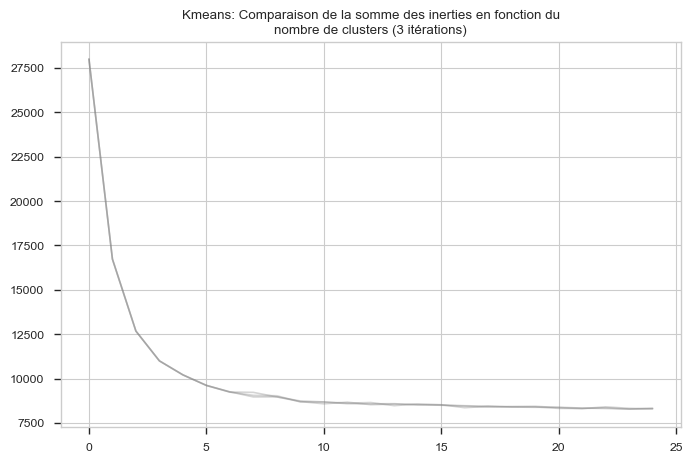

In [58]:
chaine = 'Kmeans: Comparaison de la somme des inerties en fonction du\nnombre de clusters (' + str(nb_boucles) + ' itérations)'
plt.figure(figsize=(8,5))
plt.title(chaine)
for i in range(0,nb_boucles):
    index_plot = [cluster+i*(max_clusters) for cluster in list(range(0,max_clusters))][0:max_clusters]
    sous_liste = [list(inertia.values())[index] for index in index_plot]
    sns.lineplot(list(range(0,max_clusters)),
                 sous_liste, alpha=1/nb_boucles, color='grey')

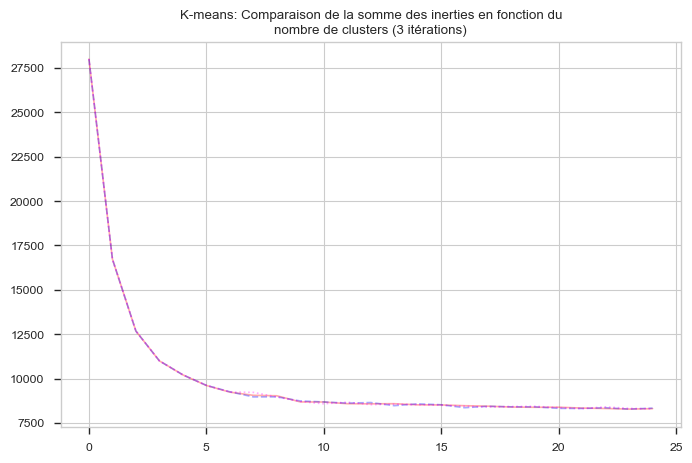

In [59]:
# ##############
# chaine = 'K-means: Comparaison de la somme des inerties en fonction du\nnombre de clusters (' + str(nb_boucles) + ' itérations)'  # Chaîne de caractères pour le titre du graphique
# plt.figure(figsize=(8, 5))  # Crée une nouvelle figure avec une taille de 8 pouces de largeur et 5 pouces de hauteur
# plt.title(chaine)  # Définit le titre du graphique

# # Boucle pour tracer les lignes de la comparaison des inerties
# for i in range(0, nb_boucles):
#     index_plot = [cluster + i * (max_clusters) for cluster in list(range(0, max_clusters))][0:max_clusters]  # Indices des inerties à tracer
#     sous_liste = [list(inertia.values())[index] for index in index_plot]  # Liste des inerties correspondant aux indices
#     sns.lineplot(list(range(0, max_clusters)), sous_liste, alpha=1/nb_boucles, color='grey')  # Trace une courbe de ligne avec les indices et les inerties correspondantes
# ##############
chaine = 'K-means: Comparaison de la somme des inerties en fonction du\nnombre de clusters (' + str(nb_boucles) + ' itérations)'  # Chaîne de caractères pour le titre du graphique
plt.figure(figsize=(8, 5))  # Crée une nouvelle figure avec une taille de 8 pouces de largeur et 5 pouces de hauteur
plt.title(chaine)  # Définit le titre du graphique

# Boucle pour tracer les lignes de la comparaison des inerties
for i in range(0, nb_boucles):
    index_plot = [cluster + i * (max_clusters) for cluster in list(range(0, max_clusters))][0:max_clusters]  # Indices des inerties à tracer
    sous_liste = [list(inertia.values())[index] for index in index_plot]  # Liste des inerties correspondant aux indices
    
    # Définition de la couleur et de l'aspect de la ligne en fonction de l'itération
    if i == 0:
        color = 'red'  # Couleur de la première itération
        linestyle = '-'  # Aspect de la ligne solide
    elif i == 1:
        color = 'blue'  # Couleur de la deuxième itération
        linestyle = '--'  # Aspect de la ligne en tiret
    else:
#         color = 'green'  # Couleur de la troisième itération
        color = '#FF00FF'  # '#FFFF00' Code hexadécimal pour la couleur jaune fluo
#         color = (255/255, 255/255, 0/255)  # Valeurs RVB pour la couleur jaune fluo
        linestyle = ':'  # Aspect de la ligne en pointillés
    
    sns.lineplot(list(range(0, max_clusters)), sous_liste, alpha=1/nb_boucles, color=color, linestyle=linestyle)  # Trace une courbe de ligne avec les indices et les inerties correspondantes, avec la couleur et l'aspect définis




#### Coefficient de silhouette

Le coefficient de silhouette est une mesure simple et concise pour évaluer la qualité d'un clustering en termes de séparation et de compacité des clusters. Il permet de quantifier la similarité des objets à l'intérieur d'un cluster par rapport aux objets des autres clusters, ce qui facilite la comparaison et l'évaluation des différentes configurations de clustering.

In [60]:
# silhouettes_kmeans = {}
# for i in range(2,max_clusters):
#     silhouettes_kmeans[i] = silhouette_score(X = X_pca,
#                                              labels= list(dict_kmeans[(1,i)].labels_))
silhouettes_kmeans = {}  # Dictionnaire pour stocker les valeurs du coefficient de silhouette

# Boucle pour calculer le coefficient de silhouette pour chaque nombre de clusters
for i in range(2, max_clusters):
    # Calcul du coefficient de silhouette en utilisant la fonction silhouette_score
    # X_pca : les données projetées en PCA
    # labels : les étiquettes de clusters attribuées par KMeans
    silhouettes_kmeans[i] = silhouette_score(X=X_pca, labels=list(dict_kmeans[(1, i)].labels_))


Ce code permet de calculer et de stocker les valeurs du coefficient de silhouette pour chaque nombre de clusters, en utilisant K-means comme algorithme de clustering. Le coefficient de silhouette est une mesure quantitative de la qualité du clustering, qui peut être utilisée pour évaluer différentes configurations de clustering ou trouver le nombre optimal de clusters. Des valeurs plus élevées du coefficient de silhouette indiquent une meilleure séparation et compacité des clusters.

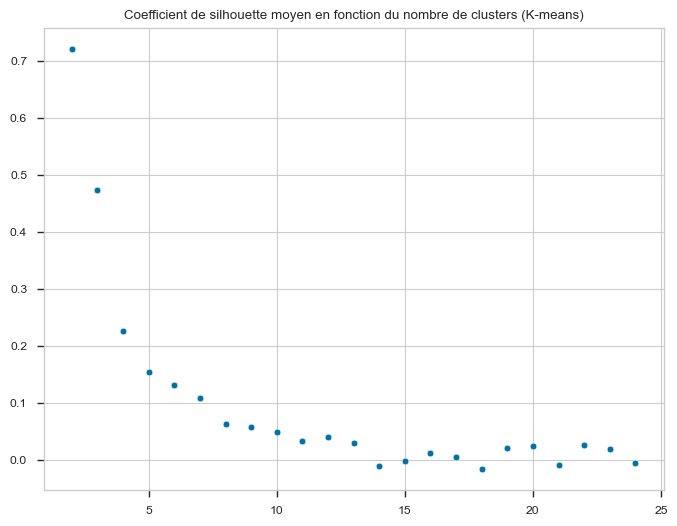

In [61]:
# plt.figure(figsize=(8,6)),
# plt.title('Coefficient de silhouette moyen en fonction du nombre de clusters (kmeans)')
# sns.scatterplot(x = list(silhouettes_kmeans.keys()),
#                y = list(silhouettes_kmeans.values()))
# plt.show()
plt.figure(figsize=(8, 6))  # Crée une nouvelle figure avec une taille de 8 pouces de largeur et 6 pouces de hauteur
plt.title('Coefficient de silhouette moyen en fonction du nombre de clusters (K-means)')  # Définit le titre du graphique

# Tracé du scatter plot avec les nombres de clusters et les coefficients de silhouette moyens
sns.scatterplot(x=list(silhouettes_kmeans.keys()), y=list(silhouettes_kmeans.values()))

plt.show()  # Affiche le graphique


Ce code permet de visualiser le coefficient de silhouette moyen pour chaque nombre de clusters, en utilisant K-means comme algorithme de clustering. La visualisation sous forme de scatter plot permet de comprendre la tendance des valeurs de coefficient de silhouette en fonction du nombre de clusters. Cela peut aider à identifier le nombre optimal de clusters où le coefficient de silhouette moyen est maximisé, indiquant une meilleure séparation et compacité des clusters.

In [62]:
for key, value in silhouettes_kmeans.items():  # Parcours des éléments du dictionnaire silhouettes_kmeans
    if value == max(silhouettes_kmeans.values()):  # Vérification si la valeur est égale à la valeur maximale des coefficients de silhouette
        print('Le coefficient de silhouette est maximal pour {} clusters (score = {})'.format(key, value))  # Affichage du nombre de clusters et du coefficient de silhouette correspondant
        nb_clusters = key  # Attribution du nombre de clusters correspondant à la variable nb_clusters


Le coefficient de silhouette est maximal pour 2 clusters (score = 0.7212657561943026)


Ce code permet d'identifier le nombre de clusters pour lequel le coefficient de silhouette est maximal. L'affichage du nombre de clusters et du coefficient de silhouette maximal fournit une indication sur la configuration de clustering qui offre la meilleure séparation et compacité des clusters. La variable nb_clusters permet de stocker cette valeur pour une utilisation ultérieure si nécessaire.

In [63]:
nb_clusters

2

#### Indice de Davies Bouldin

L'indice de Davies-Bouldin est une mesure qui quantifie la qualité d'un clustering en évaluant à la fois la séparation et la cohésion des clusters. Une valeur d'indice plus faible indique une meilleure qualité de clustering, tandis qu'une valeur plus élevée indique une moins bonne qualité de clustering.

In [64]:
# davies_bouldin_kmeans = {}
# for i in range(2,max_clusters):
#     davies_bouldin_kmeans[i] = davies_bouldin_score(X = X_pca,
#                                              labels= list(dict_kmeans[(1,i)].labels_))
davies_bouldin_kmeans = {}  # Dictionnaire pour stocker les valeurs de l'indice de Davies-Bouldin

# Boucle pour calculer l'indice de Davies-Bouldin pour chaque nombre de clusters
for i in range(2, max_clusters):
    # Calcul de l'indice de Davies-Bouldin en utilisant la fonction davies_bouldin_score
    # X_pca : les données projetées en PCA
    # labels : les étiquettes de clusters attribuées par KMeans
    davies_bouldin_kmeans[i] = davies_bouldin_score(X=X_pca, labels=list(dict_kmeans[(1, i)].labels_))

Ce code permet de calculer et de stocker les valeurs de l'indice de Davies-Bouldin pour chaque nombre de clusters, en utilisant K-means comme algorithme de clustering. L'indice de Davies-Bouldin est une mesure de la qualité du clustering qui évalue la séparation et la compacité des clusters. Les valeurs plus faibles de l'indice de Davies-Bouldin indiquent une meilleure qualité de clustering avec des clusters plus séparés et plus cohérents.

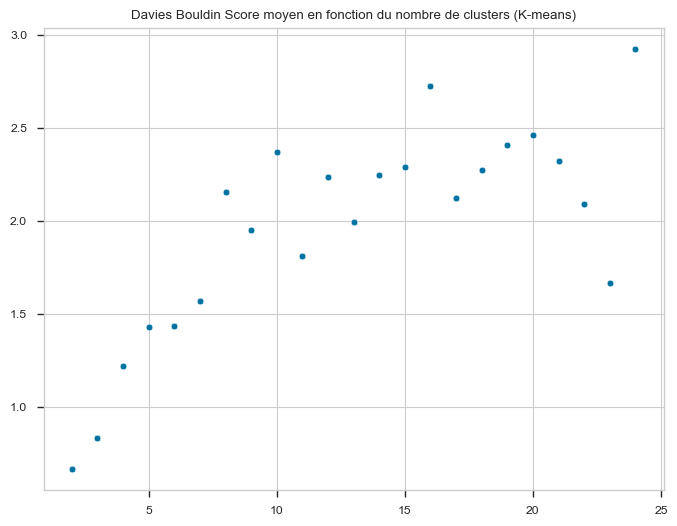

In [65]:
# plt.figure(figsize=(8,6)),
# plt.title('Davies Bouldin Score moyen en fonction du nombre de clusters (kmeans)')
# sns.scatterplot(x = list(davies_bouldin_kmeans.keys()),
#                y = list(davies_bouldin_kmeans.values()))
# plt.show()
plt.figure(figsize=(8, 6))  # Crée une nouvelle figure avec une taille de 8 pouces de largeur et 6 pouces de hauteur
plt.title('Davies Bouldin Score moyen en fonction du nombre de clusters (K-means)')  # Définit le titre du graphique

# Tracé du scatter plot avec les nombres de clusters et les scores de Davies Bouldin moyens
sns.scatterplot(x=list(davies_bouldin_kmeans.keys()), y=list(davies_bouldin_kmeans.values()))

plt.show()  # Affiche le graphique


Ce code permet de visualiser le score de Davies-Bouldin moyen pour chaque nombre de clusters, en utilisant K-means comme algorithme de clustering. La visualisation sous forme de scatter plot permet de comprendre la tendance des scores de Davies-Bouldin en fonction du nombre de clusters. Cela peut aider à identifier le nombre optimal de clusters où le score de Davies-Bouldin moyen est minimisé, indiquant une meilleure séparation et cohérence des clusters.

In [66]:
# for key, value in davies_bouldin_kmeans.items():
#     if value == min(davies_bouldin_kmeans.values()):
#         print('lescore de Davies Bouldin est minimal pour {} clusters (score = {})'.format(key, value))
for key, value in davies_bouldin_kmeans.items():  # Parcours des éléments du dictionnaire davies_bouldin_kmeans
    if value == min(davies_bouldin_kmeans.values()):  # Vérification si la valeur est égale à la valeur minimale des scores de Davies Bouldin
        print('Le score de Davies Bouldin est minimal pour {} clusters (score = {})'.format(key, value))  # Affichage du nombre de clusters et du score de Davies Bouldin correspondant


Le score de Davies Bouldin est minimal pour 2 clusters (score = 0.6681570063683209)


### Représentation

In [67]:
# nb_clusters_agg = nb_clusters

<Axes: title={'center': 'Représentation T-SNE de la séparation du jeu de données via KMeans (14 clusters)'}>

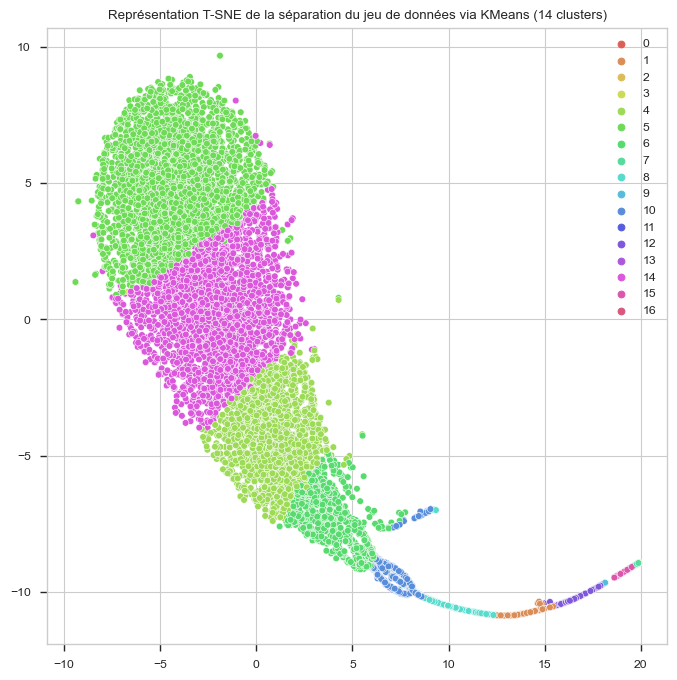

In [68]:
# plt.figure(figsize=(8,8))
# plt.title('Représentation T-SNE de la séparation du jeu de données via KMeans (14 clusters)')
# sns.scatterplot(T[:,0], 
#                 T[:,1],
#                hue=dict_kmeans[(1,14)].labels_,
#                 legend='full',
#                palette=sns.color_palette("hls",18))
plt.figure(figsize=(8, 8))
plt.title('Représentation T-SNE de la séparation du jeu de données via KMeans (14 clusters)')

# Utilisez une palette avec le nombre de couleurs correspondant au nombre de clusters
palette = sns.color_palette("hls", n_colors=17)

sns.scatterplot(T[:, 0], T[:, 1], hue=dict_kmeans[(1, 17)].labels_, legend='full', palette=palette)


L'objectif de ce code et du graphique est de visualiser graphiquement la séparation des clusters obtenus par KMeans dans un espace réduit par T-SNE. Cela permet de mieux comprendre la structure des données et de vérifier visuellement la séparation des clusters. En utilisant des couleurs différentes pour chaque cluster, le graphique facilite l'identification des groupes distincts dans les données. Cela peut être utile pour l'analyse exploratoire des données, l'évaluation de la qualité du clustering ou la communication des résultats à d'autres parties prenantes.

## DBScan 

### Application

In [69]:
# dbs = DBSCAN(eps = 1, 
#              min_samples=5,
#                n_jobs=-1).fit(X_pca.copy())
dbs = DBSCAN(eps=1, min_samples=5, n_jobs=-1).fit(X_pca.copy())

- DBSCAN est une classe de l'algorithme Density-Based Spatial Clustering of Applications with Noise (DBSCAN) fournie par la bibliothèque scikit-learn.
- eps est le rayon autour de chaque point à considérer lors de la recherche de ses voisins. C'est l'un des paramètres clés de DBSCAN qui définit la distance maximale entre les points pour qu'ils soient considérés comme voisins.
- min_samples est le nombre minimal de points à l'intérieur du rayon eps requis pour former un cluster. C'est un autre paramètre important de DBSCAN qui détermine la densité minimale nécessaire pour qu'un groupe de points soit considéré comme un cluster.
- n_jobs=-1 spécifie que le calcul peut être parallélisé sur tous les CPU disponibles. Cela peut accélérer le processus de calcul lorsque de nombreux points sont impliqués.
- fit(X_pca.copy()) ajuste le modèle DBSCAN aux données d'entrée. X_pca.copy() est une copie des données projetées en PCA, qui est utilisée pour éviter toute modification des données d'origine.

En utilisant ces paramètres, DBSCAN effectue le clustering des données X_pca en identifiant les clusters en fonction de la densité des points et de la proximité spatiale. Cela permet de détecter des structures non linéaires, des formes arbitraires de clusters et des points aberrants dans les données. Le modèle dbs contient les informations sur les clusters identifiés par DBSCAN, qui peuvent ensuite être utilisées pour l'analyse et la visualisation des résultats du clustering.

### Représentation des variables

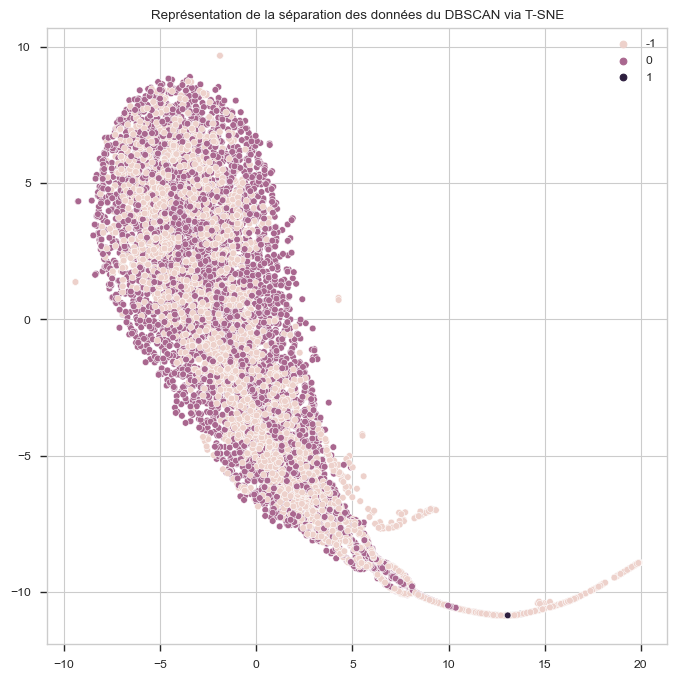

In [70]:
# plt.figure(figsize=(8,8))
# plt.title('Représentation de la séparation des données du DBSCAN via T-SNE')
# sns.scatterplot(T[:,0], T[:,1], dbs.labels_)
plt.figure(figsize=(8, 8))  # Crée une nouvelle figure avec une taille de 8 pouces de largeur et 8 pouces de hauteur
plt.title('Représentation de la séparation des données du DBSCAN via T-SNE')  # Définit le titre du graphique

# Tracé du scatter plot avec les coordonnées des points projetés en T-SNE et les étiquettes de clusters de DBSCAN
sns.scatterplot(T[:, 0], T[:, 1], dbs.labels_)

plt.show()  # Affiche le graphique


Ce code permet de visualiser graphiquement la séparation des données obtenues avec DBSCAN dans un espace réduit par T-SNE. En utilisant des couleurs différentes pour chaque cluster identifié par DBSCAN, le graphique facilite l'identification des groupes distincts dans les données. Cela peut être utile pour l'analyse exploratoire des données, l'évaluation de la qualité du clustering ou la détection de points aberrants.

## Clustering Hiérarchique

Le clustering hiérarchique est une méthode de regroupement de données qui vise à créer une structure hiérarchique de clusters. Contrairement à d'autres méthodes de clustering telles que K-means, le clustering hiérarchique ne nécessite pas de spécifier le nombre de clusters à l'avance.

Le processus de clustering hiérarchique commence par considérer chaque point de données comme un cluster individuel. Ensuite, il fusionne progressivement les clusters similaires pour former des clusters plus grands, jusqu'à ce que tous les points de données soient regroupés dans un seul cluster.

Il existe deux approches principales dans le clustering hiérarchique : le clustering hiérarchique agglomératif et le clustering hiérarchique diviseur.

- Le clustering hiérarchique agglomératif commence par considérer chaque point de données comme un cluster individuel, puis fusionne les clusters les plus similaires à chaque étape jusqu'à former un seul cluster contenant tous les points.
- Le clustering hiérarchique diviseur commence avec un seul cluster contenant tous les points de données, puis divise récursivement le cluster en sous-clusters plus petits jusqu'à atteindre le nombre souhaité de clusters.

Le résultat du clustering hiérarchique est généralement représenté sous forme de dendrogramme, qui est un diagramme en forme d'arbre montrant les regroupements successifs des clusters. Ce diagramme permet de visualiser la structure hiérarchique des clusters et d'identifier les niveaux de regroupement.

Le clustering hiérarchique est utilisé dans divers domaines tels que l'analyse de données, la bioinformatique, la segmentation de marché, etc. Il offre une approche flexible pour explorer et comprendre la structure des données, en fournissant des informations sur les similarités et les relations entre les points de données.

In [71]:
nb_clusters_agg = nb_clusters

In [72]:
cah = AgglomerativeClustering(n_clusters = nb_clusters_agg
                             ).fit(X_pca.copy())

- AgglomerativeClustering est une classe de l'algorithme de clustering hiérarchique agglomératif fournie par la bibliothèque scikit-learn.
- n_clusters est le nombre de clusters souhaité pour le regroupement. C'est le paramètre principal de l'algorithme de clustering hiérarchique.
- fit(X_pca.copy()) ajuste le modèle de clustering hiérarchique agglomératif aux données d'entrée. X_pca.copy() est une copie des données projetées en PCA, qui est utilisée pour éviter toute modification des données d'origine.

En utilisant ces paramètres, le modèle cah effectue le clustering hiérarchique agglomératif des données X_pca en identifiant les clusters en fonction des distances entre les points. Le nombre de clusters est déterminé par le paramètre n_clusters. Le modèle cah contient les informations sur les clusters identifiés par le clustering hiérarchique agglomératif, qui peuvent ensuite être utilisées pour l'analyse et la visualisation des résultats du clustering.

Ce code permet donc de réaliser le clustering hiérarchique agglomératif sur les données projetées en PCA (X_pca) avec un nombre spécifié de clusters (nb_clusters_agg). Les résultats du clustering peuvent être utilisés pour comprendre la structure des données et effectuer des analyses ultérieures sur les groupes formés.

In [73]:
graph = pd.DataFrame(data = [T[:,0], T[:,1], dict_kmeans[(1,11)].labels_]).T
graph.columns = ['X', 'Y', 'label_kmeans']

- pd.DataFrame(data=[T[:, 0], T[:, 1], dict_kmeans[(1, 11)].labels_]).T crée un DataFrame en utilisant les données T[:, 0],   - T[:, 1] et les étiquettes de clusters attribuées par KMeans (dict_kmeans[(1, 11)].labels_).
  - T[:, 0] correspond aux valeurs de la première dimension dans l'espace de projection T-SNE.
  - T[:, 1] correspond aux valeurs de la deuxième dimension dans l'espace de projection T-SNE.
  - dict_kmeans[(1, 11)].labels_ correspond aux étiquettes de clusters attribuées par KMeans pour les points correspondants.
- .T transpose le DataFrame pour inverser les lignes et les colonnes.
- graph.columns = ['X', 'Y', 'label_kmeans'] attribue les noms de colonnes 'X', 'Y' et 'label_kmeans' au DataFrame.

Ce code permet de créer un DataFrame graph contenant les coordonnées des points projetés en T-SNE ('X' et 'Y') ainsi que les étiquettes de clusters attribuées par KMeans ('label_kmeans'). Le DataFrame peut être utilisé pour l'analyse et la visualisation des résultats du clustering, par exemple pour tracer des graphiques ou effectuer des calculs supplémentaires sur les clusters identifiés.

In [154]:
graph['x_pca'] = x_show
graph['y_pca'] = y_show
graph['z_pca'] = z_show

In [155]:
graph

,X,Y,label_kmeans,x_pca,y_pca,z_pca
0,0.832972,-6.582846,4.0,0.077494,0.935046,-1.193526
1,-4.736091,5.765592,5.0,-0.840450,-0.782587,0.709070
2,-3.722539,-2.420332,6.0,-0.361216,-0.181979,0.024483
3,-1.561601,0.027300,6.0,-0.392592,0.250527,-0.422578
4,-0.371150,-2.389038,6.0,-0.246388,-0.744893,0.597313
...,...,...,...,...,...,...
9995,5.991673,-8.534502,4.0,0.671156,0.514531,-0.827552
9996,6.026809,-8.596557,4.0,0.688815,0.395351,-0.705461
9997,-0.719698,-1.660539,6.0,-0.278699,-0.305382,0.143065
9998,-3.314487,0.492775,6.0,-0.473001,0.311306,-0.476132


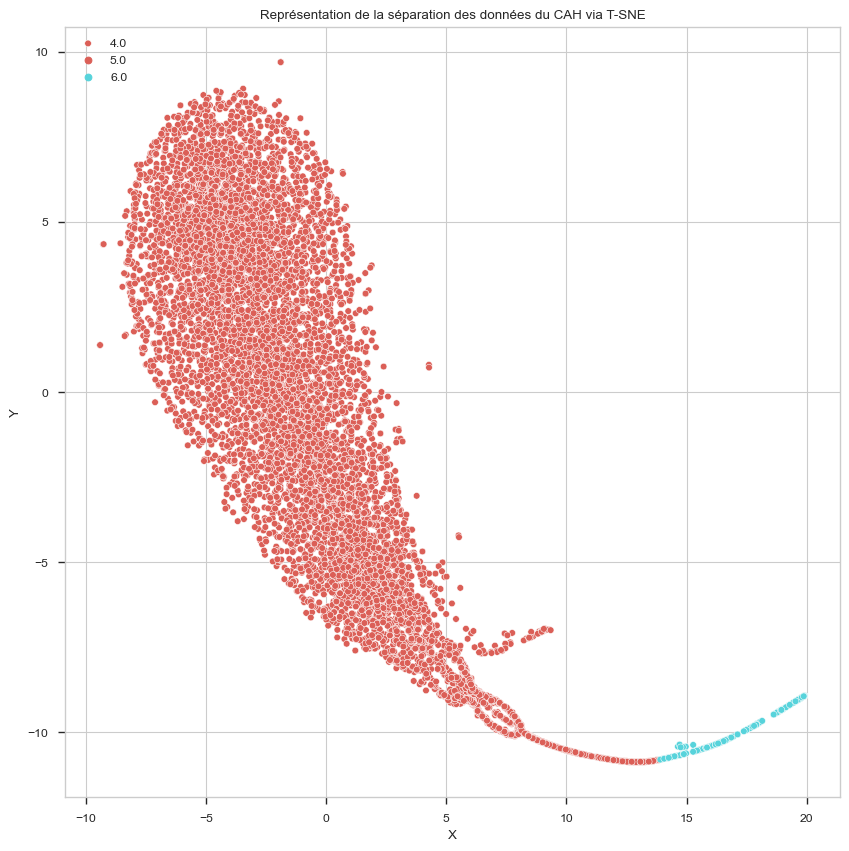

In [156]:
# plt.figure(figsize=(10,10))
# plt.title('Représentation de la séparation des données du CAH via T-SNE')
# sns.scatterplot(graph['X'], 
#                 graph['Y'], 
#                 hue = cah.labels_, 
#                 legend='full',
#                palette=sns.color_palette("hls",nb_clusters_agg))
# plt.legend(loc='upper left', labels=graph['label_kmeans'].unique())
# plt.show()
plt.figure(figsize=(10, 10))  # Crée une nouvelle figure avec une taille de 10 pouces de largeur et 10 pouces de hauteur
plt.title('Représentation de la séparation des données du CAH via T-SNE')  # Définit le titre du graphique

# Tracé du scatter plot avec les coordonnées des points projetés en T-SNE, les étiquettes de clusters de CAH et les étiquettes de clusters de KMeans
sns.scatterplot(graph['X'], graph['Y'], hue=cah.labels_, legend='full',
                palette=sns.color_palette("hls", nb_clusters_agg))

# Ajout de la légende pour les étiquettes de clusters de KMeans
plt.legend(loc='upper left', labels=graph['label_kmeans'].unique())

plt.show()  # Affiche le graphique


Ce code permet de visualiser graphiquement la séparation des données obtenues avec l'algorithme de clustering hiérarchique agglomératif (CAH) dans un espace de projection T-SNE. Voici une description détaillée du code :

- plt.figure(figsize=(10, 10)) crée une nouvelle figure avec une taille de 10 pouces de largeur et 10 pouces de hauteur pour préparer la visualisation.
- plt.title('Représentation de la séparation des données du CAH via T-SNE') définit le titre du graphique pour indiquer ce qui est représenté.
- sns.scatterplot trace un scatter plot en utilisant les coordonnées des points projetés en T-SNE (graph['X'] et graph['Y']) et les étiquettes de clusters attribuées par CAH (cah.labels_).
- Les coordonnées graph['X'] et graph['Y'] correspondent respectivement aux valeurs des deux dimensions dans l'espace de projection T-SNE.
- L'argument hue=cah.labels_ est utilisé pour spécifier les étiquettes de clusters attribuées par CAH pour les points correspondants.
- L'argument legend='full' indique d'afficher une légende complète pour les catégories de clusters.
- La palette de couleurs utilisée est spécifiée avec palette, qui est une palette de couleurs générée par sns.color_palette avec le nombre approprié de couleurs correspondant au nombre de clusters de CAH.
- plt.legend(loc='upper left', labels=graph['label_kmeans'].unique()) ajoute une légende pour les étiquettes de clusters attribuées par KMeans en utilisant les étiquettes uniques de KMeans extraites du DataFrame graph.
- Le graphique est affiché avec plt.show().

Ce code permet de visualiser graphiquement la séparation des données obtenues avec le clustering hiérarchique agglomératif dans un espace réduit par T-SNE. En utilisant des couleurs différentes pour chaque cluster identifié par CAH, le graphique facilite l'identification des groupes distincts dans les données. La légende inclut également les étiquettes de clusters attribuées par KMeans pour une meilleure compréhension des résultats du clustering.

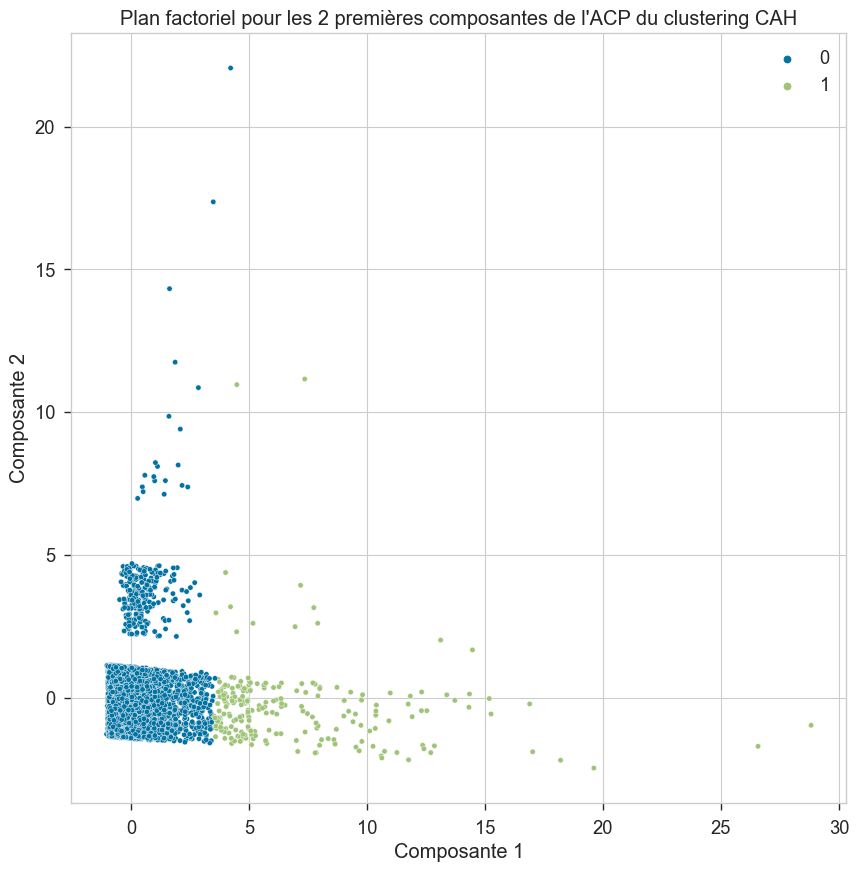

In [157]:
from matplotlib.patches import Circle  # Importe la classe Circle de la bibliothèque matplotlib.patches
sns.set_context("paper", font_scale=1.5)  # Configure le contexte des graphiques avec une échelle de police de 1.5
plt.figure(figsize=(10, 10))  # Crée une nouvelle figure avec une taille de 10 pouces de largeur et 10 pouces de hauteur
chaine = "Plan factoriel pour les 2 premières composantes de l'ACP du clustering CAH"
# Définit la chaîne de caractères à utiliser comme titre du graphique
plt.title(chaine)  # Définit le titre du graphique
plt.xlabel('Composante 1')  # Définit l'étiquette de l'axe x
plt.ylabel('Composante 2')  # Définit l'étiquette de l'axe y
ax = plt.gca()  # Récupère les axes actuels du graphique

sns.scatterplot(x=graph['x_pca'], y=graph['y_pca'], hue=cah.labels_, alpha=1, s=15, legend='full')
# Tracé du scatter plot avec les coordonnées des points projetés en PCA, les étiquettes de clusters de CAH,
# et des paramètres supplémentaires pour l'opacité (alpha), la taille des points (s) et l'affichage de la légende

sns.set_context("paper", font_scale=1)  # Rétablit le contexte des graphiques avec une échelle de police de 1


Voici une description détaillée du code :

- from matplotlib.patches import Circle importe la classe Circle de la bibliothèque matplotlib.patches, bien que cette importation ne soit pas utilisée dans le code donné.
- sns.set_context("paper", font_scale=1.5) configure le contexte des graphiques en utilisant le style "paper" avec une échelle de police de 1.5. Cela ajuste la taille du texte et des éléments du graphique pour un affichage adapté aux publications scientifiques.
- plt.figure(figsize=(10, 10)) crée une nouvelle figure avec une taille de 10 pouces de largeur et 10 pouces de hauteur pour préparer la visualisation.
- chaine = "Plan factoriel pour les 2 premières composantes de l'ACP du clustering CAH" définit la chaîne de caractères à utiliser comme titre du graphique pour décrire le contenu du graphique.
- plt.title(chaine) définit le titre du graphique avec la chaîne de caractères précédemment définie.
- plt.xlabel('Composante 1') définit l'étiquette de l'axe x du graphique pour indiquer la signification de la première composante principale (PC1) de l'analyse en composantes principales (ACP).
- plt.ylabel('Composante 2') définit l'étiquette de l'axe y du graphique pour indiquer la signification de la deuxième composante principale (PC2) de l'ACP.
- ax = plt.gca() récupère les axes actuels du graphique pour pouvoir les manipuler ou ajouter des éléments supplémentaires.
- sns.scatterplot(x=graph['x_pca'], y=graph['y_pca'], hue=cah.labels_, alpha=1, s=15, legend='full') trace le scatter plot en utilisant les coordonnées des points projetés en PCA (graph['x_pca'] et graph['y_pca']), les étiquettes de clusters de CAH (cah.labels_), ainsi que d'autres paramètres pour l'opacité (alpha), la taille des points (s) et l'affichage de la légende (legend='full').
- sns.set_context("paper", font_scale=1) rétablit le contexte des graphiques avec une échelle de police de 1, qui est plus adaptée pour une visualisation normale.

Ce code permet donc de tracer un scatter plot pour représenter les données projetées en PCA avec les étiquettes de clusters attribuées par CAH. Les composantes 1 et 2 de l'ACP sont utilisées comme coordonnées sur les axes x et y du graphique, respectivement. Les points sont colorés en fonction des clusters de CAH et d'autres paramètres sont ajustés pour l'opacité et la taille des points. Le graphique est ensuite affiché avec le titre, les étiquettes d'axe appropriées et une échelle de police adaptée.

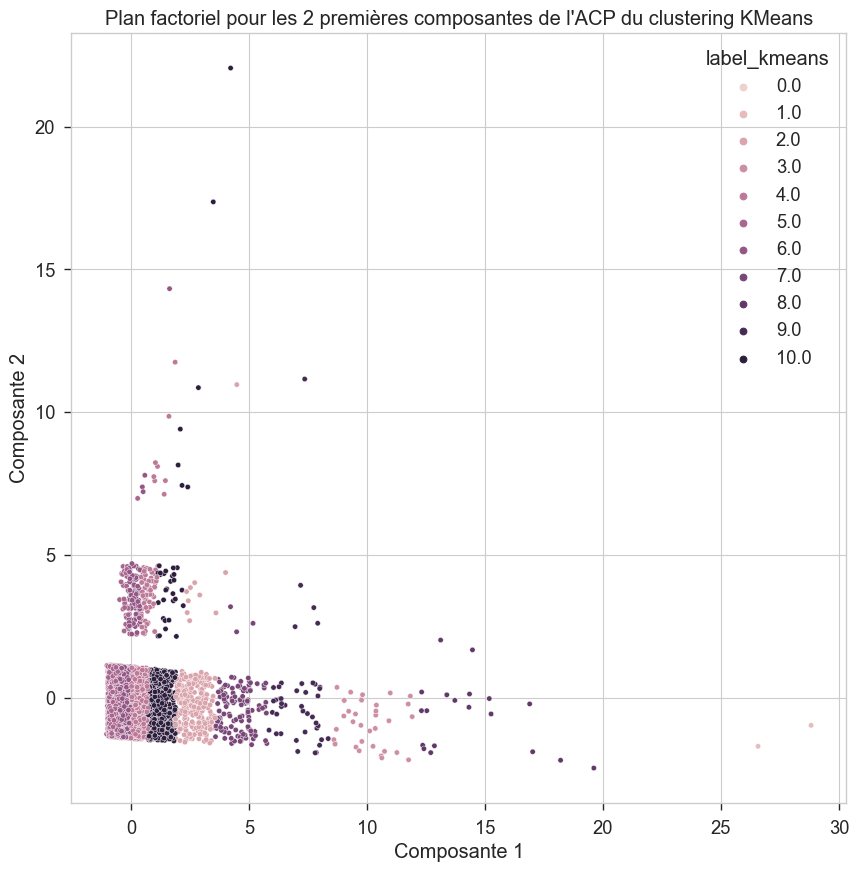

In [158]:
# from matplotlib.patches import Circle
# sns.set_context("paper", font_scale=1.5) 
# plt.figure(figsize=(10,10))
# chaine = "Plan factoriel pour les 2 premières composantes de l'ACP \
# du clustering KMeans"
# plt.title(chaine)
# plt.xlabel('Composante 1')
# plt.ylabel('Composante 2')
# ax = plt.gca()

# sns.scatterplot(x = graph['x_pca'], 
#                 y = graph['y_pca'], 
#                 hue = graph['label_kmeans'],
#                 alpha=1, s=15, legend='full')

# sns.set_context("paper", font_scale=1) 
from matplotlib.patches import Circle
import seaborn as sns

# Définir le contexte et l'échelle de police pour la représentation graphique
sns.set_context("paper", font_scale=1.5)

# Créer une nouvelle figure
plt.figure(figsize=(10, 10))

# Définir le titre de la représentation graphique
chaine = "Plan factoriel pour les 2 premières composantes de l'ACP du clustering KMeans"
plt.title(chaine)

# Définir les labels pour les axes x et y
plt.xlabel('Composante 1')
plt.ylabel('Composante 2')

# Obtenir l'objet des axes actuels
ax = plt.gca()

# Créer un nuage de points pour représenter les données
sns.scatterplot(x=graph['x_pca'], 
                y=graph['y_pca'], 
                hue=graph['label_kmeans'],
                alpha=1, s=15, legend='full')

# Réinitialiser le contexte et l'échelle de police
sns.set_context("paper", font_scale=1)


Ce code génère une représentation graphique sous forme de nuage de points des données dans le plan en 2D défini par les deux premières composantes principales (composante 1 et composante 2) obtenues à partir du clustering KMeans. Le dataframe graph contient les coordonnées des points de données (x_pca et y_pca) ainsi que les étiquettes de cluster correspondantes (label_kmeans). Le nuage de points utilise les étiquettes de cluster pour la coloration des points.

In [159]:
silhouette_score(X = X_pca, labels= cah.labels_)

0.7523421416991143

In [160]:
# import numpy as np
# import pandas as pd
# from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
# from sklearn.metrics import silhouette_score, davies_bouldin_score

# # Charger les données (remplacez les données fictives avec vos propres données)
# # data = pd.read_csv("votre_fichier.csv")

# # Sélection des méthodes de clustering à comparer
# clustering_methods = {
#     "K-means": KMeans(n_clusters=5),
#     "DBSCAN": DBSCAN(eps=0.5, min_samples=5),
#     "CAH": AgglomerativeClustering(n_clusters=5)
# }

# # Préparation des données (remplacez cette étape avec votre prétraitement des données)

# # Évaluation des méthodes de clustering
# evaluation_scores = {}

# for method_name, method in clustering_methods.items():
#     # Appliquer la méthode de clustering sur les données
#     labels = method.fit_predict(data)
    
#     # Calculer les scores d'évaluation (score de silhouette et indice de Davies-Bouldin)
#     silhouette_score_value = silhouette_score(data, labels)
#     davies_bouldin_score_value = davies_bouldin_score(data, labels)
    
#     # Enregistrer les scores d'évaluation
#     evaluation_scores[method_name] = {"Silhouette Score": silhouette_score_value,
#                                       "Davies-Bouldin Score": davies_bouldin_score_value}

# # Comparaison des résultats
# for method_name, scores in evaluation_scores.items():
#     print(f"Méthode: {method_name}")
#     print(f"Silhouette Score: {scores['Silhouette Score']}")
#     print(f"Davies-Bouldin Score: {scores['Davies-Bouldin Score']}")
#     print("-------------------------------------")

# # Sélection de la meilleure méthode de clustering
# best_method = max(evaluation_scores, key=lambda x: evaluation_scores[x]['Silhouette Score'])
# print(f"La meilleure méthode de clustering est : {best_method}")


## Conclusion

Le Kmeans semble mieux fonctionner que les autres méthodes de clustering, essayons d'appliquer cet algorithme à l'ensemble du jeu de données.


# Ensemble du jeu de données

## Préparation jeu de donnée complet

In [161]:
# X_tot=data.copy()

# categorical_columns = X_tot.select_dtypes(['category','object']).columns
# numerical_columns = X_tot.select_dtypes(['int32','float64']).columns

# ohe = OneHotEncoder(sparse=False)
# ss = StandardScaler()
# X_tot[numerical_columns] = ss.fit_transform(X_tot[numerical_columns])
# ohe.fit(X_tot[categorical_columns])

# Copier les données dans un nouveau dataframe X_tot
X_tot = data.copy()

# Sélectionner les colonnes catégorielles et de type objet
categorical_columns = X_tot.select_dtypes(['category', 'object']).columns

# Sélectionner les colonnes numériques
numerical_columns = X_tot.select_dtypes(['int32', 'float64']).columns

# Créer une instance de l'encodeur one-hot
ohe = OneHotEncoder(sparse=False)

# Créer une instance du standardiseur
ss = StandardScaler()

# Standardiser les colonnes numériques dans X_tot
X_tot[numerical_columns] = ss.fit_transform(X_tot[numerical_columns])

# Adapter l'encodeur one-hot aux colonnes catégorielles de X_tot
ohe.fit(X_tot[categorical_columns])


OneHotEncoder(sparse=False)

Ces étapes permettent de prétraiter les données en standardisant les colonnes numériques et en encodant les colonnes catégorielles en utilisant l'encodeur one-hot. Cela prépare les données pour être utilisées dans les méthodes de clustering.

In [162]:
# X_tot = pd.merge(X_tot[numerical_columns], 
#           pd.DataFrame(columns = ohe.get_feature_names().tolist(),
#               data = ohe.fit_transform(X_tot[categorical_columns])).set_index(X_tot.index),
#         left_index = True, right_index = True)
# Fusionner les colonnes numériques et les colonnes encodées par one-hot
X_tot = pd.merge(
    X_tot[numerical_columns],  # Sélectionner les colonnes numériques de X_tot
    pd.DataFrame(
        columns=ohe.get_feature_names().tolist(),  # Créer un dataframe vide avec les noms des colonnes encodées
        data=ohe.fit_transform(X_tot[categorical_columns])  # Encoder les colonnes catégorielles et remplir le dataframe
    ).set_index(X_tot.index),  # Définir les mêmes index que X_tot
    left_index=True, right_index=True  # Effectuer la fusion en utilisant les index comme clé de jointure
)


Ce code réalise les étapes suivantes :

- Sélectionne les colonnes numériques du dataframe X_tot.
- Crée un dataframe vide avec les noms des colonnes encodées par one-hot, en utilisant la méthode get_feature_names() de l'encodeur one-hot.
- Encode les colonnes catégorielles de X_tot en utilisant l'encodeur one-hot, et remplit le dataframe vide avec les résultats de l'encodage.
- Définit les mêmes index que le dataframe X_tot pour le nouveau dataframe encodé.
- Fusionne les colonnes numériques de X_tot avec les colonnes encodées par one-hot en utilisant les index comme clé de jointure.

Cela permet de combiner les colonnes numériques et les colonnes encodées par one-hot dans un seul dataframe X_tot, qui est utilisé pour l'analyse de clustering.

## ACP

In [163]:
pca_tot = PCA(random_state=1)

In [164]:
pca_tot.fit(X_tot)

PCA(random_state=1)

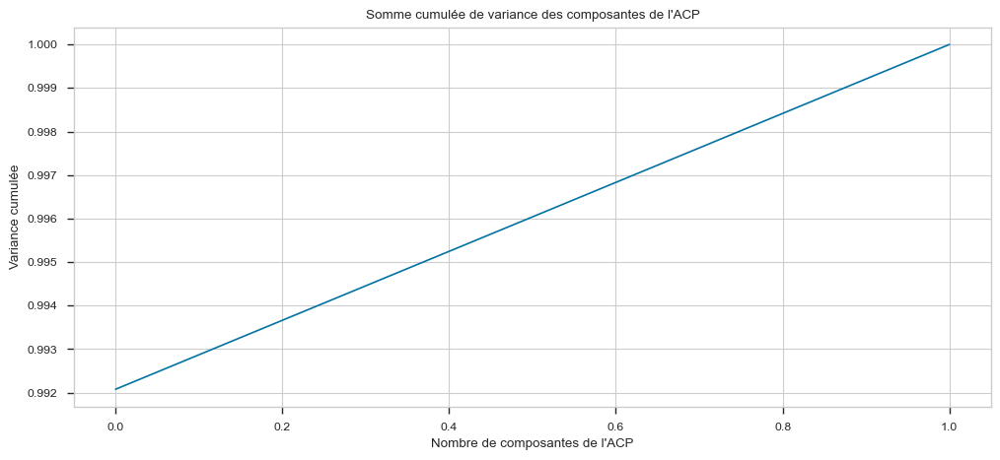

In [165]:
# plt.figure(figsize=(12,5))
# plt.title('Somme cumulée de variance des composantes de l\'ACP')
# plt.xlabel('Nombre de composantes de l\'ACP')
# plt.ylabel('Variance cumulée')
# plt.plot(list(range(X_tot.shape[1])),
#          np.cumsum(pca_tot.explained_variance_ratio_))
# Créer une figure avec une taille spécifiée
plt.figure(figsize=(12, 5))

# Définir le titre du graphique
plt.title("Somme cumulée de variance des composantes de l'ACP")

# Définir le label de l'axe x
plt.xlabel("Nombre de composantes de l'ACP")

# Définir le label de l'axe y
plt.ylabel("Variance cumulée")

# Tracer la courbe de la somme cumulée de variance expliquée par les composantes de l'ACP
plt.plot(
    list(range(X_tot.shape[1])),  # Liste des nombres de composantes de l'ACP
    np.cumsum(pca_tot.explained_variance_ratio_)  # Somme cumulée de variance expliquée
)

In [166]:
categorical_features = list(data.select_dtypes(exclude=['int32','int64', 'float64', 'uint8']).columns)
categorical_features

['last_order']

In [167]:
# X_bis = X.drop(categorical_features, axis=1)
# X_bis.head(6)

In [168]:
X_bis = X_tot
# PCA Pipeline
pca = Pipeline([("preprocessor", MinMaxScaler()),
                ("pca", PCA(svd_solver='full'))])
pca.fit(X_bis)
X_projected = pca.transform(X_bis)

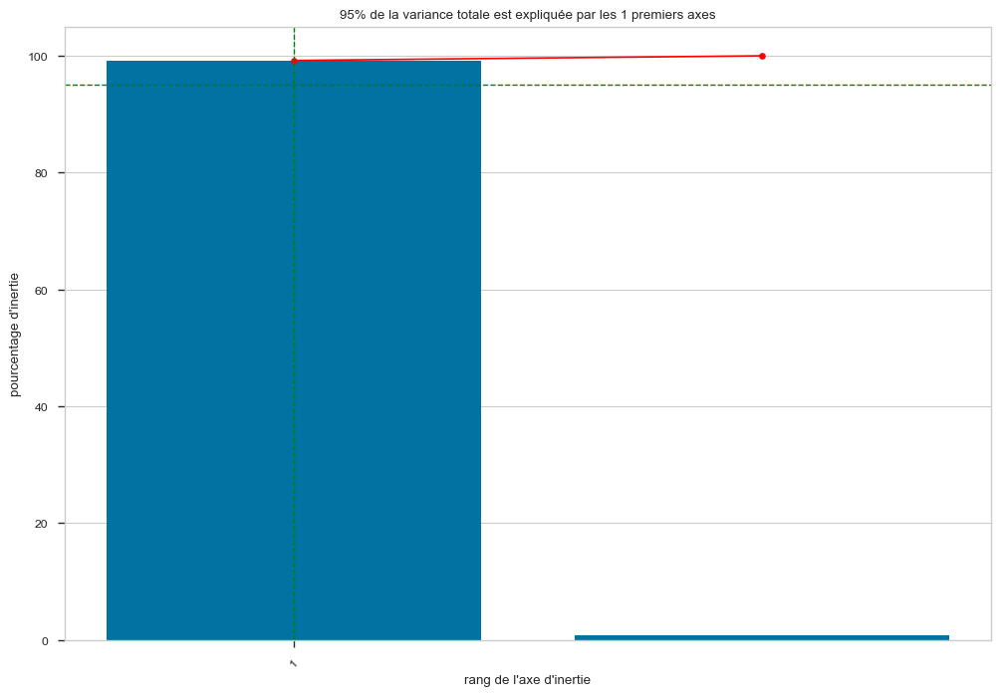

In [169]:
# Explained variance
varexpl = pca.named_steps['pca'].explained_variance_ratio_ * 100

# Plot of cumulated variance
plt.figure(figsize=(12, 8))
plt.bar(np.arange(len(varexpl)) + 1, varexpl)

cumSumVar = varexpl.cumsum()
plt.plot(np.arange(len(varexpl)) + 1, cumSumVar, c="red", marker='o')
plt.axhline(y=95, linestyle="--", color="green", linewidth=1)

limit = 95
valid_idx = np.where(cumSumVar >= limit)[0]
min_plans = valid_idx[cumSumVar[valid_idx].argmin()] + 1
plt.axvline(x=min_plans, linestyle="--", color="green", linewidth=1)

plt.xlabel("rang de l'axe d'inertie")
plt.xticks(np.arange(1, len(varexpl) + 1, 5), rotation=45)  # Show labels every 5 positions and rotate by 45 degrees
plt.ylabel("pourcentage d'inertie")
plt.title("{}% de la variance totale est expliquée"\
          " par les {} premiers axes".format(limit, min_plans))
plt.show(block=False)


In [209]:
# np.cumsum(pca_tot.explained_variance_ratio_)[19]
# Calculer la somme cumulative des ratios de variance expliquée par les composantes principales
np.cumsum(pca_tot.explained_variance_ratio_)[19]

0.8745333103052757

Ce code effectue les étapes suivantes :

Calcule les ratios de variance expliquée par chaque composante principale de l'objet pca_tot.
Utilise la fonction np.cumsum() pour obtenir la somme cumulative de ces ratios de variance expliquée.
Sélectionne la valeur à l'index 19 de la somme cumulative, ce qui représente la variance expliquée cumulée par les 20 premières composantes principales.
Cela permet de quantifier la proportion de variance totale expliquée par les 20 premières composantes principales de l'analyse en composantes principales (PCA).

On a  94 % de variance avec 20 features

In [74]:
X_pca_tot = pca_tot.transform(X_tot)[:,:19]

In [75]:
colonnes_pca = X_tot.columns

## Représentation des données

In [76]:
# Calculer les coordonnées de la projection des données sur les trois premières composantes principales
x_show = pca_tot.transform(X_tot.select_dtypes(['float64', 'int32']))[:, 0]
y_show = pca_tot.transform(X_tot.select_dtypes(['float64', 'int32']))[:, 1]
z_show = pca_tot.transform(X_tot.select_dtypes(['float64', 'int32']))[:, 2]

Ce code effectue les étapes suivantes :

Sélectionne les colonnes de X_tot qui sont de type float64 ou int32 à l'aide de select_dtypes().
Utilise pca_tot.transform() pour effectuer la projection des données sélectionnées sur les composantes principales.
Extrait les coordonnées de la projection sur la première composante principale (x_show), la deuxième composante principale (y_show) et la troisième composante principale (z_show).
Cela permet d'obtenir les coordonnées de la projection des données sur les trois premières composantes principales de l'analyse en composantes principales (PCA), ce qui facilite la visualisation dans un espace tridimensionnel.

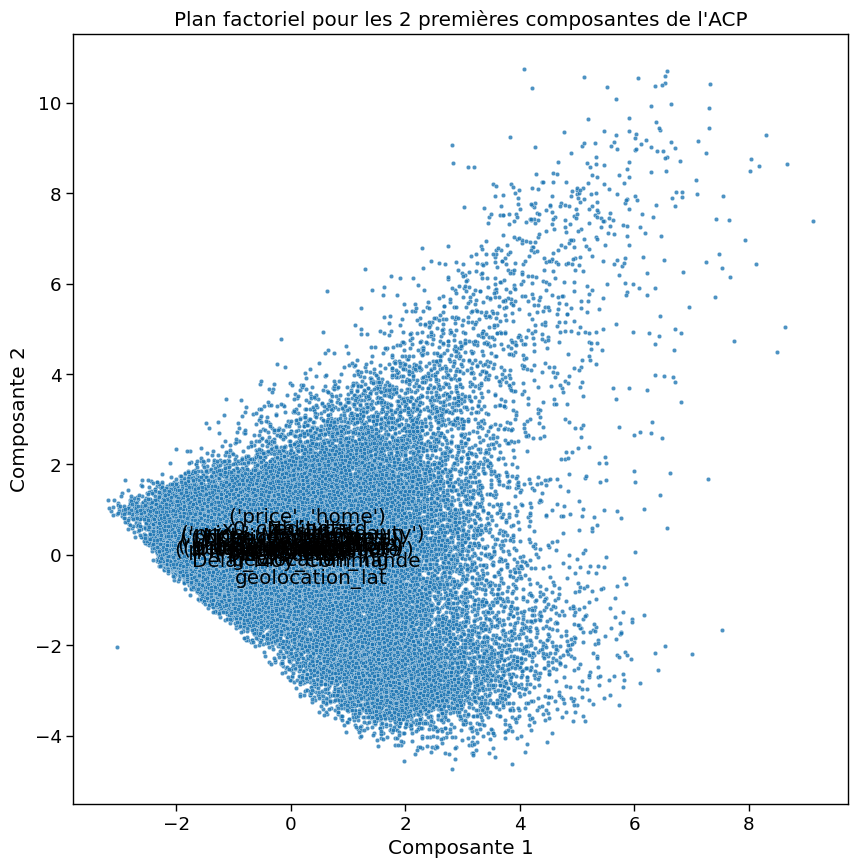

In [77]:
# from matplotlib.patches import Circle
# sns.set_context("paper", font_scale=1.5) 
# plt.figure(figsize=(10,10))
# chaine = "Plan factoriel pour les 2 premières composantes de l'ACP"
# plt.title(chaine)
# plt.xlabel('Composante 1')
# plt.ylabel('Composante 2')
# ax = plt.gca()

# sns.scatterplot(x = x_show,
#                 y = y_show,
#                 #hue = hue_show,
#                 alpha=0.8, s=10)


# i = 0
# '''for x,y,colonne in zip(x_pca,y_pca, colonnes_pca):

#     plt.annotate(colonne, # this is the text
#                  (x,y), # this is the point to label
#                  textcoords="offset points", # how to position the text
#                  xytext=(0,5+np.random.randint(-10,10)), # distance from text to points (x,y)
#                  ha='center') # horizontal alignment can be left, right or center
#     ax.arrow(0, 0, x, y, head_width=0, head_length=0, fc='grey', ec='grey',alpha=0.2)'''


# sns.set_context("paper", font_scale=1) 
# Importer les bibliothèques nécessaires
from matplotlib.patches import Circle
import seaborn as sns

# Paramètres de mise en page
sns.set_context("paper", font_scale=1.5)
plt.figure(figsize=(10, 10))
chaine = "Plan factoriel pour les 2 premières composantes de l'ACP"
plt.title(chaine)
plt.xlabel('Composante 1')
plt.ylabel('Composante 2')
ax = plt.gca()

# Affichage des points de données
sns.scatterplot(x=x_show,
                y=y_show,
                alpha=0.8,
                s=10)

i = 0
# Parcourir les coordonnées des points et les noms des colonnes
for x, y, colonne in zip(x_pca, y_pca, colonnes_pca):
    # Annoter chaque point avec le nom de la colonne correspondante
    plt.annotate(colonne,  # texte à afficher
                 (x, y),  # position du texte
                 textcoords="offset points",  # positionnement du texte par rapport aux points (x, y)
                 xytext=(0, 5+np.random.randint(-10, 10)),  # décalage du texte par rapport aux points
                 ha='center')  # alignement horizontal (gauche, droite ou centre)
    # Tracer des flèches à partir de l'origine (0, 0) vers chaque point
    ax.arrow(0, 0, x, y, head_width=0, head_length=0, fc='grey', ec='grey', alpha=0.2)

sns.set_context("paper", font_scale=1)


Ce code effectue les étapes suivantes :

- Importe les bibliothèques nécessaires.
- Définit les paramètres de mise en page, tels que la taille de la figure et le contexte de la police.
- Crée une figure avec un titre et des étiquettes d'axes.
- Affiche les points de données sur le plan factoriel des deux premières composantes principales.
- Parcourt les coordonnées des points et les noms des colonnes pour annoter chaque point avec le nom de la colonne correspondante.
- Trace des flèches à partir de l'origine (0, 0) vers chaque point pour indiquer la direction de chaque composante principale.
- Rétablit le contexte de la police à sa valeur par défaut.

Cela permet de visualiser les données dans le plan factoriel des deux premières composantes principales de l'analyse en composantes principales (PCA), avec des annotations pour identifier les variables correspondant à chaque point de données.

## KMeans

Modèle KMeans avec le nombre de clusters optimal identifié sur le jeu de données réduit

In [78]:
# kmeans = KMeans(n_clusters=14, 
#                 verbose=1, 
#                 random_state=0).fit(X_pca_tot)
# Importer la classe KMeans du module sklearn.cluster
from sklearn.cluster import KMeans

# Créer une instance de KMeans avec les paramètres suivants :
# - n_clusters : nombre de clusters à former
# - verbose : niveau de verbosité pour le déroulement de l'algorithme
# - random_state : générateur de nombres aléatoires pour la reproductibilité des résultats
kmeans = KMeans(n_clusters=14, verbose=1, random_state=0)

# Appliquer l'algorithme KMeans sur les données X_pca_tot pour effectuer le clustering
kmeans.fit(X_pca_tot)


Initialization complete
Iteration 0, inertia 1060067.6381196892
Iteration 1, inertia 869950.2962416284
Iteration 2, inertia 825115.0447753859
Iteration 3, inertia 814053.5529963054
Iteration 4, inertia 809075.8581792393
Iteration 5, inertia 804926.0166836417
Iteration 6, inertia 801042.650796808
Iteration 7, inertia 796572.3873324448
Iteration 8, inertia 791776.6547110388
Iteration 9, inertia 789338.8531296221
Iteration 10, inertia 788227.2716154779
Iteration 11, inertia 787708.0982759779
Iteration 12, inertia 787444.2073703132
Iteration 13, inertia 787310.4365616718
Iteration 14, inertia 787246.3694844398
Iteration 15, inertia 787215.4121190349
Iteration 16, inertia 787191.2853811501
Iteration 17, inertia 787167.4305487771
Iteration 18, inertia 787147.1203611188
Iteration 19, inertia 787130.8242353639
Iteration 20, inertia 787106.8791091662
Iteration 21, inertia 787065.2836896041
Iteration 22, inertia 786997.5558250782
Iteration 23, inertia 786942.9785383746
Iteration 24, inertia 7869

KMeans(n_clusters=14, random_state=0, verbose=1)

Ce code applique l'algorithme K-means de clustering sur les données `X_pca_tot`. Le clustering est une technique d'apprentissage non supervisé qui vise à regrouper les données similaires en différents clusters en fonction de leurs caractéristiques. 

La ligne `kmeans.fit(X_pca_tot)` exécute l'algorithme K-means sur les données `X_pca_tot`, ce qui signifie qu'il trouve les centres de cluster optimaux et attribue chaque point de données à un cluster spécifique en fonction de sa similarité avec les autres points de données. Les résultats du clustering sont stockés dans l'objet `kmeans`, qui peut ensuite être utilisé pour prédire les clusters pour de nouvelles données ou pour effectuer des analyses supplémentaires sur les clusters obtenus.

In [79]:
kmeans.labels_.shape

(74705,)

Le code `kmeans.labels_.shape` permet de vérifier la forme de l'attribut `labels_` de l'objet `kmeans`. 

L'attribut `labels_` contient les étiquettes de cluster assignées à chaque échantillon dans l'ensemble de données. Il représente le numéro de cluster auquel chaque point de données a été assigné. 

En utilisant `.shape`, on peut obtenir la forme (le nombre de lignes et de colonnes) de l'attribut `labels_`. La forme retournée sera un tuple représentant le nombre d'échantillons (lignes) et le nombre de clusters (colonnes). 

Par exemple, si `kmeans.labels_.shape` renvoie `(1000, 1)`, cela signifie qu'il y a 1000 échantillons et 1 colonne (1 cluster). 

Il existe également d'autres attributs et méthodes disponibles dans l'objet `kmeans` pour analyser les résultats du clustering, tels que :

- `cluster_centers_` : les coordonnées des centres de cluster
- `inertia_` : la somme des distances carrées des échantillons à leur centre de cluster le plus proche (c'est une mesure de la cohésion des clusters)
- `predict(X)` : prédit les clusters pour de nouvelles données `X`
- `fit_predict(X)` : effectue l'apprentissage et la prédiction en un seul appel pour les données `X`
- et d'autres encore, qui peuvent être consultés dans la documentation de la classe `KMeans` de scikit-learn.

In [80]:
# silhouette_score(X = X_pca_tot, labels= kmeans.labels_)
from sklearn.metrics import silhouette_score

# Calcul du score de silhouette pour évaluer la qualité du clustering
silhouette_score(X=X_pca_tot, labels=kmeans.labels_)

0.22910530778915708

- La première ligne importe la fonction `silhouette_score` du module `sklearn.metrics`.
- La deuxième ligne calcule le score de silhouette pour évaluer la qualité du clustering. La fonction `silhouette_score` prend deux arguments :
   - `X` : la matrice des données d'entrée sur laquelle le clustering a été effectué.
   - `labels` : les étiquettes de cluster attribuées à chaque échantillon.
- Le résultat du score de silhouette est retourné. Il mesure à quel point chaque échantillon est similaire à ses propres points du cluster par rapport aux autres points des autres clusters. Un score de silhouette proche de 1 indique une bonne séparation des clusters, tandis qu'un score proche de -1 indique un chevauchement entre les clusters.

N'oubliez pas d'importer le module `sklearn.metrics` au préalable pour pouvoir utiliser la fonction `silhouette_score`.

In [81]:
# inertia = {}
# dict_kmeans = {}
# dict_silhouette = {}
# for k in range(13,16):
#     kmeans = KMeans(n_clusters=k,
#                    verbose=1,
#                    random_state=0,
#                    n_jobs=-1).fit(X_pca_tot)
#     inertia[k] = kmeans.inertia_
#     dict_kmeans[k] = kmeans
#     dict_silhouette[k] = silhouette_score(X = X_pca_tot, labels= kmeans.labels_)
#     print('Boucle {} - Silhouette score : {}'.format(k, dict_silhouette[k]))
inertia = {}  # Dictionnaire pour stocker les valeurs d'inertie
dict_kmeans = {}  # Dictionnaire pour stocker les objets KMeans
dict_silhouette = {}  # Dictionnaire pour stocker les scores de silhouette

# Boucle pour itérer sur différentes valeurs de k
for k in range(13, 16):
    kmeans = KMeans(n_clusters=k,
                    verbose=1,
                    random_state=0).fit(X_pca_tot)
    
    inertia[k] = kmeans.inertia_  # Stocke la valeur d'inertie dans le dictionnaire inertia
    dict_kmeans[k] = kmeans  # Stocke l'objet KMeans dans le dictionnaire dict_kmeans
    dict_silhouette[k] = silhouette_score(X=X_pca_tot, labels=kmeans.labels_)  # Calcule le score de silhouette et le stocke dans le dictionnaire dict_silhouette
    
    # Affiche le score de silhouette pour chaque boucle
    print('Boucle {} - Silhouette score : {}'.format(k, dict_silhouette[k]))    

Initialization complete
Iteration 0, inertia 1108904.3322318422
Iteration 1, inertia 920214.6898760975
Iteration 2, inertia 875282.4156076706
Iteration 3, inertia 863937.0964417631
Iteration 4, inertia 858849.7987583057
Iteration 5, inertia 854500.6973219325
Iteration 6, inertia 849984.5884444567
Iteration 7, inertia 844645.7318764195
Iteration 8, inertia 840762.7741044492
Iteration 9, inertia 839013.1880061061
Iteration 10, inertia 838241.6068985119
Iteration 11, inertia 837872.8016885098
Iteration 12, inertia 837689.8938148215
Iteration 13, inertia 837606.7771792724
Iteration 14, inertia 837570.5915077467
Iteration 15, inertia 837554.4959445574
Iteration 16, inertia 837546.2669865837
Iteration 17, inertia 837543.5163834722
Converged at iteration 17: center shift 5.4433190884805086e-05 within tolerance 0.0001120127543516032.
Initialization complete
Iteration 0, inertia 1112272.4967003288
Iteration 1, inertia 936677.77546324
Iteration 2, inertia 906955.8618452947
Iteration 3, inertia 8

- La première ligne crée un dictionnaire vide appelé `inertia` pour stocker les valeurs d'inertie.
- La deuxième ligne crée un dictionnaire vide appelé `dict_kmeans` pour stocker les objets KMeans.
- La troisième ligne crée un dictionnaire vide appelé `dict_silhouette` pour stocker les scores de silhouette.
- La boucle `for` itère sur les valeurs de `k` de 13 à 15.
- À chaque itération, un objet `KMeans` est créé avec le nombre de clusters `k` spécifié, et les options `verbose=1`, `random_state=0` et `n_jobs=-1` sont définies.
- La valeur d'inertie obtenue à partir de l'objet `KMeans` est stockée dans le dictionnaire `inertia` avec `k` comme clé.
- L'objet `KMeans` est stocké dans le dictionnaire `dict_kmeans` avec `k` comme clé.
- Le score de silhouette est calculé à l'aide de la fonction `silhouette_score` en utilisant les données `X_pca_tot` et les étiquettes de cluster attribuées par l'objet `KMeans`. Le score de silhouette est ensuite stocké dans le dictionnaire `dict_silhouette` avec `k` comme clé.
- À chaque itération, le score de silhouette est affiché.


In [82]:
# if False:
#     inertia = {}
#     dict_kmeans = {}
#     dict_silhouette = {}
#     for k in range(3,15):
#         kmeans = KMeans(n_clusters=k,
#                        verbose=1,
#                        random_state=0,
#                        n_jobs=-1).fit(X_pca_tot)
#         inertia[k] = kmeans.inertia_
#         dict_kmeans[k] = kmeans
#         dict_silhouette[k] = silhouette_score(X = X_pca_tot, labels= kmeans.labels_)
#         print('Boucle {} - Silhouette score : {}'.format(k, dict_silhouette[k]))
if False:
    inertia = {}  # Dictionnaire pour stocker les valeurs d'inertie
    dict_kmeans = {}  # Dictionnaire pour stocker les objets KMeans
    dict_silhouette = {}  # Dictionnaire pour stocker les scores de silhouette

    # Boucle pour itérer sur différentes valeurs de k
    for k in range(3, 15):
        kmeans = KMeans(n_clusters=k,
                        verbose=1,
                        random_state=0).fit(X_pca_tot)

        inertia[k] = kmeans.inertia_  # Stocke la valeur d'inertie dans le dictionnaire inertia
        dict_kmeans[k] = kmeans  # Stocke l'objet KMeans dans le dictionnaire dict_kmeans
        dict_silhouette[k] = silhouette_score(X=X_pca_tot, labels=kmeans.labels_)  # Calcule le score de silhouette et le stocke dans le dictionnaire dict_silhouette

        # Affiche le score de silhouette pour chaque boucle
        print('Boucle {} - Silhouette score : {}'.format(k, dict_silhouette[k]))

- La ligne `if False:` est une condition qui est toujours évaluée à `False`, ce qui signifie que le code à l'intérieur de cette condition ne sera pas exécuté.
- Les lignes suivantes sont identiques au code précédent, et elles créent les mêmes dictionnaires (`inertia`, `dict_kmeans` et `dict_silhouette`) et effectuent les mêmes calculs pour différentes valeurs de `k`.
- Cependant, comme la condition est toujours `False`, le code à l'intérieur de cette condition ne sera jamais exécuté et les dictionnaires `inertia`, `dict_kmeans` et `dict_silhouette` ne seront pas remplis ni affichés.

* Boucle 13 - Silhouette score : 0.22938337882766385
* Boucle 14 - Silhouette score : 0.2380033975405801
* Boucle 15 - Silhouette score : 0.14908158723434908


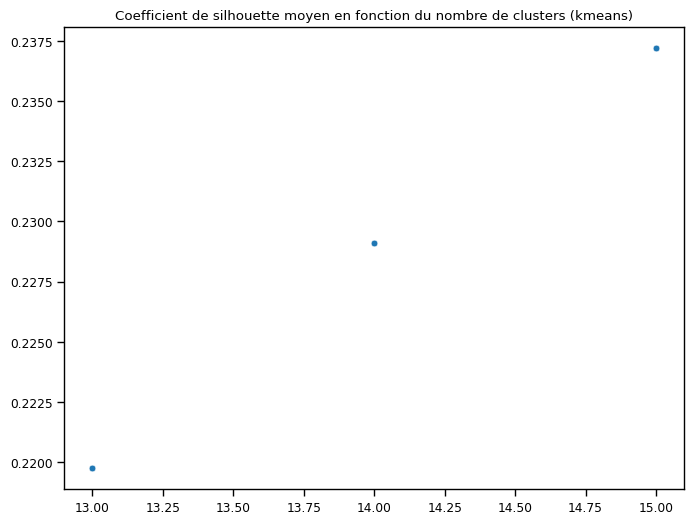

In [83]:
plt.figure(figsize=(8, 6))  # Crée une nouvelle figure avec une taille de 8x6 pouces
plt.title('Coefficient de silhouette moyen en fonction du nombre de clusters (kmeans)')  # Définit le titre du graphique

# Trace un nuage de points avec le nombre de clusters sur l'axe x et le score de silhouette moyen sur l'axe y
sns.scatterplot(x=list(dict_silhouette.keys()),
                y=list(dict_silhouette.values()))

plt.show()  # Affiche le graphique 

Le coefficient de silhouette est maximal pour 14 clusters

Ce code excecute :
- La première ligne crée une nouvelle figure avec une taille de 8x6 pouces pour le graphique.
- La deuxième ligne définit le titre du graphique.
- La troisième ligne utilise la fonction `sns.scatterplot()` pour tracer un nuage de points. L'axe x représente le nombre de clusters (`list(dict_silhouette.keys())`) et l'axe y représente le score de silhouette moyen (`list(dict_silhouette.values())`).
- Enfin, la dernière ligne `plt.show()` affiche le graphique.

## Clustering hiérarchique

In [84]:
# from joblib import Memory
# if False:
#     cah_total = AgglomerativeClustering(n_clusters = 14, memory=Memory('/cache')
#                              ).fit(X_pca_tot)

# from joblib import Memory  # Importe la classe Memory depuis le module joblib

# # if False:  # Condition toujours fausse, le code ci-dessous ne sera pas exécuté
# cah_total = AgglomerativeClustering(n_clusters=14, memory=Memory('/cache')).fit(X_pca_tot)

# from joblib import Memory
# from sklearn.cluster import AgglomerativeClustering

# # Création d'un objet Memory pour le cache
# memory = Memory('/cache')

# @memory.cache  # Utilisation du cache pour éviter les problèmes de mémoire
# def fit_cah(X):
#     cah = AgglomerativeClustering(n_clusters=14)
#     return cah.fit(X)

# # Appel de la fonction fit_cah avec les données X_pca_tot
# cah_total = fit_cah(X_pca_tot)


In [85]:
# from sklearn.cluster import AgglomerativeClustering

# batch_size = 1000000  # Taille du sous-ensemble de données à traiter à la fois
# n_samples = X_pca_tot.shape[0]  # Nombre total d'échantillons
# n_clusters = 14  # Nombre de clusters souhaité
# cah_total = None

# for i in range(0, n_samples, batch_size):
#     start_index = i
#     end_index = min(i + batch_size, n_samples)
#     X_batch = X_pca_tot[start_index:end_index]  # Sous-ensemble de données à traiter
    
#     cah = AgglomerativeClustering(n_clusters=n_clusters)
#     cah_batch = cah.fit(X_batch)
    
#     if cah_total is None:
#         cah_total = cah_batch
#     else:
#         cah_total.labels_ = np.concatenate([cah_total.labels_, cah_batch.labels_])



Non applicable (problème mémoire)

CAH

In [211]:
categorical_features = list(data.select_dtypes(exclude=['int32','int64', 'float64', 'uint8']).columns)
categorical_features

['Cat_la_plus_achetee',
 'customer_city',
 'customer_state',
 'order_purchase_timestamp',
 'Moy_Paiment']

In [212]:
data_bis = data.drop(categorical_features ,axis = 1)
data_bis

,customer_zip_code_prefix,Nb_pdts,Tot_moy_achats,Delai_Moy_Commande,heure_achat,jour_achat,delai_dernier_achat,Note_Moy_Com,Facilités,geolocation_lat,geolocation_lng,"('price', 'home')","('price', 'appliances')","('price', 'construction')","('price', 'office')","('price', 'electronics')","('price', 'arts')","('price', 'fashion')","('price', 'health_beauty')","('price', 'sports_leisure')","('price', 'garden_pets')","('price', 'auto')","('price', 'food_drinks')","('price', 'other')"
customer_unique_id,,,,,,,,,,,,,,,,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,7787,1.0,4.866765,7.0,10.0,3.0,115.0,5.0,8.0,-23.340262,-46.831085,129.9,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0
0000b849f77a49e4a4ce2b2a4ca5be3f,6053,1.0,2.939162,4.0,11.0,0.0,118.0,4.0,1.0,-23.559044,-46.788516,0.0,0.0,0.0,0.0,0.0,0.0,0.0,18.90,0.0,0.0,0.0,0.0,0.0
0000f46a3911fa3c0805444483337064,88115,1.0,4.234107,26.0,21.0,4.0,541.0,3.0,8.0,-27.543010,-48.634938,0.0,0.0,0.0,69.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0
0004aac84e0df4da2b147fca70cf8255,18040,1.0,5.192957,14.0,19.0,1.0,292.0,5.0,6.0,-23.505588,-47.469820,0.0,0.0,0.0,0.0,180.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0
0004bd2a26a76fe21f786e4fbd80607f,5036,1.0,5.036953,2.0,19.0,3.0,150.0,4.0,8.0,-23.515693,-46.690031,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,154.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
fffb09418989a0dbff854a28163e47c6,95330,1.0,4.060443,9.0,19.0,6.0,259.0,5.0,1.0,-28.937008,-51.549726,0.0,0.0,0.0,0.0,0.0,0.0,58.0,0.00,0.0,0.0,0.0,0.0,0.0
fffea47cd6d3cc0a88bd621562a9d061,44054,1.0,4.172694,31.0,20.0,6.0,266.0,4.0,1.0,-12.217900,-38.959237,0.0,0.0,0.0,0.0,0.0,0.0,0.0,64.89,0.0,0.0,0.0,0.0,0.0
ffff371b4d645b6ecea244b27531430a,78552,1.0,4.498698,15.0,15.0,1.0,572.0,5.0,1.0,-11.834705,-55.508145,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,89.9,0.0,0.0


In [213]:
scaler = MinMaxScaler()

preprocessor = ColumnTransformer([
    ('scaler', scaler, data_bis)])

In [214]:
X_cah = data_bis.copy()
X_cah.head(10)

,customer_zip_code_prefix,Nb_pdts,Tot_moy_achats,Delai_Moy_Commande,heure_achat,jour_achat,delai_dernier_achat,Note_Moy_Com,Facilités,geolocation_lat,geolocation_lng,"('price', 'home')","('price', 'appliances')","('price', 'construction')","('price', 'office')","('price', 'electronics')","('price', 'arts')","('price', 'fashion')","('price', 'health_beauty')","('price', 'sports_leisure')","('price', 'garden_pets')","('price', 'auto')","('price', 'food_drinks')","('price', 'other')"
customer_unique_id,,,,,,,,,,,,,,,,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,7787,1.0,4.866765,7.0,10.0,3.0,115.0,5.0,8.0,-23.340262,-46.831085,129.90,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0000b849f77a49e4a4ce2b2a4ca5be3f,6053,1.0,2.939162,4.0,11.0,0.0,118.0,4.0,1.0,-23.559044,-46.788516,0.00,0.0,0.0,0.0,0.00,0.0,0.0,18.9,0.0,0.0,0.0,0.0,0.0
0000f46a3911fa3c0805444483337064,88115,1.0,4.234107,26.0,21.0,4.0,541.0,3.0,8.0,-27.543010,-48.634938,0.00,0.0,0.0,69.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0004aac84e0df4da2b147fca70cf8255,18040,1.0,5.192957,14.0,19.0,1.0,292.0,5.0,6.0,-23.505588,-47.469820,0.00,0.0,0.0,0.0,180.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0004bd2a26a76fe21f786e4fbd80607f,5036,1.0,5.036953,2.0,19.0,3.0,150.0,4.0,8.0,-23.515693,-46.690031,0.00,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,154.0,0.0,0.0,0.0
00050ab1314c0e55a6ca13cf7181fecf,13084,1.0,3.331847,7.0,12.0,4.0,135.0,4.0,1.0,-22.823953,-47.086521,0.00,0.0,0.0,0.0,27.99,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0005e1862207bf6ccc02e4228effd9a0,25966,1.0,4.905275,5.0,23.0,5.0,547.0,4.0,3.0,-22.401531,-42.989311,0.00,0.0,0.0,0.0,0.00,0.0,135.0,0.0,0.0,0.0,0.0,0.0,0.0
0006fdc98a402fceb4eb0ee528f6a8d4,29400,1.0,2.631889,17.0,9.0,1.0,411.0,3.0,2.0,-21.061438,-41.362994,13.90,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
00082cbe03e478190aadbea78542e933,18400,1.0,4.369448,11.0,15.0,6.0,287.0,5.0,1.0,-23.983343,-48.876533,0.00,0.0,0.0,0.0,0.00,0.0,0.0,0.0,79.0,0.0,0.0,0.0,0.0


In [218]:
# Step 3: Preprocessing the data

# Scaling the data to bring all the attributes to a comparable level
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_cah)
  
# Normalizing the data so that 
# the data approximately follows a Gaussian distribution
X_normalized = normalize(X_scaled)
  
# Converting the numpy array into a pandas DataFrame
X_normalized = pd.DataFrame(X_normalized)

In [219]:
# Explained variance
pca_cah = PCA()
pca_cah.fit(X_normalized)

print(pca_cah.explained_variance_)
print(pca_cah.explained_variance_ratio_)

[1.14225718e-01 8.40255440e-02 8.36888327e-02 7.96890276e-02
 7.51713042e-02 7.24148895e-02 6.09626498e-02 4.51704938e-02
 3.83091257e-02 3.56701463e-02 3.33215317e-02 3.17247854e-02
 2.93081552e-02 2.86687124e-02 2.75015015e-02 2.56299728e-02
 2.48210576e-02 2.36238492e-02 2.10644796e-02 2.07151220e-02
 2.01353137e-02 1.18998515e-02 2.78942531e-03 1.34277258e-05]
[1.15316041e-01 8.48275959e-02 8.44876706e-02 8.04496860e-02
 7.58888394e-02 7.31061138e-02 6.15445586e-02 4.56016613e-02
 3.86747991e-02 3.60106298e-02 3.36395969e-02 3.20276091e-02
 2.95879114e-02 2.89423648e-02 2.77640125e-02 2.58746194e-02
 2.50579829e-02 2.38493467e-02 2.12655471e-02 2.09128548e-02
 2.03275120e-02 1.20134396e-02 2.81605131e-03 1.35558980e-05]


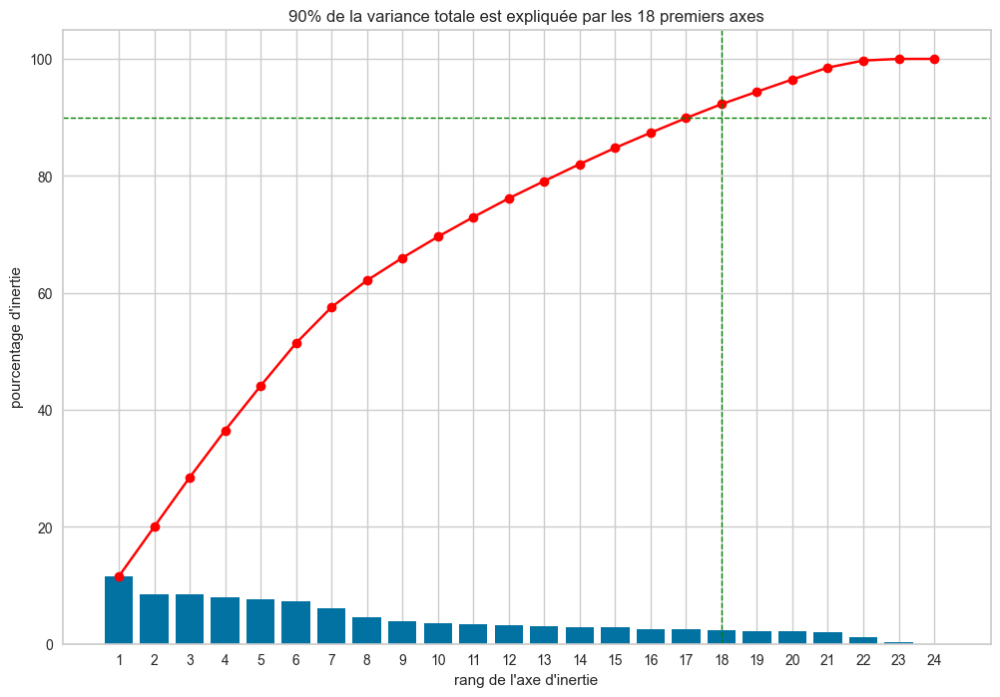

In [227]:
# Explained variance
pca_cah = PCA()
pca_cah.fit(X_normalized)
varexpl = pca_cah.explained_variance_ratio_*100

# Plot of cumulated variance
plt.figure(figsize=(12,8))
plt.bar(np.arange(len(varexpl))+1, varexpl)

cumSumVar = varexpl.cumsum() 
plt.plot(np.arange(len(varexpl))+1, cumSumVar,c="red",marker='o')
plt.axhline(y=90, linestyle="--", 
            color="green",
            linewidth=1)

limit = 90
valid_idx = np.where(cumSumVar >= limit)[0]
min_plans = valid_idx[cumSumVar[valid_idx].argmin()]+1
plt.axvline(x=min_plans, linestyle="--", 
            color="green",
            linewidth=1)

plt.xlabel("rang de l'axe d'inertie")
plt.xticks(np.arange(len(varexpl))+1)
plt.ylabel("pourcentage d'inertie")
plt.title("{}% de la variance totale est expliquée"\
          " par les {} premiers axes".format(limit,
                                            min_plans))
plt.show(block=False)

In [228]:
# 4 : Réduire la dimensionnalité des Données

pca_cah2 = PCA(n_components = 2)
X_principal = pca_cah2.fit_transform(X_normalized)
X_principal = pd.DataFrame(X_principal)
X_principal.columns = ['P1', 'P2']

In [229]:
from sklearn.model_selection import train_test_split

In [230]:
 X_train, X_test,  = train_test_split(
                     X_principal,  test_size=0.8, random_state=0)

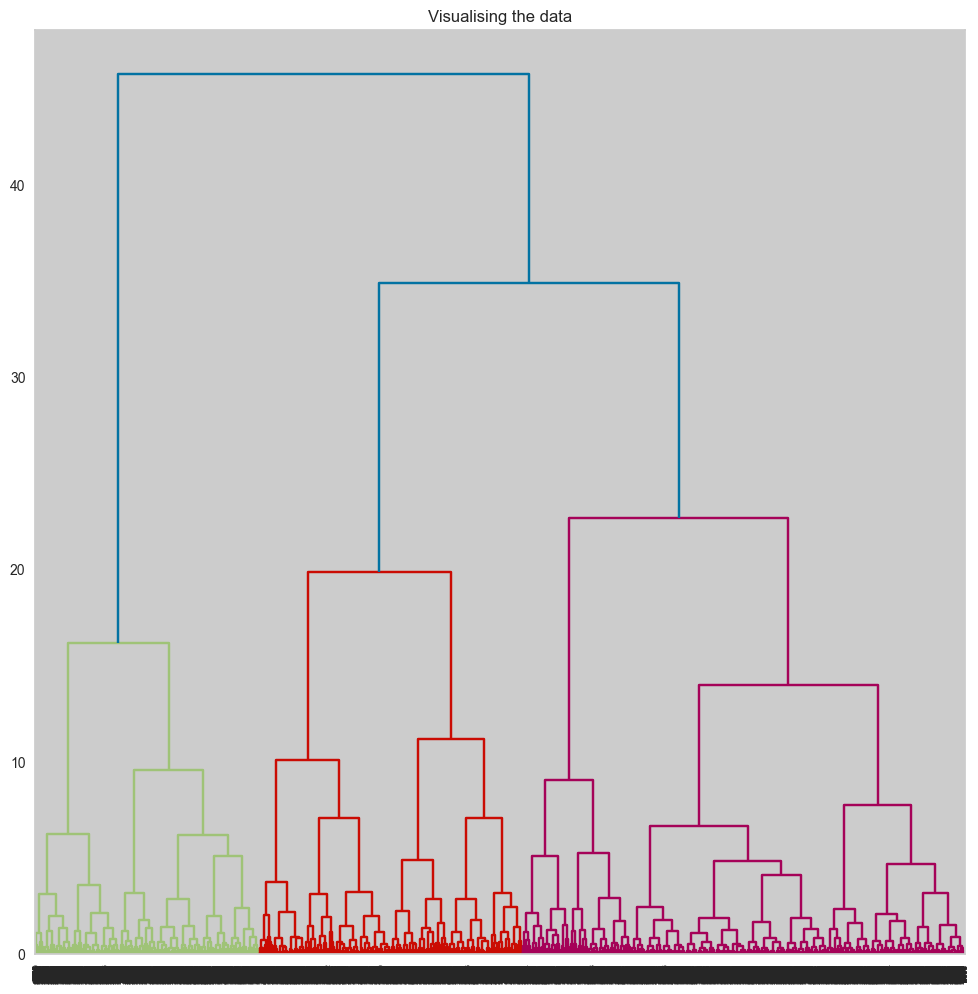

In [233]:
# # Dendograms are used to divide a given cluster into many different clusters.

# # Step 5: Visualizing the working of the Dendograms

# plt.figure(figsize =(12, 12))
# plt.title('Visualising the data')
# Dendrogram = shc.dendrogram((shc.linkage(X_train, method ='ward')))
# Étape 5: Visualiser le fonctionnement des dendrogrammes

# Créer une figure pour le dendrogramme avec une taille de 12x12 pouces
plt.figure(figsize=(12, 12))

# Donner un titre à la figure
plt.title('Visualisation des données')

# Calculer le dendrogramme à l'aide de la méthode Ward pour la liaison (agglomération) des données
# et le stocker dans la variable 'Dendrogram'
Dendrogram = shc.dendrogram((shc.linkage(X_train, method='ward')))


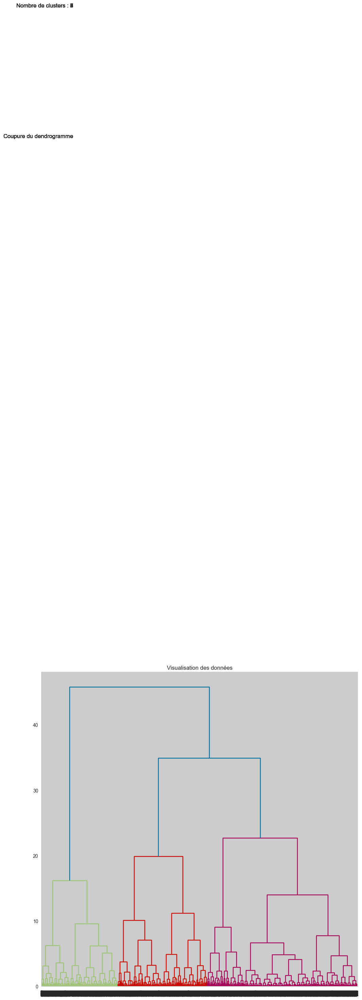

In [235]:
# Importer les bibliothèques nécessaires
import matplotlib.pyplot as plt
import scipy.cluster.hierarchy as shc

# Étape 5: Visualiser le fonctionnement des dendrogrammes

# Créer une figure pour le dendrogramme avec une taille de 12x12 pouces
plt.figure(figsize=(12, 12))

# Donner un titre à la figure
plt.title('Visualisation des données')

# Calculer le dendrogramme à l'aide de la méthode Ward pour la liaison (agglomération) des données
# et le stocker dans la variable 'Dendrogram'
Dendrogram = shc.dendrogram(shc.linkage(X_train, method='ward'))

# Définir une liste de nombre de clusters à tester
nombre_clusters = [2, 3, 4, 5, 6, 7]

# Tracer des lignes verticales pour chaque nombre de clusters et les annoter sur le graphique
for n_clusters in nombre_clusters:
    clusters = shc.fcluster(shc.linkage(X_train, method='ward'), t=n_clusters, criterion='maxclust')
    plt.axhline(y=150, linestyle='dashed', color='gray')
    plt.text(len(X_train)+5, 150, f'Nombre de clusters : {n_clusters}', fontsize=12, ha='right', va='center')
    plt.axhline(y=130, linestyle='dashed', color='gray')
    plt.text(len(X_train)+5, 130, 'Coupure du dendrogramme', fontsize=12, ha='right', va='center')

# Afficher le graphique dendrogramme
plt.show()


In [236]:
 y_train, y_test,  = train_test_split(
                     X_principal,  test_size=0.2, random_state=0)

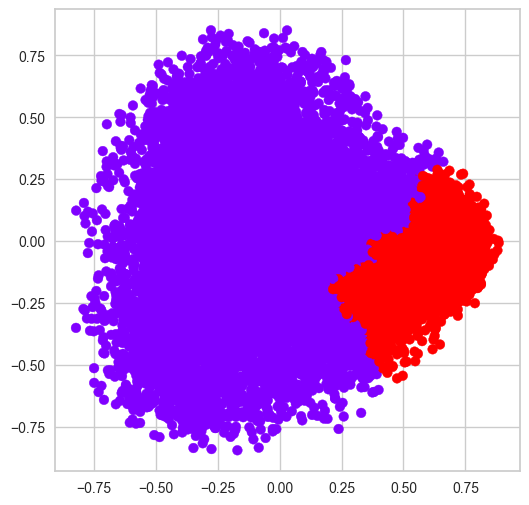

In [237]:
# Step 6: Building and Visualizing the different clustering models for different values of k
# k = 2

ac2 = AgglomerativeClustering(n_clusters = 2)
  
# Visualizing the clustering
plt.figure(figsize =(6, 6))
plt.scatter(y_test['P1'], y_test['P2'],
            c = ac2.fit_predict(y_test), cmap ='rainbow')
plt.show()

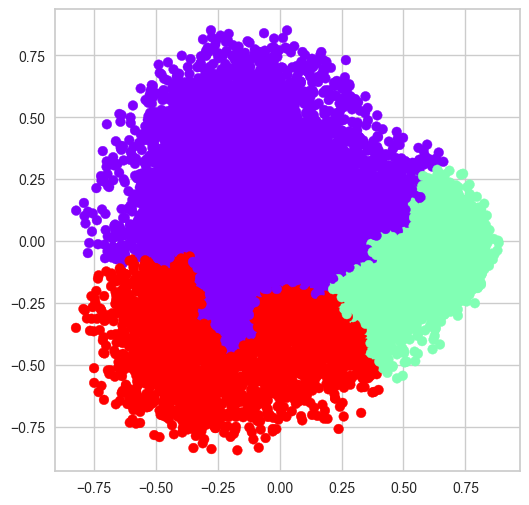

In [238]:
# k = 3

ac3 = AgglomerativeClustering(n_clusters = 3)
  
plt.figure(figsize =(6, 6))
plt.scatter(y_test['P1'], y_test['P2'],
            c = ac3.fit_predict(y_test), cmap ='rainbow')
plt.show()

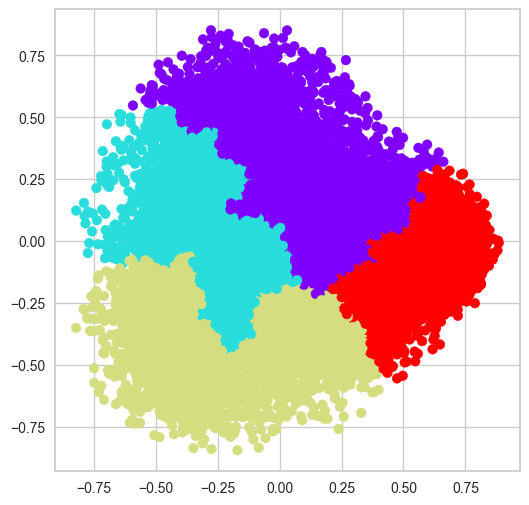

In [239]:
# k = 4

ac4 = AgglomerativeClustering(n_clusters = 4)
  
plt.figure(figsize =(6, 6))
plt.scatter(y_test['P1'], y_test['P2'],
            c = ac4.fit_predict(y_test), cmap ='rainbow')
plt.show()

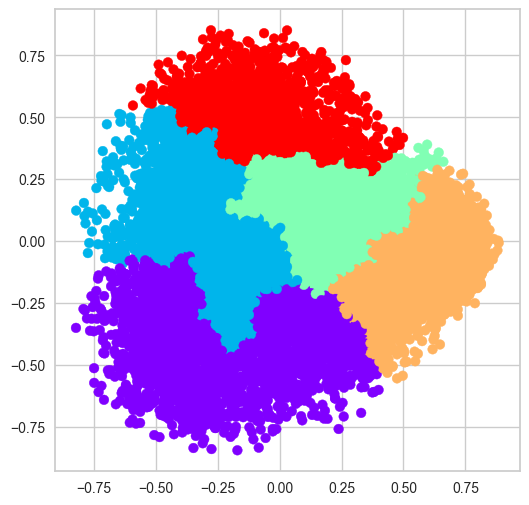

In [240]:
# k = 5

ac5 = AgglomerativeClustering(n_clusters = 5)
  
plt.figure(figsize =(6, 6))
plt.scatter(y_test['P1'], y_test['P2'],
            c = ac5.fit_predict(y_test), cmap ='rainbow')
plt.show()

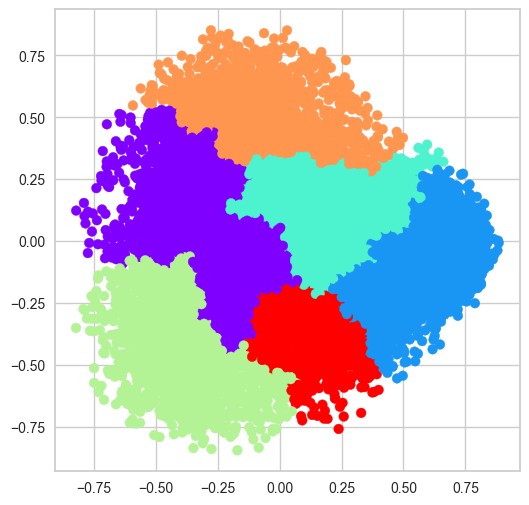

In [241]:
# k = 6

ac6 = AgglomerativeClustering(n_clusters = 6)
  
plt.figure(figsize =(6, 6))
plt.scatter(y_test['P1'], y_test['P2'],
            c = ac6.fit_predict(y_test), cmap ='rainbow')
plt.show()

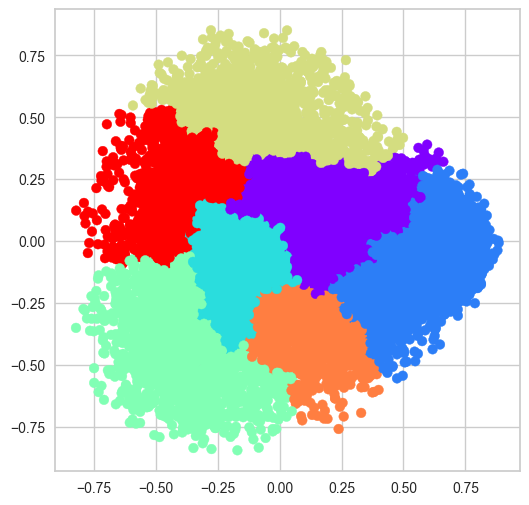

In [242]:
# k = 7

ac7 = AgglomerativeClustering(n_clusters = 7)
  
plt.figure(figsize =(6, 6))
plt.scatter(y_test['P1'], y_test['P2'],
            c = ac7.fit_predict(y_test), cmap ='rainbow')
plt.show()

In [243]:
# Step 7: Evaluating the different models and Visualizing the results.

# Appending the silhouette scores of the different models to the list
silhouette_scores = []
silhouette_scores.append(
        silhouette_score(y_test, ac2.fit_predict(y_test)))
silhouette_scores.append(
        silhouette_score(y_test, ac3.fit_predict(y_test)))
silhouette_scores.append(
        silhouette_score(y_test, ac4.fit_predict(y_test)))
silhouette_scores.append(
        silhouette_score(y_test, ac5.fit_predict(y_test)))
silhouette_scores.append(
        silhouette_score(y_test, ac6.fit_predict(y_test)))
silhouette_scores.append(
        silhouette_score(y_test, ac7.fit_predict(y_test)))

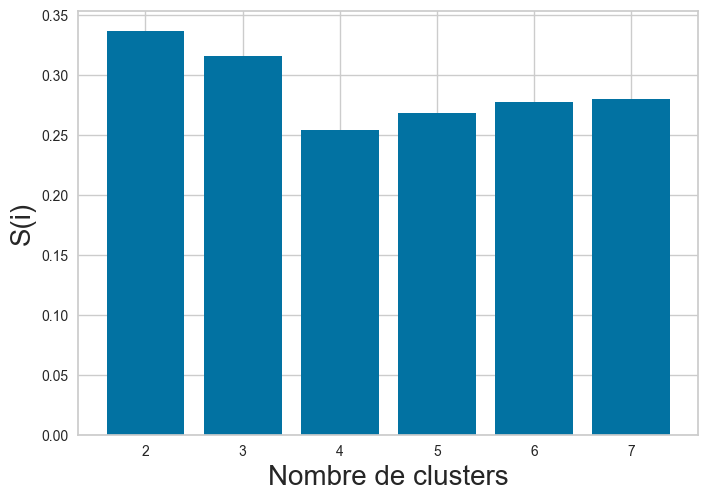

In [245]:
# # Plotting a bar graph to compare the results
# k = [2, 3, 4, 5, 6, 7]
# plt.bar(k, silhouette_scores)
# plt.xlabel('Number of clusters', fontsize = 20)
# plt.ylabel('S(i)', fontsize = 20)
# plt.show()
# Importer les bibliothèques nécessaires
import matplotlib.pyplot as plt

# Liste des nombres de clusters à tester
k = [2, 3, 4, 5, 6, 7]

# Tracer un graphique en barres pour comparer les résultats
plt.bar(k, silhouette_scores)

# Ajouter une étiquette pour l'axe des abscisses (nombre de clusters)
plt.xlabel('Nombre de clusters', fontsize=20)

# Ajouter une étiquette pour l'axe des ordonnées (valeur de S(i) - silhouette_score)
plt.ylabel('S(i)', fontsize=20)

# Afficher le graphique
plt.show()


In [246]:
Xbis_train,Xbis_test   = train_test_split(
                     X_normalized,  test_size=0.8, random_state=0)

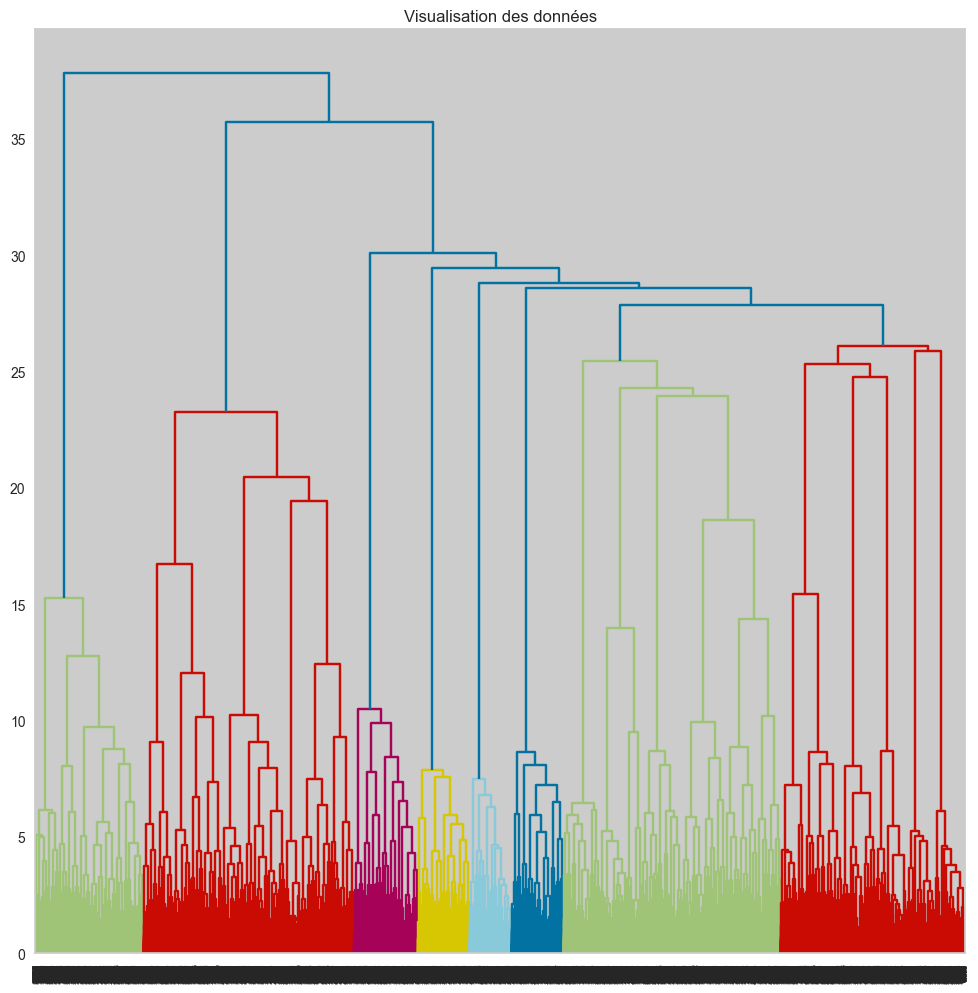

In [262]:
# Créer une figure pour le dendrogramme avec une taille de 12x12 pouces
plt.figure(figsize=(12, 12))

# Donner un titre à la figure
plt.title('Visualisation des données')

# Calculer le dendrogramme à l'aide de la méthode Ward pour la liaison (agglomération) des données
# et le stocker dans la variable 'Dendrogram'
Dendrogram = shc.dendrogram((shc.linkage(Xbis_train, method='ward')))

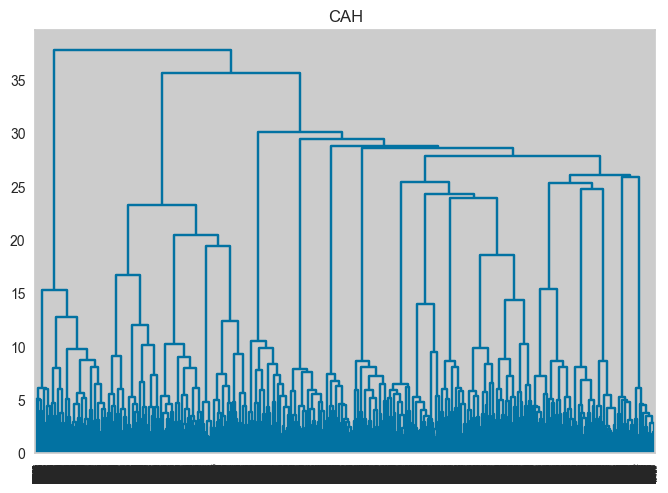

In [250]:
from scipy.cluster.hierarchy import linkage,dendrogram
Z = linkage(Xbis_train,method='ward',metric='euclidean')
#affichage du dendrogramme
plt.title("CAH")
dendrogram(Z,labels=Xbis_train.index,orientation='top',color_threshold=0)
plt.show()

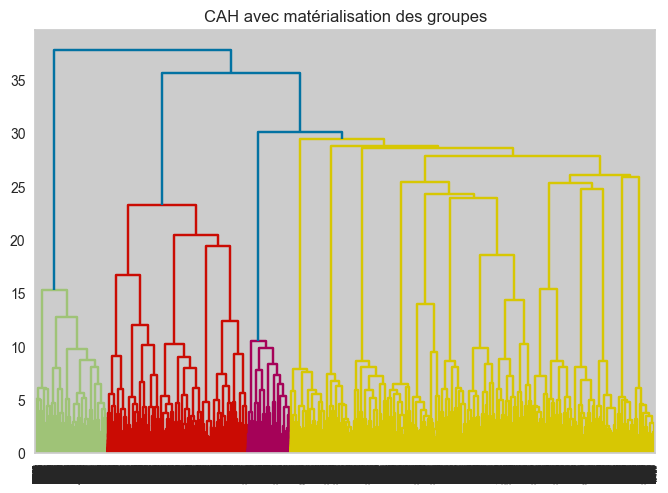

        0
1   68268
1    9643
1    1926
1   19058
1   26539
..    ...
4   61330
4   39829
4   20546
4   31771
4   26211

[14941 rows x 1 columns]


In [261]:
# Importer les bibliothèques nécessaires
from scipy.cluster.hierarchy import ward, fcluster

# Calculer le dendrogramme à l'aide de la méthode Ward pour la liaison (agglomération) des données
# et stocker les informations de liaison dans la variable 'Z'
# Z = ward(Xbis_train, metric='euclidean')
Z = linkage(Xbis_train, method='ward')

# Afficher le dendrogramme avec la matérialisation des groupes
# Modifier la valeur de 'color_threshold' pour changer les couleurs des groupes
plt.title('CAH avec matérialisation des groupes')
dendrogram(Z, labels=Xbis_train.index, orientation='top', color_threshold=30)
plt.show()

# Découper l'arbre hiérarchique pour obtenir les identifiants des groupes souhaités
# Modifier la valeur de 't' pour changer le nombre de groupes
groupes_cah = fcluster(Z, t=30, criterion='distance')

# Trier les index des groupes pour afficher les observations et leurs groupes triés
idg = np.argsort(groupes_cah)

# Afficher les observations et leurs groupes triés dans un DataFrame
print(pd.DataFrame(X_train.index[idg], groupes_cah[idg]))


In [1]:
# # Importer les bibliothèques nécessaires
# import seaborn as sns
# from scipy.cluster.hierarchy import linkage, fcluster, dendrogram

# # Calculer le dendrogramme à l'aide de la méthode Ward pour la liaison (agglomération) des données
# # et stocker les informations de liaison dans la variable 'Z'
# Z = linkage(Xbis_train, method='ward')

# # Déterminer le nombre de groupes de manière dynamique en utilisant la méthode du coude (elbow method)
# # pour trouver le bon seuil de découpage
# last = Z[-10:, 2]
# last_rev = last[::-1]
# idxs = np.arange(1, len(last) + 1)
# plt.plot(idxs, last_rev)

# # Calculer les pentes des segments
# acceleration = np.diff(last, 2)
# acceleration_rev = acceleration[::-1]
# plt.plot(idxs[:-2] + 1, acceleration_rev)

# # Trouver l'indice de la pente la plus grande (le coude)
# k = acceleration_rev.argmax() + 2
# plt.axvline(x=k, linestyle="--", color="red", label='Nombre de groupes optimal')

# plt.xlabel("Nombre de groupes")
# plt.ylabel("Inertie")
# plt.legend()
# plt.title("Méthode du coude pour déterminer le nombre optimal de groupes")
# plt.show()

# # Utiliser le nombre de groupes optimal pour découper l'arbre hiérarchique
# groupes_cah = fcluster(Z, k, criterion='maxclust')

# # Trier les index des groupes pour afficher les observations et leurs groupes triés
# idg = np.argsort(groupes_cah)

# # Définir une palette de couleurs pour les différents groupes
# palette = sns.color_palette("hls", k)

# # Colorer les différentes observations en fonction de leurs groupes
# sns.scatterplot(data=Xbis_train, x='feature_1', y='feature_2', hue=groupes_cah, palette=palette)
# plt.title("Groupes obtenus par la CAH")
# plt.xlabel("Feature 1")
# plt.ylabel("Feature 2")
# plt.show()

# # Afficher les observations et leurs groupes triés dans un DataFrame
# print(pd.DataFrame({'Observations': X_train.index[idg], 'Groupes': groupes_cah[idg]}))


## Exports

Exportons notre modèle et notre jeu de données

In [86]:
# #export kmeans
# filename = 'models/kmeans_14_full_dataset.obj' 
# with  open(filename, 'wb') as filehandler :
#     pickle.dump(dict_kmeans[14], filehandler)

# # Export du modèle K-means
# filename = 'models/kmeans_14_full_dataset.obj'  # Nom du fichier de sauvegarde
# with open(filename, 'wb') as filehandler:  # Ouverture du fichier en mode écriture binaire
#     pickle.dump(dict_kmeans[14], filehandler)  # Sauvegarde du modèle K-means dans le fichier

import os

# Export du modèle K-means
directory = 'models'  # Nom du répertoire
filename = 'kmeans_14_full_dataset.obj'  # Nom du fichier de sauvegarde
filepath = os.path.join(directory, filename)  # Chemin complet du fichier

# Vérification et création du répertoire si nécessaire
if not os.path.exists(directory):
    os.makedirs(directory)

# Sauvegarde du modèle K-means dans le fichier
with open(filepath, 'wb') as filehandler:  # Ouverture du fichier en mode écriture binaire
    pickle.dump(dict_kmeans[14], filehandler)  # Sauvegarde du modèle K-means dans le fichier


In [87]:
# #export OHE
# filename = 'models/ohe.obj' 
# with  open(filename, 'wb') as filehandler :
#     pickle.dump(ohe, filehandler)
    
# #export SS
# filename = 'models/ss.obj' 
# with  open(filename, 'wb') as filehandler :
#     pickle.dump(ss, filehandler)
    
# #export modèle PCA
# filename = 'models/pca_tot.obj' 
# with  open(filename, 'wb') as filehandler :
#     pickle.dump(pca_tot, filehandler)
# Export du One-Hot Encoder (OHE)
filename_ohe = 'models/ohe.obj'  # Nom du fichier de sauvegarde pour le One-Hot Encoder
with open(filename_ohe, 'wb') as filehandler:  # Ouverture du fichier en mode écriture binaire
    pickle.dump(ohe, filehandler)  # Sauvegarde du One-Hot Encoder dans le fichier

# Export du StandardScaler (SS)
filename_ss = 'models/ss.obj'  # Nom du fichier de sauvegarde pour le StandardScaler
with open(filename_ss, 'wb') as filehandler:  # Ouverture du fichier en mode écriture binaire
    pickle.dump(ss, filehandler)  # Sauvegarde du StandardScaler dans le fichier

# Export du modèle PCA
filename_pca = 'models/pca_tot.obj'  # Nom du fichier de sauvegarde pour le modèle PCA
with open(filename_pca, 'wb') as filehandler:  # Ouverture du fichier en mode écriture binaire
    pickle.dump(pca_tot, filehandler)  # Sauvegarde du modèle PCA dans le fichier

Dans ce code, nous exportons les objets OHE, SS et PCA dans des fichiers pour une utilisation ultérieure. 

- Pour chaque export, nous avons une variable `filename` qui contient le chemin et le nom du fichier de sauvegarde où nous souhaitons stocker l'objet correspondant. Assurez-vous d'adapter le chemin et le nom de fichier selon vos besoins.
- Pour chaque export, la ligne `with open(filename, 'wb') as filehandler:` ouvre le fichier en mode écriture binaire. L'utilisation du gestionnaire de contexte `with` garantit que le fichier sera correctement fermé après son utilisation.
- Pour chaque export, `pickle.dump(objet, filehandler)` enregistre l'objet (OHE, SS ou PCA) dans le fichier spécifié. La fonction `pickle.dump()` sérialise l'objet et l'écrit dans le fichier binaire.

### Import

In [88]:
file = open('models/kmeans_14_full_dataset.obj', 'rb')
model = pickle.load(file)

## Représentation des variables 

In [89]:
nb_clusters = 14
if False:
    tsne = TSNE(n_components=2)
    T = tsne.fit_transform(X_pca_tot.copy())
    graph = pd.DataFrame(data = [T[:,0], T[:,1], model.labels_]).T
    graph.columns = ['X', 'Y', 'label']
    plt.figure(figsize=(10,10))
    plt.title('Représentation de la séparation des données du KMEANS via T-SNE')
    sns.scatterplot(graph['X'], graph['Y'], hue = graph['label'], legend='full',
                   palette=sns.color_palette("hls",14),
                    alpha=1, s=15,)
    plt.legend(loc='upper left', labels=graph['label'].unique())
    plt.show()    
else:
        graph = pd.DataFrame(data = [model.labels_]).T
        graph.columns = ['label']


In [90]:
# Réduction de dimensions avec t-SNE
nb_clusters = 14  # Nombre de clusters souhaité
tsne = TSNE(n_components=2)  # Création d'un objet t-SNE avec 2 dimensions
T = tsne.fit_transform(X_pca_tot.copy())  # Réduction de dimensions de X_pca_tot avec t-SNE

# Création d'un DataFrame pour la visualisation
graph = pd.DataFrame(data=[T[:, 0], T[:, 1], model.labels_]).T  # Création d'un DataFrame avec les coordonnées réduites et les labels
graph.columns = ['X', 'Y', 'label']  # Définition des noms de colonnes du DataFrame

# Affichage de la séparation des données du K-means via t-SNE
plt.figure(figsize=(10, 10))  # Création d'une figure avec la taille spécifiée
plt.title('Représentation de la séparation des données du KMEANS via T-SNE')  # Titre du graphique

# Affichage des points en utilisant un nuage de points coloré par cluster
sns.scatterplot(graph['X'], graph['Y'], hue=graph['label'], legend='full',
                palette=sns.color_palette("hls", nb_clusters),
                alpha=1, s=15)  # Utilisation de la palette de couleurs 'hls' avec le nombre de clusters spécifié
plt.legend(loc='upper left', labels=graph['label'].unique())  # Affichage de la légende avec les labels de clusters uniques
plt.show()  # Affichage du graphique


Un objet t-SNE (t-distributed Stochastic Neighbor Embedding) est un algorithme de réduction de dimension non linéaire couramment utilisé pour la visualisation de données à haute dimension. Il est largement utilisé pour visualiser des données complexes dans un espace bidimensionnel (2D), permettant ainsi de mieux comprendre la structure sous-jacente des données et les relations entre les échantillons.

La ligne de code `tsne = TSNE(n_components=2)` crée un objet t-SNE avec deux composantes (n_components=2). Les deux composantes correspondent aux deux dimensions du nouvel espace dans lequel les données seront réduites.

La ligne de code suivante `T = tsne.fit_transform(X_pca_tot.copy())` applique l'algorithme t-SNE à `X_pca_tot`, qui est la matrice des données après avoir été prétraitées avec l'analyse en composantes principales (PCA). Le résultat est stocké dans `T`, qui représente les données réduites dans les deux nouvelles dimensions.

Le t-SNE fonctionne en modélisant les similitudes entre les points d'origine (dans l'espace à haute dimension) et en cherchant à conserver ces similitudes dans l'espace réduit à deux dimensions. Il est particulièrement utile pour visualiser des données complexes, telles que des données provenant d'analyses de texte ou d'images, où les relations non linéaires entre les échantillons sont importantes.

En résumé, l'objet t-SNE permet de réduire la dimensionnalité de données complexes dans un espace à deux dimensions afin de faciliter leur visualisation et de mettre en évidence les structures et relations cachées entre les échantillons. Il est couramment utilisé dans l'analyse exploratoire de données et la visualisation des résultats d'algorithmes de traitement de données.

Dans ce code, nous utilisons t-SNE pour réduire les dimensions des données X_pca_tot en 2 dimensions (`n_components=2`). Ensuite, nous créons un DataFrame `graph` avec les coordonnées réduites et les labels du modèle K-means. Nous utilisons la fonction `sns.scatterplot()` pour afficher les points en utilisant un nuage de points coloré par cluster, avec une légende affichant les labels de clusters uniques. Le nombre de clusters est spécifié avec `nb_clusters` pour créer une palette de couleurs correspondant à ce nombre de clusters. Enfin, nous utilisons `plt.show()` pour afficher le graphique t-SNE.

In [ ]:
# Ajout des coordonnées réduites x_show, y_show et z_show au DataFrame graph
graph['x_pca'] = x_show  # Colonne 'x_pca' avec les coordonnées x_show
graph['y_pca'] = y_show  # Colonne 'y_pca' avec les coordonnées y_show
graph['z_pca'] = z_show  # Colonne 'z_pca' avec les coordonnées z_show

Dans ce code, nous ajoutons les coordonnées réduites `x_show`, `y_show` et `z_show` au DataFrame `graph`. Nous créons ainsi trois nouvelles colonnes dans le DataFrame pour stocker ces coordonnées dans les colonnes 'x_pca', 'y_pca' et 'z_pca'.

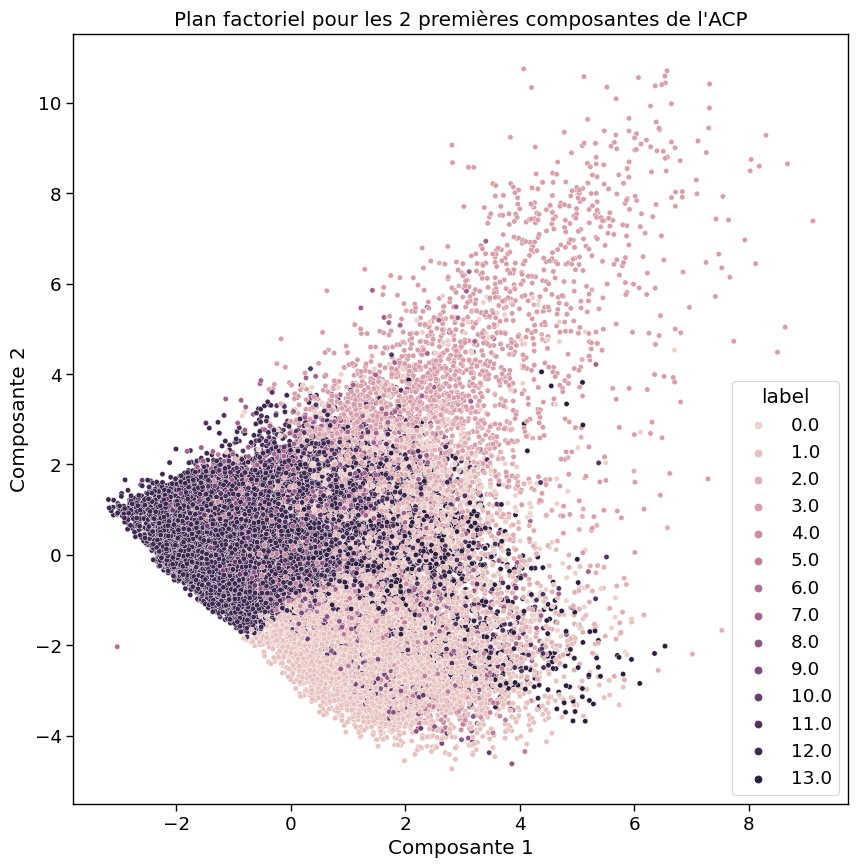

In [ ]:
# from matplotlib.patches import Circle
# sns.set_context("paper", font_scale=1.5) 
# plt.figure(figsize=(10,10))
# chaine = "Plan factoriel pour les 2 premières composantes de l'ACP"
# plt.title(chaine)
# plt.xlabel('Composante 1')
# plt.ylabel('Composante 2')
# ax = plt.gca()

# sns.scatterplot(x = graph['x_pca'], 
#                 y = graph['y_pca'], 
#                 hue = graph['label'],
#                 alpha=1, s=15, legend='full')

# sns.set_context("paper", font_scale=1) 
from matplotlib.patches import Circle
sns.set_context("paper", font_scale=1.5)  # Définit le contexte de l'affichage pour la taille de la police
plt.figure(figsize=(10, 10))  # Crée une figure avec la taille spécifiée

# Définit la chaîne de caractères pour le titre du graphique
chaine = "Plan factoriel pour les 2 premières composantes de l'ACP"
plt.title(chaine)  # Définit le titre du graphique
plt.xlabel('Composante 1')  # Définit le label de l'axe des abscisses
plt.ylabel('Composante 2')  # Définit le label de l'axe des ordonnées
ax = plt.gca()  # Obtient l'axe actuel

# Affichage des points du graphique t-SNE avec les couleurs correspondant aux clusters
sns.scatterplot(x=graph['x_pca'], 
                y=graph['y_pca'], 
                hue=graph['label'],
                alpha=1, s=15, legend='full')

sns.set_context("paper", font_scale=1)  # Réinitialise le contexte de l'affichage pour la taille de la police

Dans ce code, nous utilisons `sns.set_context()` pour définir le contexte de l'affichage avec une taille de police spécifique. Ensuite, nous créons une figure avec la taille spécifiée à l'aide de `plt.figure()`. La chaîne de caractères `chaine` est définie pour le titre du graphique à l'aide de `plt.title()`, et les labels des axes des abscisses et des ordonnées sont définis avec `plt.xlabel()` et `plt.ylabel()`, respectivement. L'objet `ax` est créé pour obtenir l'axe actuel à l'aide de `plt.gca()`.

Ensuite, nous utilisons `sns.scatterplot()` pour afficher les points du graphique t-SNE avec les coordonnées `x_pca` et `y_pca` comme abscisses et ordonnées, respectivement. Les couleurs des points correspondent aux clusters, définis par la colonne 'label' dans le DataFrame `graph`. Les paramètres `alpha=1` et `s=15` définissent respectivement la transparence et la taille des points du nuage de points. Enfin, nous utilisons `sns.set_context()` pour réinitialiser le contexte de l'affichage pour la taille de la police.

<Axes: title={'center': "Distribution du nombre d'individus par cluster, en pourcentage"}>

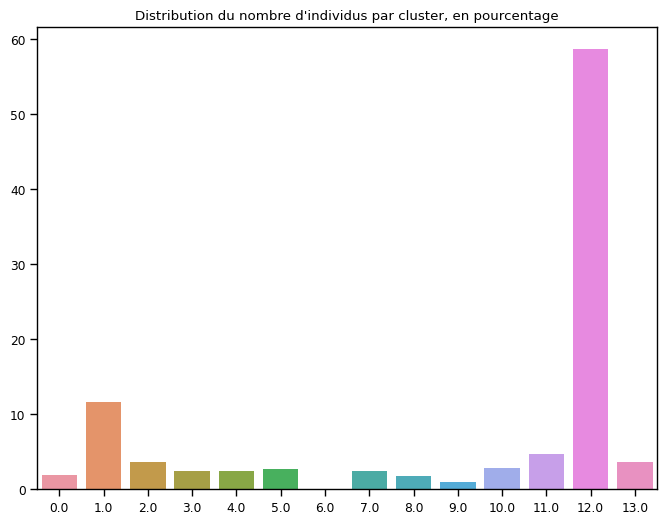

In [ ]:
# plt.figure(figsize=(8,6))
# plt.title('Distribution du nombre d\'individus par cluster, en pourcentage')
# sns.barplot(x = graph['label'].value_counts().index, 
#            y=graph['label'].value_counts().values/len(graph)*100)
# Crée une figure avec la taille spécifiée
plt.figure(figsize=(8, 6))

# Définit le titre du graphique
plt.title('Distribution du nombre d\'individus par cluster, en pourcentage')

# Affiche la distribution du nombre d'individus par cluster en pourcentage à l'aide d'un diagramme à barres
# Les abscisses sont les labels de clusters triés par nombre d'individus
# Les ordonnées sont les pourcentages du nombre d'individus pour chaque cluster
sns.barplot(x=graph['label'].value_counts().index, 
            y=graph['label'].value_counts().values / len(graph) * 100)


Dans ce code, nous utilisons `sns.barplot()` pour afficher la distribution du nombre d'individus par cluster en pourcentage à l'aide d'un diagramme à barres. L'axe des abscisses est constitué des labels de clusters triés par nombre d'individus (c'est-à-dire les clusters les plus fréquents apparaissent en premier). L'axe des ordonnées affiche les pourcentages du nombre d'individus pour chaque cluster, calculés en divisant le nombre d'individus dans chaque cluster par le nombre total d'individus dans le DataFrame `graph`, multiplié par 100 pour obtenir le pourcentage.

Ce graphique permet de visualiser la répartition des individus dans chaque cluster sous forme de pourcentage, ce qui est utile pour comprendre la distribution des données dans les différents groupes identifiés par l'algorithme K-means.

## Caractérisation des clusters 

### Représentation

In [ ]:
graph.sample(10)

,X,Y,label,x_pca,y_pca,z_pca
33660,19.817184,19.322990,2.0,0.995780,0.371670,-0.652650
12739,-16.092775,-26.301970,12.0,-1.750737,0.119475,0.467599
11836,-42.078331,5.309196,12.0,-0.652262,-0.168278,0.097332
29263,11.730019,11.861745,12.0,-0.454529,-0.721127,0.383632
55412,14.041509,-3.445893,12.0,0.237497,-0.107564,-0.068729
62445,7.285047,18.482046,1.0,2.195488,-1.129712,-0.096968
29533,-34.067375,-27.984364,10.0,-0.124422,-0.803355,-0.291631
63782,-18.913378,-2.149711,12.0,-1.161084,-0.799833,0.904660
10316,12.940463,23.924576,12.0,-1.139879,0.151159,-0.356786
31007,16.388910,25.435520,12.0,-1.553679,0.726768,-0.527873


In [ ]:
X2=X_tot.copy()

In [ ]:
X2.shape

(74705, 27)

In [ ]:
X2['label'] = graph['label']
group_columns = X2.groupby('label').mean()

### Répartition par feature 

In [ ]:
X_tot_2 = data.copy()
X_tot_2['label'] = model.labels_

In [ ]:
X_tot_2.head(2)

,Nb_pdts,Tot_moy_achats,Delai_Moy_Commande,order_purchase_timestamp,heure_achat,jour_achat,delai_dernier_achat,Note_Moy_Com,Moy_Paiment,Facilités,geolocation_lat,geolocation_lng,"('price', 'home')","('price', 'appliances')","('price', 'construction')","('price', 'office')","('price', 'electronics')","('price', 'arts')","('price', 'fashion')","('price', 'health_beauty')","('price', 'sports_leisure')","('price', 'garden_pets')","('price', 'auto')","('price', 'food_drinks')","('price', 'other')",label
customer_unique_id,,,,,,,,,,,,,,,,,,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,1.0,4.866765,7.0,2018-05-10 10:56:27,10.0,3.0,115.0,5.0,credit_card,8.0,-23.340262,-46.831085,129.9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12
0000b849f77a49e4a4ce2b2a4ca5be3f,1.0,2.939162,4.0,2018-05-07 11:11:27,11.0,0.0,118.0,4.0,credit_card,1.0,-23.559044,-46.788516,0.0,0.0,0.0,0.0,0.0,0.0,0.0,18.9,0.0,0.0,0.0,0.0,0.0,12


In [ ]:
# for column in group_columns.columns:
#     try:
#         plt.figure(figsize=(7,5))
#         titre = 'Moyenne de ' + str(column) + ' pour chaque cluster' 
#         plt.title(titre)
#         sns.barplot(x = 'label',
#                     y = column,
#                     data = X_tot_2, 
#                     ci="sd")
#         plt.show()
#     except:
#         print('Erreur colonne : ', column)

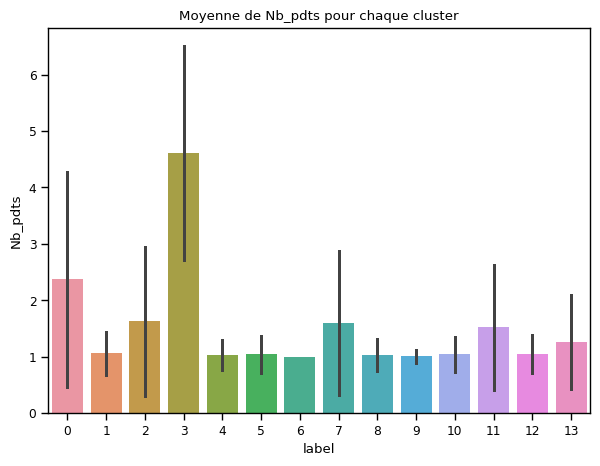

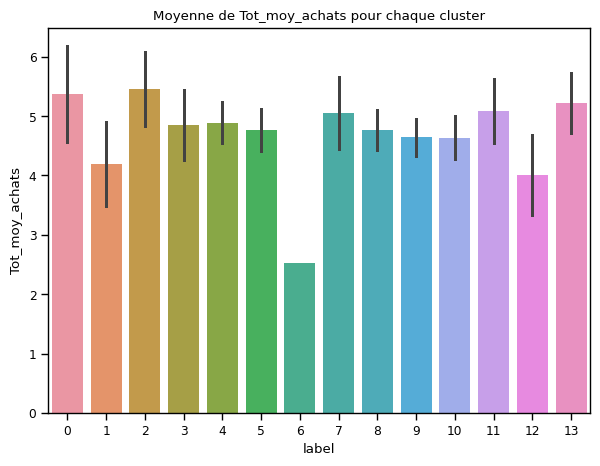

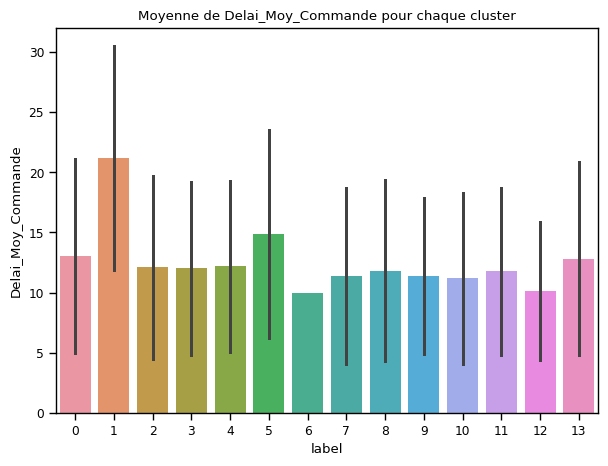

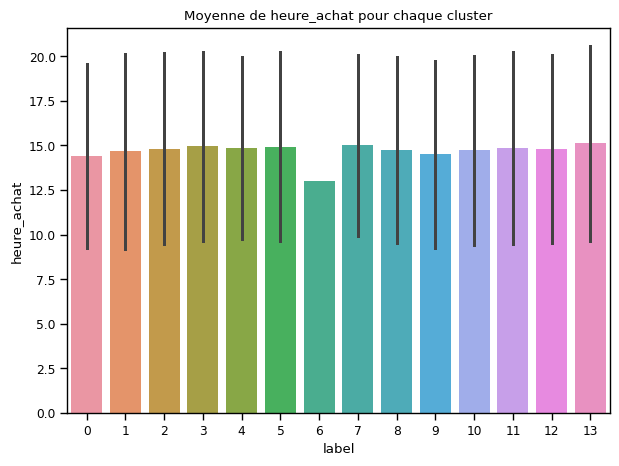

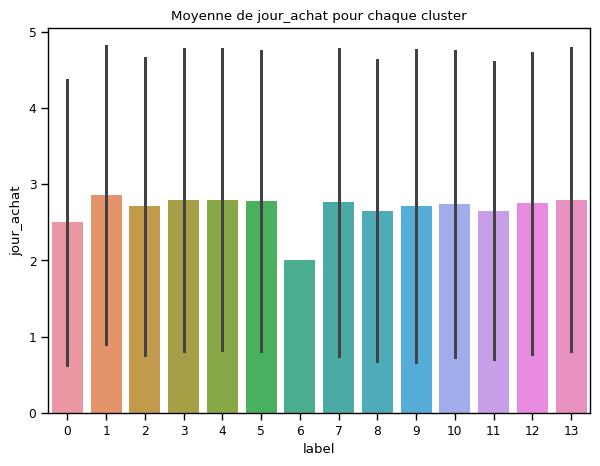

...

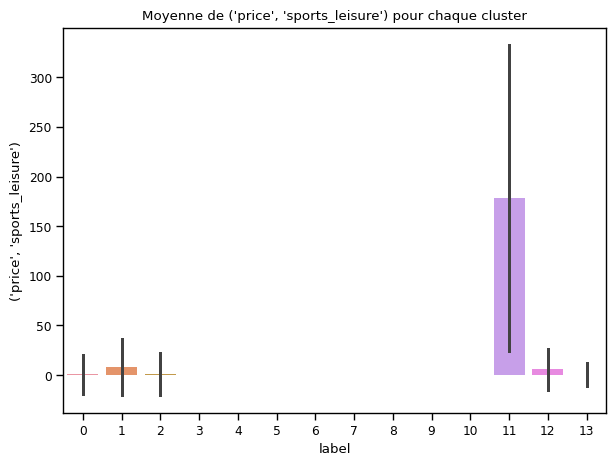

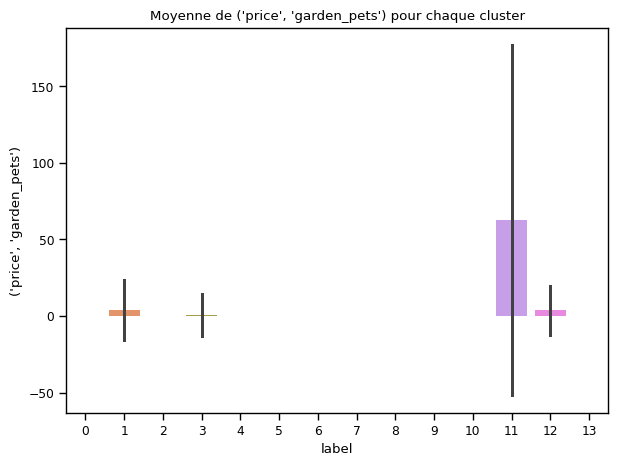

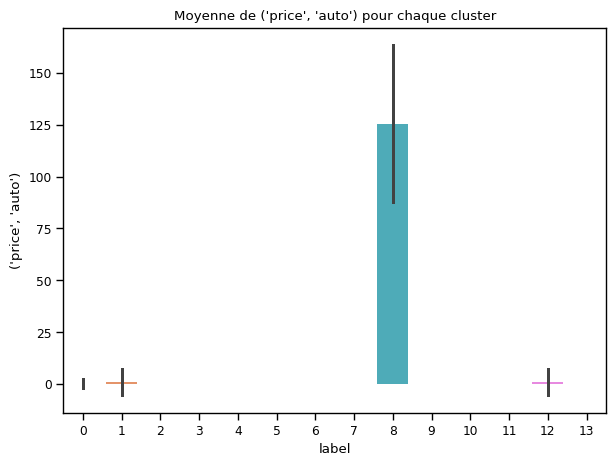

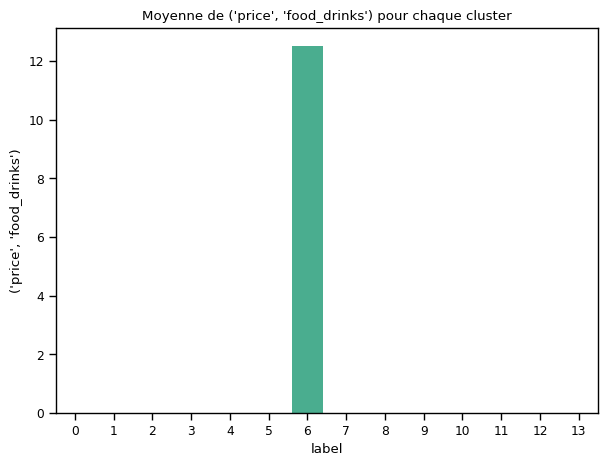

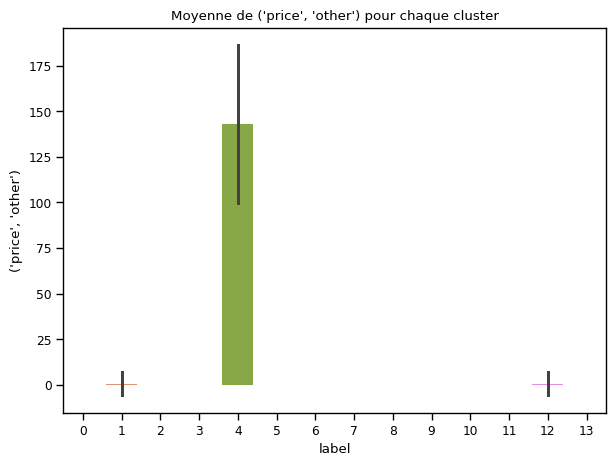

Erreur colonne :  x0_boleto
Erreur colonne :  x0_credit_card
Erreur colonne :  x0_debit_card
Erreur colonne :  x0_voucher


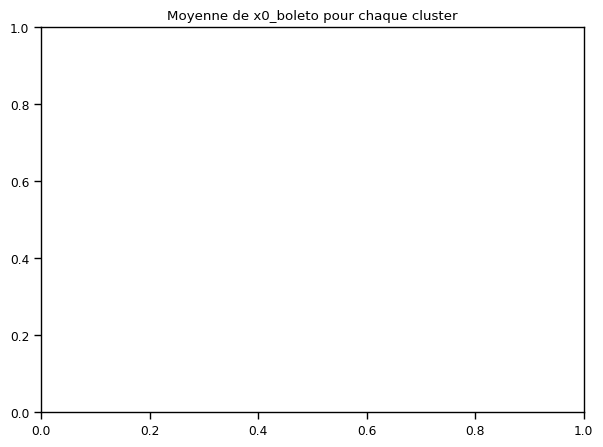

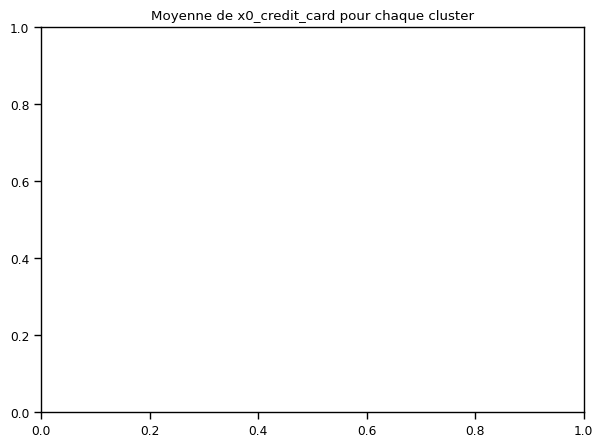

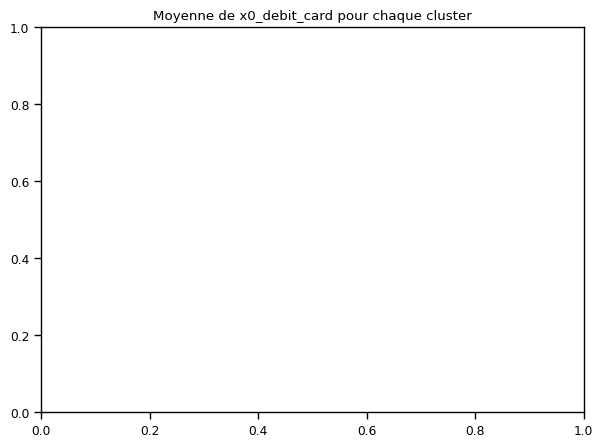

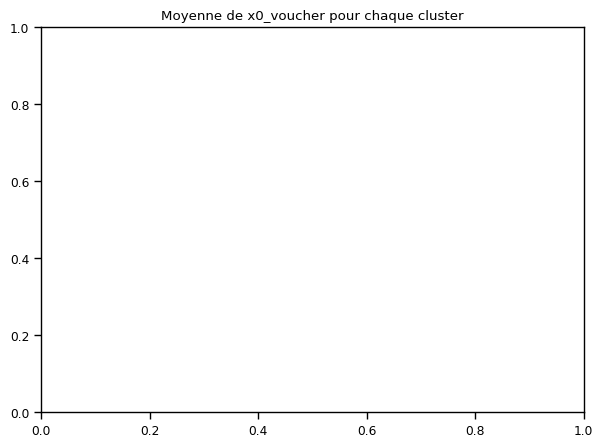

In [ ]:
# Pour chaque colonne dans group_columns.columns
for column in group_columns.columns:
    try:
        # Crée une figure avec la taille spécifiée
        plt.figure(figsize=(7, 5))
        
        # Définit le titre du graphique en utilisant le nom de la colonne
        titre = 'Moyenne de ' + str(column) + ' pour chaque cluster'
        plt.title(titre)
        
        # Affiche la moyenne de la colonne pour chaque cluster à l'aide d'un diagramme à barres
        sns.barplot(x='label',
                    y=column,
                    data=X_tot_2,
                    ci="sd")  # Utilise l'intervalle de confiance pour représenter la dispersion des données

        # Affiche le graphique
        plt.show()
    except:
        # En cas d'erreur, affiche un message avec le nom de la colonne
        print('Erreur colonne : ', column)


Dans ce code, nous utilisons `sns.barplot()` pour afficher la moyenne de la colonne pour chaque cluster à l'aide d'un diagramme à barres. L'axe des abscisses (`x='label'`) correspond aux labels de clusters, et l'axe des ordonnées (`y=column`) correspond aux valeurs moyennes de la colonne. Nous utilisons `data=X_tot_2` pour spécifier les données à utiliser pour le graphique.

Le paramètre `ci="sd"` spécifie que l'intervalle de confiance (confidence interval) doit être utilisé pour représenter la dispersion des données autour de la moyenne.

Enfin, nous utilisons `plt.show()` pour afficher le graphique à chaque itération de la boucle `for`. Si une erreur se produit lors de l'affichage du graphique pour une colonne particulière, nous affichons un message d'erreur contenant le nom de la colonne.

Observation du mode des différents clusters pour chaque feature

In [ ]:
X_tot_2.groupby('label').agg(lambda x:x.value_counts().index[0])

,Nb_pdts,Tot_moy_achats,Delai_Moy_Commande,order_purchase_timestamp,heure_achat,jour_achat,delai_dernier_achat,Note_Moy_Com,Moy_Paiment,Facilités,geolocation_lat,geolocation_lng,"('price', 'home')","('price', 'appliances')","('price', 'construction')","('price', 'office')","('price', 'electronics')","('price', 'arts')","('price', 'fashion')","('price', 'health_beauty')","('price', 'sports_leisure')","('price', 'garden_pets')","('price', 'auto')","('price', 'food_drinks')","('price', 'other')"
label,,,,,,,,,,,,,,,,,,,,,,,,,
0,1.0,5.594711,9.0,2018-02-28 11:29:07,10.0,2.0,282.0,5.0,credit_card,1.0,-22.931611,-47.111850,0.0,0.0,0.0,0.0,269.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00
1,1.0,4.092677,16.0,2018-08-03 17:13:19,11.0,4.0,282.0,5.0,credit_card,1.0,-20.344896,-40.288069,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00
2,1.0,5.857647,8.0,2017-10-08 23:56:02,16.0,0.0,282.0,5.0,credit_card,1.0,-23.013945,-43.463020,0.0,0.0,0.0,0.0,0.0,0.00,0.0,349.9,0.0,0.0,0.0,0.0,0.00
3,4.0,4.940213,8.0,2017-08-17 19:10:33,13.0,1.0,282.0,5.0,credit_card,1.0,-22.861518,-46.802172,559.2,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00
4,1.0,4.605070,9.0,2018-01-29 12:54:38,12.0,1.0,270.0,5.0,credit_card,1.0,-16.722630,-43.862910,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,99.99
5,1.0,4.369448,8.0,2017-03-10 21:05:03,16.0,1.0,235.0,5.0,credit_card,1.0,-23.331436,-46.597022,0.0,0.0,0.0,79.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00
6,1.0,2.525729,10.0,2017-08-09 13:23:18,13.0,2.0,389.0,5.0,credit_card,2.0,-22.524734,-44.118652,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,12.5,0.00
7,1.0,4.859812,8.0,2018-07-11 19:49:54,10.0,1.0,282.0,5.0,credit_card,1.0,-22.903660,-43.107256,0.0,129.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00
8,1.0,4.764735,8.0,2018-06-27 11:34:34,15.0,1.0,26.0,5.0,credit_card,1.0,-19.469049,-42.564138,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,117.3,0.0,0.00


In [ ]:
X_tot_2.groupby('label').agg('mean')

,Nb_pdts,Tot_moy_achats,Delai_Moy_Commande,heure_achat,jour_achat,delai_dernier_achat,Note_Moy_Com,Facilités,geolocation_lat,geolocation_lng,"('price', 'home')","('price', 'appliances')","('price', 'construction')","('price', 'office')","('price', 'electronics')","('price', 'arts')","('price', 'fashion')","('price', 'health_beauty')","('price', 'sports_leisure')","('price', 'garden_pets')","('price', 'auto')","('price', 'food_drinks')","('price', 'other')"
label,,,,,,,,,,,,,,,,,,,,,,,
0,2.372175,5.371240,13.044492,14.394774,2.500000,252.478814,3.807674,3.295433,-21.527936,-46.000279,3.330452,0.000000,0.009605,0.000000,469.623870,0.000000,0.000000,1.945537,0.840678,0.000000,0.056441,0.0,0.000000
1,1.059506,4.193210,21.155083,14.662378,2.858357,253.815049,3.389604,2.888053,-14.230338,-41.241966,26.762592,3.509177,0.208424,0.554033,18.806451,1.274086,5.746287,17.634790,8.158642,4.152005,0.835478,0.0,0.686200
2,1.623415,5.462849,12.085384,14.824385,2.711037,236.561894,4.187640,4.643550,-21.133914,-46.070248,1.596898,0.000000,0.000000,0.000000,0.527994,0.000000,0.232662,367.181812,0.801372,0.000000,0.000000,0.0,0.000000
3,4.607277,4.851806,12.019083,14.941680,2.786517,236.619048,3.692795,3.645042,-22.158437,-46.259812,757.489791,0.614489,0.000000,0.000000,2.139347,0.000000,0.113858,9.440776,0.000000,0.444302,0.000000,0.0,0.000000
4,1.029924,4.892617,12.177911,14.875952,2.794342,295.860718,4.217356,3.316649,-21.220040,-46.133376,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,142.857873
5,1.040560,4.771455,14.831482,14.936263,2.779817,244.915500,4.122163,2.886287,-21.828446,-46.185750,0.000000,0.000000,0.000000,127.940111,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000
6,1.000000,2.525729,10.000000,13.000000,2.000000,389.000000,5.000000,2.000000,-22.524734,-44.118652,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,12.5,0.000000
7,1.594944,5.051520,11.395105,15.023669,2.761700,214.293168,4.138515,3.901560,-22.247679,-46.464711,3.938763,241.838198,0.000000,0.000000,1.251899,0.000000,0.000000,0.234406,0.000000,0.000000,0.000000,0.0,0.000000
8,1.030303,4.765973,11.818939,14.757576,2.647727,220.446970,4.202273,2.731061,-21.058298,-46.177928,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,125.506606,0.0,0.000000


In [ ]:
X_tot_2.groupby('label').agg('mean')['delai_dernier_achat'].tolist()

[252.47881355932202,
 253.8150488225158,
 236.561894108874,
 236.61904761904762,
 295.860718171926,
 244.91549975857075,
 389.0,
 214.29316837009145,
 220.4469696969697,
 151.9719495091164,
 266.05570902394106,
 246.58631371444665,
 237.77642917552402,
 218.41573033707866]

Observations : 

* Le cluster 9 correspond aux clients qui ont acheté le plus de produits et aux acheteurs majoritaires de la catégorie 'home'
* le cluster 3 correspond au client qui ont un long délai de traitement de leur commande et également à ceux qui mettent les plus mauvaises notes en moyenne. Ils ne sont pas attachés à une catégorie de produit en particulier
* le cluster 6 correspond au client qui ont fait leur commande le plus récemment et aux acheteurs majoritaires de la catégorie 'construction'
* Le cluster 11 correspond aux acheteurs majoritaires de la catégorie 'appliances' 
* Le cluster 4 correspond aux acheteurs majoritaires de la catégorie  'office'
* Le cluster 13 correspond aux acheteurs majoritaires de la catégorie 'electronics'
* Le cluster 2 correspond aux acheteurs majoritaires de la catégorie 'arts
* Le cluster 0 correspond aux acheteurs majoritaires de la catégorie 'fashion' 
* Le cluster 8 correspond aux acheteurs majoritaires de la catégorie 'health/beauty' 
* Le cluster 1 correspond aux acheteurs majoritaires de la catégorie 'sports_leisure'
* Le cluster 12 correspond aux acheteurs majoritaires de la catégorie 'garden_pets'
* Le cluster 10 correspond aux acheteurs majoritaires de la catégorie 'auto'
* Le cluster 7 correspond aux acheteurs majoritaires de la catégorie 'other'
* pas de catégorie spécifique d'achat identifiée pour le cluster 5 (cluster qui comprend la moitié de notre échantillon)


Premier bilan:
* des clusters d'acheteurs potentiels pour certaines catégories de produits ont été identifiés
* les clients avec un long délai de traitement de commande, qui menttent de moins bonnes notes en moyenne, ont été identifiés
* le cluster des clients qui achète le plus de produits en quantité a également été identifié

Peut-on aller plus loin?

### latitude et longitude

In [ ]:
graph.columns

Index(['X', 'Y', 'label', 'x_pca', 'y_pca', 'z_pca'], dtype='object')

In [ ]:
graph['label'].nunique()

14

In [ ]:
# graph['colors']=pd.cut(graph['label'], bins=nb_clusters, 
#                        labels=['red', 'blue', 'green', 'purple', 
#                                'orange', 'darkred', 'lightred', 'beige', 
#                                'darkblue', 'darkgreen', 'cadetblue', 'darkpurple',
#                                'pink','black'])
# Crée une nouvelle colonne 'colors' dans le DataFrame graph
# La colonne 'colors' va contenir les couleurs correspondant à chaque label de cluster
# Les couleurs sont déterminées en fonction des valeurs des labels
# Le nombre de couleurs utilisées est égal au nombre de clusters (nb_clusters)
# Les couleurs sont spécifiées dans l'ordre donné par la liste labels
graph['colors'] = pd.cut(graph['label'], 
                         bins=nb_clusters,  # Définit les intervalles (bins) pour chaque cluster
                         labels=['red', 'blue', 'green', 'purple',  # Liste des couleurs pour chaque cluster
                                 'orange', 'darkred', 'lightred', 'beige', 
                                 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple',
                                 'pink', 'black'])

Dans ce code, nous utilisons `pd.cut()` pour créer une nouvelle colonne 'colors' dans le DataFrame `graph`. Cette colonne va contenir les couleurs correspondant à chaque label de cluster. Nous utilisons `bins=nb_clusters` pour spécifier le nombre de clusters et définir les intervalles pour chaque cluster.

Ensuite, nous utilisons `labels=['red', 'blue', 'green', ...]` pour spécifier les couleurs que nous souhaitons attribuer à chaque cluster. Dans cet exemple, nous avons défini une liste de 14 couleurs correspondant aux 14 clusters (nb_clusters=14).

La fonction `pd.cut()` attribue automatiquement une couleur à chaque label en fonction des intervalles spécifiés et de la liste de couleurs. Ainsi, chaque cluster dans le DataFrame `graph` est associé à une couleur définie dans la nouvelle colonne 'colors'.

In [ ]:
len(graph)

74705

In [ ]:
if False:
    # Crée une carte Folium vide
    n = folium.Map()

    # Définit les coordonnées du centre de la carte comme la moyenne des coordonnées de géolocalisation
    # Les coordonnées du centre sont calculées en prenant la moyenne des coordonnées de latitude et de longitude
    center_lat = data['geolocation_lat'].mean()
    center_lng = data['geolocation_lng'].mean()

    # Crée une carte Folium centrée sur les coordonnées du centre, avec un zoom de départ de 11
    n = folium.Map(location=[center_lat, center_lng], zoom_start=11)

    # Ajoute des cercles pour les 20 000 premières données à la carte Folium
    # Chaque cercle est placé aux coordonnées de géolocalisation correspondantes
    # La couleur du cercle est déterminée par la colonne 'colors' du DataFrame graph (correspondant aux labels de cluster)
    # Le rayon du cercle est défini à 500 mètres
    for i in range(0, 20000):    
        folium.Circle([data.iloc[i]['geolocation_lat'], data.iloc[i]['geolocation_lng']],
                      popup=graph.iloc[i]['label'], 
                      color=graph.iloc[i]['colors'],
                      radius=500).add_to(n)


"Dans certains code, nous utilisons une condition toujours fausse (`if False:`) pour s'assurer que le code ci-dessous ne sera pas exécuté."

Nous créons une carte Folium vide `n = folium.Map()` qui sera utilisée pour afficher les cercles des données géolocalisées.

Nous calculons ensuite les coordonnées du centre de la carte (`center_lat` et `center_lng`) en prenant la moyenne des coordonnées de géolocalisation de latitude et de longitude.

Ensuite, nous créons une carte Folium centrée sur les coordonnées du centre, avec un zoom de départ de 11.

En utilisant une boucle `for`, nous ajoutons des cercles à la carte Folium pour les 20 000 premières données géolocalisées. Chaque cercle est placé aux coordonnées de géolocalisation correspondantes (latitude et longitude). La couleur du cercle est déterminée par la colonne 'colors' du DataFrame `graph`, qui contient les couleurs correspondant à chaque label de cluster. Le rayon du cercle est défini à 500 mètres.

Bilan : on n'observe pas de tendance nette sur la localisation des points : regroupement des groupes par quartier ou autre.

# Essai de Kmeans en supprimant des features

Peut-on obtenir un autre clustering (éventuellement avec une répartition plus homogène des tailles de clusters) en supprimant des features

In [ ]:
X_tot.head()

,Nb_pdts,Tot_moy_achats,Delai_Moy_Commande,heure_achat,jour_achat,delai_dernier_achat,Note_Moy_Com,Facilités,geolocation_lat,geolocation_lng,"('price', 'home')","('price', 'appliances')","('price', 'construction')","('price', 'office')","('price', 'electronics')","('price', 'arts')","('price', 'fashion')","('price', 'health_beauty')","('price', 'sports_leisure')","('price', 'garden_pets')","('price', 'auto')","('price', 'food_drinks')","('price', 'other')",x0_boleto,x0_credit_card,x0_debit_card,x0_voucher
customer_unique_id,,,,,,,,,,,,,,,,,,,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,-0.252934,0.674413,-0.659922,-0.905895,0.125612,-0.844066,0.656979,2.179455,-0.363934,-0.205560,0.662448,-0.203981,-0.108908,-0.175051,-0.249208,-0.195361,-0.227077,-0.289022,-0.241773,-0.176654,-0.159481,-0.003659,-0.171063,0.0,1.0,0.0,0.0
0000b849f77a49e4a4ce2b2a4ca5be3f,-0.252934,-1.754239,-1.053042,-0.717425,-1.396007,-0.823856,-0.126992,-0.701164,-0.408854,-0.193730,-0.255630,-0.203981,-0.108908,-0.175051,-0.249208,-0.195361,-0.227077,-0.056408,-0.241773,-0.176654,-0.159481,-0.003659,-0.171063,0.0,1.0,0.0,0.0
0000f46a3911fa3c0805444483337064,-0.252934,-0.122695,1.829840,1.167276,0.632818,2.025695,-0.910963,2.179455,-1.226842,-0.706863,-0.255630,-0.203981,-0.108908,2.879229,-0.249208,-0.195361,-0.227077,-0.289022,-0.241773,-0.176654,-0.159481,-0.003659,-0.171063,0.0,1.0,0.0,0.0
0004aac84e0df4da2b147fca70cf8255,-0.252934,1.085393,0.257359,0.790336,-0.888801,0.348299,0.656979,1.356421,-0.397879,-0.383069,-0.255630,-0.203981,-0.108908,-0.175051,2.121843,-0.195361,-0.227077,-0.289022,-0.241773,-0.176654,-0.159481,-0.003659,-0.171063,0.0,1.0,0.0,0.0
0004bd2a26a76fe21f786e4fbd80607f,-0.252934,0.888838,-1.315122,0.790336,0.125612,-0.608288,-0.126992,2.179455,-0.399954,-0.166360,-0.255630,-0.203981,-0.108908,-0.175051,-0.249208,-0.195361,-0.227077,-0.289022,-0.241773,4.725049,-0.159481,-0.003659,-0.171063,0.0,1.0,0.0,0.0


In [ ]:
# features_to_drop = ['Delai_Moy_Commande',
#                     'heure_achat',
#                     'Facilités',
#                     'jour_achat', 
#                     'Note_Moy_Com']
# X_reduce = X_tot.drop(features_to_drop, axis=1)

# Liste des noms de colonnes à supprimer du DataFrame X_tot
# Ces colonnes seront exclues de la nouvelle version du DataFrame X_reduce
features_to_drop = ['Delai_Moy_Commande',
                    'heure_achat',
                    'Facilités',
                    'jour_achat', 
                    'Note_Moy_Com']

# Supprime les colonnes spécifiées (features_to_drop) du DataFrame X_tot pour créer le DataFrame X_reduce
# axis=1 indique que les colonnes doivent être supprimées (axis=0 pour supprimer des lignes)
X_reduce = X_tot.drop(features_to_drop, axis=1)

Dans ce code, nous créons une liste `features_to_drop` qui contient les noms des colonnes que nous souhaitons supprimer du DataFrame `X_tot`. Ces colonnes sont `'Delai_Moy_Commande'`, `'heure_achat'`, `'Facilités'`, `'jour_achat'`, et `'Note_Moy_Com'`.

Ensuite, nous utilisons la méthode `drop()` du DataFrame `X_tot` pour supprimer les colonnes spécifiées dans `features_to_drop`. L'argument `axis=1` indique que nous voulons supprimer des colonnes (par opposition à `axis=0` qui supprimerait des lignes).

Le résultat de cette opération est le nouveau DataFrame `X_reduce` qui ne contient pas les colonnes spécifiées dans `features_to_drop`. Ces colonnes sont exclues du DataFrame pour la suite de l'analyse ou de la modélisation.

In [ ]:
X_reduce.head()

,Nb_pdts,Tot_moy_achats,delai_dernier_achat,geolocation_lat,geolocation_lng,"('price', 'home')","('price', 'appliances')","('price', 'construction')","('price', 'office')","('price', 'electronics')","('price', 'arts')","('price', 'fashion')","('price', 'health_beauty')","('price', 'sports_leisure')","('price', 'garden_pets')","('price', 'auto')","('price', 'food_drinks')","('price', 'other')",x0_boleto,x0_credit_card,x0_debit_card,x0_voucher
customer_unique_id,,,,,,,,,,,,,,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,-0.252934,0.674413,-0.844066,-0.363934,-0.205560,0.662448,-0.203981,-0.108908,-0.175051,-0.249208,-0.195361,-0.227077,-0.289022,-0.241773,-0.176654,-0.159481,-0.003659,-0.171063,0.0,1.0,0.0,0.0
0000b849f77a49e4a4ce2b2a4ca5be3f,-0.252934,-1.754239,-0.823856,-0.408854,-0.193730,-0.255630,-0.203981,-0.108908,-0.175051,-0.249208,-0.195361,-0.227077,-0.056408,-0.241773,-0.176654,-0.159481,-0.003659,-0.171063,0.0,1.0,0.0,0.0
0000f46a3911fa3c0805444483337064,-0.252934,-0.122695,2.025695,-1.226842,-0.706863,-0.255630,-0.203981,-0.108908,2.879229,-0.249208,-0.195361,-0.227077,-0.289022,-0.241773,-0.176654,-0.159481,-0.003659,-0.171063,0.0,1.0,0.0,0.0
0004aac84e0df4da2b147fca70cf8255,-0.252934,1.085393,0.348299,-0.397879,-0.383069,-0.255630,-0.203981,-0.108908,-0.175051,2.121843,-0.195361,-0.227077,-0.289022,-0.241773,-0.176654,-0.159481,-0.003659,-0.171063,0.0,1.0,0.0,0.0
0004bd2a26a76fe21f786e4fbd80607f,-0.252934,0.888838,-0.608288,-0.399954,-0.166360,-0.255630,-0.203981,-0.108908,-0.175051,-0.249208,-0.195361,-0.227077,-0.289022,-0.241773,4.725049,-0.159481,-0.003659,-0.171063,0.0,1.0,0.0,0.0


In [ ]:
# pca_reduce = PCA(random_state=1)
# pca_reduce.fit(X_reduce)
# Instancie un objet PCA (Analyse en Composantes Principales) avec une graine aléatoire fixée à 1
pca_reduce = PCA(random_state=1)

# Applique la méthode fit() de l'objet PCA à X_reduce
# La méthode fit() est utilisée pour estimer les composantes principales à partir des données dans X_reduce
pca_reduce.fit(X_reduce)

PCA(random_state=1)

Dans ce code, nous créons un objet `pca_reduce` de type PCA (Analyse en Composantes Principales). L'argument `random_state=1` permet de fixer la graine aléatoire pour que les résultats soient reproductibles.

Ensuite, nous utilisons la méthode `fit()` de l'objet PCA pour ajuster le modèle aux données du DataFrame `X_reduce`. La méthode `fit()` est utilisée pour estimer les composantes principales à partir des données fournies. Après cette étape, l'objet `pca_reduce` contiendra les informations nécessaires pour effectuer une réduction de dimension basée sur l'analyse en composantes principales (PCA) sur les données de `X_reduce`.

In [ ]:
# np.cumsum(pca_reduce.explained_variance_ratio_)[14]
# Calcule la somme cumulative des ratios de variance expliquée par les 14 premières composantes principales
# La méthode explained_variance_ratio_ de l'objet PCA contient les pourcentages de variance expliquée par chaque composante
# La fonction np.cumsum() calcule la somme cumulative des pourcentages de variance expliquée
# L'index 14 indique que nous prenons les 14 premières composantes (0 à 13 inclus)
somme_cumulative = np.cumsum(pca_reduce.explained_variance_ratio_)[14]
somme_cumulative

0.9193428423523842

Dans ce code, nous utilisons la méthode `explained_variance_ratio_` de l'objet PCA `pca_reduce`. Cette méthode contient les pourcentages de variance expliquée par chaque composante principale calculée lors de l'analyse en composantes principales (PCA).

Ensuite, nous utilisons la fonction `np.cumsum()` de la bibliothèque NumPy pour calculer la somme cumulative des pourcentages de variance expliquée. L'index `[14]` indique que nous prenons les 14 premières composantes, de l'indice 0 à l'indice 13 inclus.

Le résultat `somme_cumulative` sera le pourcentage total de variance expliquée par les 14 premières composantes principales du DataFrame après avoir effectué l'analyse en composantes principales (PCA).

In [ ]:
# X_pca_reduce = pca_reduce.transform(X_reduce)[:,:14]
# Applique la transformation PCA sur les données du DataFrame X_reduce
# La méthode transform() de l'objet PCA est utilisée pour projeter les données dans l'espace des composantes principales
# Nous prenons seulement les 14 premières composantes principales en utilisant l'index [:,:14]
X_pca_reduce = pca_reduce.transform(X_reduce)[:, :14]


Dans ce code, nous utilisons la méthode `transform()` de l'objet PCA `pca_reduce` pour projeter les données du DataFrame `X_reduce` dans l'espace des composantes principales. Cela signifie que nous transformons les données d'origine en utilisant les composantes principales estimées lors de l'analyse en composantes principales (PCA).

L'index `[:, :14]` est utilisé pour sélectionner seulement les 14 premières composantes principales résultantes de la transformation. Les autres composantes principales ne sont pas incluses dans `X_pca_reduce`.

Après avoir exécuté ce code, `X_pca_reduce` contiendra les données réduites en dimension, projetées dans l'espace des 14 premières composantes principales. Cela signifie que `X_pca_reduce` aura moins de dimensions que `X_reduce`, car nous avons réduit le nombre de variables grâce à l'analyse en composantes principales (PCA).

In [ ]:
# kmeans_reduce = KMeans(n_clusters=14, 
#                 verbose=1, 
#                 random_state=0).fit(X_reduce)
# Instancie un objet KMeans avec 14 clusters (groupes) souhaités
# La méthode fit() sera utilisée pour effectuer le clustering KMeans sur les données réduites X_reduce
# verbose=1 affiche les détails du processus de clustering à chaque itération
# random_state=0 fixe la graine aléatoire pour que les résultats soient reproductibles

kmeans_reduce = KMeans(n_clusters=14, verbose=1, random_state=0)

# Effectue le clustering KMeans sur les données réduites X_reduce
kmeans_reduce.fit(X_reduce)

Initialization complete
Iteration 0, inertia 802609.6039435547
Iteration 1, inertia 666518.7359122486
Iteration 2, inertia 619581.8024069418
Iteration 3, inertia 599529.7632738388
Iteration 4, inertia 582945.8917921557
Iteration 5, inertia 569786.6952317129
Iteration 6, inertia 565925.247511627
Iteration 7, inertia 563673.5326613009
Iteration 8, inertia 562757.8129895356
Iteration 9, inertia 562073.9628827448
Iteration 10, inertia 561517.2673014993
Iteration 11, inertia 561275.1795431727
Iteration 12, inertia 561175.4823303142
Iteration 13, inertia 560956.2483241017
Iteration 14, inertia 560644.7435590399
Iteration 15, inertia 560327.2563051849
Iteration 16, inertia 559964.9645920033
Iteration 17, inertia 558683.5318284455
Iteration 18, inertia 555483.511914304
Iteration 19, inertia 555470.7503877177
Iteration 20, inertia 555465.8341763604
Iteration 21, inertia 555464.8851975577
Converged at iteration 21: center shift 4.742168565571806e-05 within tolerance 8.350512223975176e-05.
Initia

Initialization complete
Iteration 0, inertia 780393.3844719747
Iteration 1, inertia 640224.6685485523
Iteration 2, inertia 609959.8049704988
Iteration 3, inertia 599089.920949316
Iteration 4, inertia 594476.7252065738
Iteration 5, inertia 592208.1663576734
Iteration 6, inertia 590603.3741963259
Iteration 7, inertia 588564.4328995364
Iteration 8, inertia 585194.0126661074
Iteration 9, inertia 582141.3502253812
Iteration 10, inertia 578797.7075364562
Iteration 11, inertia 575610.8495207578
Iteration 12, inertia 574427.4364612019
Iteration 13, inertia 573902.7348124989
Iteration 14, inertia 573709.1707443437
Iteration 15, inertia 573680.2029339675
Iteration 16, inertia 573672.2434896671
Iteration 17, inertia 573668.641383301
Converged at iteration 17: center shift 8.335176973189967e-05 within tolerance 8.350512223975176e-05.


KMeans(n_clusters=14, random_state=0, verbose=1)

Dans ce code, nous créons un objet `kmeans_reduce` de type KMeans (clustering K-means) avec 14 clusters (groupes) souhaités. Cet objet sera utilisé pour effectuer le clustering KMeans sur les données réduites `X_reduce`, qui sont le résultat de l'analyse en composantes principales (PCA).

Ensuite, nous utilisons la méthode `fit()` de l'objet KMeans pour effectuer le clustering KMeans sur `X_reduce`. Le clustering KMeans regroupe les données en 14 clusters distincts en fonction de leurs similarités dans l'espace des composantes principales.

Les paramètres `verbose=1` et `random_state=0` sont utilisés pour afficher les détails du processus de clustering et fixer la graine aléatoire pour que les résultats soient reproductibles.

In [ ]:
# silhouette_score(X = X_pca_reduce, labels= kmeans_reduce.labels_)
# Calcule le score de silhouette pour évaluer la qualité du clustering KMeans
# Le score de silhouette mesure à quel point chaque point est similaire aux points de son propre cluster par rapport aux autres clusters
# X_pca_reduce est l'ensemble de données réduit en dimension après l'analyse en composantes principales (PCA)
# kmeans_reduce.labels_ contient les étiquettes de cluster attribuées par KMeans à chaque point dans X_pca_reduce
silhouette_score(X=X_pca_reduce, labels=kmeans_reduce.labels_)

0.37909359442098384

Dans ce code, nous utilisons la fonction `silhouette_score` de la bibliothèque scikit-learn pour calculer le score de silhouette du clustering KMeans. Le score de silhouette mesure à quel point chaque point est similaire aux points de son propre cluster par rapport aux autres clusters. Un score de silhouette élevé indique que les points sont bien regroupés dans leurs clusters respectifs.

Les arguments de la fonction `silhouette_score` sont les suivants :

- `X`: L'ensemble de données réduit en dimension après l'analyse en composantes principales (PCA), c'est-à-dire `X_pca_reduce`.

- `labels`: Les étiquettes de cluster attribuées par KMeans à chaque point dans `X_pca_reduce`, c'est-à-dire `kmeans_reduce.labels_`.

Après avoir exécuté ce code, le résultat sera le score de silhouette qui évalue la qualité du clustering KMeans réalisé sur les données réduites en dimension `X_pca_reduce`. Un score de silhouette proche de 1 est généralement considéré comme bon, indiquant que les clusters sont bien séparés et que les points sont bien regroupés.

<Axes: >

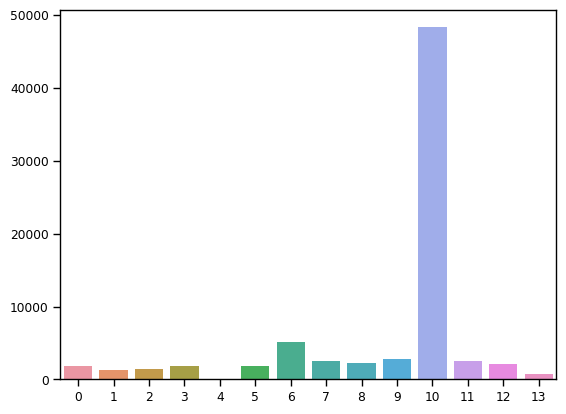

In [ ]:
# sns.barplot(y = pd.Series(kmeans_reduce.labels_).value_counts().values,
#            x = pd.Series(kmeans_reduce.labels_).value_counts().index)

# Calcule le nombre d'occurrences de chaque cluster dans les étiquettes attribuées par KMeans
# La fonction value_counts() de pandas renvoie une série contenant le nombre d'occurrences de chaque élément unique dans la liste des étiquettes
# kmeans_reduce.labels_ contient les étiquettes de cluster attribuées par KMeans à chaque point
occurrences_clusters = pd.Series(kmeans_reduce.labels_).value_counts()

# Affiche un graphique à barres pour visualiser la distribution des occurrences de chaque cluster
# y : les hauteurs des barres, c'est-à-dire le nombre d'occurrences de chaque cluster
# x : les positions des barres, c'est-à-dire les identifiants numériques de chaque cluster (0, 1, 2, ..., nb_clusters-1)
sns.barplot(y=occurrences_clusters.values, x=occurrences_clusters.index)

Dans ce code, nous utilisons la fonction `value_counts()` de pandas pour compter le nombre d'occurrences de chaque cluster dans les étiquettes attribuées par KMeans. La variable `occurrences_clusters` est une série contenant le nombre d'occurrences de chaque cluster, indexée par les identifiants numériques de chaque cluster (0, 1, 2, ..., nb_clusters-1).

Ensuite, nous utilisons `sns.barplot()` de la bibliothèque seaborn pour créer un graphique à barres. L'axe des ordonnées (`y`) représente le nombre d'occurrences de chaque cluster, c'est-à-dire la hauteur des barres. L'axe des abscisses (`x`) représente les identifiants numériques de chaque cluster, c'est-à-dire les positions des barres.

Ce graphique à barres permet de visualiser la distribution du nombre d'occurrences de chaque cluster, ce qui peut être utile pour évaluer l'équilibre ou la répartition des points dans les différents clusters obtenus à partir du clustering KMeans.

taille des clusters

In [ ]:
# pd.DataFrame(kmeans_reduce.labels_, columns=['cluster'])['cluster'].value_counts().sort_values()
# Crée un DataFrame contenant une colonne 'cluster' avec les étiquettes attribuées par KMeans à chaque point
# kmeans_reduce.labels_ contient les étiquettes de cluster attribuées par KMeans à chaque point
# pd.DataFrame() permet de créer un DataFrame à partir de la liste d'étiquettes
df_clusters = pd.DataFrame(kmeans_reduce.labels_, columns=['cluster'])

# Compte le nombre d'occurrences de chaque cluster dans la colonne 'cluster' du DataFrame
# La fonction value_counts() de pandas renvoie une série contenant le nombre d'occurrences de chaque élément unique dans la colonne
occurrences_clusters = df_clusters['cluster'].value_counts()

# Trie les valeurs par ordre croissant (du plus petit au plus grand)
# Cela permet de visualiser les occurrences des clusters dans l'ordre croissant
occurrences_clusters_sorted = occurrences_clusters.sort_values()

Dans ce code, nous commençons par créer un DataFrame `df_clusters` contenant une colonne `'cluster'` avec les étiquettes de cluster attribuées par KMeans à chaque point. La liste des étiquettes est extraite de `kmeans_reduce.labels_` et transformée en un DataFrame à l'aide de `pd.DataFrame()`.

Ensuite, nous utilisons la fonction `value_counts()` de pandas pour compter le nombre d'occurrences de chaque cluster dans la colonne `'cluster'` du DataFrame `df_clusters`. La variable `occurrences_clusters` est une série contenant le nombre d'occurrences de chaque cluster, indexée par les identifiants numériques de chaque cluster (0, 1, 2, ..., nb_clusters-1).

Enfin, nous utilisons la méthode `sort_values()` pour trier les valeurs par ordre croissant, ce qui permet d'obtenir `occurrences_clusters_sorted`, une série contenant les occurrences des clusters dans l'ordre croissant. Cette série peut être utilisée pour visualiser les occurrences des clusters dans un ordre plus lisible et croissant.

In [ ]:
# X_tot_2['label_reduce'] = kmeans_reduce.labels_
# Ajoute une nouvelle colonne 'label_reduce' au DataFrame X_tot_2
# kmeans_reduce.labels_ contient les étiquettes de cluster attribuées par KMeans à chaque point dans X_reduce
# Cette nouvelle colonne contiendra les étiquettes de cluster pour chaque ligne du DataFrame X_tot_2
X_tot_2['label_reduce'] = kmeans_reduce.labels_

Dans ce code, nous ajoutons une nouvelle colonne `'label_reduce'` au DataFrame `X_tot_2`. Cette colonne contiendra les étiquettes de cluster attribuées par KMeans à chaque point dans `X_reduce`.

Les étiquettes de cluster sont stockées dans `kmeans_reduce.labels_`, qui est un attribut de l'objet KMeans `kmeans_reduce`. Ces étiquettes correspondent aux groupes/clusters dans lesquels chaque point a été assigné par le modèle KMeans lors du processus de clustering. Chaque ligne du DataFrame `X_tot_2` se verra attribuer l'étiquette correspondante à son point dans l'espace réduit `X_reduce`.

Après avoir exécuté cette ligne de code, le DataFrame `X_tot_2` contiendra une nouvelle colonne `'label_reduce'` avec les étiquettes de cluster obtenues à partir du clustering KMeans sur les données réduites en dimension `X_reduce`.

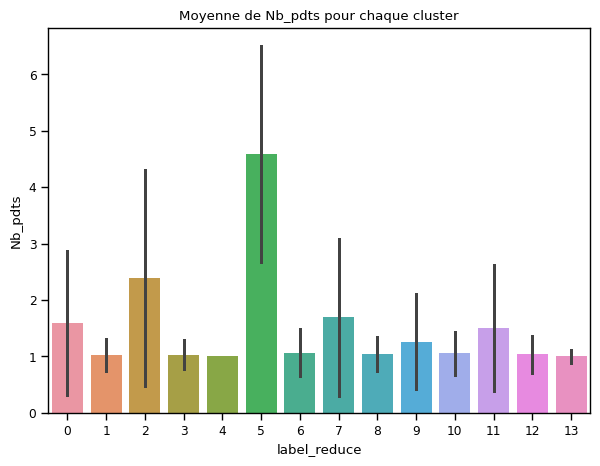

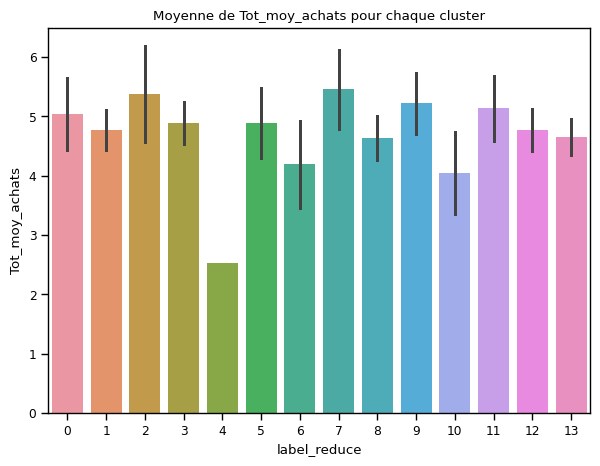

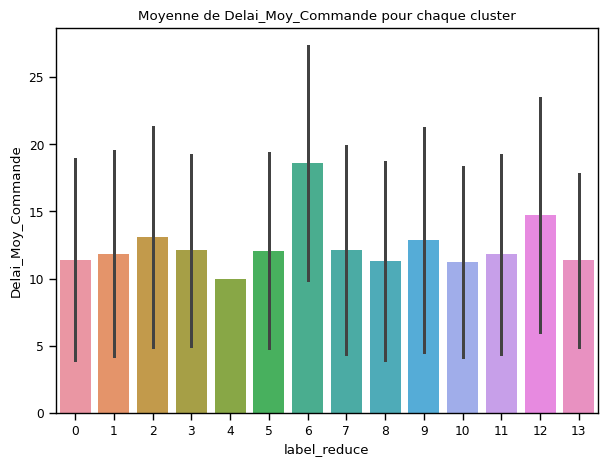

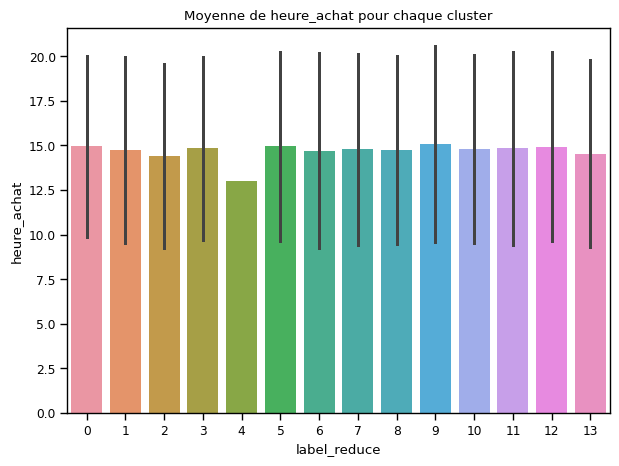

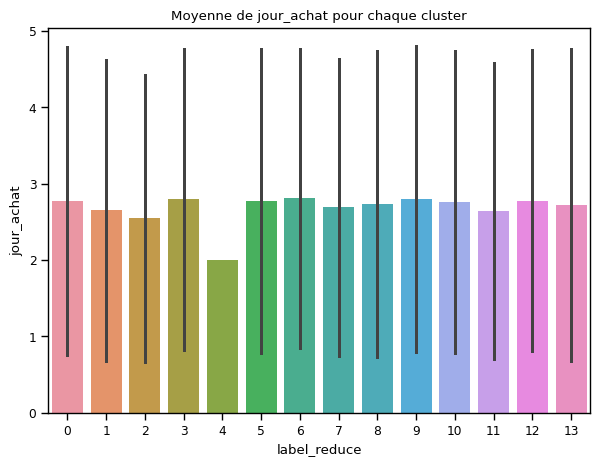

...

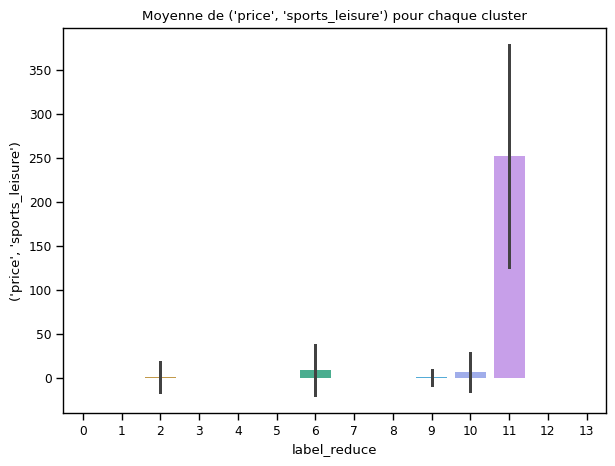

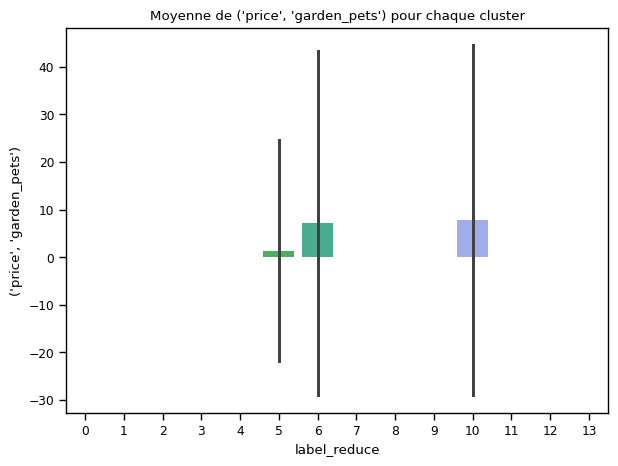

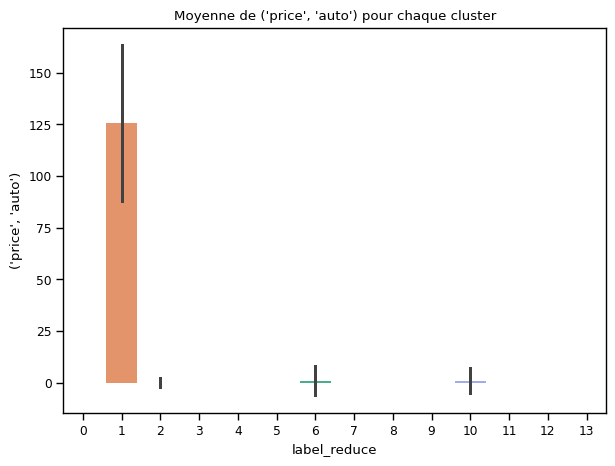

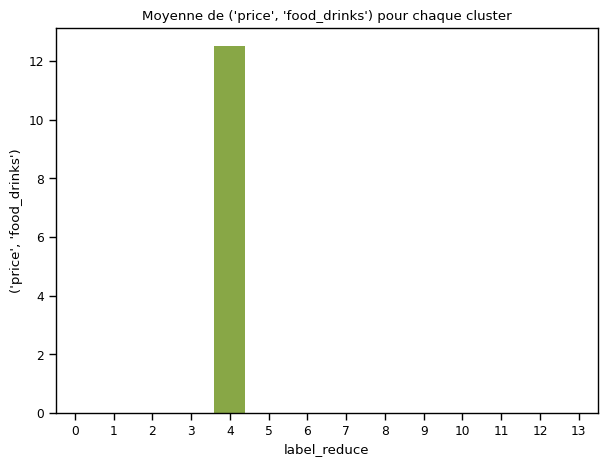

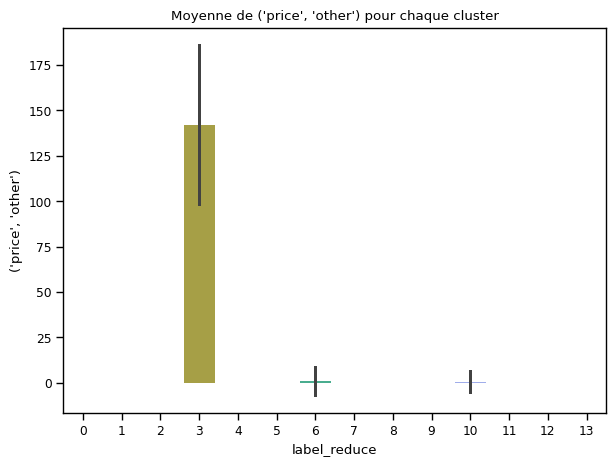

Erreur colonne :  x0_boleto
Erreur colonne :  x0_credit_card
Erreur colonne :  x0_debit_card
Erreur colonne :  x0_voucher


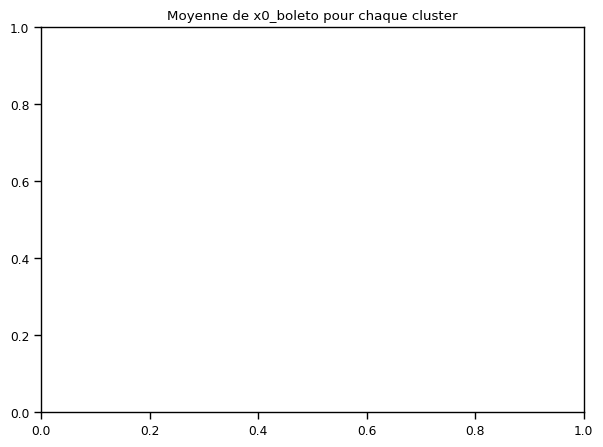

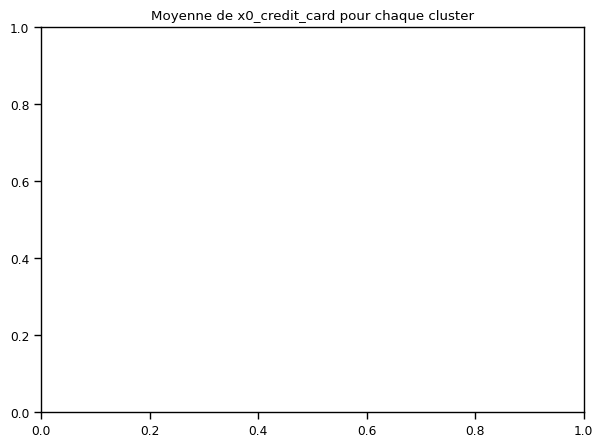

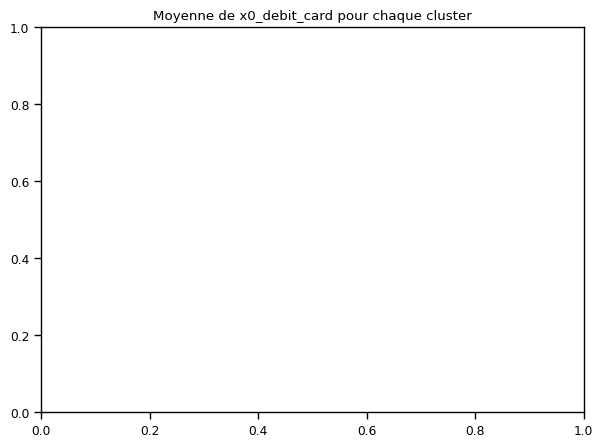

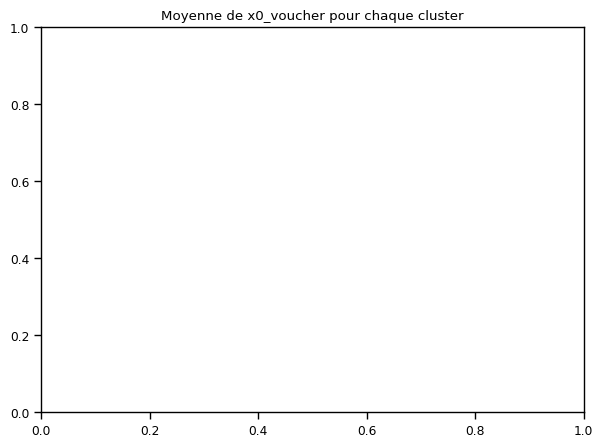

In [ ]:
# for column in group_columns.columns:
#     try:
#         plt.figure(figsize=(7,5))
#         titre = 'Moyenne de ' + str(column) + ' pour chaque cluster' 
#         plt.title(titre)
#         sns.barplot(x = 'label_reduce',
#                     y = column,
#                     data = X_tot_2, 
#                     ci="sd")
#         plt.show()
#     except:
#         print('Erreur colonne : ', column)

# Parcours chaque colonne du DataFrame group_columns
for column in group_columns.columns:
    try:
        # Crée une nouvelle figure pour chaque colonne
        plt.figure(figsize=(7, 5))
        
        # Génère le titre du graphique en indiquant la moyenne de la colonne pour chaque cluster
        titre = 'Moyenne de ' + str(column) + ' pour chaque cluster'
        plt.title(titre)
        
        # Crée un graphique à barres pour visualiser la moyenne de la colonne pour chaque cluster
        # x : étiquettes de cluster, c'est-à-dire les valeurs de la colonne 'label_reduce' de X_tot_2
        # y : valeurs de la colonne spécifiée par 'column'
        # data : DataFrame X_tot_2 contenant les données et les étiquettes de cluster 'label_reduce'
        # ci="sd" indique que l'intervalle de confiance est affiché sur le graphique (écart-type)
        sns.barplot(x='label_reduce', y=column, data=X_tot_2, ci="sd")
        
        # Affiche le graphique
        plt.show()
    except:
        # Si une erreur se produit lors de la création du graphique, affiche un message d'erreur avec le nom de la colonne
        print('Erreur colonne : ', column)


Le Kmeans réduit semble réaliser un clustering comparable : on observe les mêmes features qui se détachent en fonction des catégories (catégories de dépenses, nombre d'achats, etc.)

# Résultats et problématique

Les résultats ne sont pas parfaitement satisfaisants vis à vis de la problématique:  
* on obtient un trop grand nombre de clusters, non adapté à la problématique business
* un cluster principal qui contient trop de données
* coefficient de silhouette relativement faible indiquant un chevauchement partiel des clusters,
* le clustering suit principalement les catégories de produits prédéfinies. On aurait pu faire ce tri sans faire appel à des algorithmes 

La base de données permet de faire difficilement mieux par des algorithmes traditionnels car peu de clients ont fait plusieurs achats, ce qui limite le nombre de possibilités qu'on peut envisager (fréquence des achats, complémentarité des catégories d'achats, date du dernier achat, etc.)

Revenons à une analyse manuelle des données pour identifier des segments exploitables pour les équipes marketing

## Clusters actionnables

**Identification des clusters**

In [ ]:
cluster = []
for i in range(14):
    cluster.append(data.loc[X_tot_2['label'] == i])

Nombre de clients par cluster

In [ ]:
a = 0
for i in range(14):
    b = cluster[i].shape[0]
    a += b
    print('cluster {} : {} clients'.format(i,b))

cluster 0 : 1416 clients
cluster 1 : 8705 clients
cluster 2 : 2682 clients
cluster 3 : 1869 clients
cluster 4 : 1838 clients
cluster 5 : 2071 clients
cluster 6 : 1 clients
cluster 7 : 1859 clients
cluster 8 : 1320 clients
cluster 9 : 713 clients
cluster 10 : 2172 clients
cluster 11 : 3551 clients
cluster 12 : 43749 clients
cluster 13 : 2759 clients


la catégorie 5 contient trop de clients et est difficilement exploitable directement. Peut-on la redécouper?

### Clustering de la catégorie 5

In [ ]:
# dict_silhouette_cat5 = {}
# dict_kmeans_cat5 = {}
# for i in range(2,15,1):
#     dict_kmeans_cat5[i] = KMeans(n_clusters=i, 
#                     verbose=1, 
#                     random_state=0).fit(X3.loc[X_tot_2[X_tot_2['label'] == 5].index])
#     dict_silhouette_cat5[i] = (silhouette_score(X = X3.loc[X_tot_2[X_tot_2['label'] == 5].index],
#                          labels= list(dict_kmeans_cat5[i].labels_)))
# Dictionnaire pour stocker les scores de silhouette pour différents nombres de clusters
dict_silhouette_cat5 = {}

# Dictionnaire pour stocker les modèles K-means pour différents nombres de clusters
dict_kmeans_cat5 = {}

# Parcours des nombres de clusters de 2 à 14
for i in range(2, 15, 1):
    # Crée un modèle K-means avec le nombre de clusters actuel
    # en utilisant les données du DataFrame X3, filtrées pour les échantillons avec le label 5 du DataFrame X_tot_2
    # verbose=1 affiche des informations sur le processus de clustering
    # random_state=0 fixe la graine aléatoire pour assurer la reproductibilité
    dict_kmeans_cat5[i] = KMeans(n_clusters=i,
                                 verbose=1,
                                 random_state=0).fit(X3.loc[X_tot_2[X_tot_2['label'] == 5].index])
    
    # Calcule le score de silhouette pour le modèle K-means actuel
    # en utilisant les données du DataFrame X3, filtrées pour les échantillons avec le label 5 du DataFrame X_tot_2
    # silhouette_score calcule la cohérence des clusters, un score plus élevé indique une meilleure séparation des clusters
    dict_silhouette_cat5[i] = (silhouette_score(X=X3.loc[X_tot_2[X_tot_2['label'] == 5].index],
                                                labels=list(dict_kmeans_cat5[i].labels_)))


Initialization complete
Iteration 0, inertia 26266.187892861508
Iteration 1, inertia 16546.9632926516
Iteration 2, inertia 16391.328613764133
Iteration 3, inertia 16376.339242192513
Iteration 4, inertia 16373.68315637622
Iteration 5, inertia 16372.950075502806
Iteration 6, inertia 16372.73815230104
Iteration 7, inertia 16372.68449786566
Converged at iteration 7: strict convergence.
Initialization complete
Iteration 0, inertia 25084.794240236384
Iteration 1, inertia 16473.77204077933
Iteration 2, inertia 16387.68626466307
Iteration 3, inertia 16377.274905201708
Iteration 4, inertia 16374.968513828917
Iteration 5, inertia 16374.127974377252
Iteration 6, inertia 16373.762358527883
Iteration 7, inertia 16373.342100928307
Iteration 8, inertia 16373.228908817458
Converged at iteration 8: center shift 2.6701636768501938e-05 within tolerance 5.6004825737306386e-05.
Initialization complete
Iteration 0, inertia 26502.254178956286
Iteration 1, inertia 18947.700531529714
Iteration 2, inertia 17065

Initialization complete
Iteration 0, inertia 20846.46426182918
Iteration 1, inertia 14194.198216000717
Iteration 2, inertia 13949.957778643988
Iteration 3, inertia 13911.82744484539
Iteration 4, inertia 13888.122387397312
Iteration 5, inertia 13861.489195260312
Iteration 6, inertia 13827.877981613208
Iteration 7, inertia 13794.590617136786
Iteration 8, inertia 13771.718466920503
Iteration 9, inertia 13758.23226036571
Iteration 10, inertia 13741.754228138028
Iteration 11, inertia 13728.279580642615
Iteration 12, inertia 13717.035965032363
Iteration 13, inertia 13705.388796228865
Iteration 14, inertia 13698.317563142477
Iteration 15, inertia 13695.188147638286
Iteration 16, inertia 13694.032639714134
Iteration 17, inertia 13692.500071111077
Iteration 18, inertia 13691.679347026611
Iteration 19, inertia 13690.988655216355
Iteration 20, inertia 13690.174479661579
Iteration 21, inertia 13689.504013050617
Iteration 22, inertia 13688.408953517293
Iteration 23, inertia 13687.68964065862
Iterat

Initialization complete
Iteration 0, inertia 18031.127830917816
Iteration 1, inertia 13684.34314375556
Iteration 2, inertia 13346.832349393222
Iteration 3, inertia 13246.939481871132
Iteration 4, inertia 13201.655737402376
Iteration 5, inertia 13155.231054312186
Iteration 6, inertia 13126.933492322063
Iteration 7, inertia 13116.584841575359
Iteration 8, inertia 13102.743161370063
Iteration 9, inertia 13089.793128714593
Iteration 10, inertia 13081.178783120626
Iteration 11, inertia 13071.845931003025
Iteration 12, inertia 13062.864055099939
Iteration 13, inertia 13052.820706670103
Iteration 14, inertia 13046.334640584193
Iteration 15, inertia 13039.382564455698
Iteration 16, inertia 13035.548975148578
Iteration 17, inertia 13032.235353475822
Iteration 18, inertia 13029.403421983703
Iteration 19, inertia 13027.293586263424
Iteration 20, inertia 13024.311600155152
Iteration 21, inertia 13022.361531809118
Iteration 22, inertia 13021.186171280222
Iteration 23, inertia 13020.802411187913
Ite

Iteration 7, inertia 13271.769127327643
Iteration 8, inertia 13228.537042862536
Iteration 9, inertia 13198.207730426846
Iteration 10, inertia 13175.67709274685
Iteration 11, inertia 13151.428503839365
Iteration 12, inertia 13112.403624187795
Iteration 13, inertia 13044.35947314865
Iteration 14, inertia 12987.91550169604
Iteration 15, inertia 12956.138255853803
Iteration 16, inertia 12927.163965560723
Iteration 17, inertia 12899.164980426052
Iteration 18, inertia 12859.19276336096
Iteration 19, inertia 12834.043322360812
Iteration 20, inertia 12819.283231059402
Iteration 21, inertia 12811.507329217951
Iteration 22, inertia 12806.44823930359
Iteration 23, inertia 12803.389122187222
Iteration 24, inertia 12801.309219149032
Iteration 25, inertia 12800.55147174242
Iteration 26, inertia 12800.317533080264
Iteration 27, inertia 12800.001559029199
Iteration 28, inertia 12799.679349236216
Iteration 29, inertia 12799.14359162397
Iteration 30, inertia 12799.050907362707
Iteration 31, inertia 1279

Iteration 41, inertia 12227.755472600657
Iteration 42, inertia 12227.333199441202
Iteration 43, inertia 12226.763239852768
Iteration 44, inertia 12225.934618001498
Iteration 45, inertia 12225.222781385324
Iteration 46, inertia 12224.98872630466
Iteration 47, inertia 12224.916673412263
Iteration 48, inertia 12224.83540248326
Iteration 49, inertia 12224.794921683875
Iteration 50, inertia 12224.603352608814
Iteration 51, inertia 12224.528256901925
Converged at iteration 51: strict convergence.
Initialization complete
Iteration 0, inertia 16478.84096664059
Iteration 1, inertia 13805.96028726256
Iteration 2, inertia 13259.703629637554
Iteration 3, inertia 13033.254073666496
Iteration 4, inertia 12932.414592713949
Iteration 5, inertia 12860.645892617751
Iteration 6, inertia 12826.21174012177
Iteration 7, inertia 12792.149412732497
Iteration 8, inertia 12762.627842171838
Iteration 9, inertia 12735.713070106958
Iteration 10, inertia 12704.402744177765
Iteration 11, inertia 12675.336491716025
I

Iteration 12, inertia 11722.297980468367
Iteration 13, inertia 11687.58177753848
Iteration 14, inertia 11657.693935832966
Iteration 15, inertia 11616.085226507901
Iteration 16, inertia 11581.980865652495
Iteration 17, inertia 11552.128186866554
Iteration 18, inertia 11526.121836603088
Iteration 19, inertia 11500.981269279893
Iteration 20, inertia 11488.105681522777
Iteration 21, inertia 11477.249540406405
Iteration 22, inertia 11469.601653359541
Iteration 23, inertia 11466.991083391704
Iteration 24, inertia 11466.3420150358
Iteration 25, inertia 11465.541888380449
Iteration 26, inertia 11464.745241698129
Iteration 27, inertia 11463.8407001204
Iteration 28, inertia 11462.503016095116
Iteration 29, inertia 11461.988032155741
Iteration 30, inertia 11461.59689193129
Iteration 31, inertia 11461.210220635323
Iteration 32, inertia 11461.173346230575
Converged at iteration 32: strict convergence.
Initialization complete
Iteration 0, inertia 16445.073094381514
Iteration 1, inertia 12285.3168356

Iteration 1, inertia 12322.661304228273
Iteration 2, inertia 11778.953536590967
Iteration 3, inertia 11528.152644510723
Iteration 4, inertia 11408.064062547093
Iteration 5, inertia 11320.439941048666
Iteration 6, inertia 11242.873703508874
Iteration 7, inertia 11182.76629439201
Iteration 8, inertia 11128.749547960244
Iteration 9, inertia 11089.980222253464
Iteration 10, inertia 11064.85993094684
Iteration 11, inertia 11047.928375884143
Iteration 12, inertia 11040.277021357278
Iteration 13, inertia 11037.438147761713
Iteration 14, inertia 11036.015555288173
Iteration 15, inertia 11034.71857035533
Iteration 16, inertia 11033.167942262155
Iteration 17, inertia 11032.046786857998
Iteration 18, inertia 11031.886906805785
Iteration 19, inertia 11031.747990643968
Iteration 20, inertia 11031.387299775855
Iteration 21, inertia 11030.91779932523
Iteration 22, inertia 11030.190892984621
Iteration 23, inertia 11029.980799534971
Converged at iteration 23: strict convergence.
Initialization complete

Initialization complete
Iteration 0, inertia 13835.049496782916
Iteration 1, inertia 11713.406203038361
Iteration 2, inertia 11481.237974675556
Iteration 3, inertia 11373.31916127587
Iteration 4, inertia 11269.59427196019
Iteration 5, inertia 11164.625470206642
Iteration 6, inertia 11056.707996566514
Iteration 7, inertia 10971.08875832532
Iteration 8, inertia 10893.77255575495
Iteration 9, inertia 10823.791563656934
Iteration 10, inertia 10765.799629701942
Iteration 11, inertia 10740.756481958097
Iteration 12, inertia 10726.498719085337
Iteration 13, inertia 10716.35132098687
Iteration 14, inertia 10708.56485672907
Iteration 15, inertia 10697.251554561715
Iteration 16, inertia 10689.208548569191
Iteration 17, inertia 10684.59872421654
Iteration 18, inertia 10681.967672213223
Iteration 19, inertia 10678.952375487346
Iteration 20, inertia 10676.178462733451
Iteration 21, inertia 10673.843590054714
Iteration 22, inertia 10671.140504819594
Iteration 23, inertia 10669.015266155393
Iteration

Iteration 23, inertia 10403.511608803914
Iteration 24, inertia 10396.70056490731
Iteration 25, inertia 10390.453255671377
Iteration 26, inertia 10384.151576125701
Iteration 27, inertia 10380.899411461041
Iteration 28, inertia 10379.986759527212
Iteration 29, inertia 10379.56492001729
Iteration 30, inertia 10378.780392986506
Iteration 31, inertia 10377.726788072088
Iteration 32, inertia 10376.196868797135
Iteration 33, inertia 10374.584993265229
Iteration 34, inertia 10373.570237904563
Iteration 35, inertia 10372.134208644276
Iteration 36, inertia 10370.871558867468
Iteration 37, inertia 10370.427928347806
Iteration 38, inertia 10370.08743269663
Iteration 39, inertia 10369.895617720656
Iteration 40, inertia 10369.760480902254
Iteration 41, inertia 10369.69747520195
Iteration 42, inertia 10369.662450912881
Converged at iteration 42: strict convergence.
Initialization complete
Iteration 0, inertia 13626.779472520639
Iteration 1, inertia 11327.913000234146
Iteration 2, inertia 10941.308302

Iteration 17, inertia 10060.727221102326
Iteration 18, inertia 10058.970666558858
Iteration 19, inertia 10056.718293544864
Iteration 20, inertia 10055.476580438488
Iteration 21, inertia 10054.778738349785
Iteration 22, inertia 10054.27223218421
Iteration 23, inertia 10053.73348960467
Iteration 24, inertia 10053.525804258636
Iteration 25, inertia 10053.296693827591
Converged at iteration 25: strict convergence.
Initialization complete
Iteration 0, inertia 13561.45061632253
Iteration 1, inertia 10866.145288525375
Iteration 2, inertia 10597.747092106109
Iteration 3, inertia 10451.303608873339
Iteration 4, inertia 10331.55661468978
Iteration 5, inertia 10266.309557573537
Iteration 6, inertia 10224.53023927526
Iteration 7, inertia 10196.640567315175
Iteration 8, inertia 10177.507967670526
Iteration 9, inertia 10166.221577434944
Iteration 10, inertia 10156.429238456243
Iteration 11, inertia 10147.305146681998
Iteration 12, inertia 10129.95193063542
Iteration 13, inertia 10110.910722170454
It

Initialization complete
Iteration 0, inertia 13147.013789317742
Iteration 1, inertia 11022.18384354919
Iteration 2, inertia 10704.722601920634
Iteration 3, inertia 10509.490758852005
Iteration 4, inertia 10411.91131436595
Iteration 5, inertia 10340.339808558187
Iteration 6, inertia 10273.96709222308
Iteration 7, inertia 10203.309194189802
Iteration 8, inertia 10141.96800833104
Iteration 9, inertia 10091.189067822492
Iteration 10, inertia 10040.21575395
Iteration 11, inertia 9992.153693395578
Iteration 12, inertia 9938.941508197195
Iteration 13, inertia 9905.844232705378
Iteration 14, inertia 9889.0061032964
Iteration 15, inertia 9874.022533251542
Iteration 16, inertia 9861.370407615255
Iteration 17, inertia 9851.583610386497
Iteration 18, inertia 9845.188528579449
Iteration 19, inertia 9840.586344175033
Iteration 20, inertia 9836.315622988554
Iteration 21, inertia 9832.411822881282
Iteration 22, inertia 9831.617945226006
Iteration 23, inertia 9830.748803691167
Iteration 24, inertia 982

Initialization complete
Iteration 0, inertia 12373.83937441842
Iteration 1, inertia 10380.261660625873
Iteration 2, inertia 10118.30767261401
Iteration 3, inertia 10001.373079609897
Iteration 4, inertia 9899.473432741015
Iteration 5, inertia 9810.601820666036
Iteration 6, inertia 9745.582488510183
Iteration 7, inertia 9695.670314914161
Iteration 8, inertia 9659.516621584457
Iteration 9, inertia 9631.50224596268
Iteration 10, inertia 9612.28157981366
Iteration 11, inertia 9595.932129289875
Iteration 12, inertia 9580.030579605216
Iteration 13, inertia 9567.986438888956
Iteration 14, inertia 9562.736812003212
Iteration 15, inertia 9557.405152146612
Iteration 16, inertia 9551.503109883437
Iteration 17, inertia 9547.012575560564
Iteration 18, inertia 9544.88223146589
Iteration 19, inertia 9541.574702672111
Iteration 20, inertia 9533.49091093011
Iteration 21, inertia 9525.524293381639
Iteration 22, inertia 9518.74512844985
Iteration 23, inertia 9514.25995540092
Iteration 24, inertia 9511.581

Initialization complete
Iteration 0, inertia 12702.442330326341
Iteration 1, inertia 10295.754018953236
Iteration 2, inertia 9908.29548820216
Iteration 3, inertia 9742.470192080298
Iteration 4, inertia 9606.538645628298
Iteration 5, inertia 9500.790907843715
Iteration 6, inertia 9414.736284676468
Iteration 7, inertia 9360.409279236635
Iteration 8, inertia 9330.676905602992
Iteration 9, inertia 9311.908585682355
Iteration 10, inertia 9301.231521060632
Iteration 11, inertia 9296.936666995736
Iteration 12, inertia 9291.248558345922
Iteration 13, inertia 9287.373455128642
Iteration 14, inertia 9285.10917018813
Iteration 15, inertia 9283.413355512017
Iteration 16, inertia 9279.283659715595
Iteration 17, inertia 9275.77125189315
Iteration 18, inertia 9274.005837613262
Iteration 19, inertia 9272.738755551616
Iteration 20, inertia 9271.491676796684
Iteration 21, inertia 9268.5662094146
Iteration 22, inertia 9267.070857008252
Iteration 23, inertia 9264.933873008493
Iteration 24, inertia 9262.13

Ce code parcourt différents nombres de clusters de 2 à 14 et pour chaque nombre de clusters, il crée un modèle K-means en utilisant les données du DataFrame X3, mais filtrées uniquement pour les échantillons ayant le label 5 dans le DataFrame X_tot_2. Ensuite, il calcule le score de silhouette pour chaque modèle K-means, ce qui permet d'évaluer la qualité du clustering pour chaque nombre de clusters. Les scores de silhouette sont stockés dans le dictionnaire dict_silhouette_cat5, et les modèles K-means correspondants sont stockés dans le dictionnaire dict_kmeans_cat5.

In [ ]:
dict_silhouette_cat5

{2: 0.25073070399690367,
 3: 0.21547512282731845,
 4: 0.14423325295251962,
 5: 0.14663353696880801,
 6: 0.12667213547650136,
 7: 0.13441955315764945,
 8: 0.1282596123330373,
 9: 0.13186873345383276,
 10: 0.12602777196966736,
 11: 0.12776341247778625,
 12: 0.12572861654341366,
 13: 0.12258434349856176,
 14: 0.12130856087995366}

Ce sous clustering n'est pas concluant

### Les clients les plus dépensiers

In [ ]:
# recap = X_tot_2.drop(['Nb_pdts', 'Tot_moy_achats', 'Delai_Moy_Commande',
#        'order_purchase_timestamp', 'heure_achat', 'jour_achat',
#        'delai_dernier_achat', 'Note_Moy_Com', 'Moy_Paiment', 'Facilités',
#        'geolocation_lat', 'geolocation_lng','label_reduce'], axis=1).groupby('label').sum(axis=1).sum(axis=1)

In [ ]:
recap = X_tot_2.drop(['Nb_pdts', 'Tot_moy_achats', 'Delai_Moy_Commande',
                     'order_purchase_timestamp', 'heure_achat', 'jour_achat',
                     'delai_dernier_achat', 'Note_Moy_Com', 'Moy_Paiment', 'Facilités',
                     'geolocation_lat', 'geolocation_lng','label_reduce'], axis=1).groupby('label').sum().sum(axis=1)


In [ ]:
recap.columns = ['sum']

In [ ]:
recap = pd.DataFrame(recap)

In [ ]:
recap.columns = ['sum']

In [ ]:
recap['count'] = X_tot_2.groupby('label').count().mean(axis=1)

In [ ]:
recap['mean'] = recap['sum'].divide(recap['count'])

In [ ]:
recap

,sum,count,mean
label,,,
0,673742.12,1416.0,475.806582
1,768896.69,8705.0,88.328167
2,993253.86,2682.0,370.340738
3,1439583.35,1869.0,770.242563
4,262572.77,1838.0,142.857873
5,264963.97,2071.0,127.940111
6,12.50,1.0,12.500000
7,459662.41,1859.0,247.263265
8,165668.72,1320.0,125.506606


In [ ]:
recap['mean'].sort_index().values.tolist()

[475.806581920904,
 88.32816657093622,
 370.34073825503356,
 770.2425628678437,
 142.85787268770403,
 127.94011105746019,
 12.5,
 247.26326519634213,
 125.50660606060606,
 109.86615708274894,
 113.05489871086556,
 243.33505773021682,
 71.69680152689205,
 242.4714860456687]

In [ ]:
recap.sort_values(by='mean', inplace=True)

<Axes: xlabel='label', ylabel='mean'>

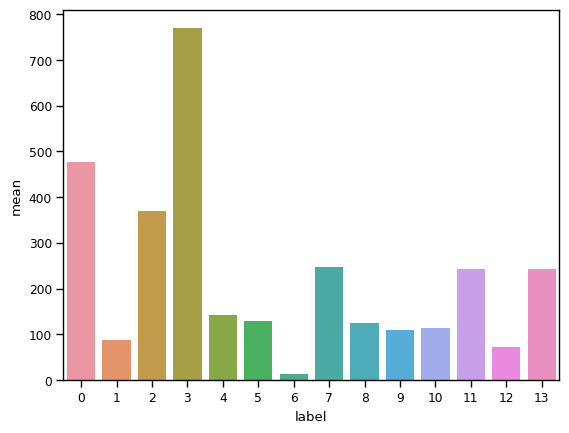

In [ ]:
sns.barplot(x = recap.index,
            y = recap['mean'])

Clusters les plus dépensiers : Clusters 9 et 13
il s'agit des catégories qui dépensent le plus dans les catégories "home" et "electronics"

In [ ]:
cluster[9].describe().loc[['mean', 'std', 'min','50%','max']]

,Nb_pdts,Tot_moy_achats,Delai_Moy_Commande,heure_achat,jour_achat,delai_dernier_achat,Note_Moy_Com,Facilités,geolocation_lat,geolocation_lng,"('price', 'home')","('price', 'appliances')","('price', 'construction')","('price', 'office')","('price', 'electronics')","('price', 'arts')","('price', 'fashion')","('price', 'health_beauty')","('price', 'sports_leisure')","('price', 'garden_pets')","('price', 'auto')","('price', 'food_drinks')","('price', 'other')"
mean,1.004208,4.643823,11.363254,14.507714,2.709677,151.971950,4.248247,2.993689,-21.793676,-46.214000,0.0,0.0,108.912553,0.0,0.0,0.0,0.0,0.953604,0.0,0.0,0.0,0.0,0.0
std,0.112351,0.309085,6.471298,5.241929,2.048192,126.943506,1.208037,2.594349,4.349558,3.487788,0.0,0.0,31.873384,0.0,0.0,0.0,0.0,25.463204,0.0,0.0,0.0,0.0,0.0
min,1.000000,3.911823,-1.000000,0.000000,0.000000,13.000000,1.000000,1.000000,-30.064053,-54.686073,0.0,0.0,54.400000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
50%,1.000000,4.699571,10.000000,15.000000,2.000000,117.000000,5.000000,2.000000,-22.903459,-46.634471,0.0,0.0,109.900000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
max,4.000000,5.135740,39.000000,23.000000,6.000000,577.000000,5.000000,10.000000,-3.716776,-35.204746,0.0,0.0,169.990000,0.0,0.0,0.0,0.0,679.920000,0.0,0.0,0.0,0.0,0.0


In [ ]:
cluster[13].describe().loc[['mean', 'std', 'min','50%','max']]

,Nb_pdts,Tot_moy_achats,Delai_Moy_Commande,heure_achat,jour_achat,delai_dernier_achat,Note_Moy_Com,Facilités,geolocation_lat,geolocation_lng,"('price', 'home')","('price', 'appliances')","('price', 'construction')","('price', 'office')","('price', 'electronics')","('price', 'arts')","('price', 'fashion')","('price', 'health_beauty')","('price', 'sports_leisure')","('price', 'garden_pets')","('price', 'auto')","('price', 'food_drinks')","('price', 'other')"
mean,1.258789,5.222957,12.816238,15.115622,2.796303,218.415730,4.130391,4.307901,-21.095124,-45.828353,1.178398,0.0,0.0,0.0,0.0,0.010149,239.174233,1.723378,0.385328,0.0,0.0,0.0,0.0
std,0.838094,0.509238,8.033296,5.448623,1.987408,139.008577,1.331400,2.883758,4.999324,3.641166,24.192612,0.0,0.0,0.0,0.0,0.533067,118.240569,29.502238,11.741286,0.0,0.0,0.0,0.0
min,1.000000,3.214868,-1.000000,0.000000,0.000000,13.000000,1.000000,1.000000,-30.071007,-56.086513,0.000000,0.0,0.0,0.0,0.0,0.000000,89.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
50%,1.000000,5.192401,11.000000,16.000000,3.000000,193.000000,5.000000,4.000000,-22.882235,-46.554341,0.000000,0.0,0.0,0.0,0.0,0.000000,199.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
max,9.000000,6.396596,46.000000,23.000000,6.000000,579.000000,5.000000,10.000000,-2.538363,-34.932184,720.000000,0.0,0.0,0.0,0.0,28.000000,599.800000,656.000000,399.920000,0.0,0.0,0.0,0.0


In [ ]:
for i in [9,13]:
    print('Nombre clients cluster ',i,': ', cluster[i].shape[0])

Nombre clients cluster  9 :  713
Nombre clients cluster  13 :  2759


### Les clients les moins dépensiers

Cluster 5 : les moins dépensiers et qui ont le moins recours aux facilités de paiement => opportunité de leur faire des offres sur les facilités de paiement

In [ ]:
cluster[5].describe().loc[['mean', 'std', 'min','50%','max']]

,Nb_pdts,Tot_moy_achats,Delai_Moy_Commande,heure_achat,jour_achat,delai_dernier_achat,Note_Moy_Com,Facilités,geolocation_lat,geolocation_lng,"('price', 'home')","('price', 'appliances')","('price', 'construction')","('price', 'office')","('price', 'electronics')","('price', 'arts')","('price', 'fashion')","('price', 'health_beauty')","('price', 'sports_leisure')","('price', 'garden_pets')","('price', 'auto')","('price', 'food_drinks')","('price', 'other')"
mean,1.040560,4.771455,14.831482,14.936263,2.779817,244.915500,4.122163,2.886287,-21.828446,-46.185750,0.0,0.0,0.0,127.940111,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
std,0.329392,0.353394,8.638812,5.306799,1.969526,144.911654,1.248785,2.489346,4.550557,3.498026,0.0,0.0,0.0,43.574655,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
min,1.000000,3.257327,-1.000000,0.000000,0.000000,13.000000,1.000000,1.000000,-30.080304,-56.082433,0.0,0.0,0.0,59.900000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
50%,1.000000,4.786658,13.000000,15.000000,3.000000,233.000000,5.000000,2.000000,-22.931611,-46.629100,0.0,0.0,0.0,119.980000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
max,4.000000,5.521061,46.000000,23.000000,6.000000,579.000000,5.000000,10.000000,-2.516840,-34.932184,0.0,0.0,0.0,249.900000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
print('Nombre clients cluster ',5,': ', cluster[5].shape[0])

Nombre clients cluster  5 :  2071


### Les clients qui ont acheté le plus grand nombre de produits

Cluster 12 : ils mettent en moyenne une moins bonne note

In [ ]:
cluster[9].describe().loc[['mean', 'std', 'min','50%','max']]

,Nb_pdts,Tot_moy_achats,Delai_Moy_Commande,heure_achat,jour_achat,delai_dernier_achat,Note_Moy_Com,Facilités,geolocation_lat,geolocation_lng,"('price', 'home')","('price', 'appliances')","('price', 'construction')","('price', 'office')","('price', 'electronics')","('price', 'arts')","('price', 'fashion')","('price', 'health_beauty')","('price', 'sports_leisure')","('price', 'garden_pets')","('price', 'auto')","('price', 'food_drinks')","('price', 'other')"
mean,1.004208,4.643823,11.363254,14.507714,2.709677,151.971950,4.248247,2.993689,-21.793676,-46.214000,0.0,0.0,108.912553,0.0,0.0,0.0,0.0,0.953604,0.0,0.0,0.0,0.0,0.0
std,0.112351,0.309085,6.471298,5.241929,2.048192,126.943506,1.208037,2.594349,4.349558,3.487788,0.0,0.0,31.873384,0.0,0.0,0.0,0.0,25.463204,0.0,0.0,0.0,0.0,0.0
min,1.000000,3.911823,-1.000000,0.000000,0.000000,13.000000,1.000000,1.000000,-30.064053,-54.686073,0.0,0.0,54.400000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
50%,1.000000,4.699571,10.000000,15.000000,2.000000,117.000000,5.000000,2.000000,-22.903459,-46.634471,0.0,0.0,109.900000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
max,4.000000,5.135740,39.000000,23.000000,6.000000,577.000000,5.000000,10.000000,-3.716776,-35.204746,0.0,0.0,169.990000,0.0,0.0,0.0,0.0,679.920000,0.0,0.0,0.0,0.0,0.0


In [ ]:
print('Nombre clients cluster ',9,': ', cluster[9].shape[0])

Nombre clients cluster  9 :  713


### Les longs délais de livraison

Cluster 3 : ceux qui ont eu un long délai de commande et mettent des mauvaises notes => leur proposer une livraison rapide pour améliorer leur expérience

In [ ]:
cluster[3].describe().loc[['mean', 'std', 'min','50%','max']]

,Nb_pdts,Tot_moy_achats,Delai_Moy_Commande,heure_achat,jour_achat,delai_dernier_achat,Note_Moy_Com,Facilités,geolocation_lat,geolocation_lng,"('price', 'home')","('price', 'appliances')","('price', 'construction')","('price', 'office')","('price', 'electronics')","('price', 'arts')","('price', 'fashion')","('price', 'health_beauty')","('price', 'sports_leisure')","('price', 'garden_pets')","('price', 'auto')","('price', 'food_drinks')","('price', 'other')"
mean,4.607277,4.851806,12.019083,14.941680,2.786517,236.619048,3.692795,3.645042,-22.158437,-46.259812,757.489791,0.614489,0.0,0.0,2.139347,0.0,0.113858,9.440776,0.0,0.444302,0.0,0.0,0.0
std,1.896935,0.587409,7.190980,5.313846,1.980340,147.964231,1.544593,2.977133,3.839780,3.326379,402.119125,15.046681,0.0,0.0,26.036168,0.0,4.922287,64.728496,0.0,13.588577,0.0,0.0,0.0
min,1.000000,2.647828,-1.000000,0.000000,0.000000,13.000000,1.000000,1.000000,-30.060963,-56.084154,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0
50%,4.000000,4.787408,10.000000,15.000000,3.000000,216.000000,4.000000,3.000000,-22.956040,-46.612001,647.600000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0
max,10.000000,6.801283,46.000000,23.000000,6.000000,579.000000,5.000000,10.000000,-2.542308,-35.034567,1944.000000,463.840000,0.0,0.0,519.120000,0.0,212.800000,798.400000,0.0,431.200000,0.0,0.0,0.0


In [ ]:
print('Nombre clients cluster ',3,': ', cluster[3].shape[0])

Nombre clients cluster  3 :  1869


### Les très longs délais de livraison (> 1 mois)

In [ ]:
cluster[3][cluster[3]['Delai_Moy_Commande']>30].describe()

,Nb_pdts,Tot_moy_achats,Delai_Moy_Commande,heure_achat,jour_achat,delai_dernier_achat,Note_Moy_Com,Facilités,geolocation_lat,geolocation_lng,"('price', 'home')","('price', 'appliances')","('price', 'construction')","('price', 'office')","('price', 'electronics')","('price', 'arts')","('price', 'fashion')","('price', 'health_beauty')","('price', 'sports_leisure')","('price', 'garden_pets')","('price', 'auto')","('price', 'food_drinks')","('price', 'other')"
count,49.000000,49.000000,49.000000,49.000000,49.000000,49.000000,49.000000,49.000000,49.000000,49.000000,49.000000,49.0,49.0,49.0,49.0,49.0,49.0,49.000000,49.0,49.0,49.0,49.0,49.0
mean,4.408163,4.943707,36.448980,14.938776,3.224490,241.040816,2.107143,3.755102,-20.864591,-45.156546,831.742857,0.0,0.0,0.0,0.0,0.0,0.0,6.530612,0.0,0.0,0.0,0.0,0.0
std,1.869919,0.662621,4.456088,5.680406,2.043947,118.012704,1.534329,2.995000,5.459680,4.275574,440.054669,0.0,0.0,0.0,0.0,0.0,0.0,45.714286,0.0,0.0,0.0,0.0,0.0
min,1.000000,3.610918,30.500000,0.000000,0.000000,44.000000,1.000000,1.000000,-29.995724,-55.503513,239.920000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
25%,4.000000,4.603168,33.000000,12.000000,1.000000,181.000000,1.000000,1.000000,-22.977648,-47.195927,488.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
50%,4.000000,4.940213,36.000000,16.000000,4.000000,204.000000,1.000000,2.000000,-22.828671,-43.505640,698.900000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
75%,4.000000,5.347108,39.000000,20.000000,5.000000,280.000000,3.000000,6.000000,-19.939460,-42.539315,1118.800000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
max,9.000000,6.549508,46.000000,23.000000,6.000000,560.000000,5.000000,10.000000,-3.753296,-38.324473,1944.000000,0.0,0.0,0.0,0.0,0.0,0.0,320.000000,0.0,0.0,0.0,0.0,0.0


In [ ]:
cluster[3][cluster[3]['Delai_Moy_Commande']>30].shape

(49, 25)

### Les catégories les plus achetées

**les catégories les plus achetées:**

<Axes: title={'center': 'Montant moyen de dépense par catégorie de produit'}, xlabel='price', ylabel='index'>

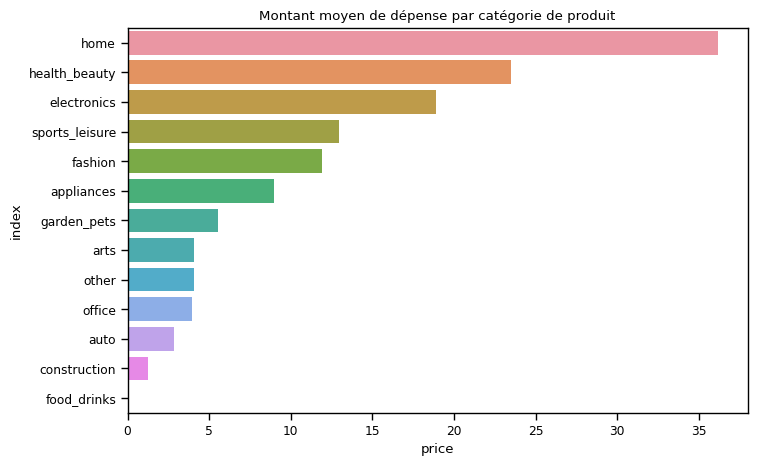

In [ ]:
# liste_col = [('price', 'home'), ('price', 'appliances'),
#        ('price', 'construction'), ('price', 'office'),
#        ('price', 'electronics'), ('price', 'arts'), ('price', 'fashion'),
#        ('price', 'health_beauty'), ('price', 'sports_leisure'),
#        ('price', 'garden_pets'), ('price', 'auto'),
#        ('price', 'food_drinks'), ('price', 'other')]
# dict_val = {}
# for column in liste_col:
#     dict_val[str(column).split("'")[3]] = data[str(column)].sum()/data.shape[0]

# plt.figure(figsize=(8,5))
# plt.title('Montant moyen de dépense par catégorie de produit')
# sns.barplot(y = 'index',
#             x='price',
#             data = pd.DataFrame(dict_val, index=['price']).T.reset_index().sort_values(by='price', ascending=False))
# Liste des colonnes de produits et de leur catégorie
liste_col = [('price', 'home'), ('price', 'appliances'),
             ('price', 'construction'), ('price', 'office'),
             ('price', 'electronics'), ('price', 'arts'), ('price', 'fashion'),
             ('price', 'health_beauty'), ('price', 'sports_leisure'),
             ('price', 'garden_pets'), ('price', 'auto'),
             ('price', 'food_drinks'), ('price', 'other')]

# Dictionnaire pour stocker les montants moyens de dépense par catégorie de produit
dict_val = {}

# Parcours de chaque colonne de produits et de leur catégorie dans la liste
for column in liste_col:
    # Calcule le montant moyen de dépense pour la catégorie de produit
    dict_val[str(column).split("'")[3]] = data[str(column)].sum() / data.shape[0]

# Crée une nouvelle figure avec une taille de 8x5
plt.figure(figsize=(8, 5))

# Définit le titre de la figure comme 'Montant moyen de dépense par catégorie de produit'
plt.title('Montant moyen de dépense par catégorie de produit')

# Affiche un graphique à barres horizontales avec les catégories de produits sur l'axe y,
# les montants moyens de dépense sur l'axe x,
# en utilisant les données du DataFrame créé à partir du dictionnaire dict_val,
# triées par ordre décroissant des montants moyens de dépense
sns.barplot(y='index',
            x='price',
            data=pd.DataFrame(dict_val, index=['price']).T.reset_index().sort_values(by='price', ascending=False))

Ce code calcule le montant moyen de dépense pour chaque catégorie de produit, à partir des colonnes de prix et de catégorie dans la liste liste_col. Ensuite, il crée un graphique à barres horizontales montrant les montants moyens de dépense pour chaque catégorie de produit, triées par ordre décroissant des montants.

In [ ]:
cluster[11].describe().loc[['mean', 'std', 'min','50%','max']]

,Nb_pdts,Tot_moy_achats,Delai_Moy_Commande,heure_achat,jour_achat,delai_dernier_achat,Note_Moy_Com,Facilités,geolocation_lat,geolocation_lng,"('price', 'home')","('price', 'appliances')","('price', 'construction')","('price', 'office')","('price', 'electronics')","('price', 'arts')","('price', 'fashion')","('price', 'health_beauty')","('price', 'sports_leisure')","('price', 'garden_pets')","('price', 'auto')","('price', 'food_drinks')","('price', 'other')"
mean,1.518164,5.085837,11.749226,14.870177,2.651647,246.586314,4.219656,3.488876,-22.064092,-46.453366,1.054058,0.0,0.0,0.0,0.526297,0.0,0.488426,0.409327,178.508786,62.348164,0.0,0.0,0.0
std,1.112107,0.532869,6.916462,5.375614,1.951532,147.060205,1.260915,2.911962,4.183134,3.366456,19.684857,0.0,0.0,0.0,11.425468,0.0,13.575643,12.345621,153.748568,114.246185,0.0,0.0,0.0
min,1.000000,2.493205,-1.000000,0.000000,0.000000,13.000000,1.000000,1.000000,-30.077807,-56.086513,0.000000,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0
50%,1.000000,5.068904,10.000000,15.000000,3.000000,223.000000,5.000000,2.000000,-22.937050,-46.658460,0.000000,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,159.900000,0.000000,0.0,0.0,0.0
max,9.000000,6.505784,46.000000,23.000000,6.000000,580.000000,5.000000,10.000000,-2.550546,-34.939870,551.200000,0.0,0.0,0.0,439.200000,0.0,479.200000,439.920000,669.000000,431.200000,0.0,0.0,0.0


In [ ]:
cluster[7][cluster[7]['Nb_pdts']>2].describe().loc[['mean', 'std', 'min','50%','max']]

,Nb_pdts,Tot_moy_achats,Delai_Moy_Commande,heure_achat,jour_achat,delai_dernier_achat,Note_Moy_Com,Facilités,geolocation_lat,geolocation_lng,"('price', 'home')","('price', 'appliances')","('price', 'construction')","('price', 'office')","('price', 'electronics')","('price', 'arts')","('price', 'fashion')","('price', 'health_beauty')","('price', 'sports_leisure')","('price', 'garden_pets')","('price', 'auto')","('price', 'food_drinks')","('price', 'other')"
mean,4.233974,4.223122,9.735577,15.000000,2.823718,229.067308,3.806090,3.131410,-22.469047,-46.502951,23.468462,345.563878,0.0,0.0,7.459231,0.0,0.0,1.396667,0.0,0.0,0.0,0.0,0.0
std,1.048533,0.502258,6.242664,5.199555,1.983294,148.136567,1.524208,2.673024,3.749467,2.933296,116.714987,122.664543,0.0,0.0,60.769227,0.0,0.0,24.670052,0.0,0.0,0.0,0.0,0.0
min,4.000000,2.637628,-1.000000,0.000000,0.000000,14.000000,1.000000,1.000000,-30.073588,-53.916205,0.000000,135.200000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
50%,4.000000,4.273884,8.000000,15.000000,3.000000,196.500000,5.000000,2.000000,-23.403978,-46.695299,0.000000,344.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
max,10.000000,4.982236,45.000000,23.000000,6.000000,570.000000,5.000000,10.000000,-2.567402,-34.939870,1112.000000,583.200000,0.0,0.0,624.000000,0.0,0.0,435.760000,0.0,0.0,0.0,0.0,0.0


In [ ]:
cluster[7][cluster[7]['Nb_pdts']>2].describe().loc[['mean', 'std', 'min','50%','max']]

,Nb_pdts,Tot_moy_achats,Delai_Moy_Commande,heure_achat,jour_achat,delai_dernier_achat,Note_Moy_Com,Facilités,geolocation_lat,geolocation_lng,"('price', 'home')","('price', 'appliances')","('price', 'construction')","('price', 'office')","('price', 'electronics')","('price', 'arts')","('price', 'fashion')","('price', 'health_beauty')","('price', 'sports_leisure')","('price', 'garden_pets')","('price', 'auto')","('price', 'food_drinks')","('price', 'other')"
mean,4.233974,4.223122,9.735577,15.000000,2.823718,229.067308,3.806090,3.131410,-22.469047,-46.502951,23.468462,345.563878,0.0,0.0,7.459231,0.0,0.0,1.396667,0.0,0.0,0.0,0.0,0.0
std,1.048533,0.502258,6.242664,5.199555,1.983294,148.136567,1.524208,2.673024,3.749467,2.933296,116.714987,122.664543,0.0,0.0,60.769227,0.0,0.0,24.670052,0.0,0.0,0.0,0.0,0.0
min,4.000000,2.637628,-1.000000,0.000000,0.000000,14.000000,1.000000,1.000000,-30.073588,-53.916205,0.000000,135.200000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
50%,4.000000,4.273884,8.000000,15.000000,3.000000,196.500000,5.000000,2.000000,-23.403978,-46.695299,0.000000,344.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
max,10.000000,4.982236,45.000000,23.000000,6.000000,570.000000,5.000000,10.000000,-2.567402,-34.939870,1112.000000,583.200000,0.0,0.0,624.000000,0.0,0.0,435.760000,0.0,0.0,0.0,0.0,0.0


In [ ]:
for i in range(13):
    print('Nombre clients cluster ',i,': ', cluster[i].shape[0])

Nombre clients cluster  0 :  1416
Nombre clients cluster  1 :  8705
Nombre clients cluster  2 :  2682
Nombre clients cluster  3 :  1869
Nombre clients cluster  4 :  1838
Nombre clients cluster  5 :  2071
Nombre clients cluster  6 :  1
Nombre clients cluster  7 :  1859
Nombre clients cluster  8 :  1320
Nombre clients cluster  9 :  713
Nombre clients cluster  10 :  2172
Nombre clients cluster  11 :  3551
Nombre clients cluster  12 :  43749


### Les clients ayant acheté le plus de produits

In [ ]:
data[data['Nb_pdts'] >=4].shape

(4545, 25)

In [ ]:
data.loc[data[data['Nb_pdts'] >=2].index].shape

(5803, 25)

### Les clients les plus satisfaits de leurs produits

In [ ]:
data['Note_Moy_Com'].describe()

count    74705.000000
mean         4.161986
std          1.275566
min          1.000000
25%          4.000000
50%          5.000000
75%          5.000000
max          5.000000
Name: Note_Moy_Com, dtype: float64

In [ ]:
data[data['Note_Moy_Com']==5].shape

(44167, 25)

In [ ]:
data.head()

,Nb_pdts,Tot_moy_achats,Delai_Moy_Commande,order_purchase_timestamp,heure_achat,jour_achat,delai_dernier_achat,Note_Moy_Com,Moy_Paiment,Facilités,geolocation_lat,geolocation_lng,"('price', 'home')","('price', 'appliances')","('price', 'construction')","('price', 'office')","('price', 'electronics')","('price', 'arts')","('price', 'fashion')","('price', 'health_beauty')","('price', 'sports_leisure')","('price', 'garden_pets')","('price', 'auto')","('price', 'food_drinks')","('price', 'other')"
customer_unique_id,,,,,,,,,,,,,,,,,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,1.0,4.866765,7.0,2018-05-10 10:56:27,10.0,3.0,115.0,5.0,credit_card,8.0,-23.340262,-46.831085,129.9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0000b849f77a49e4a4ce2b2a4ca5be3f,1.0,2.939162,4.0,2018-05-07 11:11:27,11.0,0.0,118.0,4.0,credit_card,1.0,-23.559044,-46.788516,0.0,0.0,0.0,0.0,0.0,0.0,0.0,18.9,0.0,0.0,0.0,0.0,0.0
0000f46a3911fa3c0805444483337064,1.0,4.234107,26.0,2017-03-10 21:05:03,21.0,4.0,541.0,3.0,credit_card,8.0,-27.543010,-48.634938,0.0,0.0,0.0,69.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0004aac84e0df4da2b147fca70cf8255,1.0,5.192957,14.0,2017-11-14 19:45:42,19.0,1.0,292.0,5.0,credit_card,6.0,-23.505588,-47.469820,0.0,0.0,0.0,0.0,180.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0004bd2a26a76fe21f786e4fbd80607f,1.0,5.036953,2.0,2018-04-05 19:33:16,19.0,3.0,150.0,4.0,credit_card,8.0,-23.515693,-46.690031,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,154.0,0.0,0.0,0.0


In [ ]:
data.loc[data[data['Nb_pdts'] >=2].index].shape

(5803, 25)

### clients les moins satisfaits de leurs produits

In [ ]:
data[data['Note_Moy_Com']==1].shape

(7129, 25)

### clustering des clients qui consomment le plus

In [ ]:
X3 = pd.DataFrame(X_pca_tot, index = data.index)

Sélection des clients qui ont acheté plus de 4 produits

In [ ]:
# dict_silhouette = {}
# dict_kmeans_consumers = {}
# for i in range(3,15,1):
#     dict_kmeans_consumers[i] = KMeans(n_clusters=i, 
#                     verbose=1, 
#                     random_state=0).fit(X3.loc[data[data['Nb_pdts'] >=4].index])
#     dict_silhouette[i] = (silhouette_score(X = X3.loc[data[data['Nb_pdts'] >=4].index],
#                          labels= list(dict_kmeans_consumers[i].labels_)))
dict_silhouette = {}  # Dictionnaire pour stocker les scores de silhouette pour chaque nombre de clusters
dict_kmeans_consumers = {}  # Dictionnaire pour stocker les modèles KMeans pour chaque nombre de clusters

for i in range(3, 15, 1):  # Boucle pour essayer différents nombres de clusters de 3 à 14 inclus
    # Entraînement du modèle KMeans avec i clusters pour les consommateurs ayant acheté au moins 4 produits
    dict_kmeans_consumers[i] = KMeans(n_clusters=i,
                                      verbose=1,
                                      random_state=0).fit(X3.loc[data[data['Nb_pdts'] >= 4].index])
    # Calcul du score de silhouette pour le modèle KMeans et enregistrement dans le dictionnaire 'dict_silhouette'
    dict_silhouette[i] = silhouette_score(X=X3.loc[data[data['Nb_pdts'] >= 4].index],
                                          labels=list(dict_kmeans_consumers[i].labels_))


Initialization complete
Iteration 0, inertia 212283.69742577898
Iteration 1, inertia 169783.5266267534
Iteration 2, inertia 160572.68262336694
Iteration 3, inertia 160275.7341502086
Iteration 4, inertia 160266.82798278745
Iteration 5, inertia 160266.58688422389
Converged at iteration 5: strict convergence.
Initialization complete
Iteration 0, inertia 219356.39532234694
Iteration 1, inertia 158765.58759817955
Iteration 2, inertia 158143.85402249603
Iteration 3, inertia 158017.74690393204
Iteration 4, inertia 157996.61309577565
Iteration 5, inertia 157993.6778076498
Iteration 6, inertia 157992.8059399647
Converged at iteration 6: center shift 8.6502628252875e-05 within tolerance 0.00023676814706386688.
Initialization complete
Iteration 0, inertia 170740.1481087291
Iteration 1, inertia 149255.4925650505
Iteration 2, inertia 148767.356435854
Iteration 3, inertia 148579.32491043903
Iteration 4, inertia 148499.72710135984
Iteration 5, inertia 148469.85776550532
Iteration 6, inertia 148455.64

Initialization complete
Iteration 0, inertia 174534.73744505076
Iteration 1, inertia 125540.37904907136
Iteration 2, inertia 113052.02199474466
Iteration 3, inertia 111965.92509810862
Iteration 4, inertia 111650.15587685964
Iteration 5, inertia 111507.78600377409
Iteration 6, inertia 111438.05935700912
Iteration 7, inertia 111400.79611752195
Iteration 8, inertia 111388.91298205368
Iteration 9, inertia 111382.12621228803
Iteration 10, inertia 111380.03126387634
Iteration 11, inertia 111377.35629591948
Iteration 12, inertia 111376.13385481221
Converged at iteration 12: center shift 0.0001461226303326111 within tolerance 0.00023676814706386688.
Initialization complete
Iteration 0, inertia 168876.39690960382
Iteration 1, inertia 115005.17038389354
Iteration 2, inertia 113290.16022950233
Iteration 3, inertia 112701.5344126196
Iteration 4, inertia 112451.17229899288
Iteration 5, inertia 112337.33489742399
Iteration 6, inertia 112290.465150106
Iteration 7, inertia 112265.3472738051
Iteration 

Initialization complete
Iteration 0, inertia 132731.57515787028
Iteration 1, inertia 81035.17808799431
Iteration 2, inertia 73947.32719337981
Iteration 3, inertia 73082.20631935936
Iteration 4, inertia 72797.36345956217
Iteration 5, inertia 72686.17012523384
Iteration 6, inertia 72666.61889295935
Iteration 7, inertia 72658.14401666577
Iteration 8, inertia 72655.70986151746
Iteration 9, inertia 72654.59864372377
Iteration 10, inertia 72654.13871501619
Iteration 11, inertia 72653.84803678376
Converged at iteration 11: center shift 0.00013465002454870066 within tolerance 0.00023676814706386688.
Initialization complete
Iteration 0, inertia 111627.32476571658
Iteration 1, inertia 84151.14352838288
Iteration 2, inertia 82390.09919762333
Iteration 3, inertia 82012.57155544336
Iteration 4, inertia 81836.37973805585
Iteration 5, inertia 81726.92597759089
Iteration 6, inertia 81625.92962183127
Iteration 7, inertia 81539.69804591658
Iteration 8, inertia 81477.46392428635
Iteration 9, inertia 8140

Iteration 5, inertia 66876.86285542135
Iteration 6, inertia 66858.41233618573
Iteration 7, inertia 66850.76930439204
Iteration 8, inertia 66844.81250330369
Iteration 9, inertia 66839.74690789275
Iteration 10, inertia 66836.2890143987
Iteration 11, inertia 66834.03491078892
Iteration 12, inertia 66833.81226715722
Converged at iteration 12: center shift 5.726010419416339e-05 within tolerance 0.00023676814706386688.
Initialization complete
Iteration 0, inertia 110397.32764349853
Iteration 1, inertia 80267.9693744169
Iteration 2, inertia 70941.57661427006
Iteration 3, inertia 67901.49826258926
Iteration 4, inertia 66968.14211676546
Iteration 5, inertia 66885.38170477556
Iteration 6, inertia 66859.38242093578
Iteration 7, inertia 66837.55172790898
Iteration 8, inertia 66834.5348736187
Iteration 9, inertia 66834.0925876052
Converged at iteration 9: center shift 0.0001567833791034543 within tolerance 0.00023676814706386688.
Initialization complete
Iteration 0, inertia 94431.58599188432
Iterat

Initialization complete
Iteration 0, inertia 86325.55232876181
Iteration 1, inertia 59151.98611309482
Iteration 2, inertia 58066.91952031239
Iteration 3, inertia 57982.00978110866
Iteration 4, inertia 57974.55735644086
Iteration 5, inertia 57972.78305924214
Iteration 6, inertia 57972.07345285824
Iteration 7, inertia 57971.76589443417
Converged at iteration 7: center shift 0.0002073176557298948 within tolerance 0.00023676814706386688.
Initialization complete
Iteration 0, inertia 86331.9660748198
Iteration 1, inertia 64036.66188147239
Iteration 2, inertia 63426.66809820455
Iteration 3, inertia 63245.69579669898
Iteration 4, inertia 63187.378637442416
Iteration 5, inertia 63162.061115885816
Iteration 6, inertia 63142.21040980128
Iteration 7, inertia 63134.91845488391
Iteration 8, inertia 63124.190523427744
Iteration 9, inertia 63119.247541167475
Iteration 10, inertia 63115.44466163831
Iteration 11, inertia 63112.25881703061
Iteration 12, inertia 63109.38308324794
Iteration 13, inertia 631

Initialization complete
Iteration 0, inertia 81805.70657716598
Iteration 1, inertia 59350.522955247216
Iteration 2, inertia 57055.87814893991
Iteration 3, inertia 55998.05486626499
Iteration 4, inertia 55355.687905991
Iteration 5, inertia 55105.05347435182
Iteration 6, inertia 55024.330364495705
Iteration 7, inertia 55003.09912647062
Iteration 8, inertia 54992.18865033169
Iteration 9, inertia 54986.74605730707
Iteration 10, inertia 54984.17750632515
Iteration 11, inertia 54983.13534532337
Iteration 12, inertia 54982.160514406634
Iteration 13, inertia 54981.618421329265
Iteration 14, inertia 54981.39587423927
Converged at iteration 14: center shift 4.5712873164316016e-05 within tolerance 0.00023676814706386688.
Initialization complete
Iteration 0, inertia 89981.89095213592
Iteration 1, inertia 63213.15205491996
Iteration 2, inertia 60918.32372600522
Iteration 3, inertia 60197.18776210386
Iteration 4, inertia 59427.503634968896
Iteration 5, inertia 56831.99433308077
Iteration 6, inertia 

Initialization complete
Iteration 0, inertia 79649.34422287648
Iteration 1, inertia 54636.79330338351
Iteration 2, inertia 53743.88049841277
Iteration 3, inertia 53531.18088319745
Iteration 4, inertia 53385.38379305989
Iteration 5, inertia 53260.8431395481
Iteration 6, inertia 53152.71140202313
Iteration 7, inertia 53075.09737051217
Iteration 8, inertia 53024.85091908726
Iteration 9, inertia 52979.26529354043
Iteration 10, inertia 52928.066169215585
Iteration 11, inertia 52872.77028391942
Iteration 12, inertia 52823.94335658338
Iteration 13, inertia 52758.638547778726
Iteration 14, inertia 52664.75769393245
Iteration 15, inertia 52562.11200976604
Iteration 16, inertia 52470.71682285354
Iteration 17, inertia 52403.556524907355
Iteration 18, inertia 52374.22627498875
Iteration 19, inertia 52357.49899189485
Iteration 20, inertia 52335.68950922703
Iteration 21, inertia 52315.501286989136
Iteration 22, inertia 52250.986015749266
Iteration 23, inertia 52142.168050240216
Iteration 24, inertia

Iteration 12, inertia 51727.18021529345
Iteration 13, inertia 51712.366337718
Iteration 14, inertia 51700.716846018295
Iteration 15, inertia 51688.0952122042
Iteration 16, inertia 51674.145085608485
Iteration 17, inertia 51664.450828092085
Iteration 18, inertia 51659.15195168261
Iteration 19, inertia 51655.896386454595
Iteration 20, inertia 51654.45666382169
Iteration 21, inertia 51653.12680230035
Iteration 22, inertia 51651.730311397754
Iteration 23, inertia 51649.95415757914
Iteration 24, inertia 51648.5059470521
Iteration 25, inertia 51647.75918483229
Iteration 26, inertia 51646.83837395985
Iteration 27, inertia 51645.76905907106
Iteration 28, inertia 51644.09435957563
Iteration 29, inertia 51641.80511969501
Iteration 30, inertia 51639.69504782978
Iteration 31, inertia 51638.664291024375
Iteration 32, inertia 51637.83807495352
Iteration 33, inertia 51636.93201300338
Iteration 34, inertia 51636.32739844728
Iteration 35, inertia 51635.84458205226
Iteration 36, inertia 51635.3900540018

Iteration 47, inertia 50473.56938550976
Converged at iteration 47: strict convergence.
Initialization complete
Iteration 0, inertia 78812.11785925686
Iteration 1, inertia 52991.96115140823
Iteration 2, inertia 52275.37526919385
Iteration 3, inertia 52059.55853365754
Iteration 4, inertia 51907.898218625145
Iteration 5, inertia 51798.676532263984
Iteration 6, inertia 51698.96691369191
Iteration 7, inertia 51598.70140682753
Iteration 8, inertia 51488.00121029204
Iteration 9, inertia 51401.448305623795
Iteration 10, inertia 51356.725084510865
Iteration 11, inertia 51328.847821213385
Iteration 12, inertia 51305.43427849186
Iteration 13, inertia 51289.72962896935
Iteration 14, inertia 51272.44280293428
Iteration 15, inertia 51246.56224673057
Iteration 16, inertia 51205.44912383018
Iteration 17, inertia 51126.720069697876
Iteration 18, inertia 51017.85721683627
Iteration 19, inertia 50938.81268635122
Iteration 20, inertia 50879.19058335212
Iteration 21, inertia 50841.108338287086
Iteration 22

Ce code essaie différents nombres de clusters (de 3 à 14 inclus) en utilisant KMeans, mais seulement pour les consommateurs ayant acheté au moins 4 produits (c'est ce que fait la sélection de l'index data[data['Nb_pdts'] >= 4].index dans X3.loc). Ensuite, il enregistre le score de silhouette pour chaque nombre de clusters dans le dictionnaire 'dict_silhouette' et enregistre également le modèle KMeans correspondant dans le dictionnaire 'dict_kmeans_consumers'.

In [ ]:
dict_silhouette

{3: 0.18857102308605483,
 4: 0.22875673036596408,
 5: 0.2589555139142689,
 6: 0.29277714273144867,
 7: 0.32449171141494193,
 8: 0.3388237257418915,
 9: 0.27683344855791603,
 10: 0.25972544593373376,
 11: 0.2490573996313648,
 12: 0.24172372816212645,
 13: 0.2320413355109247,
 14: 0.21250935155155115}

In [ ]:
print(max(dict_silhouette.values()))

0.3388237257418915


In [ ]:
best_num_clusters = max(dict_silhouette, key=dict_silhouette.get)
print("Le meilleur nombre de clusters est :", best_num_clusters)

Le meilleur nombre de clusters est : 13


In [ ]:
list(dict_silhouette.keys())[list(dict_silhouette.values()).index(max(dict_silhouette.values()))]

8

In [ ]:
X_most_imp_cat = data.copy()[data['Nb_pdts'] >=4]
X_most_imp_cat['label'] = dict_kmeans_consumers[8].labels_

In [ ]:
X_most_imp_cat.shape

(4545, 26)

cela représente 4600 clients potentiels

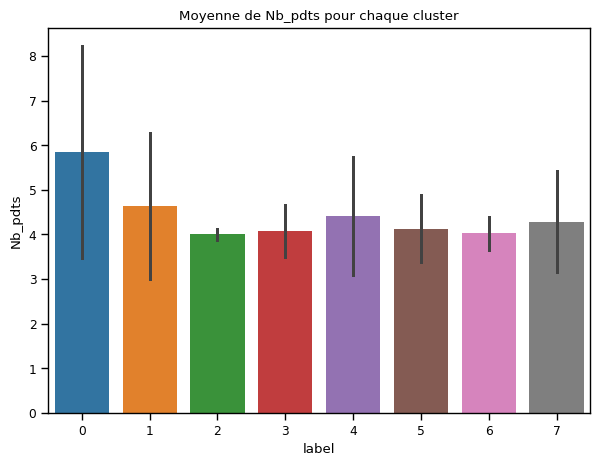

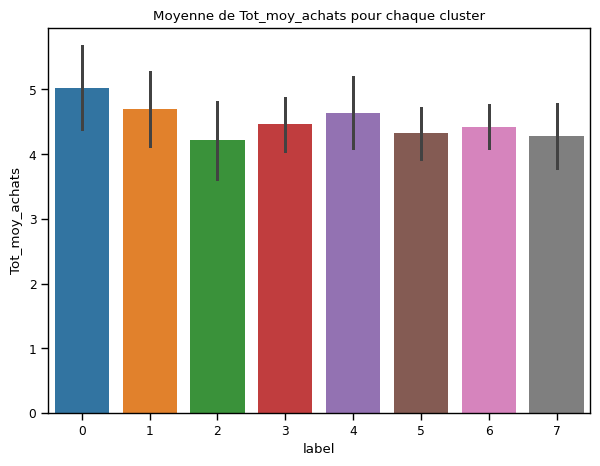

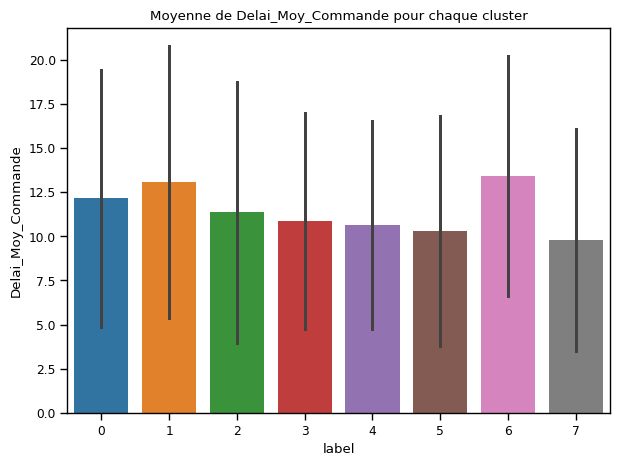

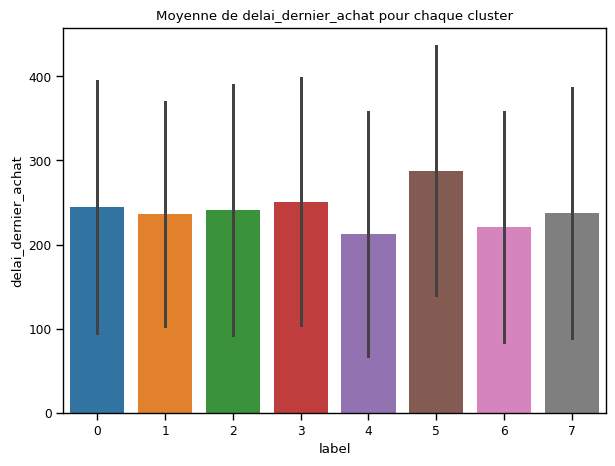

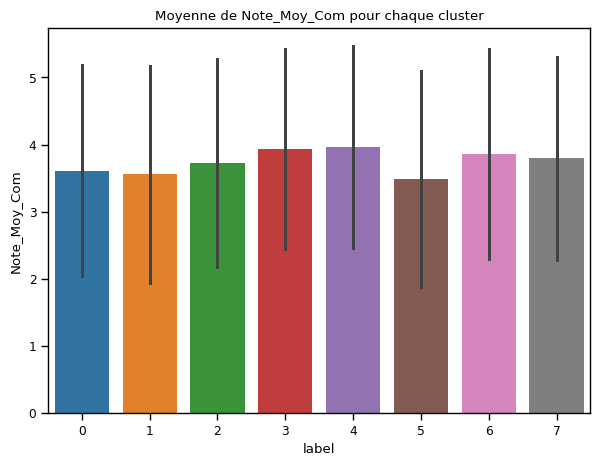

...

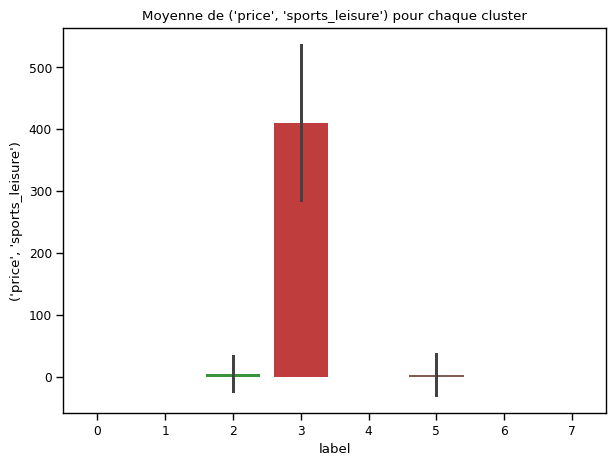

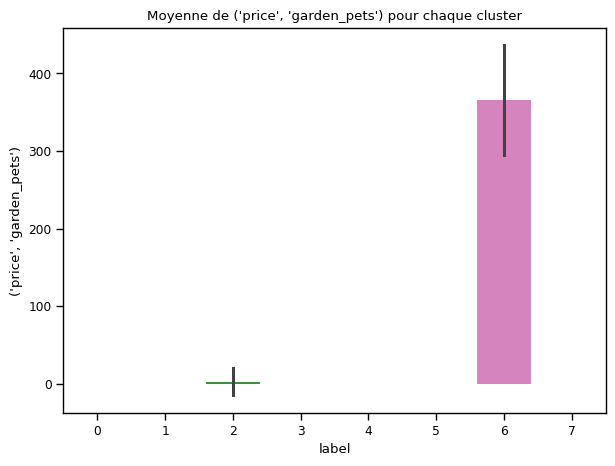

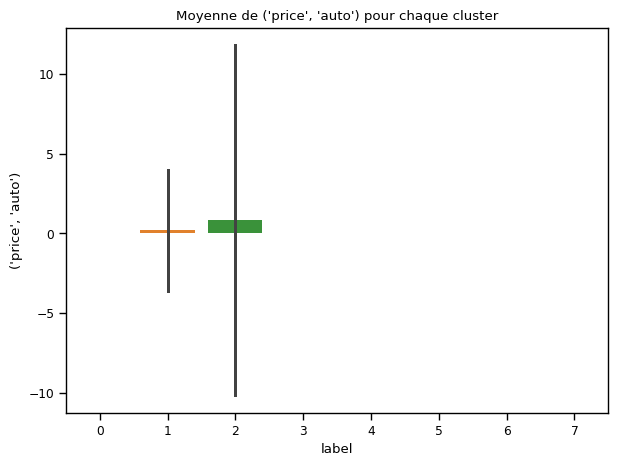

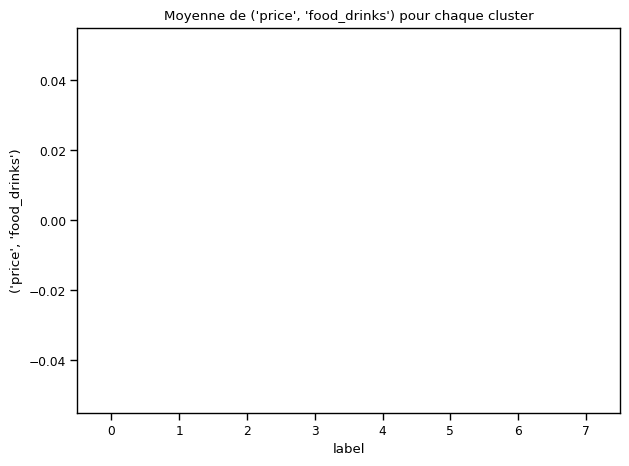

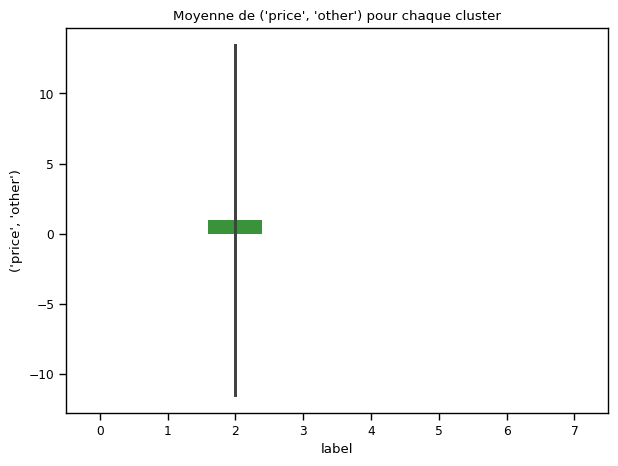

In [ ]:
# for column in X_most_imp_cat.drop(['order_purchase_timestamp', 'heure_achat', 'jour_achat', 'label'], axis=1).columns:
#     plt.figure(figsize=(7,5))
#     titre = 'Moyenne de ' + str(column) + ' pour chaque cluster' 
#     plt.title(titre)
#     sns.barplot(x = 'label',
#                 y = column,
#                 data = X_most_imp_cat, 
#                 ci="sd")
#     plt.show()
# Parcours de chaque colonne dans X_most_imp_cat (à l'exception de certaines colonnes) pour afficher les moyennes pour chaque cluster
for column in X_most_imp_cat.drop(['order_purchase_timestamp', 'heure_achat', 'jour_achat', 'label'], axis=1).columns:
    # Crée une nouvelle figure pour chaque colonne avec une taille de 7x5
    plt.figure(figsize=(7, 5))
    # Définit le titre de la figure comme 'Moyenne de [nom de la colonne] pour chaque cluster'
    titre = 'Moyenne de ' + str(column) + ' pour chaque cluster' 
    plt.title(titre)
    # Affiche un graphique à barres avec les clusters sur l'axe x, les valeurs moyennes de la colonne sur l'axe y,
    # en utilisant les données du DataFrame X_most_imp_cat et en incluant un intervalle de confiance ('ci="sd"')
    sns.barplot(x='label',
                y=column,
                data=X_most_imp_cat,
                ci="sd")
    # Affiche le graphique
    plt.show()


Ce code parcourt chaque colonne dans le DataFrame X_most_imp_cat, à l'exception des colonnes 'order_purchase_timestamp', 'heure_achat', 'jour_achat' et 'label'. Pour chaque colonne, il crée un graphique à barres montrant la moyenne de la colonne pour chaque cluster. Les clusters sont représentés sur l'axe des x, les valeurs moyennes de la colonne sont représentées sur l'axe des y, et l'intervalle de confiance est inclus pour montrer la variabilité des données. Le code affiche ensuite chaque graphique.

In [ ]:
X_most_imp_cat.shape

(4545, 26)

La différence entre les clusters se fait principalement par les catégories de dépense:
* les individus du cluster 1 a dépensé en moyenne 1200 en produit 'home'
* les individus du  du cluster 3 ont dépensé en moyenne plus de 370 dans la catégorie 'appliances'
* les individus du cluster 5 ont dépensé en moyenne 600 dans la catégorie electronics
* les individus du cluster 0 ont dépensé en moyenne 600 dans la catégorie health/beauty
* les individus du cluster 6 ont dépensé en moyenne 350 dans la catégorie fashion
* les individus du cluster 7 ont dépensé en moyenne 400 dans la catégorie sport/leisure
* les individus du cluster 2 ont dépensé en moyenne plus de 400 dans la catégorie "garden" / pets
* les individus du cluster 4 ont dépensé en moyenne 300 dans la catégorie 'home' 

on peut par exemple cibler prioritairement ces clients pour des publicités de produits des catégories indiquées ci-dessus

Certaines catégories de produits séduisent davantage de catégories de clients que d'autres, c'est notamment le cas des catégories home, electronics et health beauty qui ont des acheteurs dans tous les clusters. Il y a un levier potentiellement exploitable pour rediriger les clients des autres catégories vers ces catégories

# Caractérisation évolution dans le temps  

* Idée : on pourrait réduire les données en retirant les derniers mois de données et voir si les clusters évoluent ou non : si oui cela veut dire qu’il faut actualiser sur une période de temps plus faible
* Essayer en isolant une région ou autre variable pour voir si le cluster est robuste ou non


In [ ]:
data['order_purchase_timestamp'] = data['order_purchase_timestamp'].astype('datetime64')

In [ ]:
data['order_purchase_timestamp'].describe()

count                   74705
unique                  74547
top       2018-02-19 15:37:47
freq                        3
first     2017-01-30 10:03:21
last      2018-08-21 09:04:45
Name: order_purchase_timestamp, dtype: object

Pour voir si le clustering est stable:
* on va retirer du jeu de données tous les clients dont le dernier achat date d'il y a moins de n mois avec différents pas

In [ ]:
X_tot

,Nb_pdts,Tot_moy_achats,Delai_Moy_Commande,heure_achat,jour_achat,delai_dernier_achat,Note_Moy_Com,Facilités,geolocation_lat,geolocation_lng,"('price', 'home')","('price', 'appliances')","('price', 'construction')","('price', 'office')","('price', 'electronics')","('price', 'arts')","('price', 'fashion')","('price', 'health_beauty')","('price', 'sports_leisure')","('price', 'garden_pets')","('price', 'auto')","('price', 'food_drinks')","('price', 'other')",x0_boleto,x0_credit_card,x0_debit_card,x0_voucher
customer_unique_id,,,,,,,,,,,,,,,,,,,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,-0.252934,0.674413,-0.659922,-0.905895,0.125612,-0.844066,0.656979,2.179455,-0.363934,-0.205560,0.662448,-0.203981,-0.108908,-0.175051,-0.249208,-0.195361,-0.227077,-0.289022,-0.241773,-0.176654,-0.159481,-0.003659,-0.171063,0.0,1.0,0.0,0.0
0000b849f77a49e4a4ce2b2a4ca5be3f,-0.252934,-1.754239,-1.053042,-0.717425,-1.396007,-0.823856,-0.126992,-0.701164,-0.408854,-0.193730,-0.255630,-0.203981,-0.108908,-0.175051,-0.249208,-0.195361,-0.227077,-0.056408,-0.241773,-0.176654,-0.159481,-0.003659,-0.171063,0.0,1.0,0.0,0.0
0000f46a3911fa3c0805444483337064,-0.252934,-0.122695,1.829840,1.167276,0.632818,2.025695,-0.910963,2.179455,-1.226842,-0.706863,-0.255630,-0.203981,-0.108908,2.879229,-0.249208,-0.195361,-0.227077,-0.289022,-0.241773,-0.176654,-0.159481,-0.003659,-0.171063,0.0,1.0,0.0,0.0
0004aac84e0df4da2b147fca70cf8255,-0.252934,1.085393,0.257359,0.790336,-0.888801,0.348299,0.656979,1.356421,-0.397879,-0.383069,-0.255630,-0.203981,-0.108908,-0.175051,2.121843,-0.195361,-0.227077,-0.289022,-0.241773,-0.176654,-0.159481,-0.003659,-0.171063,0.0,1.0,0.0,0.0
0004bd2a26a76fe21f786e4fbd80607f,-0.252934,0.888838,-1.315122,0.790336,0.125612,-0.608288,-0.126992,2.179455,-0.399954,-0.166360,-0.255630,-0.203981,-0.108908,-0.175051,-0.249208,-0.195361,-0.227077,-0.289022,-0.241773,4.725049,-0.159481,-0.003659,-0.171063,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
fffb09418989a0dbff854a28163e47c6,-0.252934,-0.341499,-0.397842,0.790336,1.647231,0.125994,0.656979,-0.701164,-1.513058,-1.516901,-0.255630,-0.203981,-0.108908,-0.175051,-0.249208,-0.195361,0.880644,-0.289022,-0.241773,-0.176654,-0.159481,-0.003659,-0.171063,1.0,0.0,0.0,0.0
fffea47cd6d3cc0a88bd621562a9d061,-0.252934,-0.200071,2.485040,0.978806,1.647231,0.173150,-0.126992,-0.701164,1.919709,1.982079,-0.255630,-0.203981,-0.108908,-0.175051,-0.249208,-0.195361,-0.227077,0.509620,-0.241773,-0.176654,-0.159481,-0.003659,-0.171063,0.0,1.0,0.0,0.0
ffff371b4d645b6ecea244b27531430a,-0.252934,0.210673,0.388399,0.036455,-0.888801,2.234527,0.656979,-0.701164,1.998387,-2.616972,-0.255630,-0.203981,-0.108908,-0.175051,-0.249208,-0.195361,-0.227077,-0.289022,-0.241773,-0.176654,4.837696,-0.003659,-0.171063,0.0,1.0,0.0,0.0


## Préparation jeu de données

Faisons un test de clustering en retirant les 3 derniers mois du jeu de données (test de faisabilité en retirant tous les clients qui ont fait un achat dans les 3 derniers mois)

In [ ]:
data['order_purchase_timestamp'].max()

Timestamp('2018-08-21 09:04:45')

In [ ]:
data[data['order_purchase_timestamp'] < '2018-05-21 09:04:45'].shape

(59105, 25)

In [ ]:
X_old = data[data['order_purchase_timestamp'] < '2018-05-21 09:04:45'].copy()

In [ ]:
categorical_columns = X_old.select_dtypes(['category','object']).columns
numerical_columns = X_old.select_dtypes(['int32','float64']).columns


X_old[numerical_columns] = ss.transform(X_old[numerical_columns])
ohe.fit(X_old[categorical_columns])

OneHotEncoder(sparse=False)

In [ ]:
X_old = pd.merge(X_old[numerical_columns], 
          pd.DataFrame(columns = ohe.get_feature_names().tolist(),
              data = ohe.fit_transform(X_old[categorical_columns])).set_index(X_old.index),
        left_index = True, right_index = True)

## ACP

In [ ]:
X_pca_old = pca_tot.transform(X_old)[:,:18]

## Kmeans

In [ ]:
# inertia = {}
# dict_kmeans = {}
# dict_silhouette = {}
# for k in range(5,20):
#     kmeans_old = KMeans(n_clusters=k,
#                    verbose=1,
#                    random_state=0).fit(X_pca_old)
#     inertia[k] = kmeans.inertia_
#     dict_kmeans[k] = kmeans
#     dict_silhouette[k] = silhouette_score(X = X_pca_old, labels= kmeans_old.labels_)
#     print('Boucle {} - Silhouette score : {}'.format(k, dict_silhouette[k]))
inertia = {}  # Dictionnaire pour stocker l'inertie pour chaque nombre de clusters
dict_kmeans = {}  # Dictionnaire pour stocker les modèles KMeans pour chaque nombre de clusters
dict_silhouette = {}  # Dictionnaire pour stocker le score de silhouette pour chaque nombre de clusters

for k in range(5, 20):  # Boucle pour essayer différents nombres de clusters de 5 à 19 inclus
    kmeans_old = KMeans(n_clusters=k,
                        verbose=1,
                        random_state=0).fit(X_pca_old)  # Entraînement du modèle KMeans avec k clusters
    inertia[k] = kmeans.inertia_  # Enregistrement de l'inertie du modèle dans le dictionnaire 'inertia'
    dict_kmeans[k] = kmeans_old  # Enregistrement du modèle KMeans dans le dictionnaire 'dict_kmeans'
    dict_silhouette[k] = silhouette_score(X=X_pca_old, labels=kmeans_old.labels_)  # Calcul du score de silhouette pour le modèle et enregistrement dans le dictionnaire 'dict_silhouette'
    print('Boucle {} - Silhouette score : {}'.format(k, dict_silhouette[k]))  # Affichage du score de silhouette pour chaque nombre de clusters


Initialization complete
Iteration 0, inertia 1207523.858448941
Iteration 1, inertia 980012.4275386131
Iteration 2, inertia 973153.8453265539
Iteration 3, inertia 967093.9587477405
Iteration 4, inertia 962939.8170899265
Iteration 5, inertia 960873.4180915917
Iteration 6, inertia 959817.0683814653
Iteration 7, inertia 959121.5602281459
Iteration 8, inertia 958590.1981707071
Iteration 9, inertia 958218.5208893805
Iteration 10, inertia 957973.9754645424
Iteration 11, inertia 957816.3526348164
Iteration 12, inertia 957749.3300620315
Iteration 13, inertia 957712.3550455603
Iteration 14, inertia 957689.4013496041
Iteration 15, inertia 957675.1664311949
Iteration 16, inertia 957666.9398701831
Iteration 17, inertia 957662.3171939233
Iteration 18, inertia 957659.6576833733
Converged at iteration 18: center shift 0.00010147553548092276 within tolerance 0.00011360210512493267.
Initialization complete
Iteration 0, inertia 1226848.384128261
Iteration 1, inertia 1018480.7033176824
Iteration 2, inerti

Initialization complete
Iteration 0, inertia 1247281.3796542208
Iteration 1, inertia 1020363.3749364456
Iteration 2, inertia 1004487.8982404473
Iteration 3, inertia 993902.5609439797
Iteration 4, inertia 985699.2071732414
Iteration 5, inertia 980019.250098863
Iteration 6, inertia 976695.4647301506
Iteration 7, inertia 975316.0758618605
Iteration 8, inertia 974859.0882038937
Iteration 9, inertia 974721.4049854745
Iteration 10, inertia 974671.7601178358
Iteration 11, inertia 974642.1290772505
Iteration 12, inertia 974615.2693559988
Iteration 13, inertia 974576.0421607667
Iteration 14, inertia 974526.6350999123
Iteration 15, inertia 974494.1247294017
Iteration 16, inertia 974467.2590607032
Iteration 17, inertia 974450.5544134848
Iteration 18, inertia 974441.6846455487
Iteration 19, inertia 974435.0790380486
Iteration 20, inertia 974429.2124611958
Iteration 21, inertia 974424.675832502
Iteration 22, inertia 974420.9802201203
Converged at iteration 22: center shift 9.642012751382742e-05 wit

Iteration 35, inertia 940069.7947973835
Iteration 36, inertia 937509.2596402356
Iteration 37, inertia 935757.1678414233
Iteration 38, inertia 934864.5883139787
Iteration 39, inertia 934470.4009306324
Iteration 40, inertia 934263.4647246911
Iteration 41, inertia 934144.4040580792
Iteration 42, inertia 934083.7126165141
Iteration 43, inertia 934055.1375780582
Iteration 44, inertia 934040.1976738262
Iteration 45, inertia 934031.8661721769
Iteration 46, inertia 934026.3133613508
Iteration 47, inertia 934023.3689760456
Iteration 48, inertia 934021.7993189816
Converged at iteration 48: center shift 4.234323194126238e-05 within tolerance 0.00011360210512493267.
Initialization complete
Iteration 0, inertia 1153632.5709892523
Iteration 1, inertia 958489.6552090234
Iteration 2, inertia 949863.5343580891
Iteration 3, inertia 944025.1167607538
Iteration 4, inertia 940950.3407673963
Iteration 5, inertia 939477.3512811371
Iteration 6, inertia 938527.6034030572
Iteration 7, inertia 937711.0691571457


Iteration 31, inertia 871543.7045465938
Iteration 32, inertia 871533.4844669331
Iteration 33, inertia 871520.8222535953
Iteration 34, inertia 871500.8722911633
Iteration 35, inertia 871467.5279142379
Iteration 36, inertia 871416.6349116242
Iteration 37, inertia 871342.4149110338
Iteration 38, inertia 871212.9477381394
Iteration 39, inertia 870977.2498146658
Iteration 40, inertia 870488.8395944396
Iteration 41, inertia 869622.5663571175
Iteration 42, inertia 868763.9982648793
Iteration 43, inertia 867566.9504832064
Iteration 44, inertia 865344.9808523845
Iteration 45, inertia 862616.7894347783
Iteration 46, inertia 861488.0464612716
Iteration 47, inertia 860777.5832826531
Iteration 48, inertia 859577.1159334071
Iteration 49, inertia 857824.4827123644
Iteration 50, inertia 855657.975608537
Iteration 51, inertia 853062.3790291637
Iteration 52, inertia 850054.6270899161
Iteration 53, inertia 847530.6353243522
Iteration 54, inertia 846076.6960030951
Iteration 55, inertia 845303.2453514478
I

Iteration 5, inertia 883188.8127558369
Iteration 6, inertia 880663.7056107793
Iteration 7, inertia 879466.5404517885
Iteration 8, inertia 878926.2577855106
Iteration 9, inertia 878699.0447826729
Iteration 10, inertia 878582.7997666188
Iteration 11, inertia 878497.6052094764
Iteration 12, inertia 878409.3776856707
Iteration 13, inertia 878361.9881683958
Iteration 14, inertia 878347.7367443489
Iteration 15, inertia 878343.3845164062
Converged at iteration 15: center shift 8.553271159159674e-05 within tolerance 0.00011360210512493267.
Initialization complete
Iteration 0, inertia 1028150.7729509023
Iteration 1, inertia 930986.960688738
Iteration 2, inertia 909983.5314184283
Iteration 3, inertia 898562.2820687415
Iteration 4, inertia 891938.8951712188
Iteration 5, inertia 885899.6385181504
Iteration 6, inertia 881830.6233986644
Iteration 7, inertia 879043.5611014693
Iteration 8, inertia 876002.6600039575
Iteration 9, inertia 869527.3554133247
Iteration 10, inertia 860597.7221444569
Iteratio

Iteration 32, inertia 820202.8330966329
Converged at iteration 32: center shift 8.694280485830902e-05 within tolerance 0.00011360210512493267.
Initialization complete
Iteration 0, inertia 1086233.0478517567
Iteration 1, inertia 901953.878833948
Iteration 2, inertia 878732.9451452825
Iteration 3, inertia 867661.0037770381
Iteration 4, inertia 862804.3306375969
Iteration 5, inertia 860812.3385239912
Iteration 6, inertia 859310.3893375265
Iteration 7, inertia 858251.0556595079
Iteration 8, inertia 857780.7090669211
Iteration 9, inertia 857461.6687747238
Iteration 10, inertia 857200.389709965
Iteration 11, inertia 856928.1002716798
Iteration 12, inertia 856629.8389025672
Iteration 13, inertia 856283.5741272008
Iteration 14, inertia 855693.2737485083
Iteration 15, inertia 855437.7998337458
Iteration 16, inertia 855180.7869946269
Iteration 17, inertia 854656.2493497828
Iteration 18, inertia 853809.3252783705
Iteration 19, inertia 853462.1685072943
Iteration 20, inertia 853449.4709039874
Iter

Iteration 4, inertia 814419.9594603338
Iteration 5, inertia 810881.2534034174
Iteration 6, inertia 806754.8129176423
Iteration 7, inertia 802979.9055480983
Iteration 8, inertia 800864.655527281
Iteration 9, inertia 799504.0187217097
Iteration 10, inertia 798589.7175544496
Iteration 11, inertia 798032.9706750927
Iteration 12, inertia 797761.2210955757
Iteration 13, inertia 797607.0114851469
Iteration 14, inertia 797532.8578879688
Iteration 15, inertia 797494.0732393966
Iteration 16, inertia 797475.2410597679
Iteration 17, inertia 797463.668969734
Iteration 18, inertia 797453.0958639637
Iteration 19, inertia 797448.4571442585
Iteration 20, inertia 797445.8514029774
Iteration 21, inertia 797442.0991451307
Iteration 22, inertia 797438.5414505627
Iteration 23, inertia 797435.8078765468
Iteration 24, inertia 797434.3092378397
Converged at iteration 24: center shift 6.891526050660548e-05 within tolerance 0.00011360210512493267.
Initialization complete
Iteration 0, inertia 1071199.8405397432
I

Initialization complete
Iteration 0, inertia 993432.4732826425
Iteration 1, inertia 861499.389986198
Iteration 2, inertia 830867.910948351
Iteration 3, inertia 819899.9778113521
Iteration 4, inertia 811949.6688529061
Iteration 5, inertia 806163.7953884186
Iteration 6, inertia 801217.1631989965
Iteration 7, inertia 797538.0681977887
Iteration 8, inertia 794512.9501422103
Iteration 9, inertia 790529.1694660422
Iteration 10, inertia 781509.0316691671
Iteration 11, inertia 773445.8248703016
Iteration 12, inertia 771646.1424055337
Iteration 13, inertia 771129.563127293
Iteration 14, inertia 770857.4212029245
Iteration 15, inertia 770694.8644266316
Iteration 16, inertia 770591.569246039
Iteration 17, inertia 770524.5848984333
Iteration 18, inertia 770463.2232670541
Iteration 19, inertia 770389.5290149617
Iteration 20, inertia 770342.1687565413
Iteration 21, inertia 770326.2871299004
Iteration 22, inertia 770321.394829391
Iteration 23, inertia 770318.9938896338
Converged at iteration 23: cent

Iteration 8, inertia 798736.574924211
Iteration 9, inertia 796012.5635512349
Iteration 10, inertia 793890.6723526757
Iteration 11, inertia 792192.7223845599
Iteration 12, inertia 790812.028353302
Iteration 13, inertia 789607.0176008166
Iteration 14, inertia 788301.8597692773
Iteration 15, inertia 784830.3550437784
Iteration 16, inertia 768070.5664126301
Iteration 17, inertia 753628.0939938859
Iteration 18, inertia 752685.2607701819
Iteration 19, inertia 752138.0208453046
Iteration 20, inertia 751283.7870948742
Iteration 21, inertia 749633.2490842213
Iteration 22, inertia 743432.149252705
Iteration 23, inertia 736704.4066982332
Iteration 24, inertia 736430.1203609325
Iteration 25, inertia 736318.221609405
Iteration 26, inertia 736252.9135701613
Iteration 27, inertia 736224.6272318315
Iteration 28, inertia 736208.6463869985
Iteration 29, inertia 736199.633956405
Iteration 30, inertia 736192.3904050638
Iteration 31, inertia 736185.8203517692
Iteration 32, inertia 736181.2191016111
Iterati

Iteration 0, inertia 911836.8994347642
Iteration 1, inertia 768238.0761762451
Iteration 2, inertia 757188.8279797712
Iteration 3, inertia 745025.2594046438
Iteration 4, inertia 735070.5255830224
Iteration 5, inertia 728188.4437224498
Iteration 6, inertia 723545.6797079588
Iteration 7, inertia 720319.7906663716
Iteration 8, inertia 718639.6978856787
Iteration 9, inertia 717983.0354249247
Iteration 10, inertia 717657.5818671646
Iteration 11, inertia 717456.0959057233
Iteration 12, inertia 717335.4129443502
Iteration 13, inertia 717253.964341571
Iteration 14, inertia 717164.3495395981
Iteration 15, inertia 717115.5722242156
Iteration 16, inertia 717099.7656156474
Iteration 17, inertia 717094.0368029556
Iteration 18, inertia 717091.1647825825
Converged at iteration 18: center shift 8.814547575168309e-05 within tolerance 0.00011360210512493267.
Initialization complete
Iteration 0, inertia 901430.4879095732
Iteration 1, inertia 776573.6549258013
Iteration 2, inertia 761033.1437784494
Iterati

Iteration 29, inertia 690215.6964325106
Iteration 30, inertia 688585.8214717302
Iteration 31, inertia 687424.6003966918
Iteration 32, inertia 686473.5811132551
Iteration 33, inertia 685494.6842536246
Iteration 34, inertia 683982.3259343114
Iteration 35, inertia 679619.5833696907
Iteration 36, inertia 678176.602620552
Iteration 37, inertia 678007.6956086702
Iteration 38, inertia 677921.5646620125
Iteration 39, inertia 677876.7995804199
Iteration 40, inertia 677858.6056266099
Iteration 41, inertia 677853.7169794048
Iteration 42, inertia 677851.5655523641
Iteration 43, inertia 677849.3455864724
Iteration 44, inertia 677839.1750622748
Iteration 45, inertia 677729.4704918044
Iteration 46, inertia 677458.8956116231
Iteration 47, inertia 677438.0137502532
Iteration 48, inertia 677435.6499342003
Iteration 49, inertia 677435.0501577538
Converged at iteration 49: center shift 4.381278393260514e-05 within tolerance 0.00011360210512493267.
Initialization complete
Iteration 0, inertia 936442.259435

Iteration 13, inertia 653094.1830115278
Iteration 14, inertia 643464.7683391965
Iteration 15, inertia 642801.6560042868
Iteration 16, inertia 642592.4833704748
Iteration 17, inertia 642347.9806919697
Iteration 18, inertia 642057.9838706418
Iteration 19, inertia 641876.422184283
Iteration 20, inertia 641788.3155854165
Iteration 21, inertia 641755.9521842205
Iteration 22, inertia 641741.0853996081
Iteration 23, inertia 641734.5825501935
Iteration 24, inertia 641729.9375415915
Iteration 25, inertia 641726.2368921288
Iteration 26, inertia 641723.8671451253
Iteration 27, inertia 641721.6219198545
Converged at iteration 27: center shift 8.061478698793822e-05 within tolerance 0.00011360210512493267.
Initialization complete
Iteration 0, inertia 836893.7519000272
Iteration 1, inertia 665816.8976661492
Iteration 2, inertia 648844.4761154456
Iteration 3, inertia 646135.6193579797
Iteration 4, inertia 645220.4813136113
Iteration 5, inertia 644829.683875616
Iteration 6, inertia 644678.1976132889
It

Iteration 4, inertia 674799.9772652491
Iteration 5, inertia 668997.3049843798
Iteration 6, inertia 663916.4620648847
Iteration 7, inertia 658439.2701126992
Iteration 8, inertia 654345.2963347491
Iteration 9, inertia 653144.2229203217
Iteration 10, inertia 652791.2600199482
Iteration 11, inertia 652454.8114827119
Iteration 12, inertia 651760.8535865335
Iteration 13, inertia 649479.4902858348
Iteration 14, inertia 648246.0691015697
Iteration 15, inertia 647847.5592913679
Iteration 16, inertia 647454.8619228681
Iteration 17, inertia 647042.0348957137
Iteration 18, inertia 646555.3352492654
Iteration 19, inertia 645985.0980040763
Iteration 20, inertia 645423.6748562866
Iteration 21, inertia 644865.5085749975
Iteration 22, inertia 644346.3342699896
Iteration 23, inertia 643881.6742969631
Iteration 24, inertia 643526.066551581
Iteration 25, inertia 643236.0799099491
Iteration 26, inertia 642985.1049716147
Iteration 27, inertia 642746.8482875201
Iteration 28, inertia 642562.3858217231
Iterati

Boucle 12 - Silhouette score : 0.22349098962913322
Initialization complete
Iteration 0, inertia 812331.4318596332
Iteration 1, inertia 682231.0786220685
Iteration 2, inertia 650344.539065189
Iteration 3, inertia 633115.9687738345
Iteration 4, inertia 627855.9861006711
Iteration 5, inertia 624903.3584384411
Iteration 6, inertia 622915.8857801515
Iteration 7, inertia 621361.4041869757
Iteration 8, inertia 619982.5688505457
Iteration 9, inertia 618447.5216559526
Iteration 10, inertia 616055.6831830305
Iteration 11, inertia 609297.59679418
Iteration 12, inertia 602245.1460019336
Iteration 13, inertia 601640.1259468799
Iteration 14, inertia 601288.9914768137
Iteration 15, inertia 601062.6453499675
Iteration 16, inertia 600944.8617418918
Iteration 17, inertia 600885.668970787
Iteration 18, inertia 600858.8470521396
Iteration 19, inertia 600838.492024565
Iteration 20, inertia 600821.2622257547
Iteration 21, inertia 600806.9500773693
Iteration 22, inertia 600794.7894333451
Iteration 23, inerti

Iteration 55, inertia 659207.4449589984
Iteration 56, inertia 656741.4115032541
Iteration 57, inertia 654209.8955827074
Iteration 58, inertia 652115.3863626908
Iteration 59, inertia 650598.4798421322
Iteration 60, inertia 649198.8221183721
Iteration 61, inertia 648036.7960049286
Iteration 62, inertia 646978.2419709709
Iteration 63, inertia 645848.2330257918
Iteration 64, inertia 645119.9800200813
Iteration 65, inertia 644727.7196121404
Iteration 66, inertia 644390.8761913251
Iteration 67, inertia 644090.555784799
Iteration 68, inertia 643877.7543711992
Iteration 69, inertia 643715.9475815245
Iteration 70, inertia 643614.7483546913
Iteration 71, inertia 643553.3076460175
Iteration 72, inertia 643515.4614541064
Iteration 73, inertia 643484.0461383521
Iteration 74, inertia 643459.0916826951
Iteration 75, inertia 643439.4419206325
Iteration 76, inertia 643424.8633843048
Iteration 77, inertia 643416.9146465609
Iteration 78, inertia 643413.8420004646
Iteration 79, inertia 643411.8127031254
I

Initialization complete
Iteration 0, inertia 835861.1175504607
Iteration 1, inertia 640026.8165248185
Iteration 2, inertia 624744.8902444824
Iteration 3, inertia 617251.4478210789
Iteration 4, inertia 612847.4452267094
Iteration 5, inertia 610438.5553416632
Iteration 6, inertia 609136.4078921464
Iteration 7, inertia 608393.9568312666
Iteration 8, inertia 607849.8017724279
Iteration 9, inertia 607463.0124194778
Iteration 10, inertia 607165.5551799476
Iteration 11, inertia 606919.2146694006
Iteration 12, inertia 606714.394075484
Iteration 13, inertia 606539.22270709
Iteration 14, inertia 606440.4069998675
Iteration 15, inertia 606363.1735698176
Iteration 16, inertia 606289.681175841
Iteration 17, inertia 606206.9560928305
Iteration 18, inertia 606070.4857447727
Iteration 19, inertia 605802.2256326507
Iteration 20, inertia 605332.9982416109
Iteration 21, inertia 604747.7316205009
Iteration 22, inertia 603679.814059887
Iteration 23, inertia 601302.5234894436
Iteration 24, inertia 596824.56

Iteration 16, inertia 621134.0844085141
Iteration 17, inertia 620516.8218407987
Iteration 18, inertia 619273.0644972345
Iteration 19, inertia 615493.2427924083
Iteration 20, inertia 610010.7803607117
Iteration 21, inertia 609345.5516327869
Iteration 22, inertia 609255.8426847688
Iteration 23, inertia 609208.783807972
Iteration 24, inertia 609177.129031731
Iteration 25, inertia 609149.63305713
Iteration 26, inertia 609122.103207673
Iteration 27, inertia 609102.2667456754
Iteration 28, inertia 609089.4590811585
Iteration 29, inertia 609077.4701206312
Iteration 30, inertia 609061.9548489989
Iteration 31, inertia 609043.1585125702
Iteration 32, inertia 609022.8807766094
Iteration 33, inertia 608999.6181012747
Iteration 34, inertia 608973.0731073502
Iteration 35, inertia 608951.1929595977
Iteration 36, inertia 608932.1818694843
Iteration 37, inertia 608912.3899983638
Iteration 38, inertia 608898.6979460956
Iteration 39, inertia 608886.4076421546
Iteration 40, inertia 608875.1251489649
Itera

Initialization complete
Iteration 0, inertia 765124.7614132706
Iteration 1, inertia 603871.7741778161
Iteration 2, inertia 591877.1207282871
Iteration 3, inertia 587562.784360162
Iteration 4, inertia 585363.0312925506
Iteration 5, inertia 584019.6101161832
Iteration 6, inertia 583135.7976914748
Iteration 7, inertia 582616.2084652851
Iteration 8, inertia 582320.2284339957
Iteration 9, inertia 582081.3696551315
Iteration 10, inertia 581882.7055103107
Iteration 11, inertia 581662.2456298678
Iteration 12, inertia 581376.6525956577
Iteration 13, inertia 580846.9768206762
Iteration 14, inertia 580178.9617608548
Iteration 15, inertia 579890.3126343252
Iteration 16, inertia 579825.0402876125
Iteration 17, inertia 579800.1523134612
Iteration 18, inertia 579784.4565599455
Iteration 19, inertia 579772.934450133
Iteration 20, inertia 579764.7894525313
Iteration 21, inertia 579759.5105149266
Iteration 22, inertia 579753.6423778377
Iteration 23, inertia 579749.462470065
Iteration 24, inertia 579744.

Initialization complete
Iteration 0, inertia 857858.27205855
Iteration 1, inertia 666324.1367348315
Iteration 2, inertia 621541.9552173738
Iteration 3, inertia 615455.0038278918
Iteration 4, inertia 613050.8709019594
Iteration 5, inertia 611950.1351200069
Iteration 6, inertia 611327.9438576164
Iteration 7, inertia 610829.6559700782
Iteration 8, inertia 610365.1186972145
Iteration 9, inertia 609820.926525534
Iteration 10, inertia 609157.1969459973
Iteration 11, inertia 608362.9416774553
Iteration 12, inertia 607067.2532970808
Iteration 13, inertia 605718.8768370419
Iteration 14, inertia 605095.4077799781
Iteration 15, inertia 604570.7339876055
Iteration 16, inertia 604123.3218671092
Iteration 17, inertia 603800.4672152321
Iteration 18, inertia 603505.4767401853
Iteration 19, inertia 603201.273914962
Iteration 20, inertia 602804.318053812
Iteration 21, inertia 602191.2226943
Iteration 22, inertia 601142.60235569
Iteration 23, inertia 599059.4347610067
Iteration 24, inertia 592782.5488289

Initialization complete
Iteration 0, inertia 810238.2255352226
Iteration 1, inertia 619720.4276436481
Iteration 2, inertia 582076.8354671873
Iteration 3, inertia 565882.0579513699
Iteration 4, inertia 558166.3771494146
Iteration 5, inertia 547214.3813052846
Iteration 6, inertia 531109.8623292147
Iteration 7, inertia 525294.0577839925
Iteration 8, inertia 518075.2897668086
Iteration 9, inertia 510381.4977772202
Iteration 10, inertia 499876.18557392014
Iteration 11, inertia 498132.94044174603
Iteration 12, inertia 497982.25909529347
Iteration 13, inertia 497956.3895738001
Iteration 14, inertia 497946.92873325414
Iteration 15, inertia 497941.72094894876
Iteration 16, inertia 497938.1382895709
Iteration 17, inertia 497935.1073971437
Converged at iteration 17: center shift 0.0001099898546265116 within tolerance 0.00011360210512493267.
Initialization complete
Iteration 0, inertia 782909.7364748976
Iteration 1, inertia 608853.1669208173
Iteration 2, inertia 575229.435189185
Iteration 3, inert

Initialization complete
Iteration 0, inertia 737627.5439893518
Iteration 1, inertia 568494.4276650025
Iteration 2, inertia 542804.155296777
Iteration 3, inertia 531962.2197866247
Iteration 4, inertia 527015.9658940103
Iteration 5, inertia 523080.68205370766
Iteration 6, inertia 517660.26376257464
Iteration 7, inertia 509546.625156433
Iteration 8, inertia 502402.4373446159
Iteration 9, inertia 499470.865736298
Iteration 10, inertia 498680.8023464956
Iteration 11, inertia 498315.5196903172
Iteration 12, inertia 498141.1955309081
Iteration 13, inertia 498068.6986061413
Iteration 14, inertia 498028.0518165045
Iteration 15, inertia 498000.098085831
Iteration 16, inertia 497981.78401143174
Iteration 17, inertia 497967.7019281877
Iteration 18, inertia 497957.4765166131
Iteration 19, inertia 497949.17392125755
Iteration 20, inertia 497941.6168947613
Iteration 21, inertia 497935.3976167339
Iteration 22, inertia 497931.0533298375
Iteration 23, inertia 497928.25999243744
Converged at iteration 23

Iteration 23, inertia 521574.5503883631
Iteration 24, inertia 521531.72744698887
Iteration 25, inertia 521495.58145926154
Iteration 26, inertia 521464.57570795936
Iteration 27, inertia 521431.4092157708
Iteration 28, inertia 521396.06302563
Iteration 29, inertia 521359.4031473494
Iteration 30, inertia 521317.5923004962
Iteration 31, inertia 521271.709627609
Iteration 32, inertia 521221.23936084314
Iteration 33, inertia 521167.87396090856
Iteration 34, inertia 521116.1941890612
Iteration 35, inertia 521068.276332
Iteration 36, inertia 521018.38950077107
Iteration 37, inertia 520962.686600804
Iteration 38, inertia 520906.6963659519
Iteration 39, inertia 520863.17528416525
Iteration 40, inertia 520823.7938634727
Iteration 41, inertia 520788.59137375985
Iteration 42, inertia 520757.6590650184
Iteration 43, inertia 520735.37614519615
Iteration 44, inertia 520719.2050539487
Iteration 45, inertia 520705.1391068349
Iteration 46, inertia 520692.5390453804
Iteration 47, inertia 520684.292090515


Initialization complete
Iteration 0, inertia 731730.2630270548
Iteration 1, inertia 550302.4172305989
Iteration 2, inertia 515838.80588135996
Iteration 3, inertia 500904.5854302061
Iteration 4, inertia 490121.2484699796
Iteration 5, inertia 484434.43866839854
Iteration 6, inertia 480828.0293558351
Iteration 7, inertia 475325.5367248941
Iteration 8, inertia 468252.7620604813
Iteration 9, inertia 465618.5613283098
Iteration 10, inertia 464282.9572410904
Iteration 11, inertia 463669.2843314693
Iteration 12, inertia 463478.42000688636
Iteration 13, inertia 463419.02365870005
Iteration 14, inertia 463384.9115695781
Iteration 15, inertia 463367.844522899
Iteration 16, inertia 463350.9681488231
Iteration 17, inertia 463341.7782408445
Iteration 18, inertia 463332.0011525881
Iteration 19, inertia 463323.62848093646
Iteration 20, inertia 463316.2080355202
Iteration 21, inertia 463308.92587040673
Iteration 22, inertia 463300.30133842304
Iteration 23, inertia 463291.58328340616
Iteration 24, inert

Iteration 100, inertia 464777.97622336895
Iteration 101, inertia 464766.13905184926
Iteration 102, inertia 464754.4393926151
Iteration 103, inertia 464743.40417744045
Iteration 104, inertia 464732.5316519051
Iteration 105, inertia 464722.3274558833
Iteration 106, inertia 464712.6571401827
Iteration 107, inertia 464703.59396893077
Iteration 108, inertia 464693.2148560536
Iteration 109, inertia 464680.82008813403
Iteration 110, inertia 464665.6808062908
Iteration 111, inertia 464646.0991112991
Iteration 112, inertia 464611.0249900668
Iteration 113, inertia 464557.19773495465
Iteration 114, inertia 464460.527955778
Iteration 115, inertia 464252.2327702586
Iteration 116, inertia 463711.9819038883
Iteration 117, inertia 461314.89077119087
Iteration 118, inertia 450653.16939476173
Iteration 119, inertia 447578.32927720307
Iteration 120, inertia 447306.46197985555
Iteration 121, inertia 447292.3766905607
Iteration 122, inertia 447290.2220964129
Converged at iteration 122: center shift 7.97603

Iteration 17, inertia 448820.97408607445
Iteration 18, inertia 448806.8918472588
Iteration 19, inertia 448800.816394235
Iteration 20, inertia 448798.1794099634
Iteration 21, inertia 448794.83985085133
Iteration 22, inertia 448789.79126327456
Iteration 23, inertia 448787.1697797052
Iteration 24, inertia 448784.6144490911
Iteration 25, inertia 448782.69759028236
Iteration 26, inertia 448781.16827385296
Iteration 27, inertia 448780.1811639721
Iteration 28, inertia 448779.50652302004
Iteration 29, inertia 448778.77647780627
Iteration 30, inertia 448778.26890460454
Converged at iteration 30: center shift 7.93367675144841e-05 within tolerance 0.00011360210512493267.
Initialization complete
Iteration 0, inertia 730706.4447725825
Iteration 1, inertia 566811.7234986731
Iteration 2, inertia 528780.247251693
Iteration 3, inertia 503907.5476377517
Iteration 4, inertia 491811.5444826509
Iteration 5, inertia 481217.4887882252
Iteration 6, inertia 471011.3883107024
Iteration 7, inertia 463972.6221632

Iteration 18, inertia 464752.74381017586
Iteration 19, inertia 464709.27185468713
Iteration 20, inertia 464662.09117202414
Iteration 21, inertia 464613.34028993535
Iteration 22, inertia 464566.36800966074
Iteration 23, inertia 464521.72450190963
Iteration 24, inertia 464476.0472256387
Iteration 25, inertia 464433.429073807
Iteration 26, inertia 464393.33886880294
Iteration 27, inertia 464361.5301398452
Iteration 28, inertia 464337.5868486685
Iteration 29, inertia 464322.13207628886
Iteration 30, inertia 464311.12731650315
Iteration 31, inertia 464302.5189845902
Iteration 32, inertia 464296.6597868915
Iteration 33, inertia 464292.3981764987
Iteration 34, inertia 464289.382066375
Converged at iteration 34: center shift 9.373010104852927e-05 within tolerance 0.00011360210512493267.
Initialization complete
Iteration 0, inertia 675392.8194055823
Iteration 1, inertia 502419.48367699236
Iteration 2, inertia 478163.42165157734
Iteration 3, inertia 451615.9801042072
Iteration 4, inertia 441157.

Ce code essaie différents nombres de clusters (de 5 à 19 inclus) en utilisant KMeans, puis enregistre l'inertie (somme des distances au carré des échantillons à leur centre de cluster le plus proche) dans le dictionnaire 'inertia', le modèle KMeans lui-même dans le dictionnaire 'dict_kmeans', et le score de silhouette (mesure de la similarité entre chaque point et son propre cluster par rapport aux autres clusters) dans le dictionnaire 'dict_silhouette'. Ensuite, il affiche le score de silhouette pour chaque nombre de clusters.

In [ ]:
print(dict_silhouette)

{5: 0.20514626835371877, 6: 0.1832072659269319, 7: 0.17502636265676672, 8: 0.18397336128566535, 9: 0.19331715962859766, 10: 0.20482089130492315, 11: 0.21133862777975285, 12: 0.22349098962913322, 13: 0.22885434010402658, 14: 0.1552260927811776, 15: 0.15838609741399653, 16: 0.16087791195573334, 17: 0.1680703284151835, 18: 0.15804506462945736, 19: 0.15509704146848066}


In [ ]:
best_num_clusters = max(dict_silhouette, key=dict_silhouette.get)
print("Le meilleur nombre de clusters est :", best_num_clusters)

Le meilleur nombre de clusters est : 13


Le nombre de clusters qui maximise le coefficient de silhouette est toujours 13. Sa valeur est comparable à celle obtenue pour le jeu complet

## Représentation

In [ ]:
X_old.shape

(59105, 27)

In [ ]:
kmeans_old.labels_.shape

(59105,)

In [ ]:
X_tot_old = data[data['order_purchase_timestamp'] < '2018-05-21 09:04:45'].copy().copy()
X_tot_old['label'] = kmeans_old.labels_

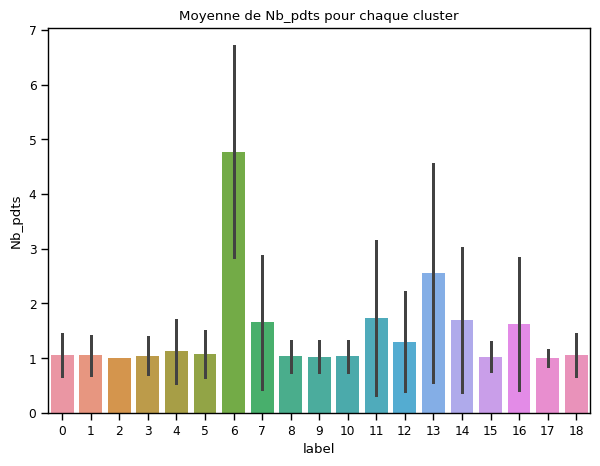

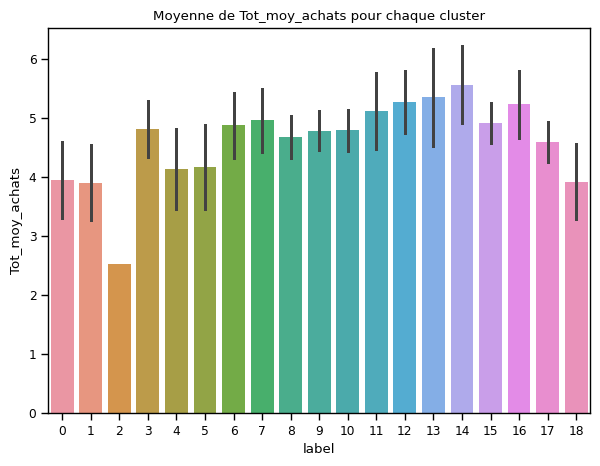

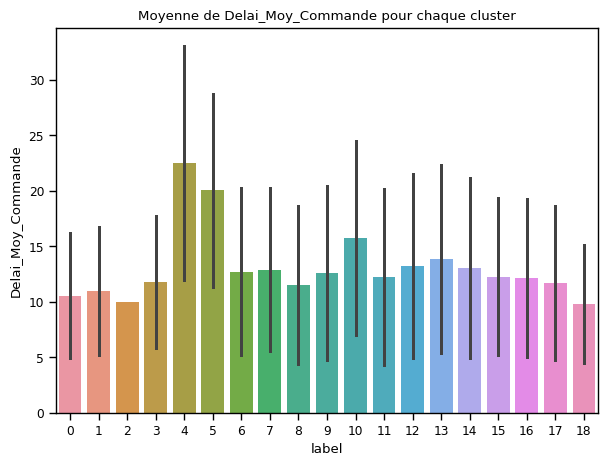

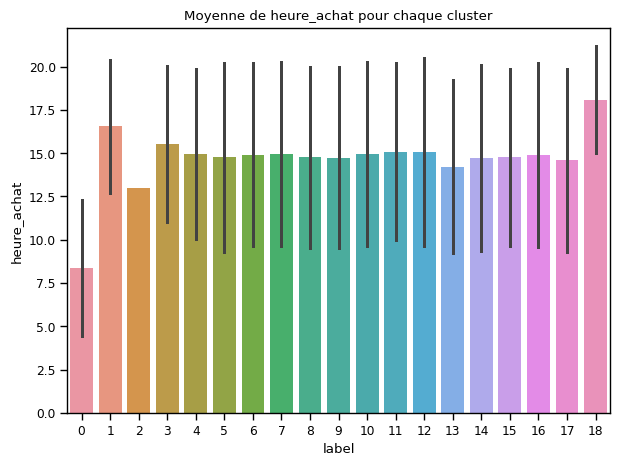

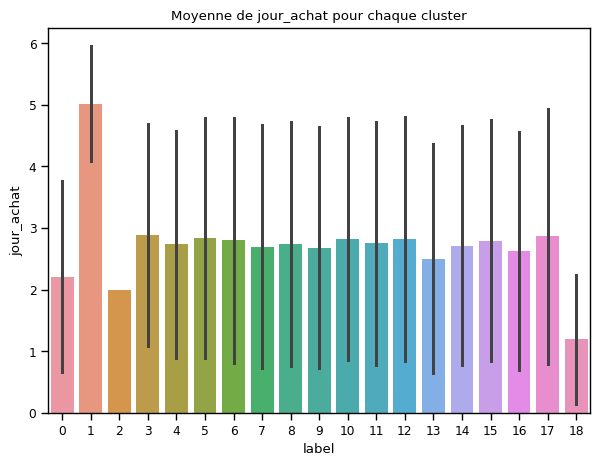

...

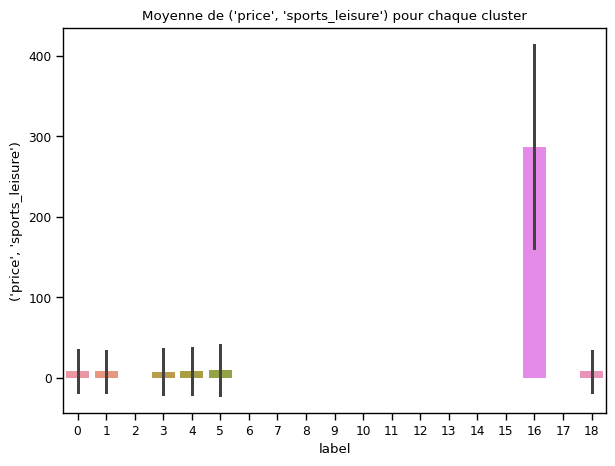

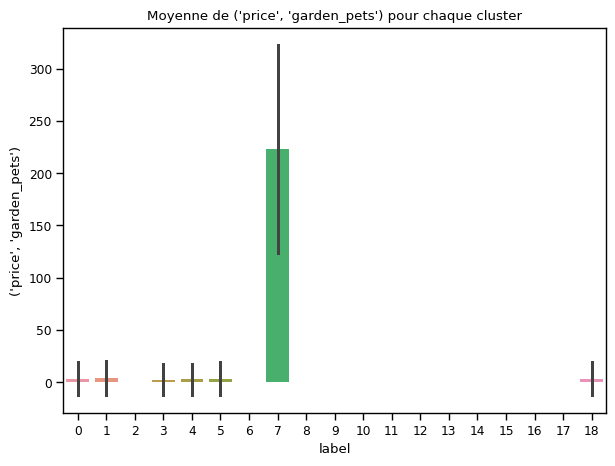

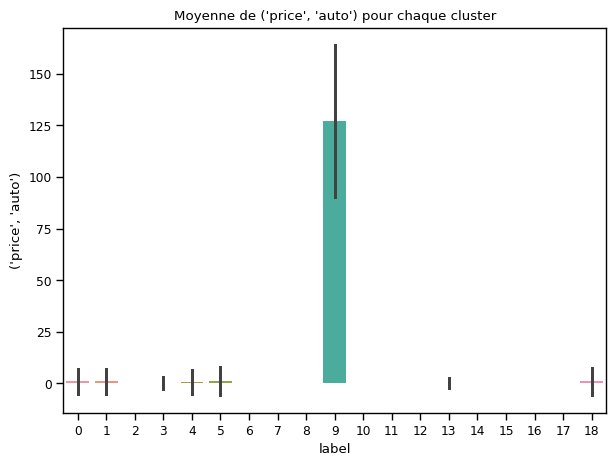

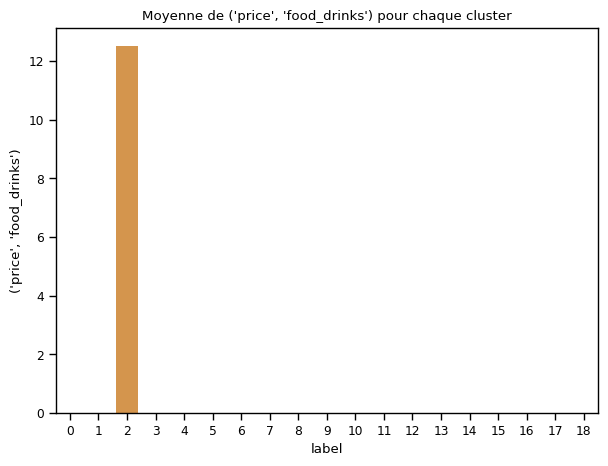

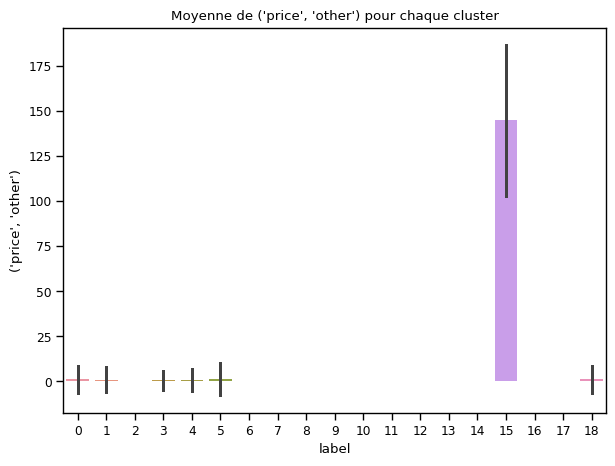

Erreur colonne :  x0_boleto
Erreur colonne :  x0_credit_card
Erreur colonne :  x0_debit_card
Erreur colonne :  x0_voucher


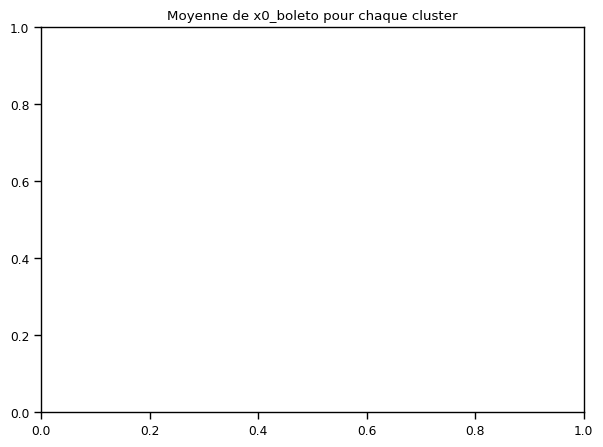

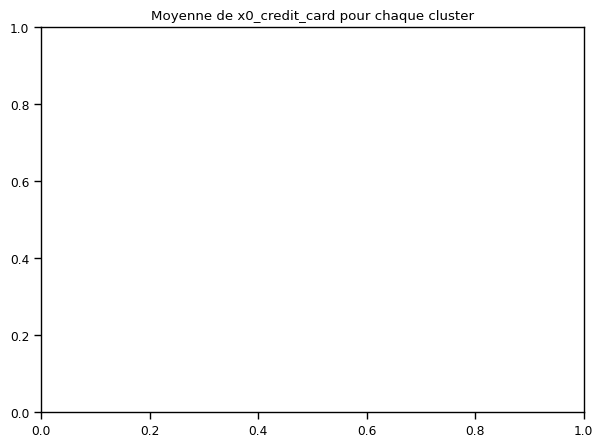

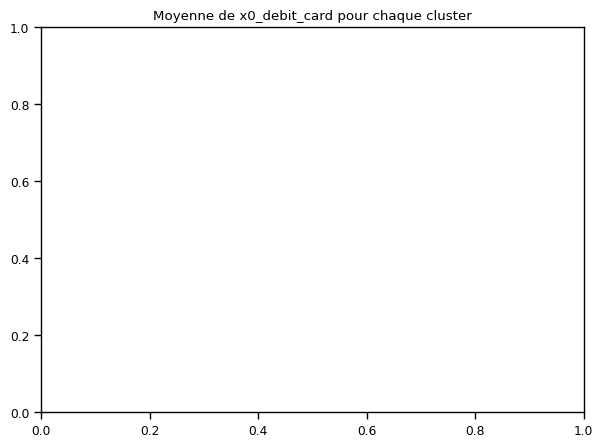

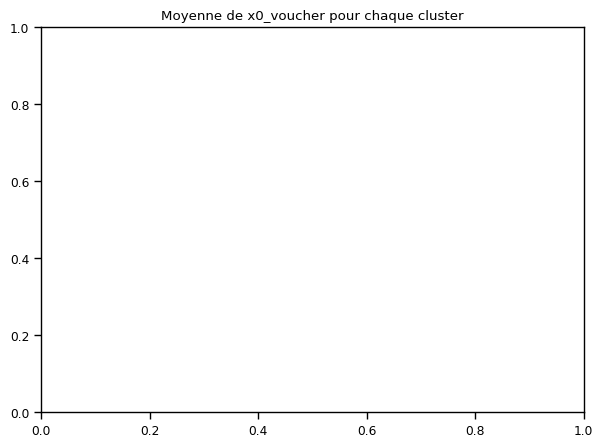

In [ ]:
# for column in group_columns.columns:
#     try:
#         plt.figure(figsize=(7,5))
#         titre = 'Moyenne de ' + str(column) + ' pour chaque cluster' 
#         plt.title(titre)
#         sns.barplot(x = 'label',
#                     y = column,
#                     data = X_tot_old, 
#                     ci="sd")
#         plt.show()
#     except:
#         print('Erreur colonne : ', column)
# Parcours de chaque colonne dans group_columns
for column in group_columns.columns:
    try:
        # Crée une nouvelle figure pour chaque colonne avec une taille de 7x5
        plt.figure(figsize=(7, 5))
        # Définit le titre de la figure comme 'Moyenne de [nom de la colonne] pour chaque cluster'
        titre = 'Moyenne de ' + str(column) + ' pour chaque cluster' 
        plt.title(titre)
        # Affiche un graphique à barres avec les clusters sur l'axe x, les valeurs moyennes de la colonne sur l'axe y,
        # en utilisant les données du DataFrame X_tot_old et en incluant un intervalle de confiance ('ci="sd"')
        sns.barplot(x='label',
                    y=column,
                    data=X_tot_old,
                    ci="sd")
        # Affiche le graphique
        plt.show()
    except:
        # Si une erreur se produit pour une colonne, affiche un message indiquant l'erreur
        print('Erreur colonne : ', column)

Ce code parcourt chaque colonne dans le DataFrame group_columns. Pour chaque colonne, il crée un graphique à barres montrant la moyenne de la colonne pour chaque cluster. Les clusters sont représentés sur l'axe des x, les valeurs moyennes de la colonne sont représentées sur l'axe des y, et l'intervalle de confiance est inclus pour montrer la variabilité des données. Le code affiche ensuite chaque graphique. S'il y a une erreur pour une colonne particulière, le code affiche un message d'erreur indiquant le nom de la colonne pour laquelle l'erreur s'est produite.

On constate que les différentes observations constatées dans le précédent clustering sont conservées, notamment:
* cat 8 : les plus dépensiers pour home et ceux qui ont acheté le plus de produits
* cat 3 : les 2e plus dépensiers et les plus dépensiers dans la catégorie électronics
* cat 2 : délai moyen de commande plus élevé que les autres et moyenne de notes commentaires plus basse que la moyenne
* pour le reste les catégories semblent représentées de façon similaire


On constate par contre que différentes valeurs évoluent sensiblement comme les notes moyennes de commentaires (de 3,1 à 3,4 par exemple pour la catégorie la moins satisfaite).
On peut 

In [32]:
df_cleaned = data.copy()

In [33]:
df_cleaned['Year'] = df_cleaned["order_purchase_timestamp"].apply(lambda x: x.year)

In [34]:
df_cleaned

,Cat_la_plus_achetee,customer_zip_code_prefix,customer_city,customer_state,Nb_pdts,Tot_moy_achats,Delai_Moy_Commande,order_purchase_timestamp,heure_achat,jour_achat,delai_dernier_achat,Note_Moy_Com,Moy_Paiment,Facilités,geolocation_lat,geolocation_lng,"('price', 'home')","('price', 'appliances')","('price', 'construction')","('price', 'office')","('price', 'electronics')","('price', 'arts')","('price', 'fashion')","('price', 'health_beauty')","('price', 'sports_leisure')","('price', 'garden_pets')","('price', 'auto')","('price', 'food_drinks')","('price', 'other')",Year
customer_unique_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,home,7787,Other,SP,1.0,4.866765,7.0,2018-05-10 10:56:27,10.0,3.0,115.0,5.0,credit_card,8.0,-23.340262,-46.831085,129.9,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,2018
0000b849f77a49e4a4ce2b2a4ca5be3f,health_beauty,6053,osasco,SP,1.0,2.939162,4.0,2018-05-07 11:11:27,11.0,0.0,118.0,4.0,credit_card,1.0,-23.559044,-46.788516,0.0,0.0,0.0,0.0,0.0,0.0,0.0,18.90,0.0,0.0,0.0,0.0,0.0,2018
0000f46a3911fa3c0805444483337064,office,88115,sao jose,SC,1.0,4.234107,26.0,2017-03-10 21:05:03,21.0,4.0,541.0,3.0,credit_card,8.0,-27.543010,-48.634938,0.0,0.0,0.0,69.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,2017
0004aac84e0df4da2b147fca70cf8255,electronics,18040,sorocaba,SP,1.0,5.192957,14.0,2017-11-14 19:45:42,19.0,1.0,292.0,5.0,credit_card,6.0,-23.505588,-47.469820,0.0,0.0,0.0,0.0,180.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,2017
0004bd2a26a76fe21f786e4fbd80607f,garden_pets,5036,sao paulo,SP,1.0,5.036953,2.0,2018-04-05 19:33:16,19.0,3.0,150.0,4.0,credit_card,8.0,-23.515693,-46.690031,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,154.0,0.0,0.0,0.0,2018
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
fffb09418989a0dbff854a28163e47c6,fashion,95330,Other,RS,1.0,4.060443,9.0,2017-12-17 19:14:35,19.0,6.0,259.0,5.0,boleto,1.0,-28.937008,-51.549726,0.0,0.0,0.0,0.0,0.0,0.0,58.0,0.00,0.0,0.0,0.0,0.0,0.0,2017
fffea47cd6d3cc0a88bd621562a9d061,health_beauty,44054,feira de santana,BA,1.0,4.172694,31.0,2017-12-10 20:07:56,20.0,6.0,266.0,4.0,credit_card,1.0,-12.217900,-38.959237,0.0,0.0,0.0,0.0,0.0,0.0,0.0,64.89,0.0,0.0,0.0,0.0,0.0,2017
ffff371b4d645b6ecea244b27531430a,auto,78552,Other,MT,1.0,4.498698,15.0,2017-02-07 15:49:16,15.0,1.0,572.0,5.0,credit_card,1.0,-11.834705,-55.508145,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,89.9,0.0,0.0,2017


In [57]:
# Créer une liste de la colonne 'year' dans le DataFrame df_cleaned
liste_years = df_cleaned['Year'].unique()

# Afficher la liste
print(liste_years)

[2018 2017]


In [35]:
year_options = []
for year in df_cleaned['Year'].unique():
    year_options.append({'label':str(year), 'value':year})
year_options.append({'label':'All', 'value':'All'})

In [39]:
import pandas as pd

# Suppose df_cleaned est le DataFrame avec l'index 'customer_unique_id' et les colonnes 'customer_city', etc.
# Vous avez déjà df_cleaned comme DataFrame avec l'index 'customer_unique_id'

# Création du DataFrame customer_country à partir des colonnes 'customer_city' et 'customer_unique_id'
customer_country = df_cleaned[['customer_city']].drop_duplicates()

# Réinitialisation de l'index 'customer_unique_id' pour le transformer en colonne
customer_country.reset_index(inplace=True)

# Affichage du DataFrame customer_country
print(customer_country)


                  customer_unique_id          customer_city
0   0000366f3b9a7992bf8c76cfdf3221e2                  Other
1   0000b849f77a49e4a4ce2b2a4ca5be3f                 osasco
2   0000f46a3911fa3c0805444483337064               sao jose
3   0004aac84e0df4da2b147fca70cf8255               sorocaba
4   0004bd2a26a76fe21f786e4fbd80607f              sao paulo
5   00050ab1314c0e55a6ca13cf7181fecf               campinas
6   000949456b182f53c18b68d6babc79c1  sao bernardo do campo
7   000a5ad9c4601d2bbdd9ed765d5213b3           porto alegre
8   000bfa1d2f1a41876493be685390d6d3                 santos
9   000c8bdb58a29e7115cfc257230fb21b         belo horizonte
10  0011857aff0e5871ce5eb429f21cdaf5            santo andre
11  0012929d977a8d7280bb277c1e5f589d                 canoas
12  0019da6aa6bcb27cc32f1249bd12da05                limeira
13  0019e8c501c85848ac0966d45226fa1d                 cuiaba
14  001ae5a1788703d64536c30362503e49          volta redonda
15  001deb796b28a3a128d6113857569aa4    

In [41]:
# Transformer la colonne 'customer_unique_id' en index
customer_country.set_index('customer_unique_id', inplace=True)

In [43]:
customer_country=df_cleaned[['customer_city']].drop_duplicates()
customer_country

,customer_city
customer_unique_id,
0000366f3b9a7992bf8c76cfdf3221e2,Other
0000b849f77a49e4a4ce2b2a4ca5be3f,osasco
0000f46a3911fa3c0805444483337064,sao jose
0004aac84e0df4da2b147fca70cf8255,sorocaba
0004bd2a26a76fe21f786e4fbd80607f,sao paulo
00050ab1314c0e55a6ca13cf7181fecf,campinas
000949456b182f53c18b68d6babc79c1,sao bernardo do campo
000a5ad9c4601d2bbdd9ed765d5213b3,porto alegre
000bfa1d2f1a41876493be685390d6d3,santos


In [60]:
# Création du DataFrame customer_country à partir des colonnes 'customer_city' et 'customer_unique_id'
customer_country = df_cleaned[['customer_city']].drop_duplicates()

# Regroupement pour toutes les années
df_cleaned_grouped = customer_country.groupby(['customer_city']).aggregate('count').reset_index()

# Filtrage pour l'année 2017
filtered_df_2017 = df_cleaned[df_cleaned['Year'] == 2017]
# customer_country_2017 = filtered_df_2009[['customer_city']].drop_duplicates()
# filtered_df_2017_grouped = customer_country_2009.groupby(['customer_city']).aggregate('count').reset_index()

# Filtrage pour l'année 2018
filtered_df_2018 = df_cleaned[df_cleaned['Year'] == 2018]
# customer_country_2018 = filtered_df_2010[['customer_city']].drop_duplicates()
# filtered_df_2018_grouped = customer_country_2010.groupby(['customer_city']).aggregate('count').reset_index()



In [266]:
# Créer une nouvelle colonne "customer_id" avec les valeurs de l'index actuel
filtered_df_2017['customer_id'] = filtered_df_2017.index
filtered_df_2017
# customer_country_2018
# filtered_df_2018_grouped

,Cat_la_plus_achetee,customer_zip_code_prefix,customer_city,customer_state,Nb_pdts,Tot_moy_achats,Delai_Moy_Commande,order_purchase_timestamp,heure_achat,jour_achat,delai_dernier_achat,Note_Moy_Com,Moy_Paiment,Facilités,geolocation_lat,geolocation_lng,"('price', 'home')","('price', 'appliances')","('price', 'construction')","('price', 'office')","('price', 'electronics')","('price', 'arts')","('price', 'fashion')","('price', 'health_beauty')","('price', 'sports_leisure')","('price', 'garden_pets')","('price', 'auto')","('price', 'food_drinks')","('price', 'other')",Year,customer_id
customer_unique_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0000f46a3911fa3c0805444483337064,office,88115,sao jose,SC,1.0,4.234107,26.0,2017-03-10 21:05:03,21.0,4.0,541.0,3.0,credit_card,8.0,-27.543010,-48.634938,0.0,0.0,0.0,69.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.00,2017,0000f46a3911fa3c0805444483337064
0004aac84e0df4da2b147fca70cf8255,electronics,18040,sorocaba,SP,1.0,5.192957,14.0,2017-11-14 19:45:42,19.0,1.0,292.0,5.0,credit_card,6.0,-23.505588,-47.469820,0.0,0.0,0.0,0.0,180.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.00,2017,0004aac84e0df4da2b147fca70cf8255
0005e1862207bf6ccc02e4228effd9a0,fashion,25966,Other,RJ,1.0,4.905275,5.0,2017-03-04 23:32:12,23.0,5.0,547.0,4.0,credit_card,3.0,-22.401531,-42.989311,0.0,0.0,0.0,0.0,0.0,0.0,135.0,0.00,0.0,0.0,0.0,0.0,0.00,2017,0005e1862207bf6ccc02e4228effd9a0
0006fdc98a402fceb4eb0ee528f6a8d4,home,29400,Other,ES,1.0,2.631889,17.0,2017-07-18 09:23:10,9.0,1.0,411.0,3.0,credit_card,2.0,-21.061438,-41.362994,13.9,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.00,2017,0006fdc98a402fceb4eb0ee528f6a8d4
00082cbe03e478190aadbea78542e933,sports_leisure,18400,Other,SP,1.0,4.369448,11.0,2017-11-19 15:22:02,15.0,6.0,287.0,5.0,boleto,1.0,-23.983343,-48.876533,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,79.0,0.0,0.0,0.0,0.00,2017,00082cbe03e478190aadbea78542e933
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
fffa431dd3fcdefea4b1777d114144f2,other,28660,Other,RJ,1.0,4.174233,11.0,2017-10-30 20:39:50,20.0,0.0,307.0,5.0,boleto,1.0,-22.159061,-42.417779,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,64.99,2017,fffa431dd3fcdefea4b1777d114144f2
fffb09418989a0dbff854a28163e47c6,fashion,95330,Other,RS,1.0,4.060443,9.0,2017-12-17 19:14:35,19.0,6.0,259.0,5.0,boleto,1.0,-28.937008,-51.549726,0.0,0.0,0.0,0.0,0.0,0.0,58.0,0.00,0.0,0.0,0.0,0.0,0.00,2017,fffb09418989a0dbff854a28163e47c6
fffea47cd6d3cc0a88bd621562a9d061,health_beauty,44054,feira de santana,BA,1.0,4.172694,31.0,2017-12-10 20:07:56,20.0,6.0,266.0,4.0,credit_card,1.0,-12.217900,-38.959237,0.0,0.0,0.0,0.0,0.0,0.0,0.0,64.89,0.0,0.0,0.0,0.0,0.00,2017,fffea47cd6d3cc0a88bd621562a9d061


In [267]:
# Créer une nouvelle colonne "customer_id" avec les valeurs de l'index actuel
filtered_df_2018['customer_id'] = filtered_df_2018.index
filtered_df_2018

,Cat_la_plus_achetee,customer_zip_code_prefix,customer_city,customer_state,Nb_pdts,Tot_moy_achats,Delai_Moy_Commande,order_purchase_timestamp,heure_achat,jour_achat,delai_dernier_achat,Note_Moy_Com,Moy_Paiment,Facilités,geolocation_lat,geolocation_lng,"('price', 'home')","('price', 'appliances')","('price', 'construction')","('price', 'office')","('price', 'electronics')","('price', 'arts')","('price', 'fashion')","('price', 'health_beauty')","('price', 'sports_leisure')","('price', 'garden_pets')","('price', 'auto')","('price', 'food_drinks')","('price', 'other')",Year,customer_id
customer_unique_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,home,7787,Other,SP,1.0,4.866765,7.0,2018-05-10 10:56:27,10.0,3.0,115.0,5.0,credit_card,8.0,-23.340262,-46.831085,129.90,0.0,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2018,0000366f3b9a7992bf8c76cfdf3221e2
0000b849f77a49e4a4ce2b2a4ca5be3f,health_beauty,6053,osasco,SP,1.0,2.939162,4.0,2018-05-07 11:11:27,11.0,0.0,118.0,4.0,credit_card,1.0,-23.559044,-46.788516,0.00,0.0,0.0,0.00,0.00,0.0,0.0,18.9,0.0,0.0,0.0,0.0,0.0,2018,0000b849f77a49e4a4ce2b2a4ca5be3f
0004bd2a26a76fe21f786e4fbd80607f,garden_pets,5036,sao paulo,SP,1.0,5.036953,2.0,2018-04-05 19:33:16,19.0,3.0,150.0,4.0,credit_card,8.0,-23.515693,-46.690031,0.00,0.0,0.0,0.00,0.00,0.0,0.0,0.0,0.0,154.0,0.0,0.0,0.0,2018,0004bd2a26a76fe21f786e4fbd80607f
00050ab1314c0e55a6ca13cf7181fecf,electronics,13084,campinas,SP,1.0,3.331847,7.0,2018-04-20 12:57:23,12.0,4.0,135.0,4.0,boleto,1.0,-22.823953,-47.086521,0.00,0.0,0.0,0.00,27.99,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2018,00050ab1314c0e55a6ca13cf7181fecf
00090324bbad0e9342388303bb71ba0a,home,13054,campinas,SP,1.0,3.911023,16.0,2018-03-24 14:44:41,14.0,5.0,162.0,5.0,credit_card,3.0,-22.972614,-47.126615,49.95,0.0,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2018,00090324bbad0e9342388303bb71ba0a
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
fff22793223fe80c97a8fd02ac5c6295,health_beauty,6404,barueri,SP,9.0,4.189655,3.0,2018-06-26 11:01:47,11.0,1.0,68.0,5.0,credit_card,1.0,-23.507191,-46.871449,0.00,0.0,0.0,0.00,0.00,0.0,0.0,594.0,0.0,0.0,0.0,0.0,0.0,2018,fff22793223fe80c97a8fd02ac5c6295
fff2ae16b99c6f3c785f0e052f2a9cfb,office,23017,rio de janeiro,RJ,1.0,4.867073,22.0,2018-04-20 11:03:47,11.0,4.0,135.0,5.0,credit_card,8.0,-22.920061,-43.530190,0.00,0.0,0.0,129.94,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2018,fff2ae16b99c6f3c785f0e052f2a9cfb
fff3e1d7bc75f11dc7670619b2e61840,electronics,64006,teresina,PI,1.0,4.004602,11.0,2018-07-20 13:47:30,13.0,4.0,44.0,5.0,debit_card,1.0,-5.053418,-42.814494,0.00,0.0,0.0,0.00,54.85,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2018,fff3e1d7bc75f11dc7670619b2e61840


In [270]:
# Créer une nouvelle colonne "customer_id" avec les valeurs de l'index actuel
df_cleaned['customer_id'] = df_cleaned.index
df_cleaned

,Cat_la_plus_achetee,customer_zip_code_prefix,customer_city,customer_state,Nb_pdts,Tot_moy_achats,Delai_Moy_Commande,order_purchase_timestamp,heure_achat,jour_achat,delai_dernier_achat,Note_Moy_Com,Moy_Paiment,Facilités,geolocation_lat,geolocation_lng,"('price', 'home')","('price', 'appliances')","('price', 'construction')","('price', 'office')","('price', 'electronics')","('price', 'arts')","('price', 'fashion')","('price', 'health_beauty')","('price', 'sports_leisure')","('price', 'garden_pets')","('price', 'auto')","('price', 'food_drinks')","('price', 'other')",Year,customer_id
customer_unique_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,home,7787,Other,SP,1.0,4.866765,7.0,2018-05-10 10:56:27,10.0,3.0,115.0,5.0,credit_card,8.0,-23.340262,-46.831085,129.9,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,2018,0000366f3b9a7992bf8c76cfdf3221e2
0000b849f77a49e4a4ce2b2a4ca5be3f,health_beauty,6053,osasco,SP,1.0,2.939162,4.0,2018-05-07 11:11:27,11.0,0.0,118.0,4.0,credit_card,1.0,-23.559044,-46.788516,0.0,0.0,0.0,0.0,0.0,0.0,0.0,18.90,0.0,0.0,0.0,0.0,0.0,2018,0000b849f77a49e4a4ce2b2a4ca5be3f
0000f46a3911fa3c0805444483337064,office,88115,sao jose,SC,1.0,4.234107,26.0,2017-03-10 21:05:03,21.0,4.0,541.0,3.0,credit_card,8.0,-27.543010,-48.634938,0.0,0.0,0.0,69.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,2017,0000f46a3911fa3c0805444483337064
0004aac84e0df4da2b147fca70cf8255,electronics,18040,sorocaba,SP,1.0,5.192957,14.0,2017-11-14 19:45:42,19.0,1.0,292.0,5.0,credit_card,6.0,-23.505588,-47.469820,0.0,0.0,0.0,0.0,180.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,2017,0004aac84e0df4da2b147fca70cf8255
0004bd2a26a76fe21f786e4fbd80607f,garden_pets,5036,sao paulo,SP,1.0,5.036953,2.0,2018-04-05 19:33:16,19.0,3.0,150.0,4.0,credit_card,8.0,-23.515693,-46.690031,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,154.0,0.0,0.0,0.0,2018,0004bd2a26a76fe21f786e4fbd80607f
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
fffb09418989a0dbff854a28163e47c6,fashion,95330,Other,RS,1.0,4.060443,9.0,2017-12-17 19:14:35,19.0,6.0,259.0,5.0,boleto,1.0,-28.937008,-51.549726,0.0,0.0,0.0,0.0,0.0,0.0,58.0,0.00,0.0,0.0,0.0,0.0,0.0,2017,fffb09418989a0dbff854a28163e47c6
fffea47cd6d3cc0a88bd621562a9d061,health_beauty,44054,feira de santana,BA,1.0,4.172694,31.0,2017-12-10 20:07:56,20.0,6.0,266.0,4.0,credit_card,1.0,-12.217900,-38.959237,0.0,0.0,0.0,0.0,0.0,0.0,0.0,64.89,0.0,0.0,0.0,0.0,0.0,2017,fffea47cd6d3cc0a88bd621562a9d061
ffff371b4d645b6ecea244b27531430a,auto,78552,Other,MT,1.0,4.498698,15.0,2017-02-07 15:49:16,15.0,1.0,572.0,5.0,credit_card,1.0,-11.834705,-55.508145,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,89.9,0.0,0.0,2017,ffff371b4d645b6ecea244b27531430a


In [272]:
data_ch = [go.Choropleth(
                locations = df_cleaned['customer_city'],
                locationmode = 'country names',
                z = df_cleaned['customer_id'],
                text = data['customer_city'],
                colorscale = 'Rainbow',
                marker_line_color='darkgray',
                marker_line_width=0.5,
                colorbar_title = 'Customers',
                ),
        go.Choropleth(
                locations = filtered_df_2017['customer_city'],
                locationmode = 'country names',
                z = filtered_df_2017['customer_id'],
                text = filtered_df_2017['customer_city'],
                colorscale = 'Rainbow',
                marker_line_color='darkgray',
                marker_line_width=0.5,
                colorbar_title = 'Customers',
                ),
        go.Choropleth(
                locations = filtered_df_2018['customer_city'],
                locationmode = 'country names',
                z = filtered_df_2018['customer_id'],
                text = filtered_df_2018['customer_city'],
                colorscale = 'Rainbow',
                marker_line_color='darkgray',
                marker_line_width=0.5,
                colorbar_title = 'Customers',
                ),
       ]

In [273]:
data_ch

[Choropleth({
     'colorbar': {'title': {'text': 'Customers'}},
     'colorscale': [[0.0, 'rgb(150,0,90)'], [0.125, 'rgb(0,0,200)'], [0.25,
                    'rgb(0,25,255)'], [0.375, 'rgb(0,152,255)'], [0.5,
                    'rgb(44,255,150)'], [0.625, 'rgb(151,255,0)'], [0.75,
                    'rgb(255,234,0)'], [0.875, 'rgb(255,111,0)'], [1.0,
                    'rgb(255,0,0)']],
     'locationmode': 'country names',
     'locations': array(['Other', 'osasco', 'sao jose', ..., 'Other', 'Other', 'Other'],
                        dtype=object),
     'marker': {'line': {'color': 'darkgray', 'width': 0.5}},
     'text': array(['Other', 'osasco', 'sao jose', ..., 'Other', 'Other', 'Other'],
                   dtype=object),
     'z': array(['0000366f3b9a7992bf8c76cfdf3221e2', '0000b849f77a49e4a4ce2b2a4ca5be3f',
                 '0000f46a3911fa3c0805444483337064', ...,
                 'ffff371b4d645b6ecea244b27531430a', 'ffff5962728ec6157033ef9805bacc48',
                 'ffff

In [274]:
layout = go.Layout(
                title_text='Our customers',
                title_x=0.5,
                geo=dict(
                    showframe=False,
                    showcoastlines=False,
                    projection_type='equirectangular'
                ),
                )

In [278]:
data_ch

[Choropleth({
     'colorbar': {'title': {'text': 'Customers'}},
     'colorscale': [[0.0, 'rgb(150,0,90)'], [0.125, 'rgb(0,0,200)'], [0.25,
                    'rgb(0,25,255)'], [0.375, 'rgb(0,152,255)'], [0.5,
                    'rgb(44,255,150)'], [0.625, 'rgb(151,255,0)'], [0.75,
                    'rgb(255,234,0)'], [0.875, 'rgb(255,111,0)'], [1.0,
                    'rgb(255,0,0)']],
     'locationmode': 'country names',
     'locations': array(['Other', 'osasco', 'sao jose', ..., 'Other', 'Other', 'Other'],
                        dtype=object),
     'marker': {'line': {'color': 'darkgray', 'width': 0.5}},
     'text': array(['Other', 'osasco', 'sao jose', ..., 'Other', 'Other', 'Other'],
                   dtype=object),
     'z': array(['0000366f3b9a7992bf8c76cfdf3221e2', '0000b849f77a49e4a4ce2b2a4ca5be3f',
                 '0000f46a3911fa3c0805444483337064', ...,
                 'ffff371b4d645b6ecea244b27531430a', 'ffff5962728ec6157033ef9805bacc48',
                 'ffff

In [279]:
import plotly.graph_objs as go

# Assuming you have the 'data_ch' list of choropleth traces as you mentioned earlier
# data_ch = [go.Choropleth(...), go.Choropleth(...), go.Choropleth(...)]

# Create the Figure with the list of choropleth traces
fig = go.Figure(data=data_ch, layout=layout)

# # Show the plot
# fig.show()


In [276]:
# Add dropdown 
fig.update_layout( 
    updatemenus=[ 
        dict( 
            active=0, 
            buttons=list([ 
                dict(label="All", 
                     method="update", 
                     args=[{"visible": [True, False, False, False]}, 
                           {"title": "All customers"}]), 
                dict(label="2017", 
                     method="update", 
                     args=[{"visible": [False, True, False, False]}, 
                           {"title": "Customers in 2017", 
                            }]), 
                dict(label="2018", 
                     method="update", 
                     args=[{"visible": [False, False, True, False]}, 
                           {"title": "Customers in 2018", 
                            }]), 
            ]), 
        ) 
    ]) 

In [3]:
# year_options = []
# for year in df_cleaned['Year'].unique():
#     year_options.append({'label':str(year), 'value':year})
# year_options.append({'label':'All', 'value':'All'})

# # Suppose df_cleaned est le DataFrame avec l'index 'customer_unique_id' et les colonnes 'customer_city', etc.
# # Vous avez déjà df_cleaned comme DataFrame avec l'index 'customer_unique_id'

# # Création du DataFrame customer_country à partir des colonnes 'customer_city' et 'customer_unique_id'
# customer_country = df_cleaned[['customer_city']].drop_duplicates()

# # Réinitialisation de l'index 'customer_unique_id' pour le transformer en colonne
# customer_country.reset_index(inplace=True)

# # Affichage du DataFrame customer_country
# print(customer_country)

# # Transformer la colonne 'customer_unique_id' en index
# customer_country.set_index('customer_unique_id', inplace=True)
# customer_country=df_cleaned[['customer_city']].drop_duplicates()
# # Création du DataFrame customer_country à partir des colonnes 'customer_city' et 'customer_unique_id'
# customer_country = df_cleaned[['customer_city']].drop_duplicates()

# # Regroupement pour toutes les années
# df_cleaned_grouped = customer_country.groupby(['customer_city']).aggregate('count').reset_index()

# # Filtrage pour l'année 2017
# filtered_df_2017 = df_cleaned[df_cleaned['Year'] == 2017]
# # customer_country_2017 = filtered_df_2009[['customer_city']].drop_duplicates()
# # filtered_df_2017_grouped = customer_country_2009.groupby(['customer_city']).aggregate('count').reset_index()

# # Filtrage pour l'année 2018
# filtered_df_2018 = df_cleaned[df_cleaned['Year'] == 2018]
# # customer_country_2018 = filtered_df_2010[['customer_city']].drop_duplicates()
# # filtered_df_2018_grouped = customer_country_2010.groupby(['customer_city']).aggregate('count').reset_index()
# # Créer une nouvelle colonne "customer_id" avec les valeurs de l'index actuel
# df_cleaned['customer_id'] = df_cleaned.index
# df_cleaned
# # Créer une nouvelle colonne "customer_id" avec les valeurs de l'index actuel
# filtered_df_2017['customer_id'] = filtered_df_2017.index
# filtered_df_2017
# # customer_country_2018
# # filtered_df_2018_grouped
# # Créer une nouvelle colonne "customer_id" avec les valeurs de l'index actuel
# filtered_df_2018['customer_id'] = filtered_df_2018.index
# filtered_df_2018
# data_ch = [go.Choropleth(
#                 locations = df_cleaned['customer_city'],
#                 locationmode = 'country names',
#                 z = df_cleaned['customer_id'],
#                 text = data['customer_city'],
#                 colorscale = 'Rainbow',
#                 marker_line_color='darkgray',
#                 marker_line_width=0.5,
#                 colorbar_title = 'Customers',
#                 ),
#         go.Choropleth(
#                 locations = filtered_df_2017['customer_city'],
#                 locationmode = 'country names',
#                 z = filtered_df_2017['customer_id'],
#                 text = filtered_df_2017['customer_city'],
#                 colorscale = 'Rainbow',
#                 marker_line_color='darkgray',
#                 marker_line_width=0.5,
#                 colorbar_title = 'Customers',
#                 ),
#         go.Choropleth(
#                 locations = filtered_df_2018['customer_city'],
#                 locationmode = 'country names',
#                 z = filtered_df_2018['customer_id'],
#                 text = filtered_df_2018['customer_city'],
#                 colorscale = 'Rainbow',
#                 marker_line_color='darkgray',
#                 marker_line_width=0.5,
#                 colorbar_title = 'Customers',
#                 ),
#        ]

# layout = go.Layout(
#                 title_text='Our customers',
#                 title_x=0.5,
#                 geo=dict(
#                     showframe=False,
#                     showcoastlines=False,
#                     projection_type='equirectangular'
#                 ),
#                 )
# import plotly.graph_objs as go

# # Assuming you have the 'data_ch' list of choropleth traces as you mentioned earlier
# # data_ch = [go.Choropleth(...), go.Choropleth(...), go.Choropleth(...)]

# # Create the Figure with the list of choropleth traces
# fig = go.Figure(data=data_ch, layout=layout)

# # # Show the plot
# # fig.show()
# # Add dropdown 
# fig.update_layout( 
#     updatemenus=[ 
#         dict( 
#             active=0, 
#             buttons=list([ 
#                 dict(label="All", 
#                      method="update", 
#                      args=[{"visible": [True, False, False, False]}, 
#                            {"title": "All customers"}]), 
#                 dict(label="2017", 
#                      method="update", 
#                      args=[{"visible": [False, True, False, False]}, 
#                            {"title": "Customers in 2017", 
#                             }]), 
#                 dict(label="2018", 
#                      method="update", 
#                      args=[{"visible": [False, False, True, False]}, 
#                            {"title": "Customers in 2018", 
#                             }]), 
#             ]), 
#         ) 
#     ]) 

In [1]:
# import pandas as pd
# import plotly.graph_objects as go

# # Supposons que vous avez déjà les DataFrames df_cleaned, filtered_df_2017 et filtered_df_2018

# # Étape 1: Créer les traces de choropleth pour chaque année

# data_ch = [
#     go.Choropleth(
#         locations=df_cleaned['customer_city'],
#         locationmode='country names',
#         z=df_cleaned['customer_id'],
#         text=df_cleaned['customer_city'],
#         colorscale='Rainbow',
#         marker_line_color='darkgray',
#         marker_line_width=0.5,
#         colorbar_title='Customers',
#         name='All Customers'
#     ),
#     go.Choropleth(
#         locations=filtered_df_2017['customer_city'],
#         locationmode='country names',
#         z=filtered_df_2017['customer_id'],
#         text=filtered_df_2017['customer_city'],
#         colorscale='Rainbow',
#         marker_line_color='darkgray',
#         marker_line_width=0.5,
#         colorbar_title='Customers',
#         name='Customers in 2017'
#     ),
#     go.Choropleth(
#         locations=filtered_df_2018['customer_city'],
#         locationmode='country names',
#         z=filtered_df_2018['customer_id'],
#         text=filtered_df_2018['customer_city'],
#         colorscale='Rainbow',
#         marker_line_color='darkgray',
#         marker_line_width=0.5,
#         colorbar_title='Customers',
#         name='Customers in 2018'
#     ),
# ]

# # Étape 2: Créer la mise en page du graphique

# layout = go.Layout(
#     title='Our customers',
#     title_x=0.5,
#     geo=dict(
#         showframe=False,
#         showcoastlines=False,
#         projection_type='equirectangular'
#     ),
# )

# # Étape 3: Créer la figure avec les traces de choropleth et la mise en page

# fig = go.Figure(data=data_ch, layout=layout)

# # Étape 4: Ajouter un menu déroulant pour sélectionner l'année

# fig.update_layout(
#     updatemenus=[
#         dict(
#             active=0,
#             buttons=list([
#                 dict(label='All',
#                      method='update',
#                      args=[{'visible': [True, False, False]}, {'title': 'All customers'}]),
#                 dict(label='2017',
#                      method='update',
#                      args=[{'visible': [False, True, False]}, {'title': 'Customers in 2017'}]),
#                 dict(label='2018',
#                      method='update',
#                      args=[{'visible': [False, False, True]}, {'title': 'Customers in 2018'}]),
#             ]),
#         )
#     ]
# )

# # Étape 5: Afficher le graphique

# fig.show()


NameError: name 'df_cleaned' is not defined